## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_model_nn import *
from ipynb.fs.defs.myfun_plot import *

2024-02-08 21:23:19.526500: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-08 21:23:19.526563: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-08 21:23:19.555597: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-08 21:23:19.629530: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-08 21:23:20.765961: W tensorflow/compiler/tf2

## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"

In [3]:
processed_flag = 'pre'
# load the data
_, dflist = load_dataset(dir_name, processed_flag)
dataset = dflist

print(f"In this dataset we have {np.sum([d.shape[0] for d in dataset])} scenes")

In this dataset we have 671 scenes


## Params

In [4]:
DOE =[1,2,2,2,1] #Design of experiment

In [5]:
v0 = 30
NUM_ITER = 500
LEARNING_RATE_v0 = 0.5
test = 0.9

plot_flag = True
flag_save = True

----------------------------------------------------------------------------------------------------
Analyzing 10 dfs. NN structure: 1-2-2-2-1
****************************************************************************************************
Analyzing 1/10 dfs.
In DataFrame n.1 we have 109 scenes.
    To train the model we use 10 scenes, the remaining 99 to test the model.

Training step. (10 scenes)
DataFrame n.1. Scene n.1/10
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [531.64,533.24]


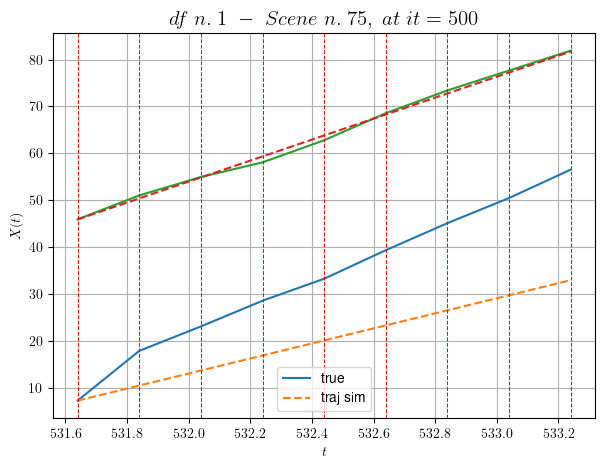

----------------------------------------------------------------------------------------------------
        For scene 1/10:
        * After LR finder: LR_NN=1e-05 with mse=26.80030005372726 at it=24
        * v0 = 22.382648405902604
        * MSE = 113.73016091129725
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [148.04,148.44]


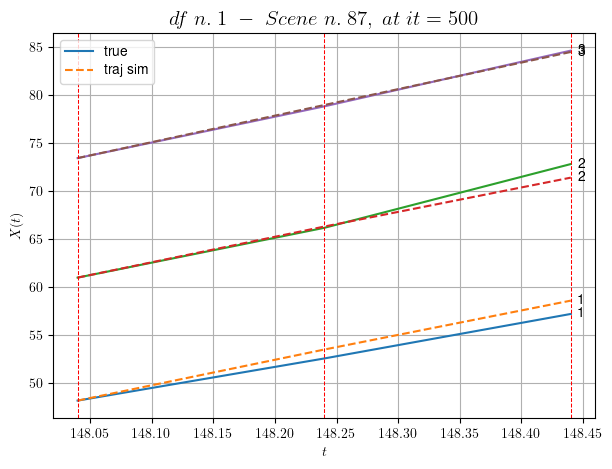

----------------------------------------------------------------------------------------------------
        For scene 2/10:
        * After LR finder: LR_NN=0.005 with mse=0.7364656245826994 at it=24
        * v0 = 27.621656721215743
        * MSE = 0.5358688695690113
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/10
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


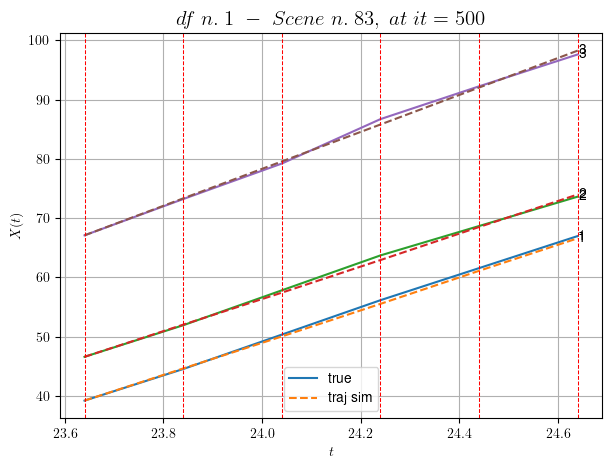

----------------------------------------------------------------------------------------------------
        For scene 3/10:
        * After LR finder: LR_NN=0.005 with mse=0.29666120599277296 at it=24
        * v0 = 31.184420565840114
        * MSE = 0.17635309076799752
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [159.84,160.64]


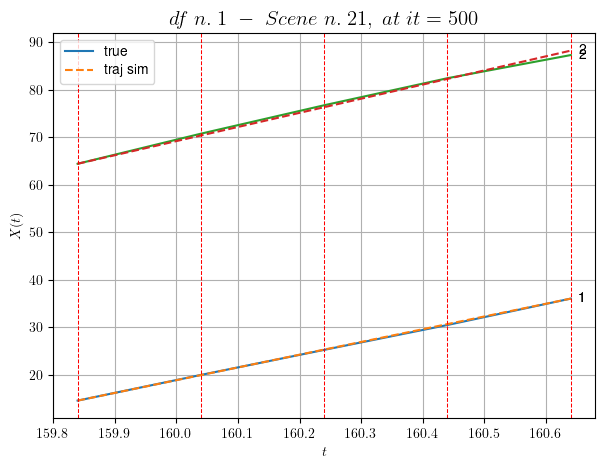

----------------------------------------------------------------------------------------------------
        For scene 4/10:
        * After LR finder: LR_NN=0.0005 with mse=0.14820613088254858 at it=24
        * v0 = 29.799065415673518
        * MSE = 0.125372008898847
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/10
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [429.24,429.84]


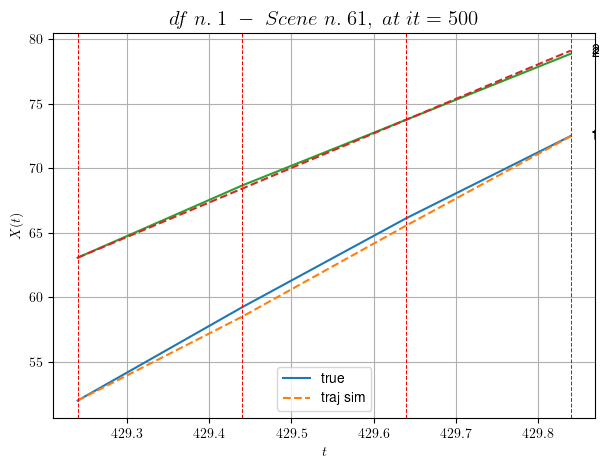

----------------------------------------------------------------------------------------------------
        For scene 5/10:
        * After LR finder: LR_NN=0.01 with mse=0.9361390818191303 at it=24
        * v0 = 26.76492351472944
        * MSE = 0.12221495216350656
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [489.04,489.84]


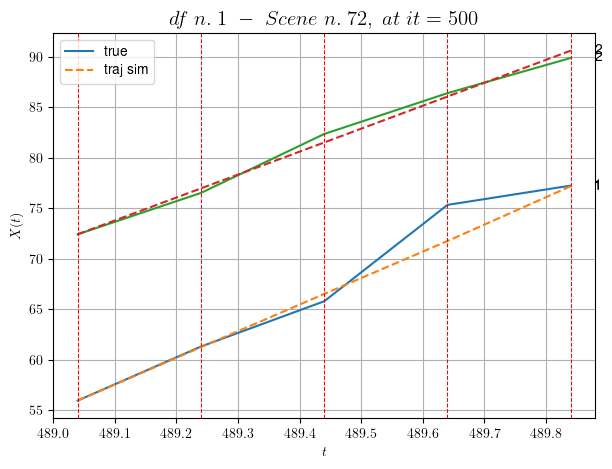

----------------------------------------------------------------------------------------------------
        For scene 6/10:
        * After LR finder: LR_NN=0.001 with mse=9.436065952049494 at it=24
        * v0 = 22.729734196719097
        * MSE = 1.4870526157088557
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/10
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [116.04,117.04]


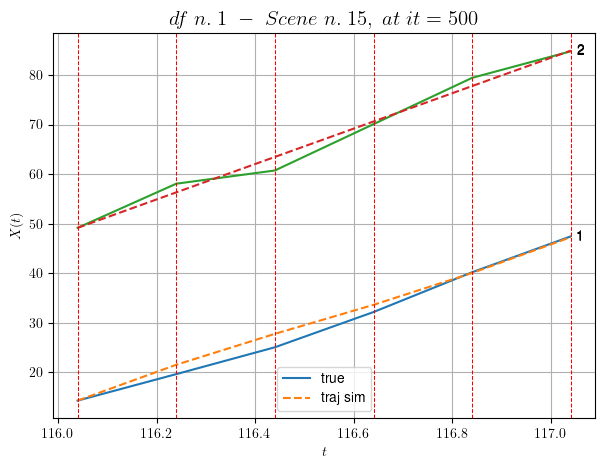

----------------------------------------------------------------------------------------------------
        For scene 7/10:
        * After LR finder: LR_NN=0.01 with mse=7.754979831590949 at it=24
        * v0 = 35.75445949476122
        * MSE = 1.6167237352963444
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [253.64,254.04]


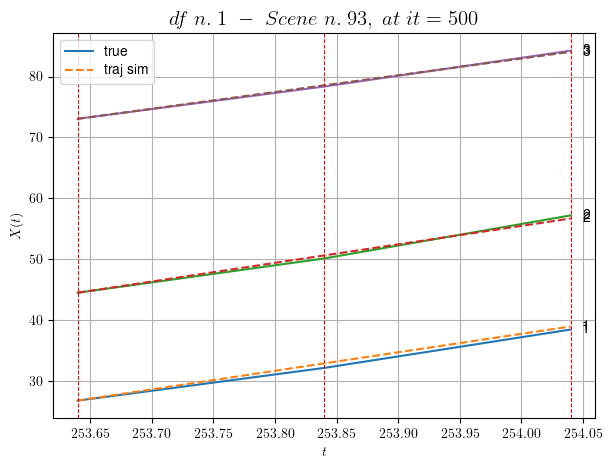

----------------------------------------------------------------------------------------------------
        For scene 8/10:
        * After LR finder: LR_NN=0.001 with mse=0.29584382931630454 at it=24
        * v0 = 27.47487958234899
        * MSE = 0.15474956878949173
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/10
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [358.84,359.64]


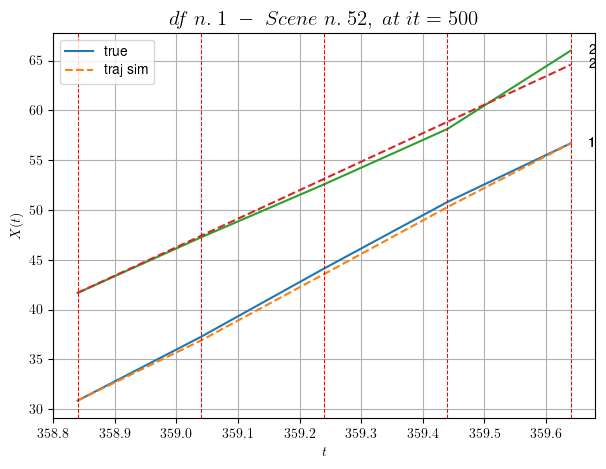

----------------------------------------------------------------------------------------------------
        For scene 9/10:
        * After LR finder: LR_NN=0.01 with mse=0.5790366205800999 at it=24
        * v0 = 28.626441976919878
        * MSE = 0.3566209142243134
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/10
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [495.84,496.24]


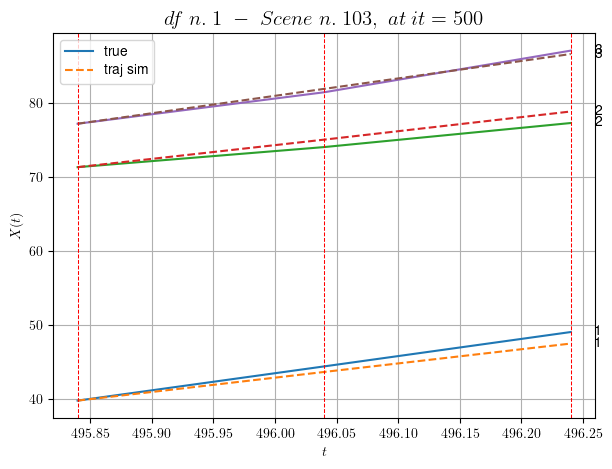

----------------------------------------------------------------------------------------------------
        For scene 10/10:
        * After LR finder: LR_NN=0.005 with mse=1.6329522306625384 at it=24
        * v0 = 23.56309349087298
        * MSE = 0.7547817257552919
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 11.90598983924709
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (99 scenes)
DataFrame n.1. Scene n.1/99


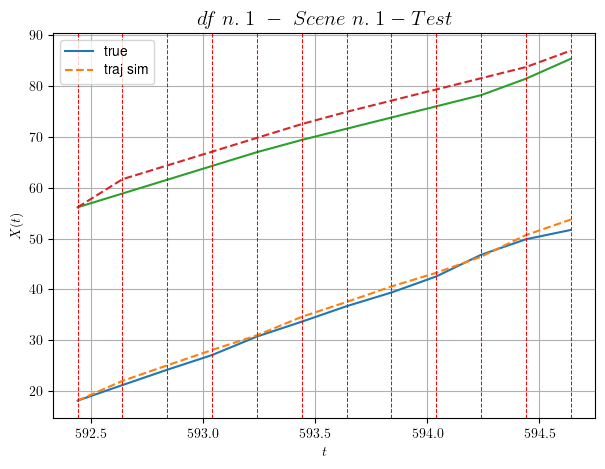

        For scene 1/99:
        * MSE = 4.338063717613887
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/99


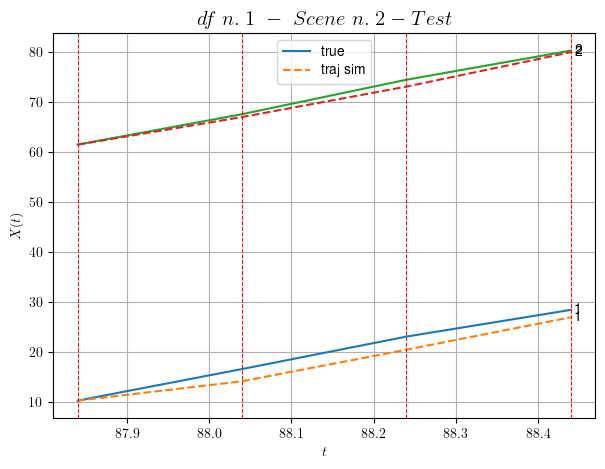

        For scene 2/99:
        * MSE = 2.1724069952066283
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/99


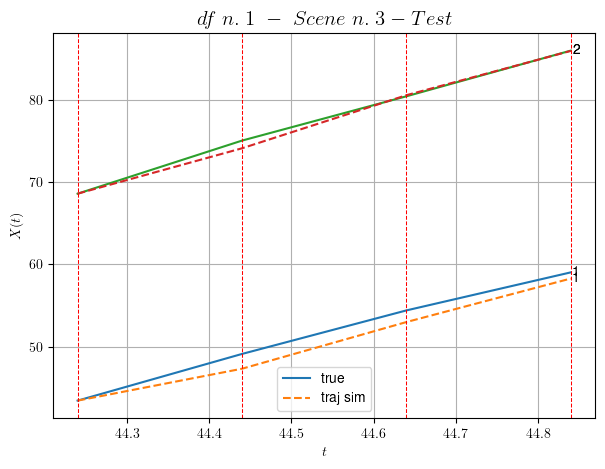

        For scene 3/99:
        * MSE = 0.835365364295562
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/99


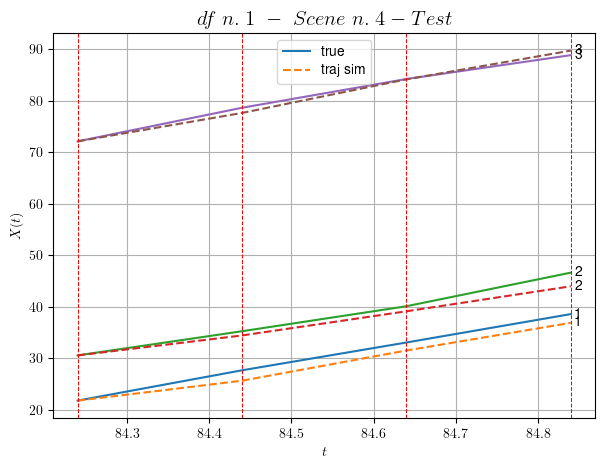

        For scene 4/99:
        * MSE = 1.6538198070858883
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/99


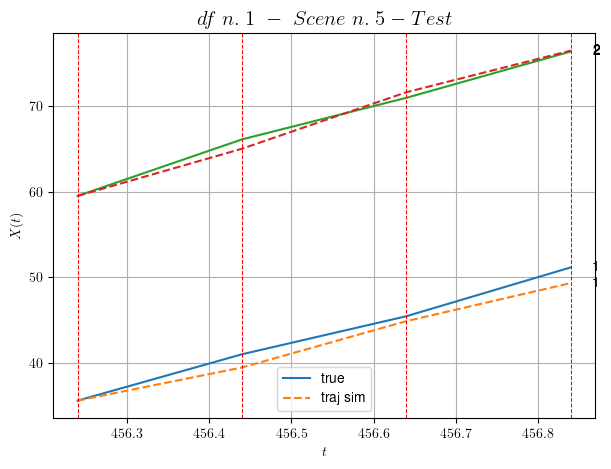

        For scene 5/99:
        * MSE = 0.9633415630724487
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/99


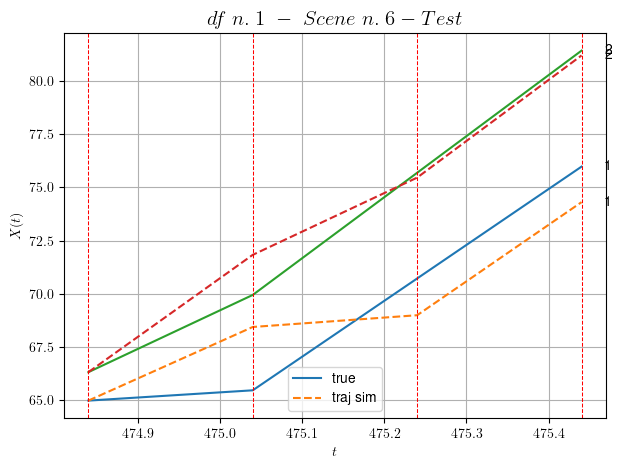

        For scene 6/99:
        * MSE = 2.28934857619464
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/99


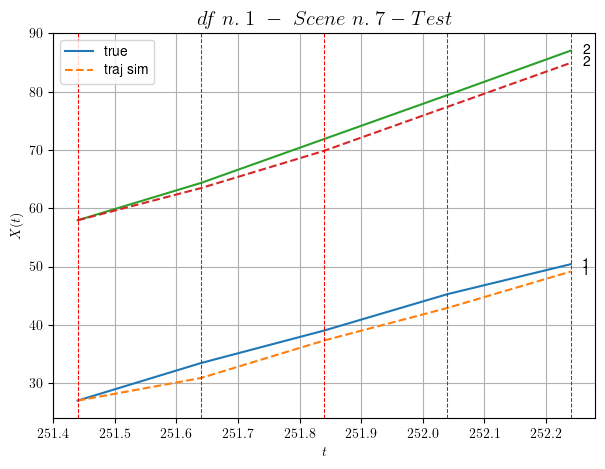

        For scene 7/99:
        * MSE = 3.005838279185609
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/99


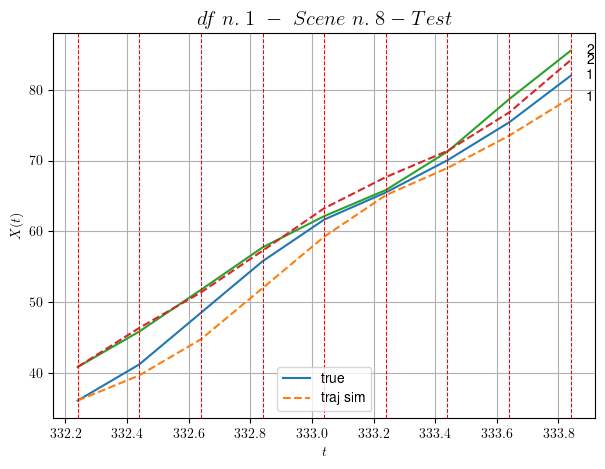

        For scene 8/99:
        * MSE = 3.4219142504185562
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/99


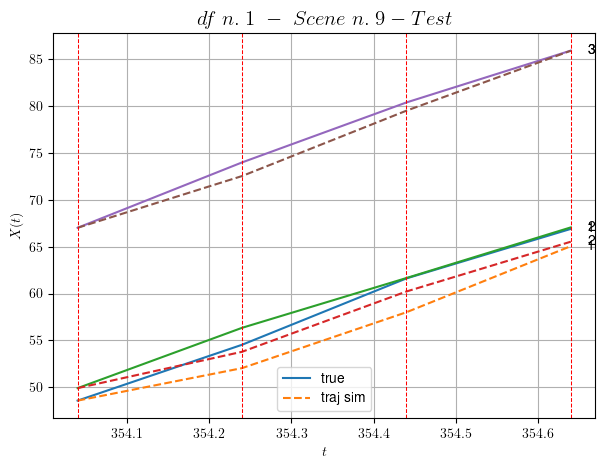

        For scene 9/99:
        * MSE = 3.0339474670094333
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/99


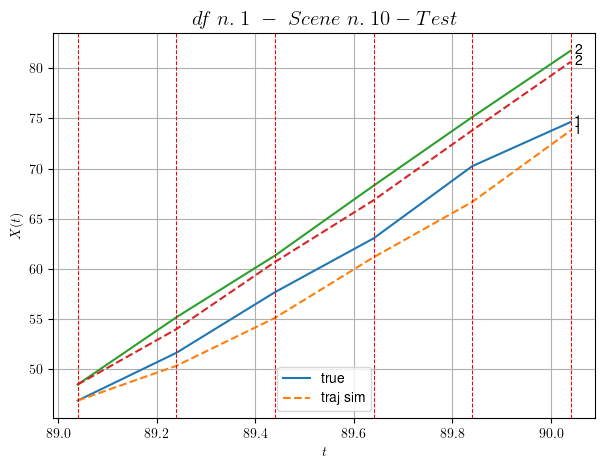

        For scene 10/99:
        * MSE = 2.6812316545782684
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/99


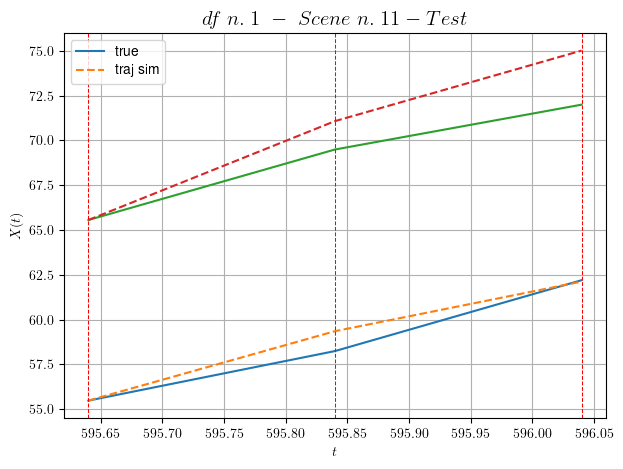

        For scene 11/99:
        * MSE = 2.14016520396747
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/99


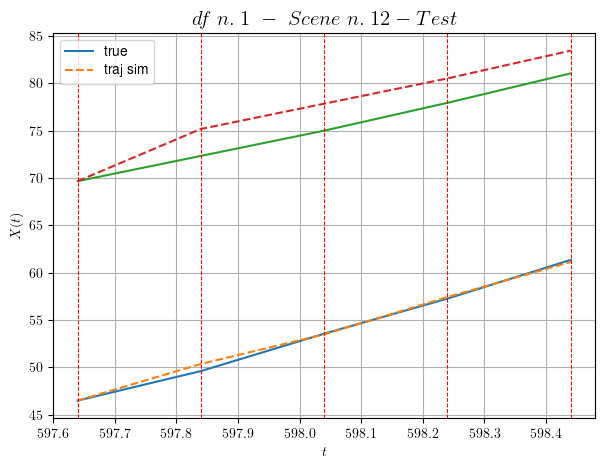

        For scene 12/99:
        * MSE = 2.930177532037103
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/99


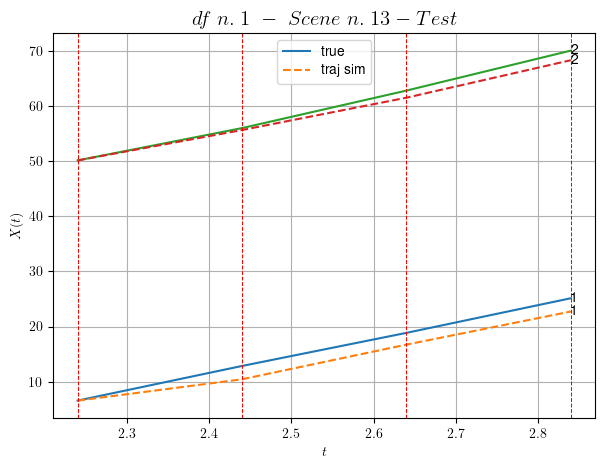

        For scene 13/99:
        * MSE = 2.6352428065371845
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/99


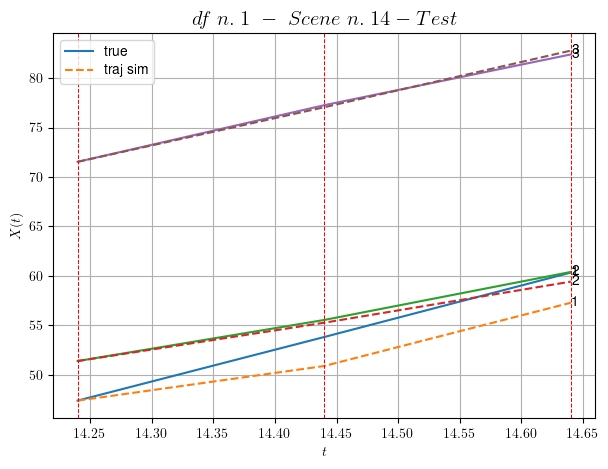

        For scene 14/99:
        * MSE = 2.1226126047076286
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/99


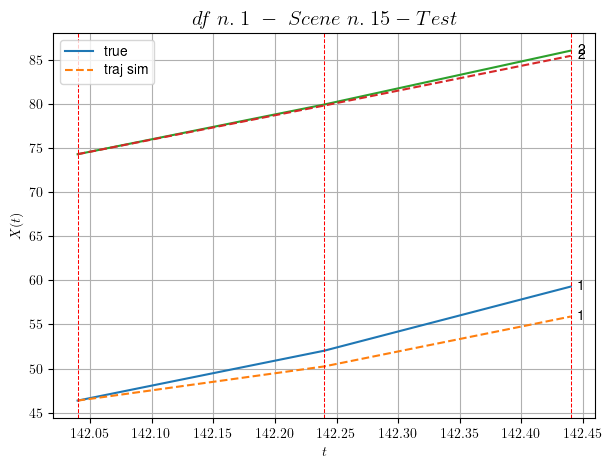

        For scene 15/99:
        * MSE = 2.512491440280934
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/99


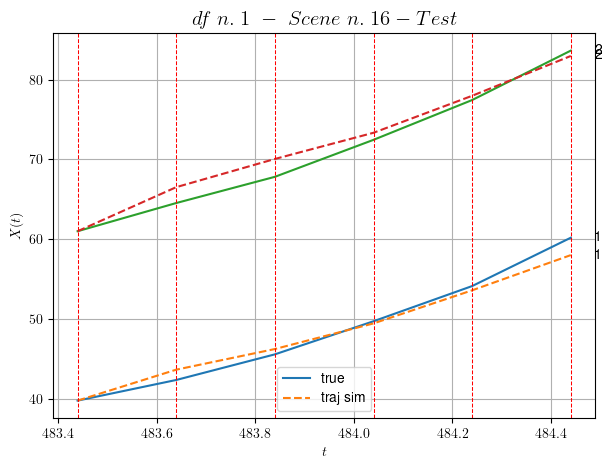

        For scene 16/99:
        * MSE = 1.4735538465265874
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/99


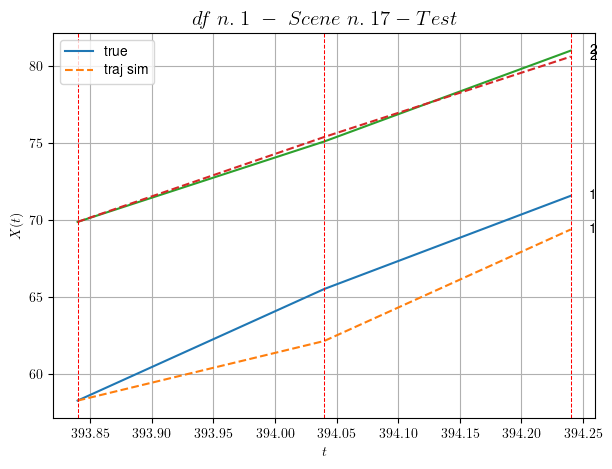

        For scene 17/99:
        * MSE = 2.741284108780494
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/99


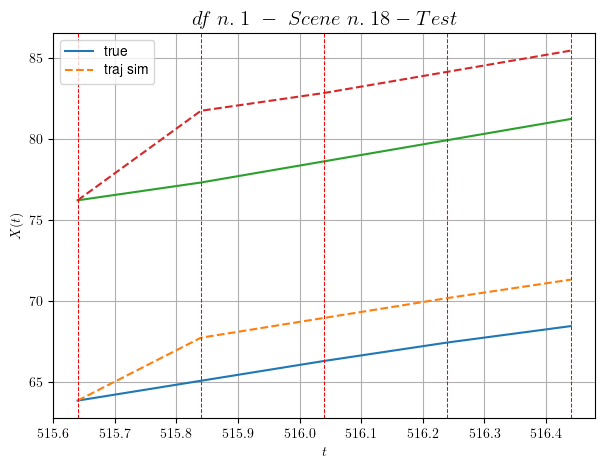

        For scene 18/99:
        * MSE = 10.257652223634107
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/99


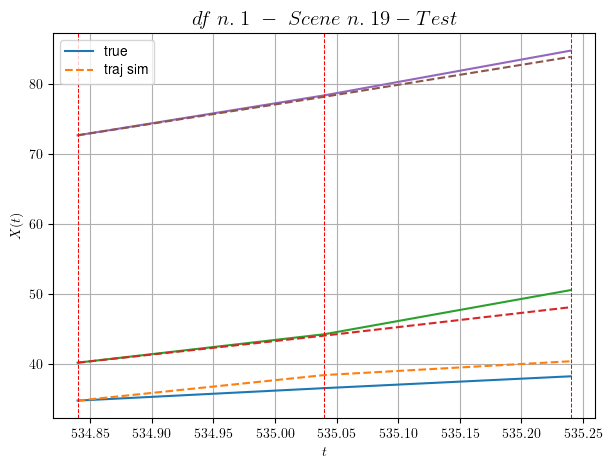

        For scene 19/99:
        * MSE = 1.6719665712930711
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/99


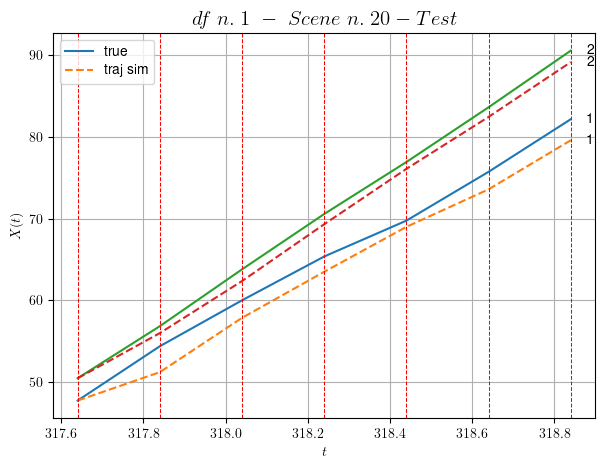

        For scene 20/99:
        * MSE = 2.738958842159495
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/99


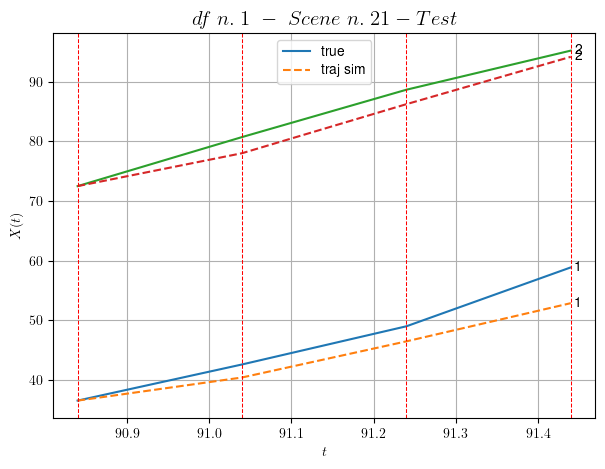

        For scene 21/99:
        * MSE = 7.6780104664296385
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/99


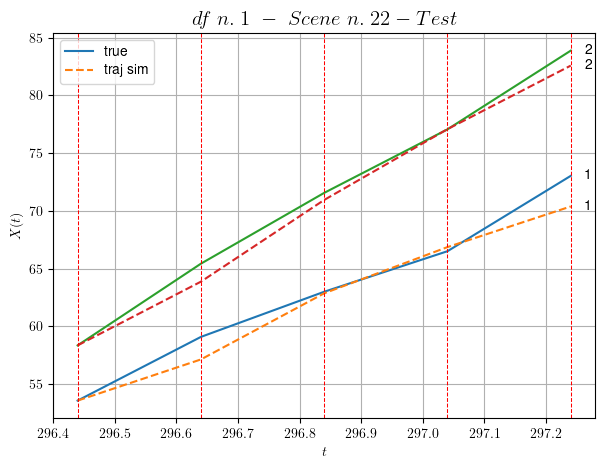

        For scene 22/99:
        * MSE = 1.5463356974480398
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/99


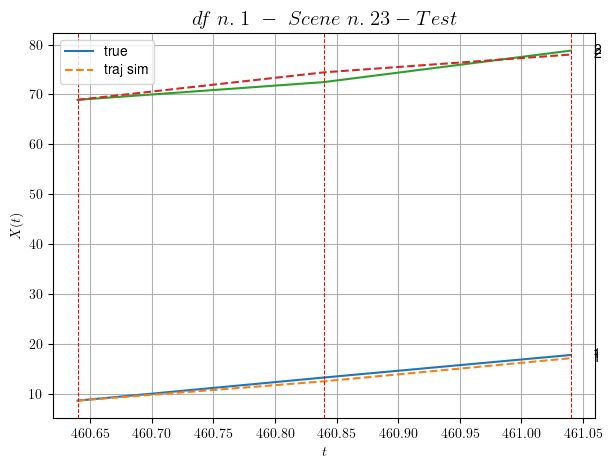

        For scene 23/99:
        * MSE = 0.9040649946175454
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/99


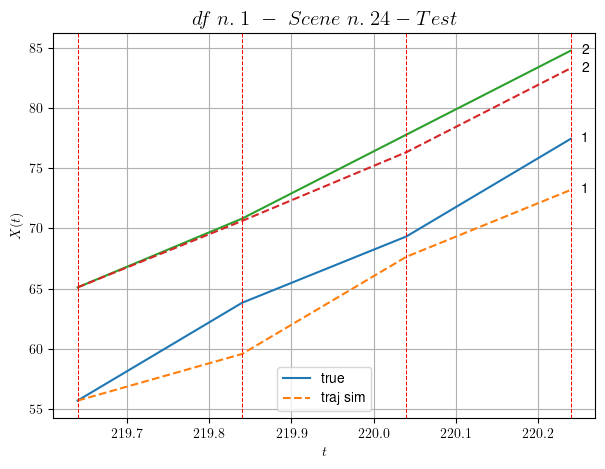

        For scene 24/99:
        * MSE = 5.400540892815924
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/99


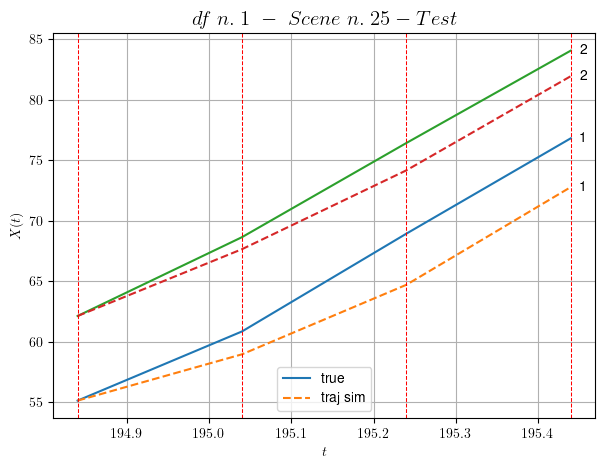

        For scene 25/99:
        * MSE = 6.019623865136355
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/99


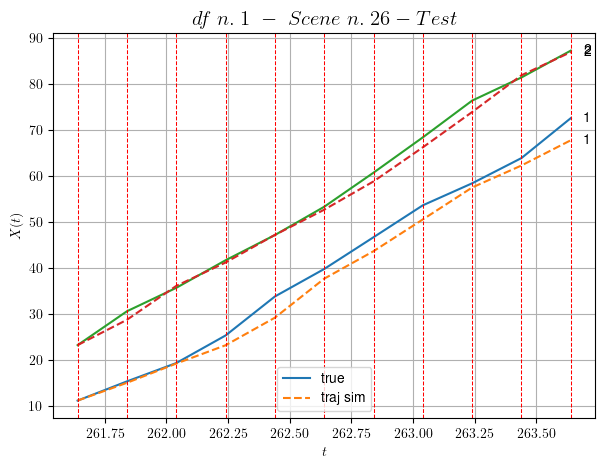

        For scene 26/99:
        * MSE = 4.310854169901647
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/99


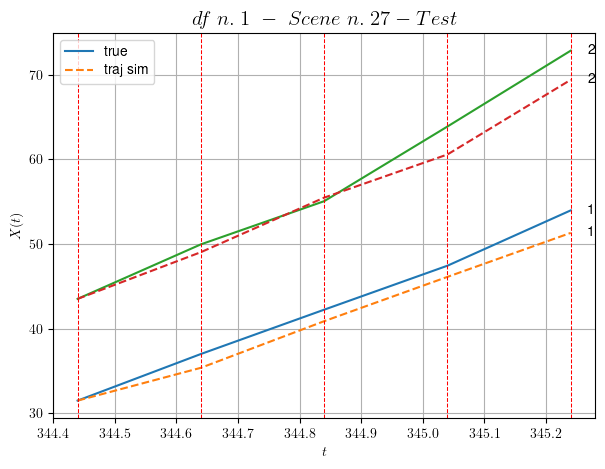

        For scene 27/99:
        * MSE = 3.710668810014564
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/99


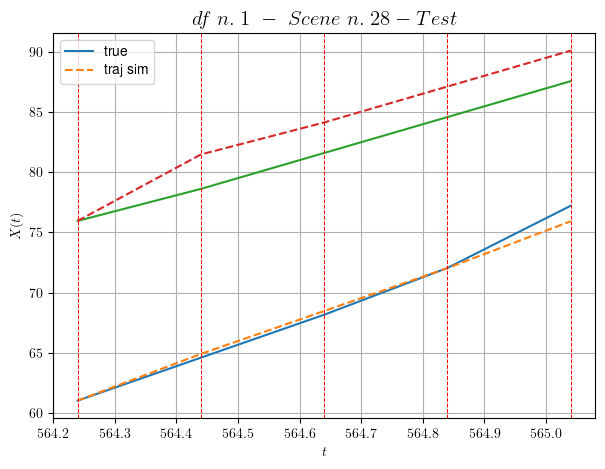

        For scene 28/99:
        * MSE = 2.930497607596599
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/99


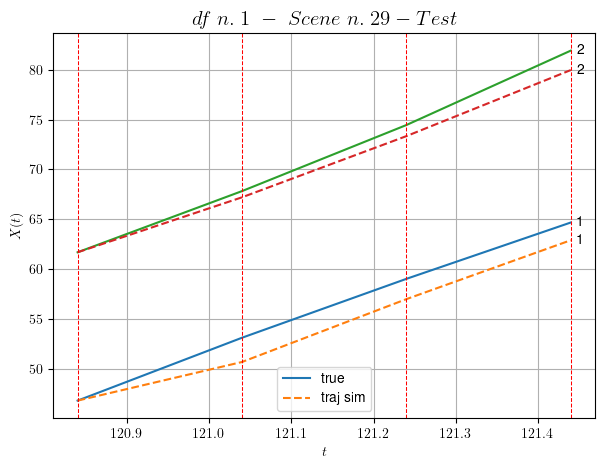

        For scene 29/99:
        * MSE = 2.3330149451678484
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/99


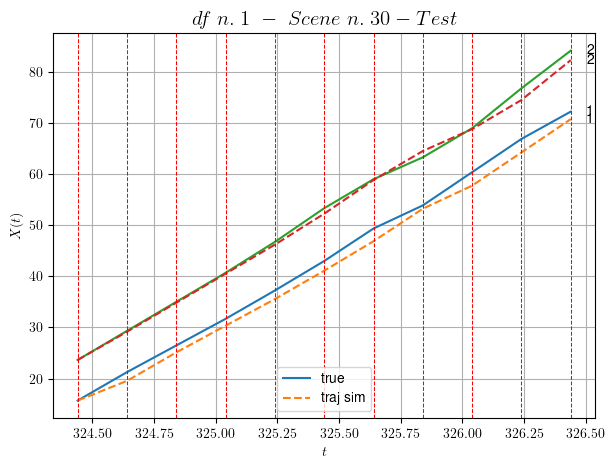

        For scene 30/99:
        * MSE = 2.156646435607297
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/99


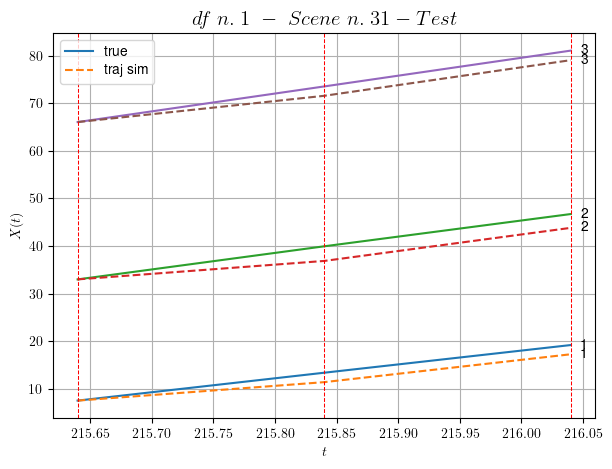

        For scene 31/99:
        * MSE = 3.709764403670895
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/99


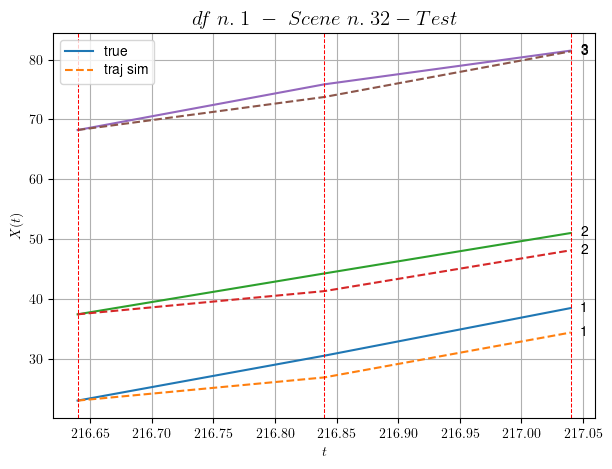

        For scene 32/99:
        * MSE = 5.715574098006442
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/99


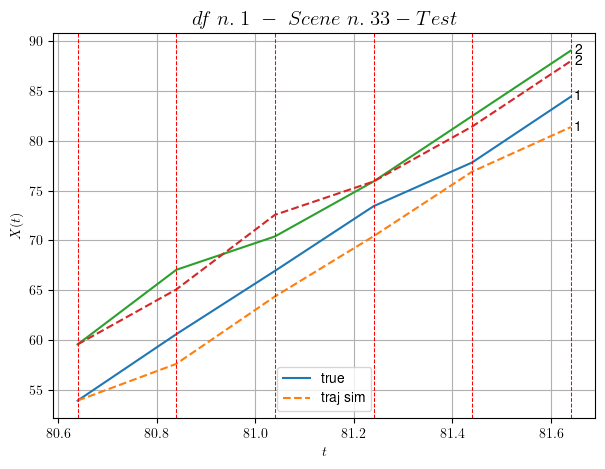

        For scene 33/99:
        * MSE = 3.793120018524772
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/99


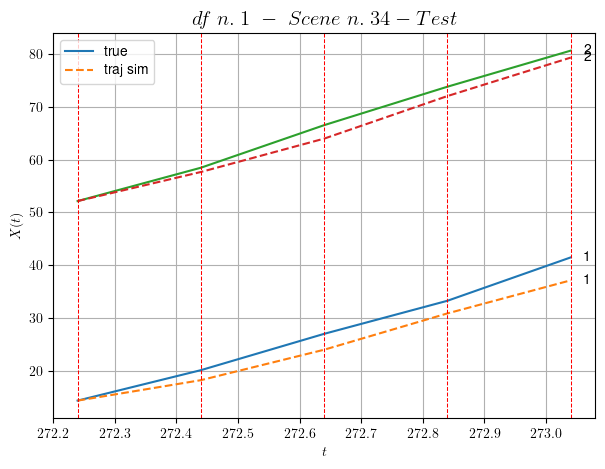

        For scene 34/99:
        * MSE = 4.936139852876747
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/99


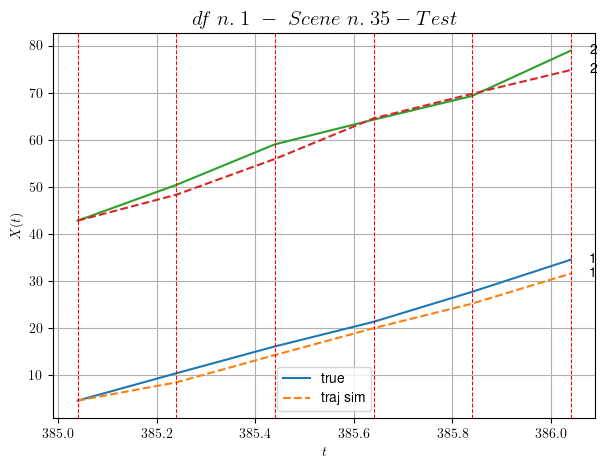

        For scene 35/99:
        * MSE = 4.610148390348763
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/99


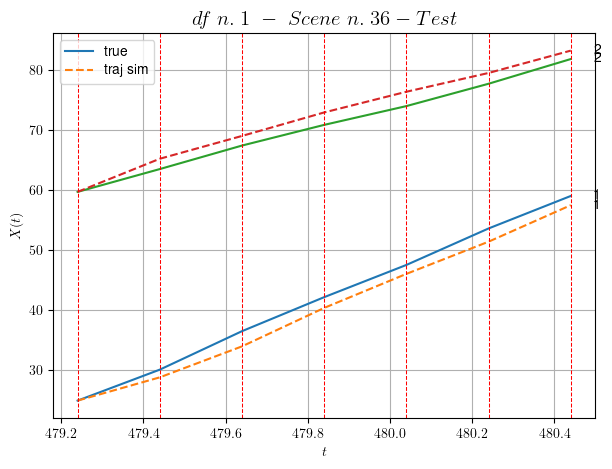

        For scene 36/99:
        * MSE = 2.9578525004366893
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.37/99


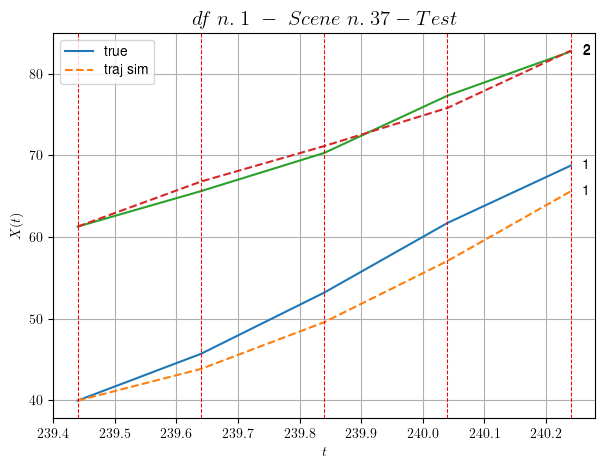

        For scene 37/99:
        * MSE = 5.250530414982814
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.38/99


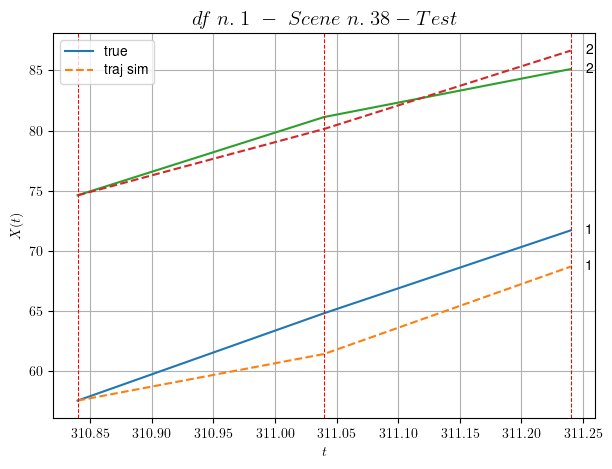

        For scene 38/99:
        * MSE = 3.9777059245580055
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.39/99


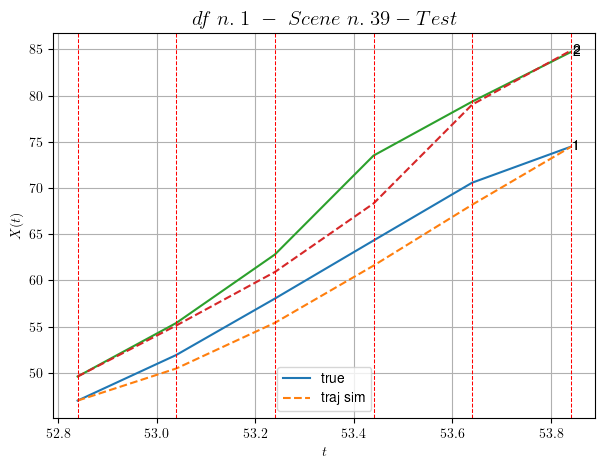

        For scene 39/99:
        * MSE = 4.395094002448009
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.40/99


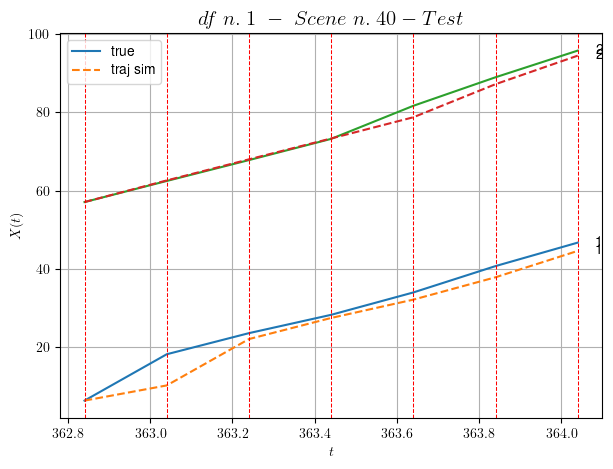

        For scene 40/99:
        * MSE = 6.83335047747381
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.41/99


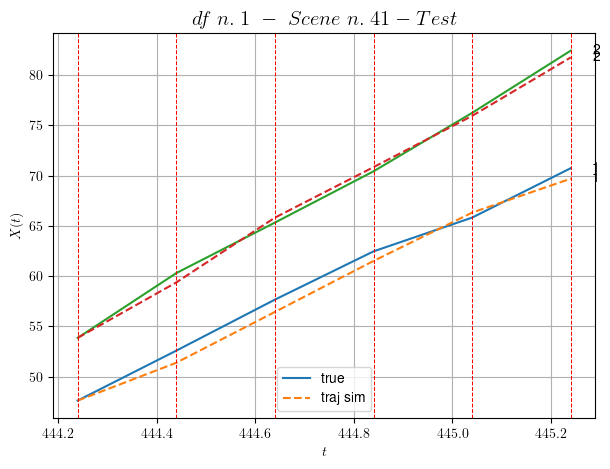

        For scene 41/99:
        * MSE = 0.5854219073243871
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.42/99


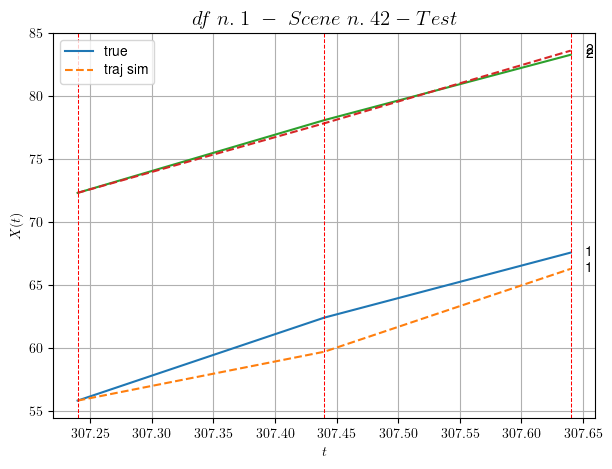

        For scene 42/99:
        * MSE = 1.5236309906881655
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.43/99


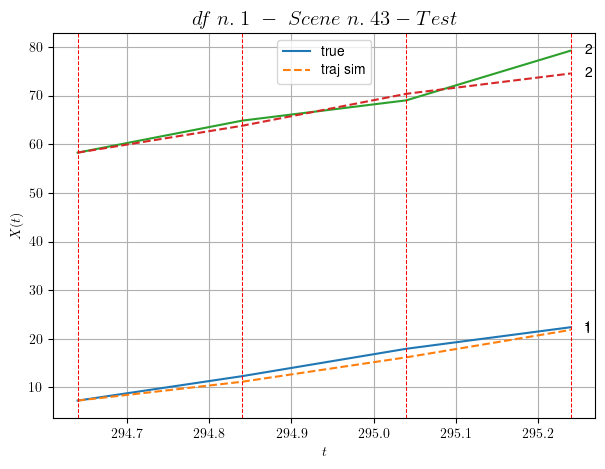

        For scene 43/99:
        * MSE = 3.7100289784111924
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.44/99


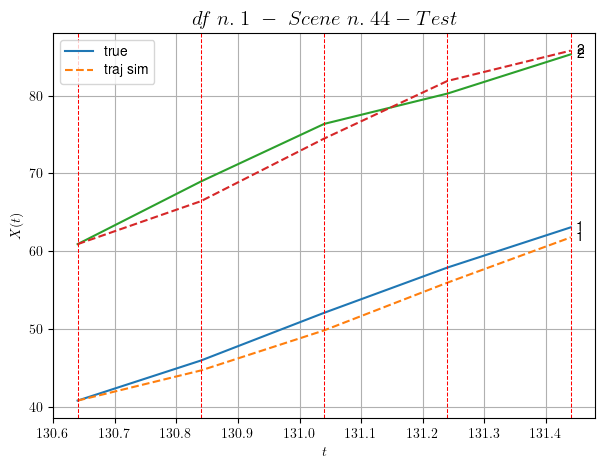

        For scene 44/99:
        * MSE = 2.4969703334811366
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.45/99


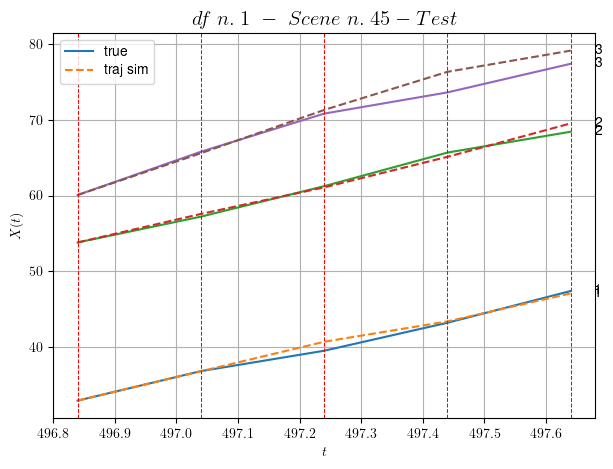

        For scene 45/99:
        * MSE = 0.9265638311008982
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.46/99


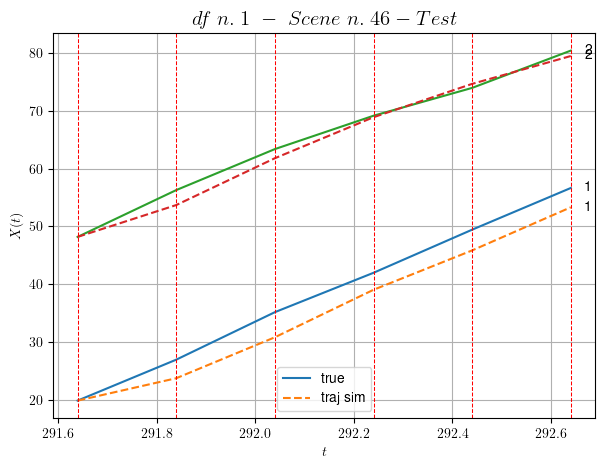

        For scene 46/99:
        * MSE = 6.047609715689268
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.47/99


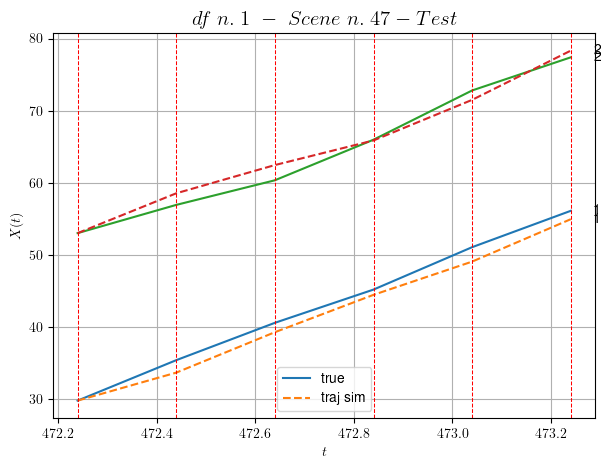

        For scene 47/99:
        * MSE = 1.678088775444805
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.48/99


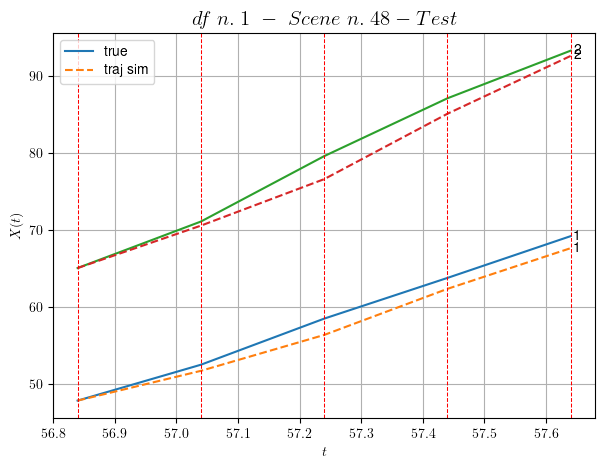

        For scene 48/99:
        * MSE = 2.3363090214437863
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.49/99


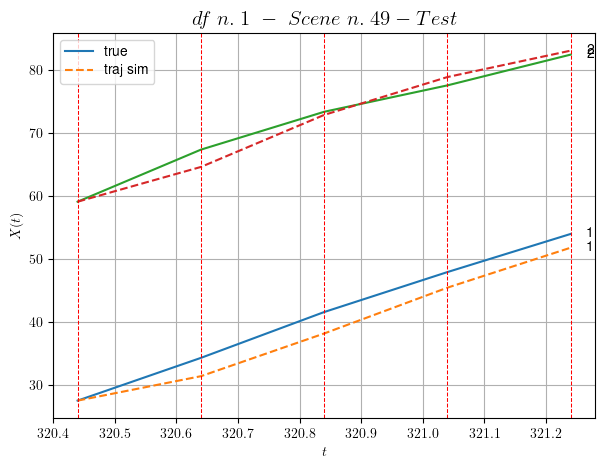

        For scene 49/99:
        * MSE = 4.089817815595021
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.50/99


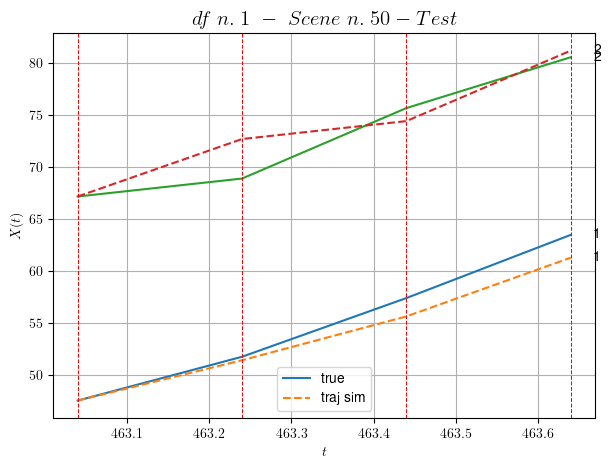

        For scene 50/99:
        * MSE = 3.049519321214381
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.51/99


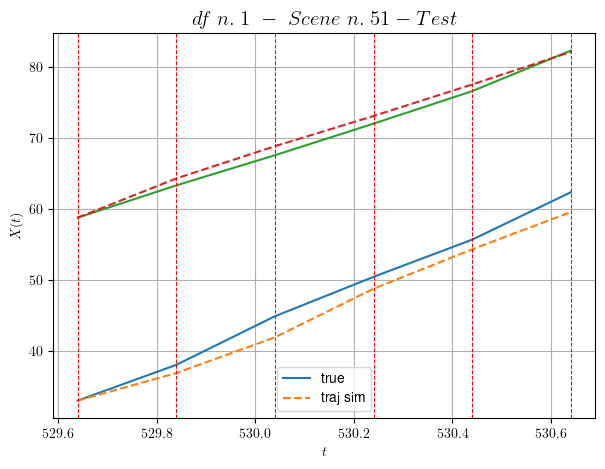

        For scene 51/99:
        * MSE = 2.2702422225708996
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.52/99


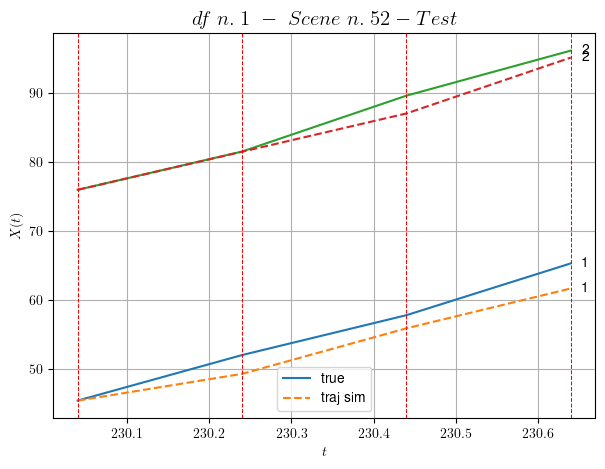

        For scene 52/99:
        * MSE = 3.9863299107356243
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.53/99


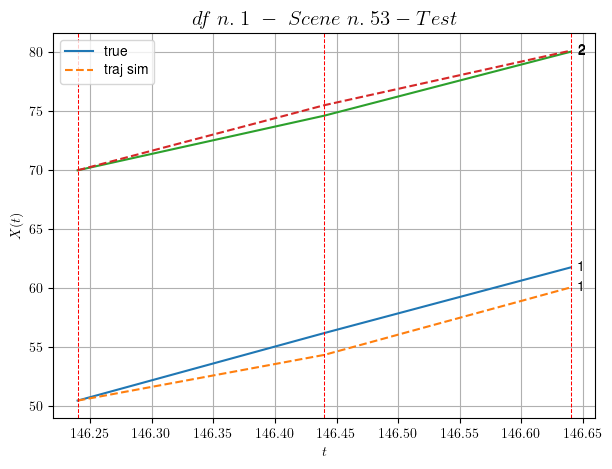

        For scene 53/99:
        * MSE = 1.1820804313031141
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.54/99


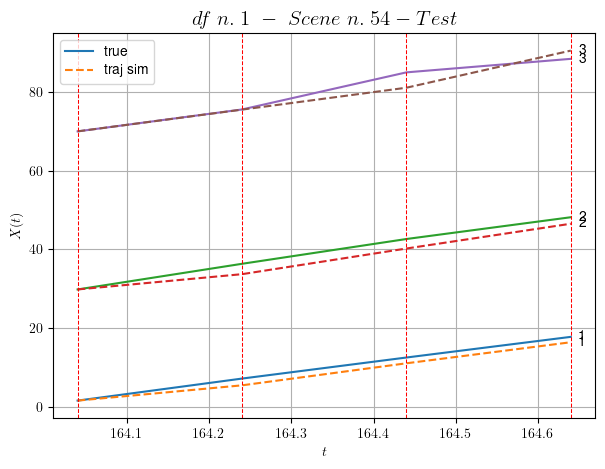

        For scene 54/99:
        * MSE = 3.492087529165849
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.55/99


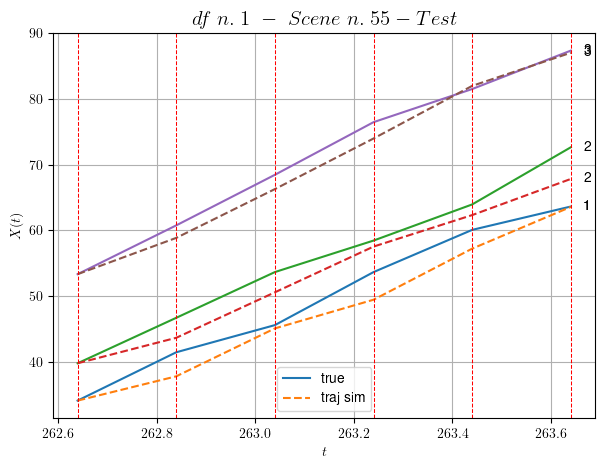

        For scene 55/99:
        * MSE = 5.533965407391825
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.56/99


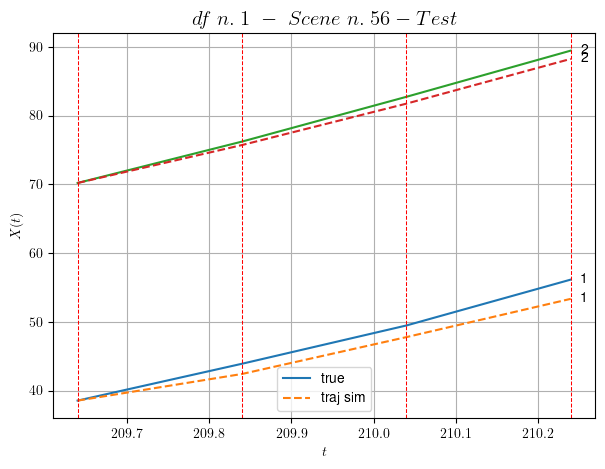

        For scene 56/99:
        * MSE = 1.9500821053490471
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.57/99


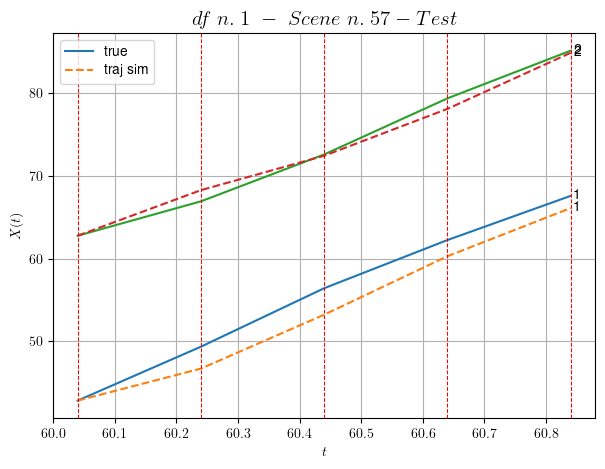

        For scene 57/99:
        * MSE = 2.684012897355187
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.58/99


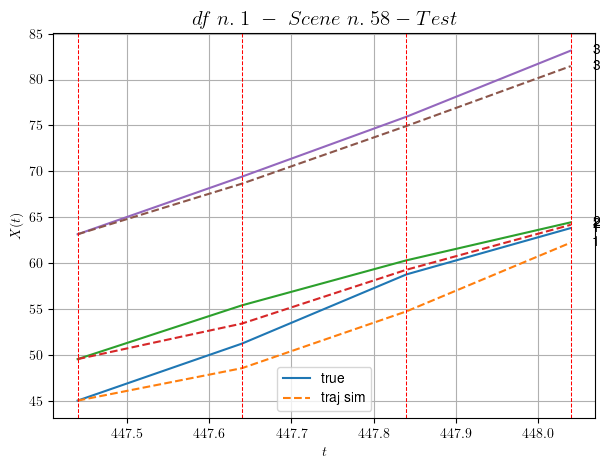

        For scene 58/99:
        * MSE = 2.95438534685346
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.59/99


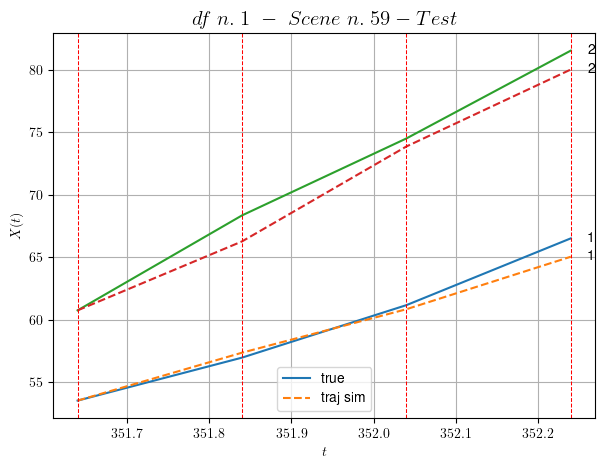

        For scene 59/99:
        * MSE = 1.1828125858032643
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.60/99


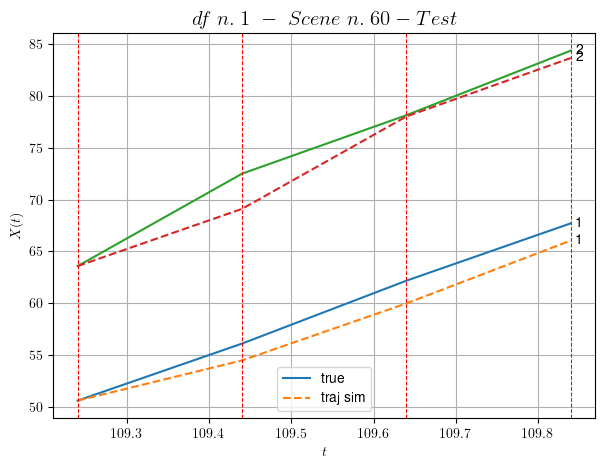

        For scene 60/99:
        * MSE = 2.7760821067628156
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.61/99


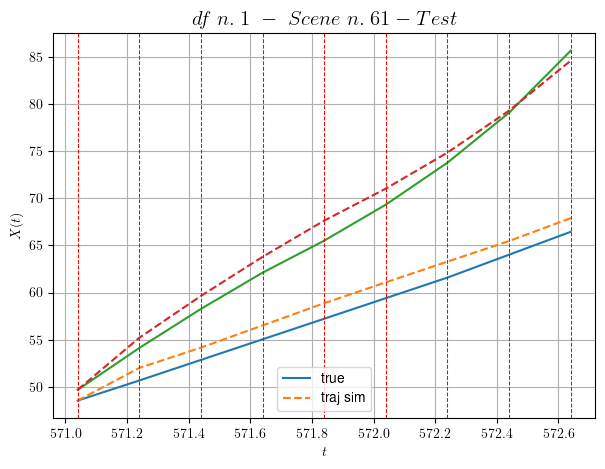

        For scene 61/99:
        * MSE = 1.8773638621063964
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.62/99


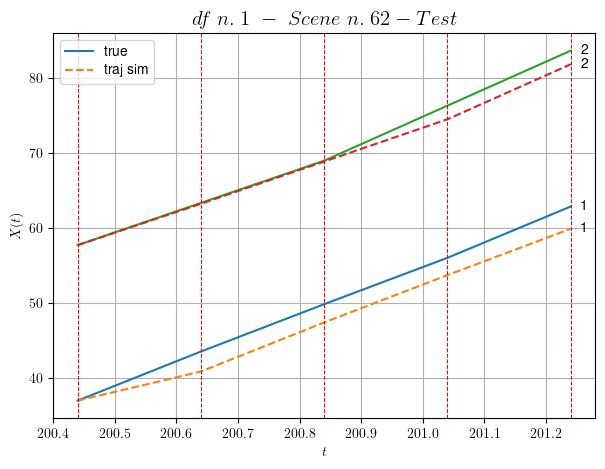

        For scene 62/99:
        * MSE = 3.3807364416499235
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.63/99


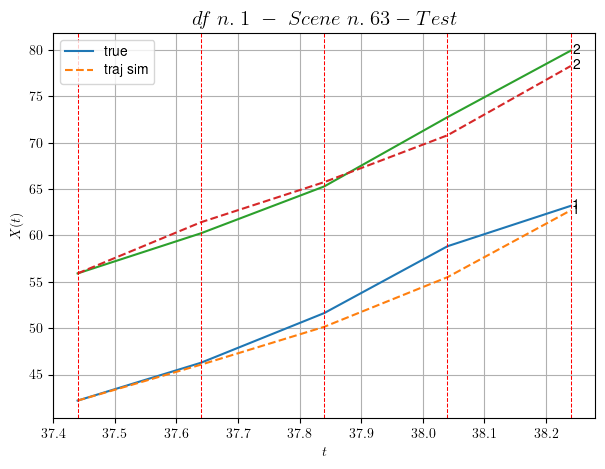

        For scene 63/99:
        * MSE = 2.1772934194817006
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.64/99


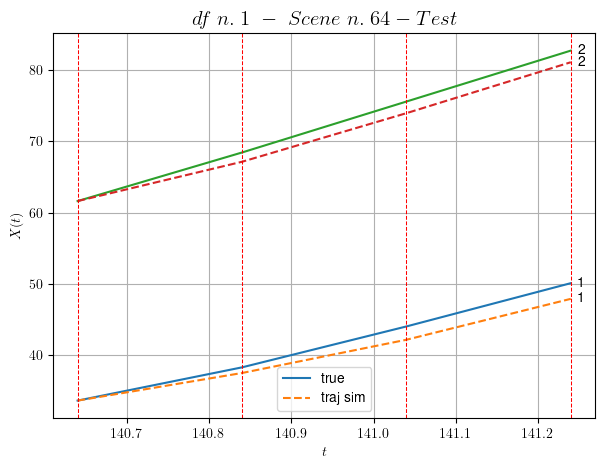

        For scene 64/99:
        * MSE = 1.9974983848103314
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.65/99


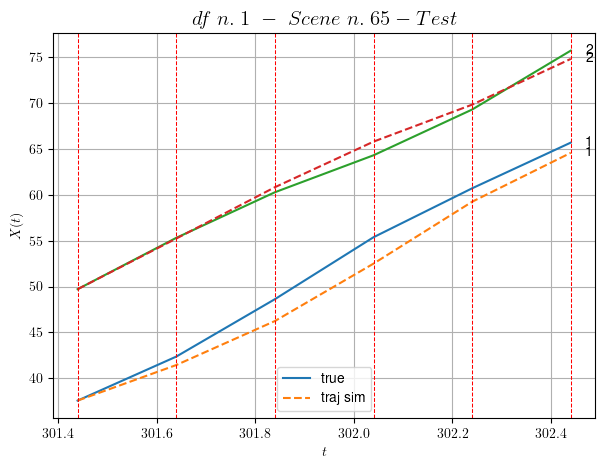

        For scene 65/99:
        * MSE = 1.8161914698364412
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.66/99


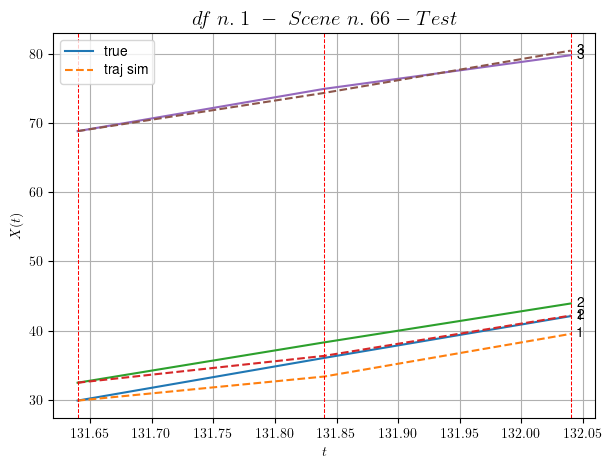

        For scene 66/99:
        * MSE = 2.374028796712152
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.67/99


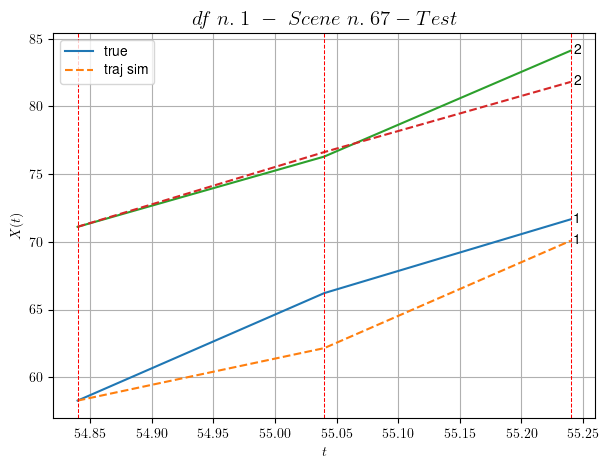

        For scene 67/99:
        * MSE = 4.073643866194113
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.68/99


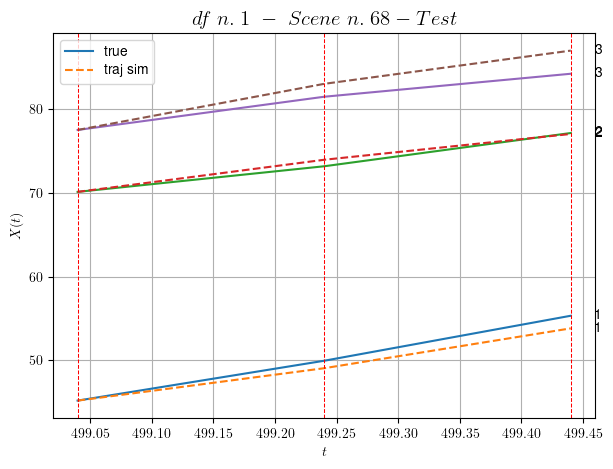

        For scene 68/99:
        * MSE = 1.5258908799913744
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.69/99


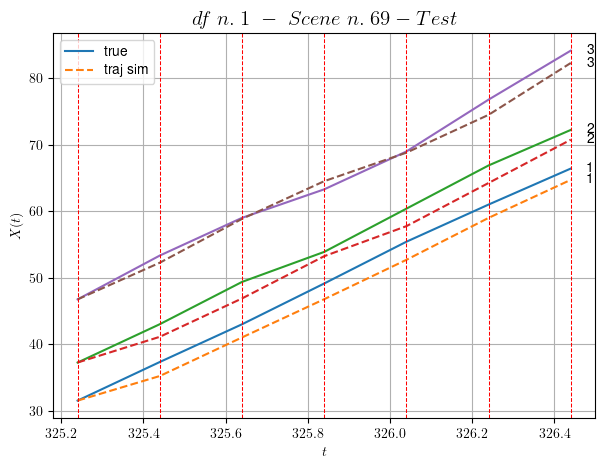

        For scene 69/99:
        * MSE = 3.139909914774163
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.70/99


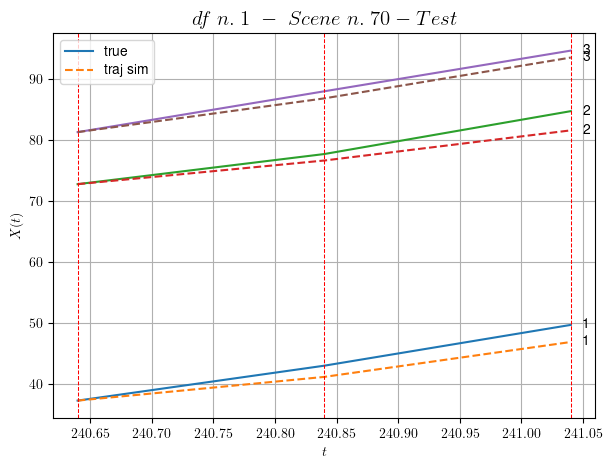

        For scene 70/99:
        * MSE = 2.7553313367874264
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.71/99


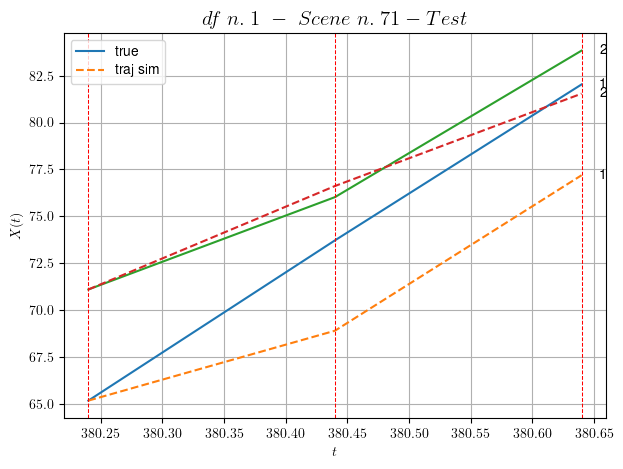

        For scene 71/99:
        * MSE = 8.716239989584878
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.72/99


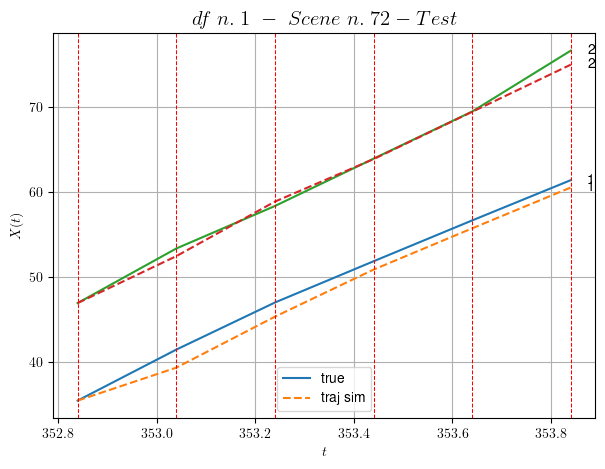

        For scene 72/99:
        * MSE = 1.1410021526895076
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.73/99


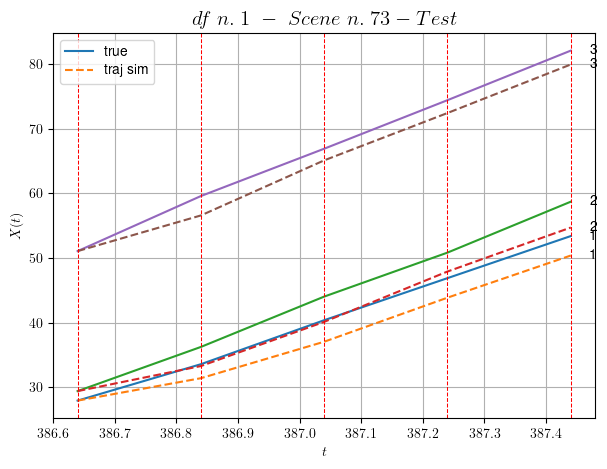

        For scene 73/99:
        * MSE = 6.881679384476949
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.74/99


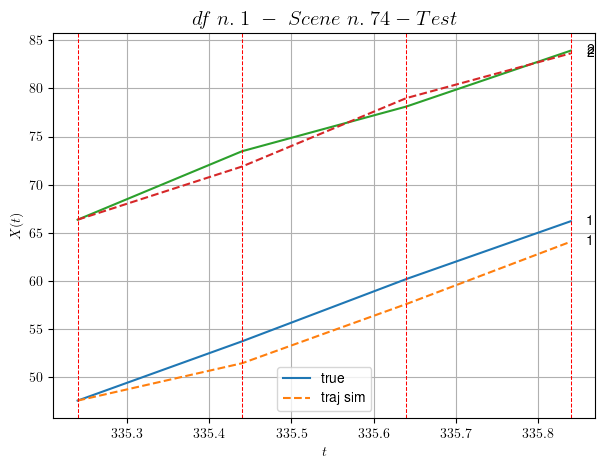

        For scene 74/99:
        * MSE = 2.4739732084795185
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.75/99


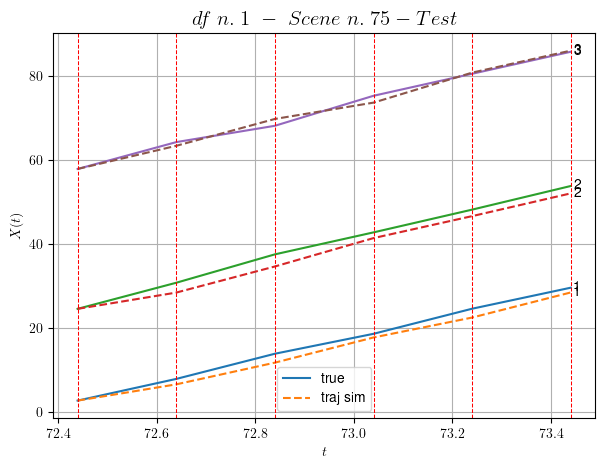

        For scene 75/99:
        * MSE = 2.2271667308232352
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.76/99


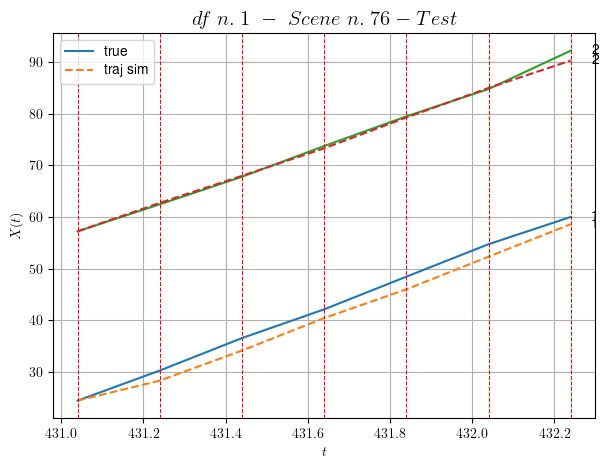

        For scene 76/99:
        * MSE = 2.175878125239169
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.77/99


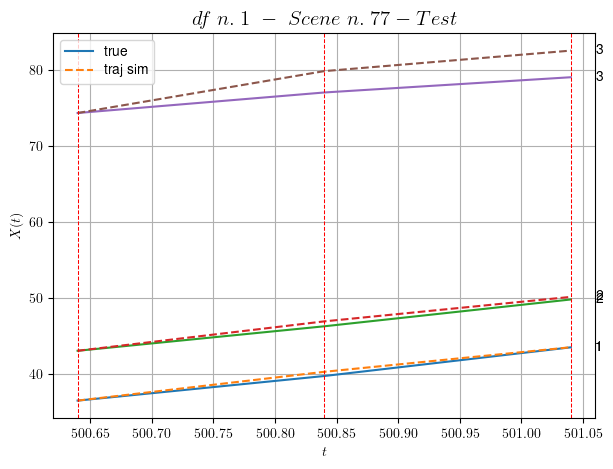

        For scene 77/99:
        * MSE = 2.341263113442594
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.78/99


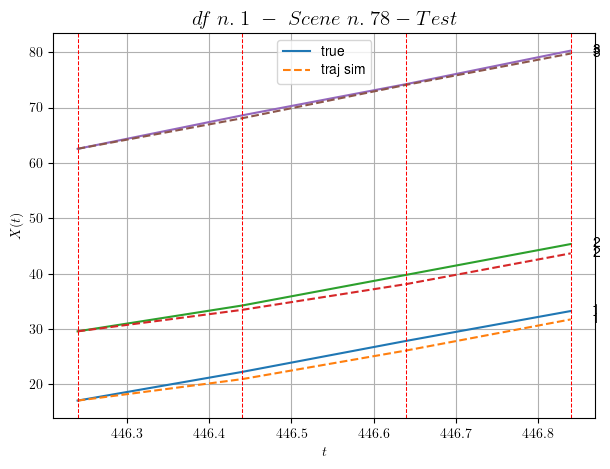

        For scene 78/99:
        * MSE = 1.1498584537024776
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.79/99


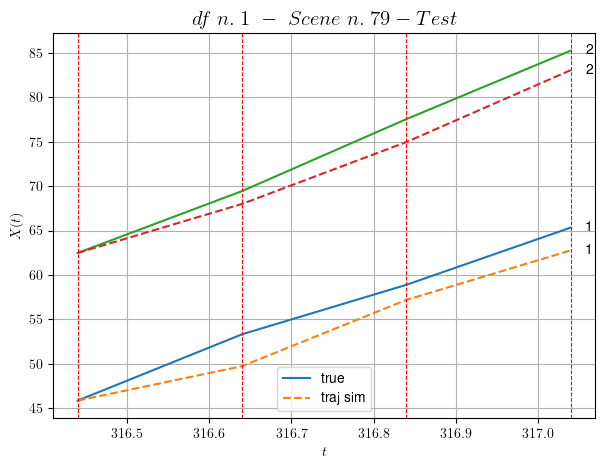

        For scene 79/99:
        * MSE = 4.481675407223869
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.80/99


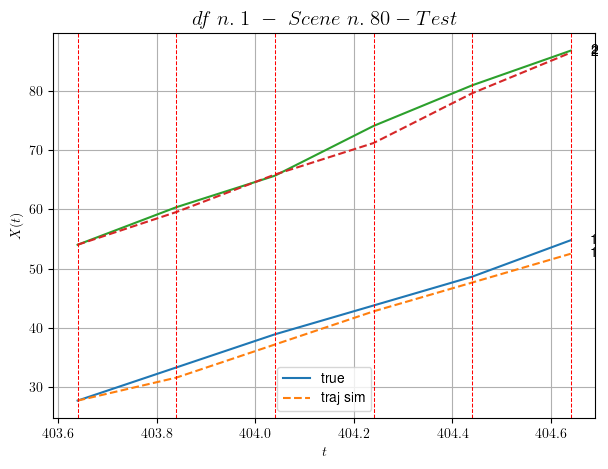

        For scene 80/99:
        * MSE = 2.0035499056453987
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.81/99


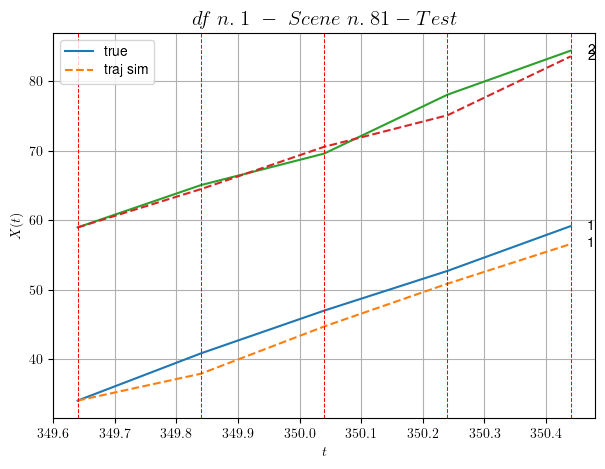

        For scene 81/99:
        * MSE = 3.462438823294786
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.82/99


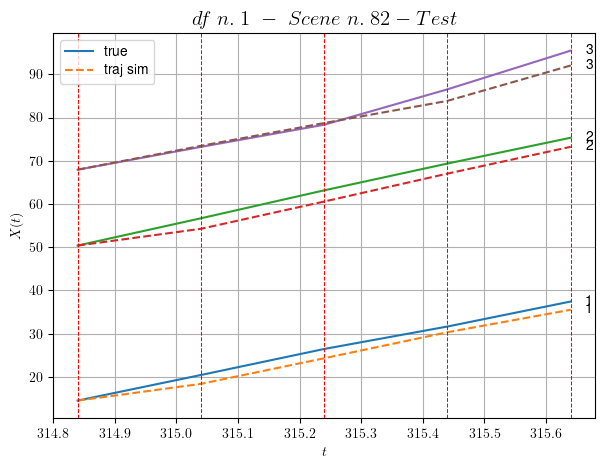

        For scene 82/99:
        * MSE = 3.7251101651036786
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.83/99


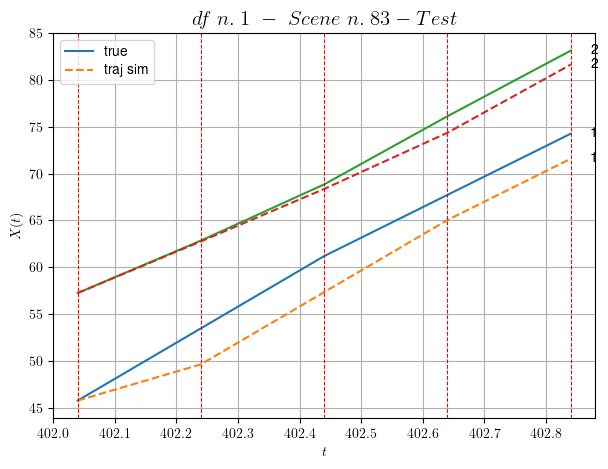

        For scene 83/99:
        * MSE = 4.956746819251944
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.84/99


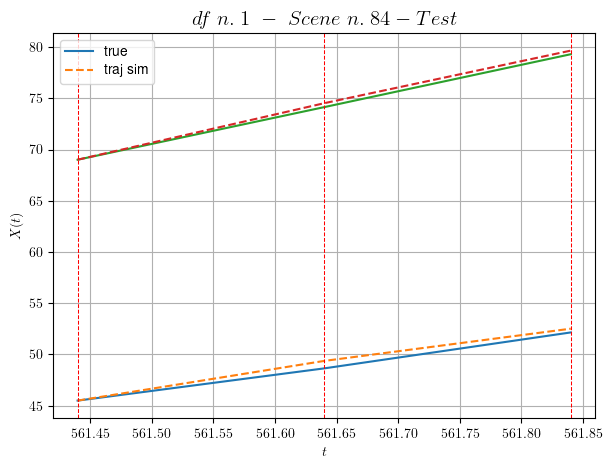

        For scene 84/99:
        * MSE = 0.1558365386069921
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.85/99


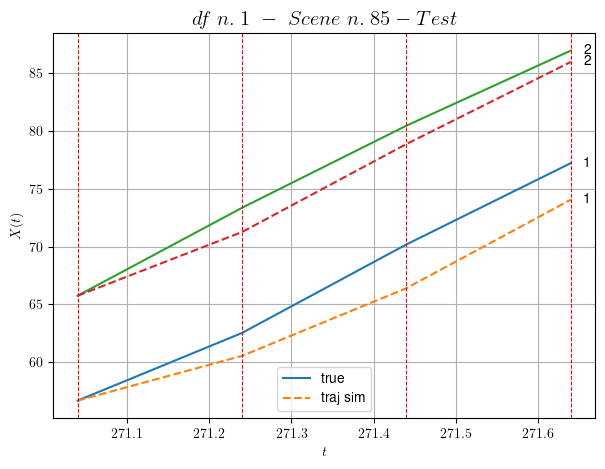

        For scene 85/99:
        * MSE = 4.523304990381188
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.86/99


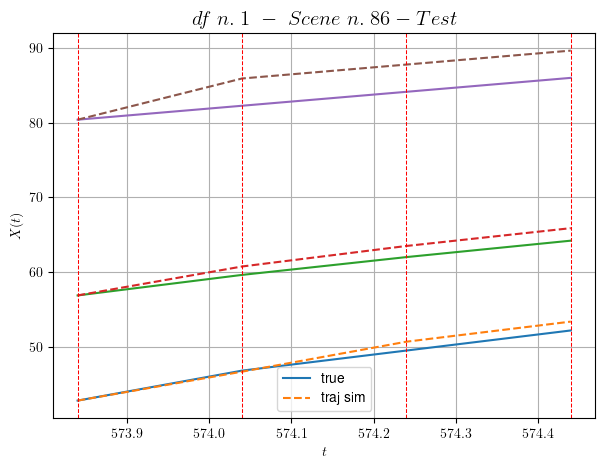

        For scene 86/99:
        * MSE = 4.0916425465298465
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.87/99


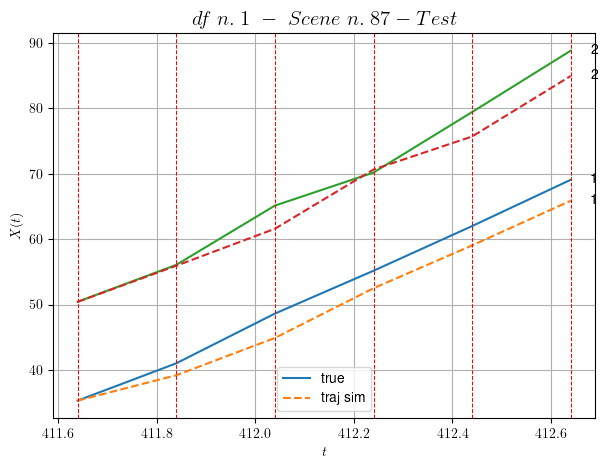

        For scene 87/99:
        * MSE = 7.0881523989128805
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.88/99


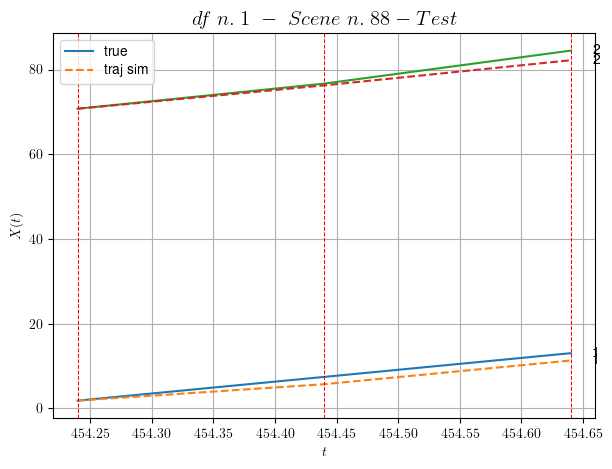

        For scene 88/99:
        * MSE = 1.8863380922521373
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.89/99


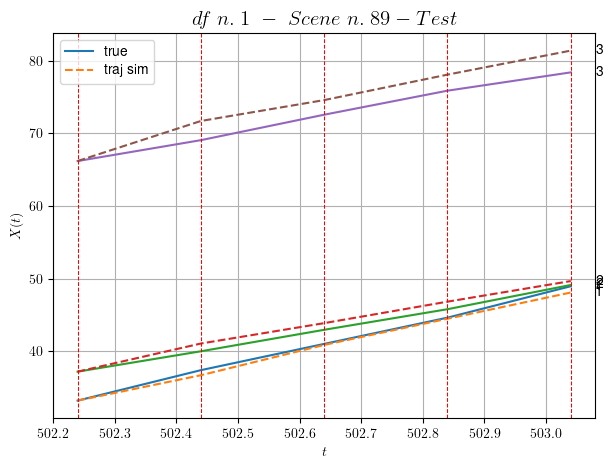

        For scene 89/99:
        * MSE = 1.968333964132032
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.90/99


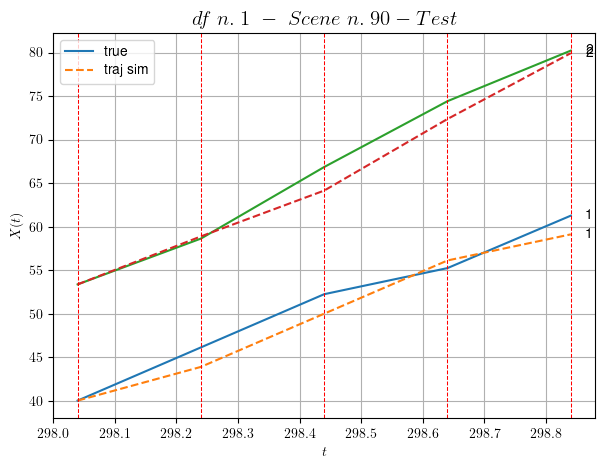

        For scene 90/99:
        * MSE = 2.7105063740021063
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.91/99


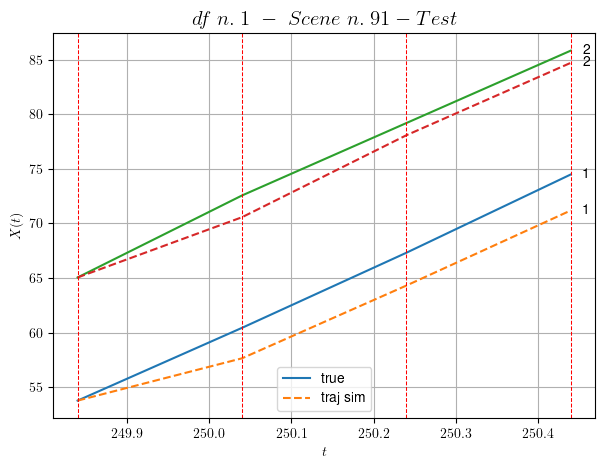

        For scene 91/99:
        * MSE = 4.270609255359677
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.92/99


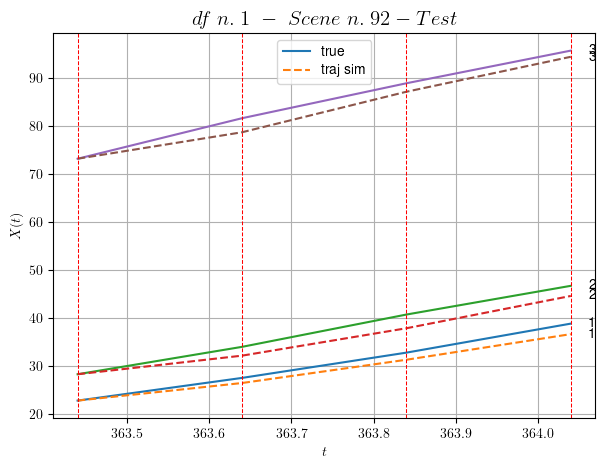

        For scene 92/99:
        * MSE = 3.121245827863126
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.93/99


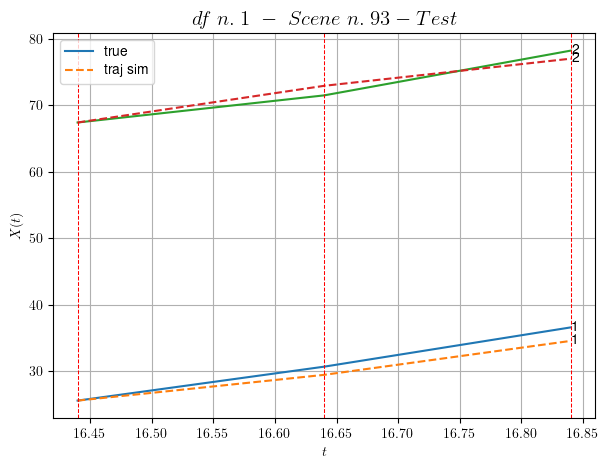

        For scene 93/99:
        * MSE = 1.5291861958731465
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.94/99


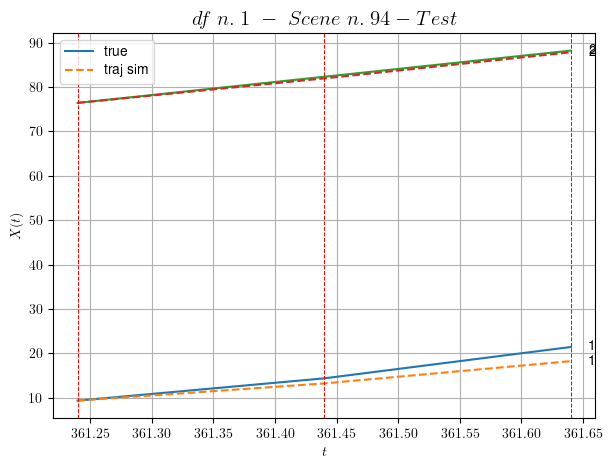

        For scene 94/99:
        * MSE = 1.956195446531023
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.95/99


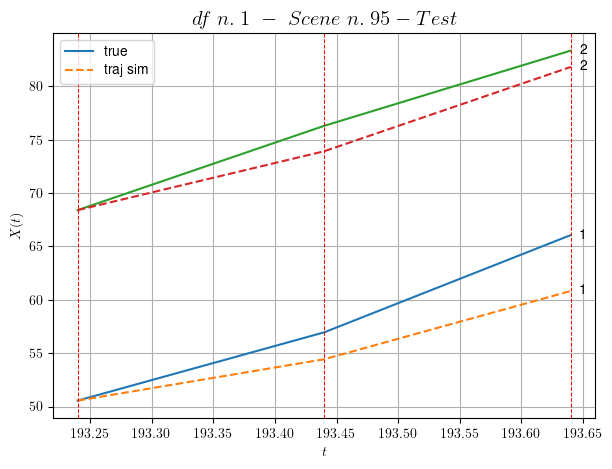

        For scene 95/99:
        * MSE = 6.972396955268875
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.96/99


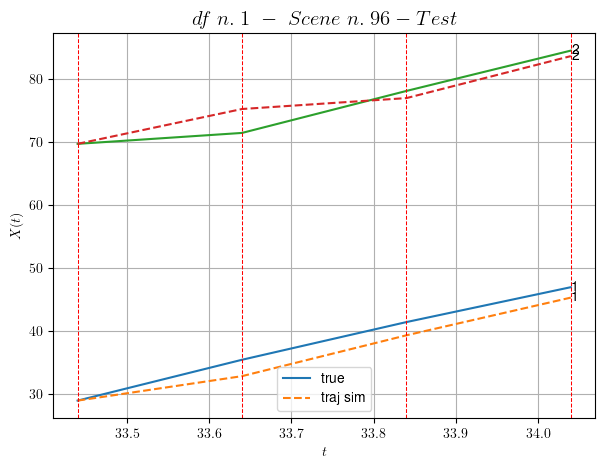

        For scene 96/99:
        * MSE = 3.7806816603392708
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.97/99


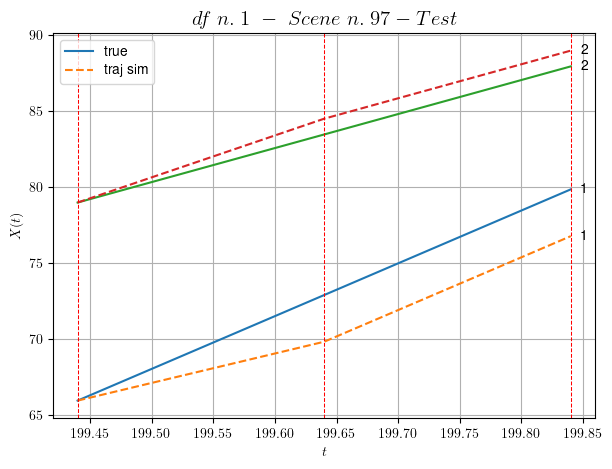

        For scene 97/99:
        * MSE = 3.5139900080618744
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.98/99


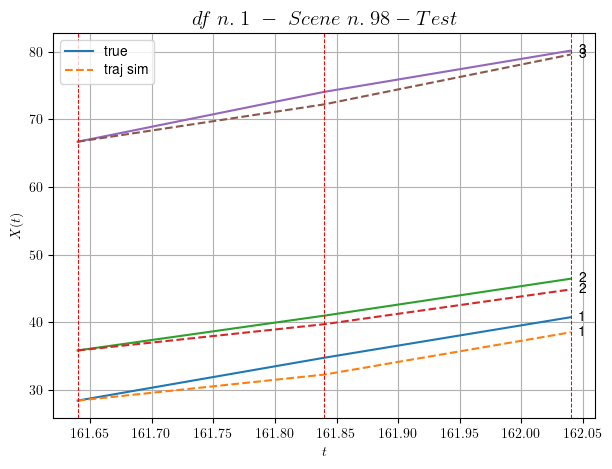

        For scene 98/99:
        * MSE = 2.1142896748196978
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.99/99


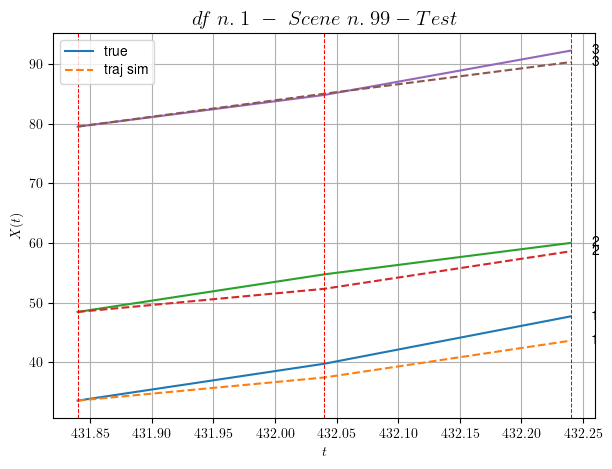

        For scene 99/99:
        * MSE = 3.715427311318947
----------------------------------------------------------------------------------------------------


MSE test: 3.207046161089761

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 11.90598983924709
          * MSE test: 3.207046161089761
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 2/10 dfs.
In DataFrame n.2 we have 69 scenes.
    To train the model we use 6 scenes, the remaining 63 to test the model.

Training step. (6 scenes)
DataFrame n.2. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [52.76,53.56]


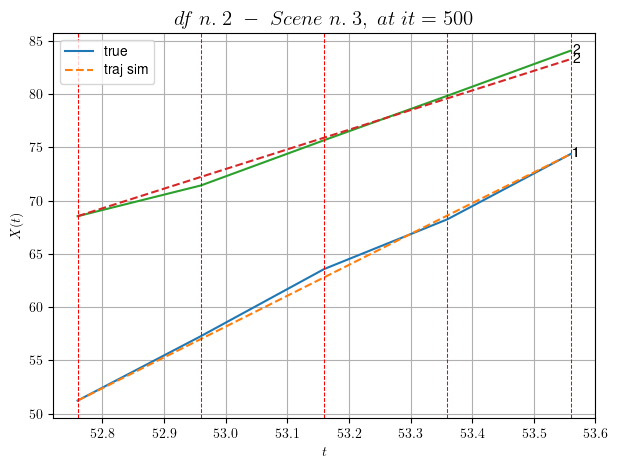

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=0.0005 with mse=15.06304967788414 at it=24
        * v0 = 18.434937295304415
        * MSE = 0.1988449672404296
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [250.16,250.96]


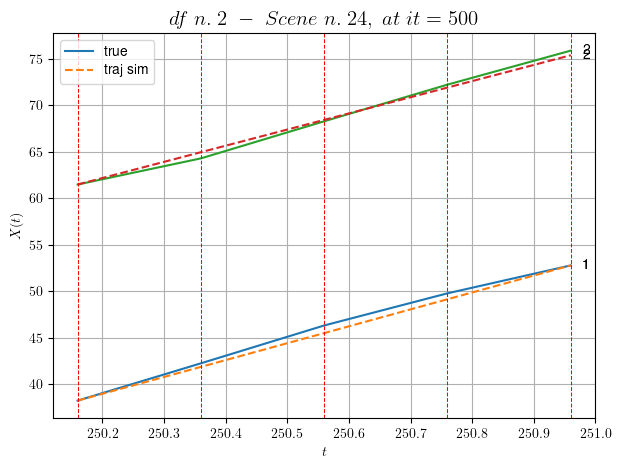

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=0.0005 with mse=18.421330019442053 at it=24
        * v0 = 17.364515373912923
        * MSE = 0.1928702191585775
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [223.16,223.56]


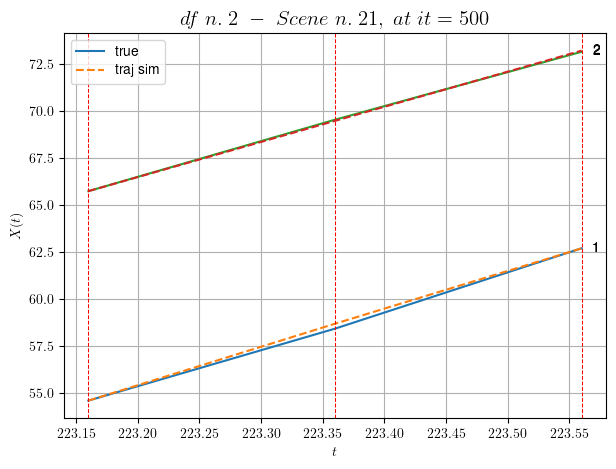

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=0.005 with mse=4.319020087945993 at it=24
        * v0 = 18.698370205341323
        * MSE = 0.012550138939925326
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [442.76,443.76]


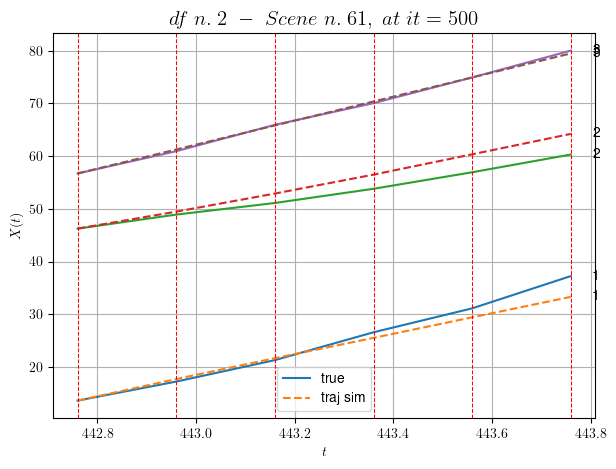

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=0.005 with mse=11.400099126225683 at it=24
        * v0 = 22.775896802504967
        * MSE = 3.224901918847758
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [198.16,200.16]


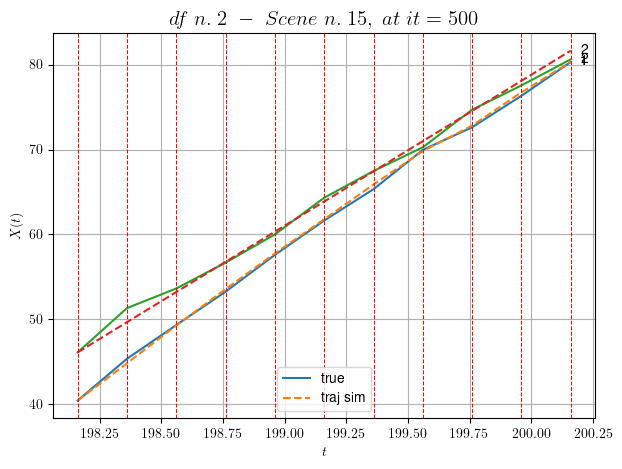

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=0.0005 with mse=108.80430546242499 at it=24
        * v0 = 17.756279251513085
        * MSE = 0.2753774671618213
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.16,86.96]


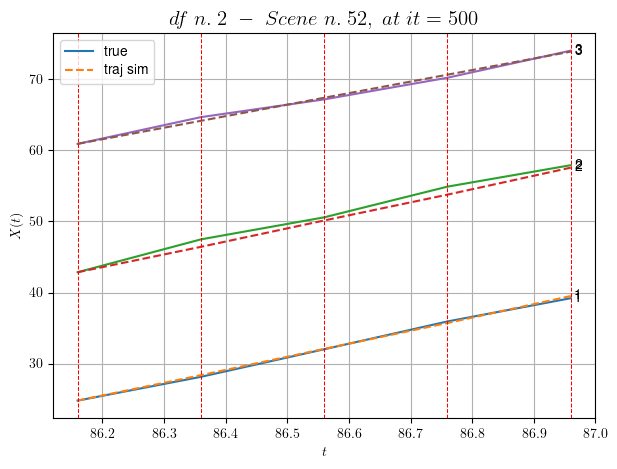

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.01 with mse=15.776936790571874 at it=24
        * v0 = 16.235330060145962
        * MSE = 0.22664292881893858
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.6885312733612418
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (63 scenes)
DataFrame n.2. Scene n.1/63


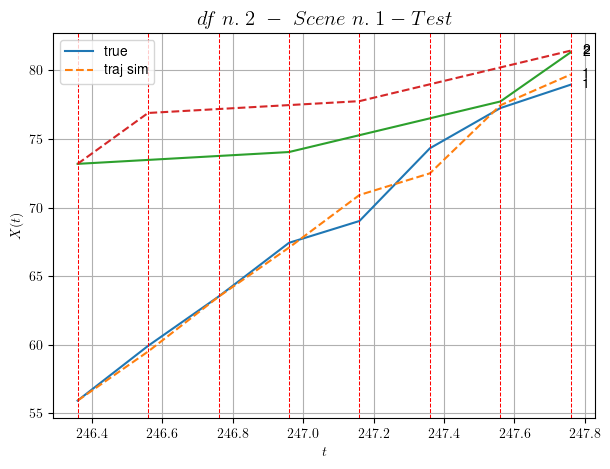

        For scene 1/63:
        * MSE = 3.8376909166025417
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/63


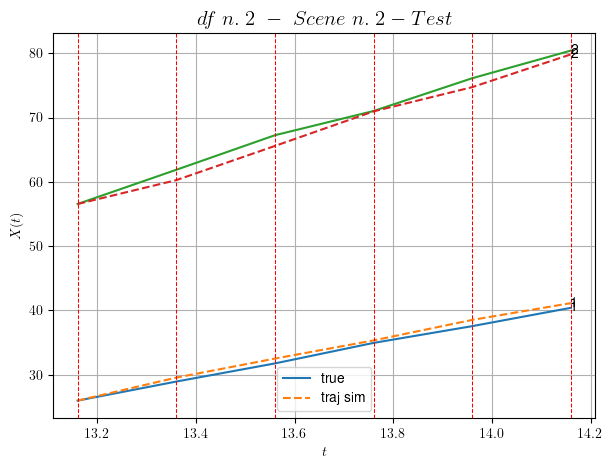

        For scene 2/63:
        * MSE = 0.8519305218559589
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/63


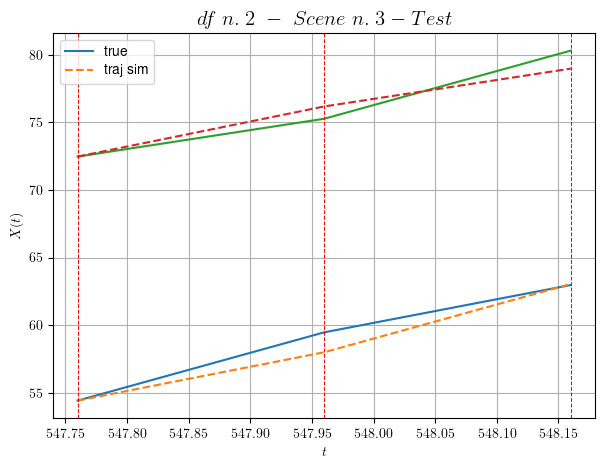

        For scene 3/63:
        * MSE = 0.7959840438137127
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/63


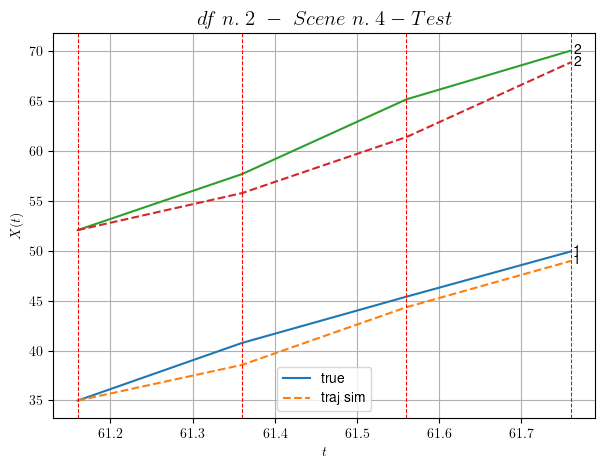

        For scene 4/63:
        * MSE = 3.269542882576194
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/63


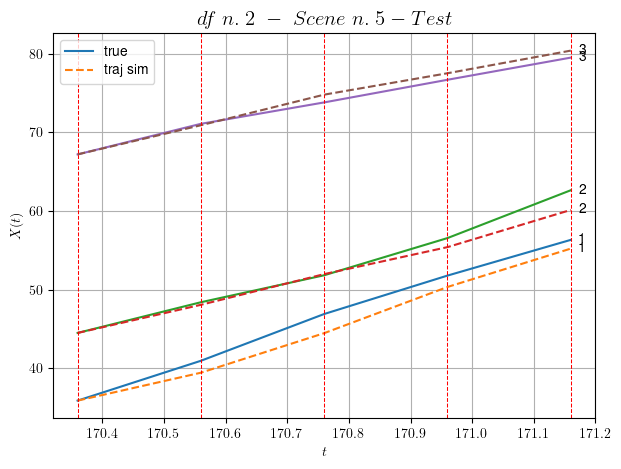

        For scene 5/63:
        * MSE = 1.4522582618920072
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/63


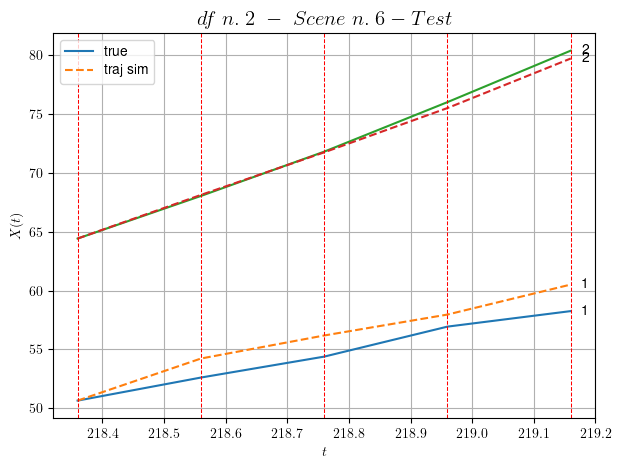

        For scene 6/63:
        * MSE = 1.2702198475332978
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/63


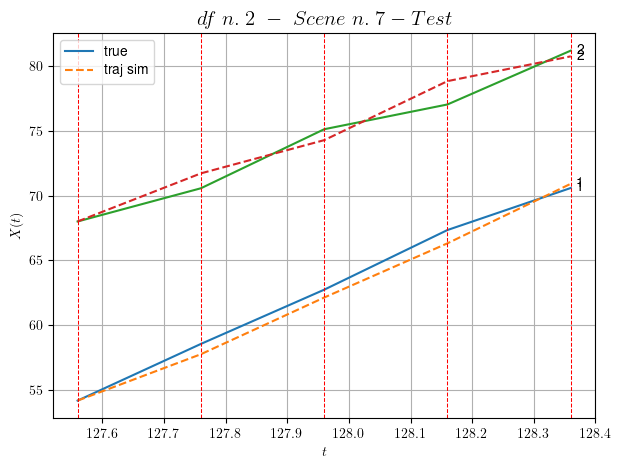

        For scene 7/63:
        * MSE = 0.7608259723670707
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/63


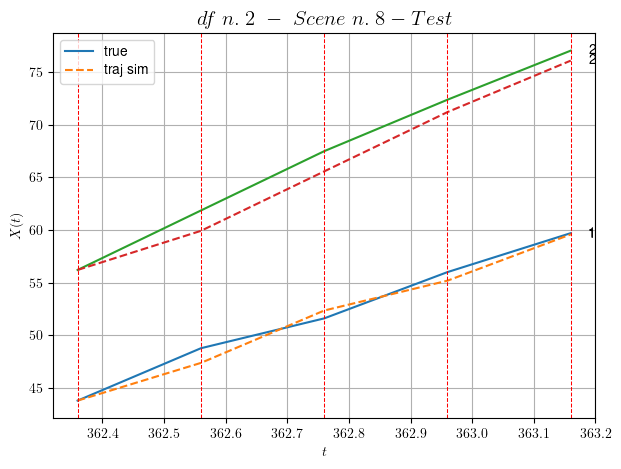

        For scene 8/63:
        * MSE = 1.2851252469423615
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/63


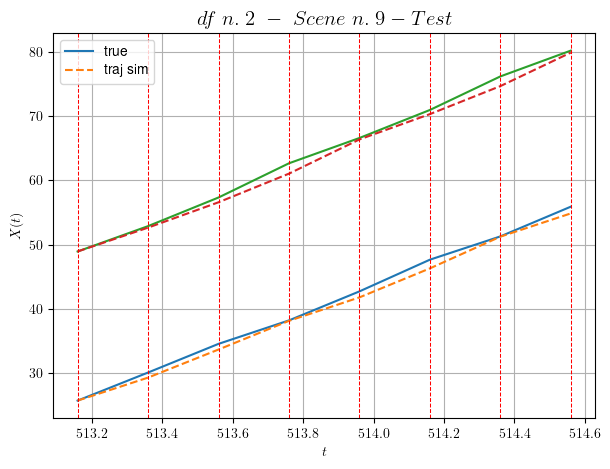

        For scene 9/63:
        * MSE = 0.7021050602479877
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/63


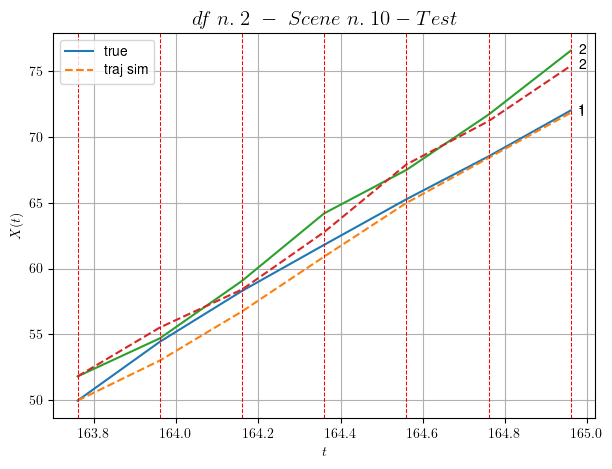

        For scene 10/63:
        * MSE = 0.7311505082098269
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/63


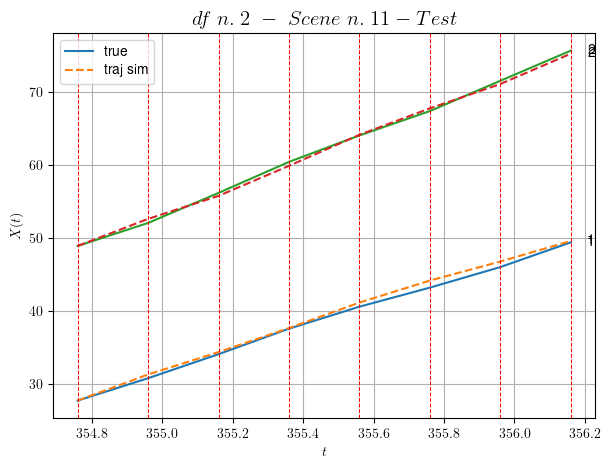

        For scene 11/63:
        * MSE = 0.21938433139331914
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/63


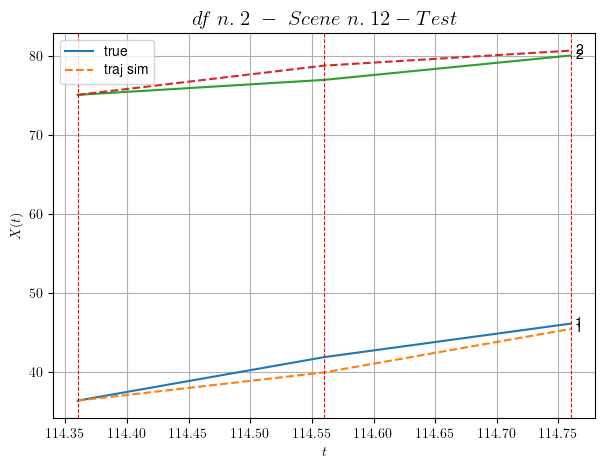

        For scene 12/63:
        * MSE = 1.3087170861173223
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/63


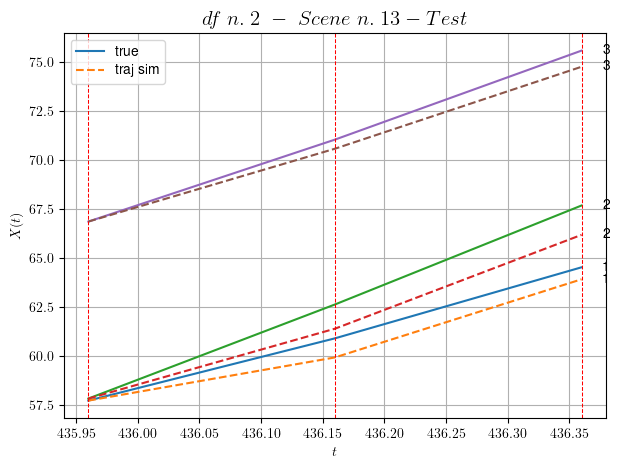

        For scene 13/63:
        * MSE = 0.6622808801136809
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/63


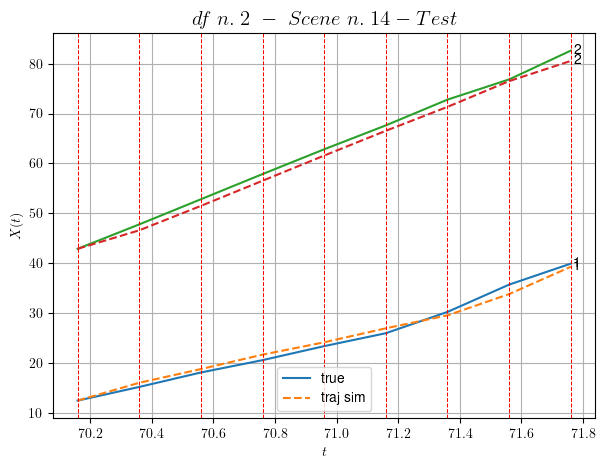

        For scene 14/63:
        * MSE = 1.2583921868532828
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/63


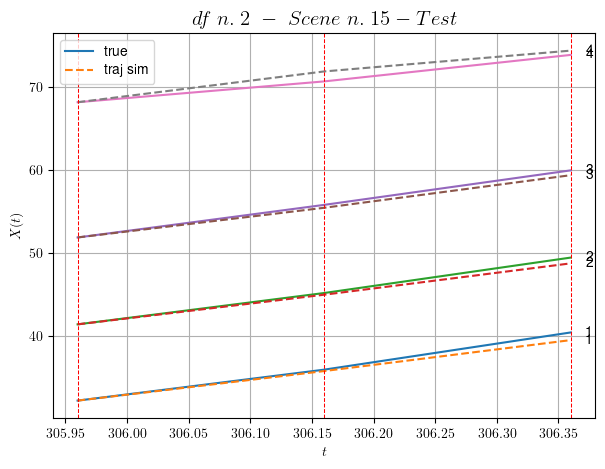

        For scene 15/63:
        * MSE = 0.29760088364241233
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/63


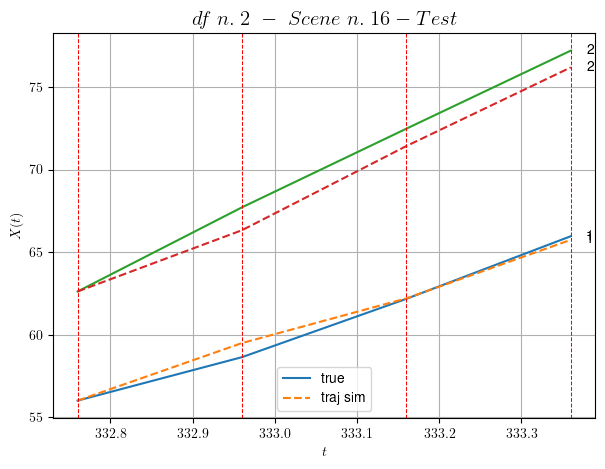

        For scene 16/63:
        * MSE = 0.6043992391910493
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/63


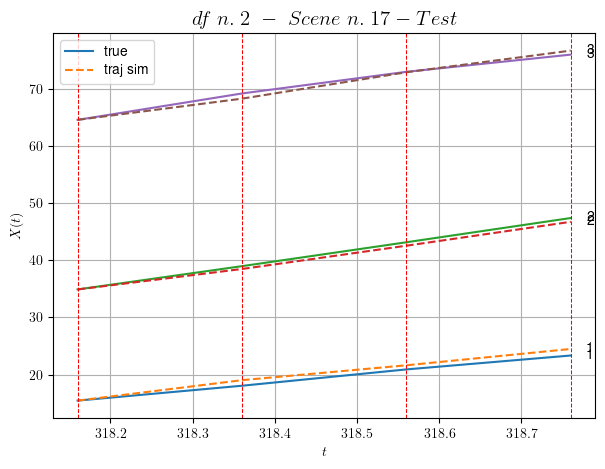

        For scene 17/63:
        * MSE = 0.4291987155743877
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/63


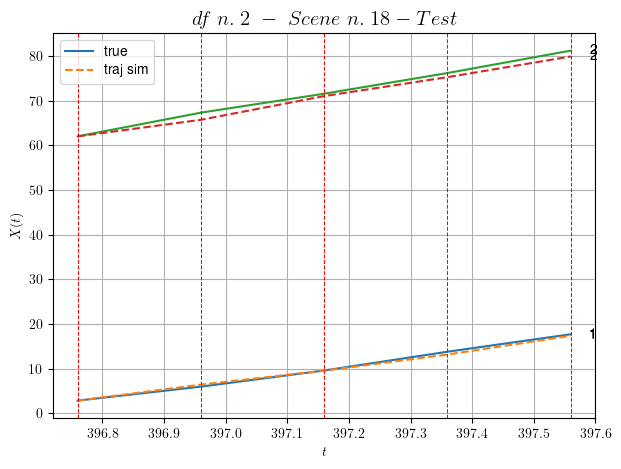

        For scene 18/63:
        * MSE = 0.612667866761533
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/63


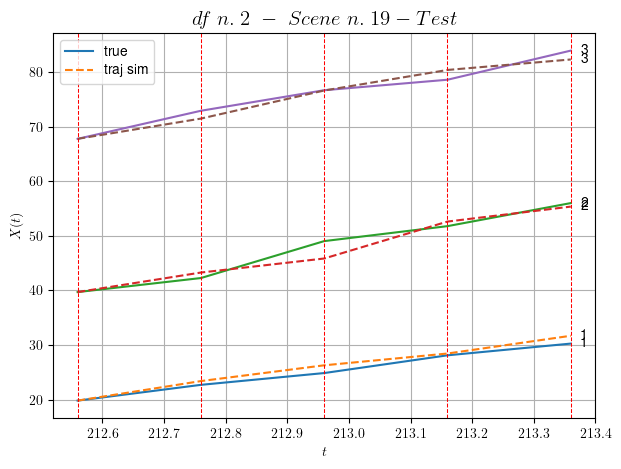

        For scene 19/63:
        * MSE = 1.6526215059509977
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/63


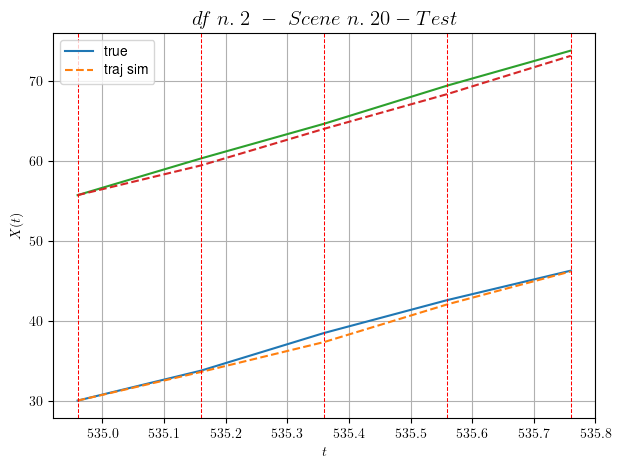

        For scene 20/63:
        * MSE = 0.4313617431581146
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/63


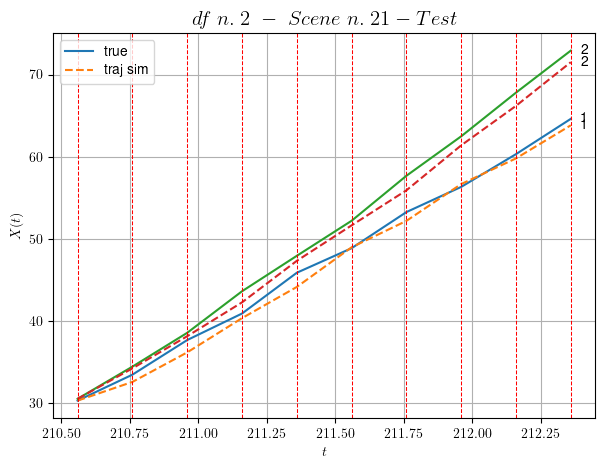

        For scene 21/63:
        * MSE = 1.0092549423014596
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/63


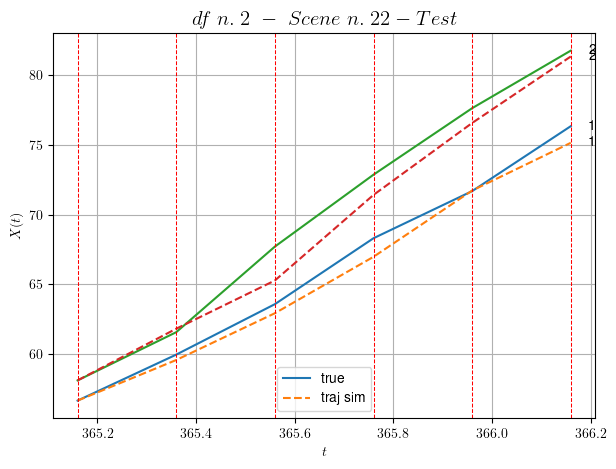

        For scene 22/63:
        * MSE = 1.097027588279623
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/63


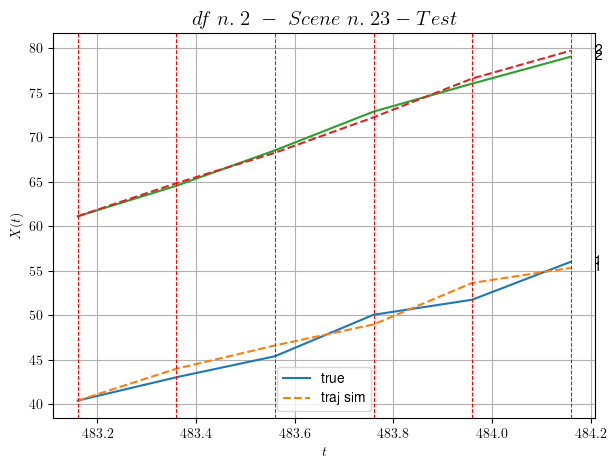

        For scene 23/63:
        * MSE = 0.7459766387807653
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.24/63


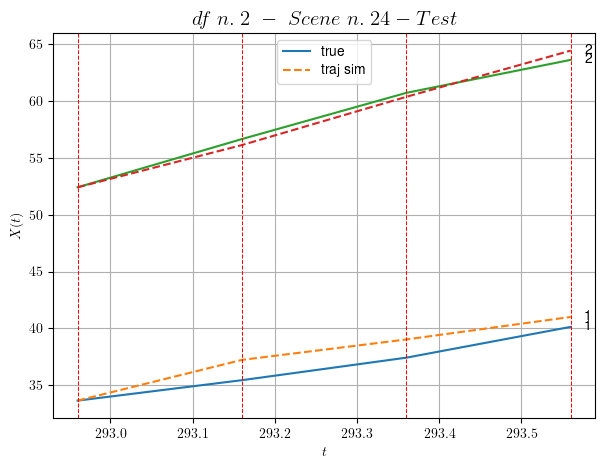

        For scene 24/63:
        * MSE = 0.9440598552401639
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.25/63


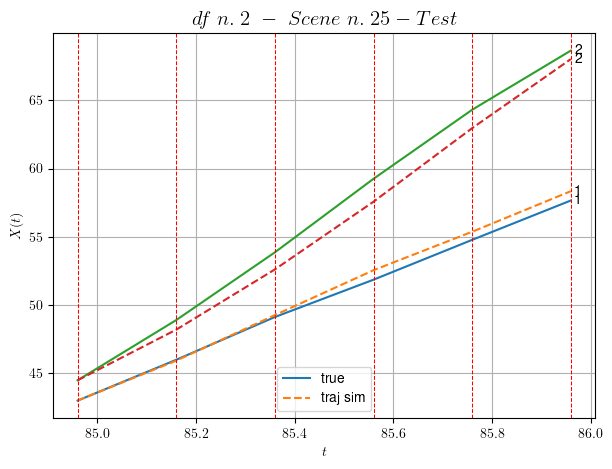

        For scene 25/63:
        * MSE = 0.7003825558647432
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.26/63


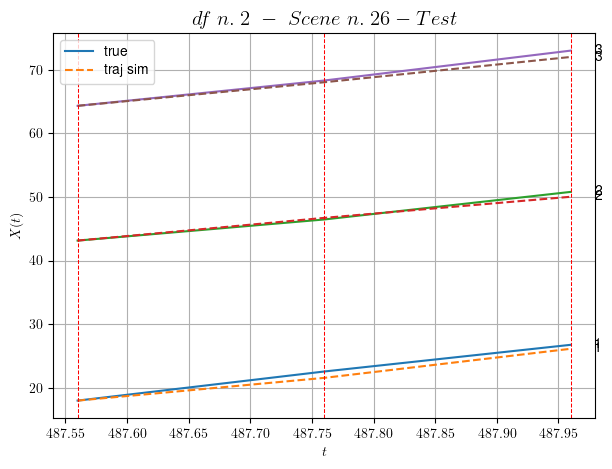

        For scene 26/63:
        * MSE = 0.34602668783495055
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.27/63


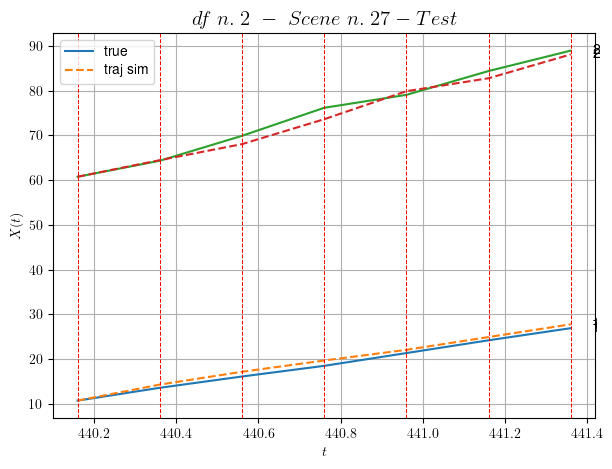

        For scene 27/63:
        * MSE = 1.3433128372164411
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.28/63


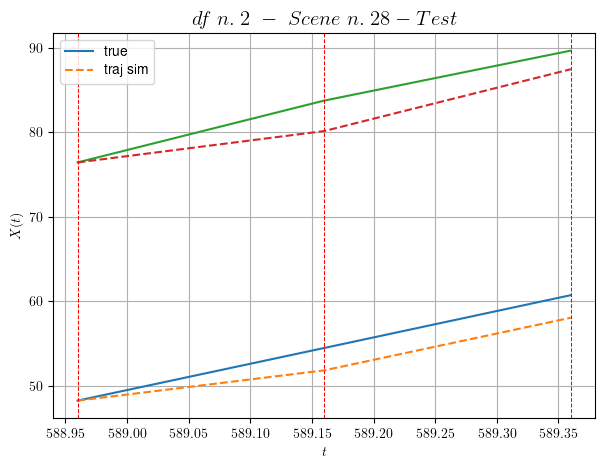

        For scene 28/63:
        * MSE = 5.324729604260291
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.29/63


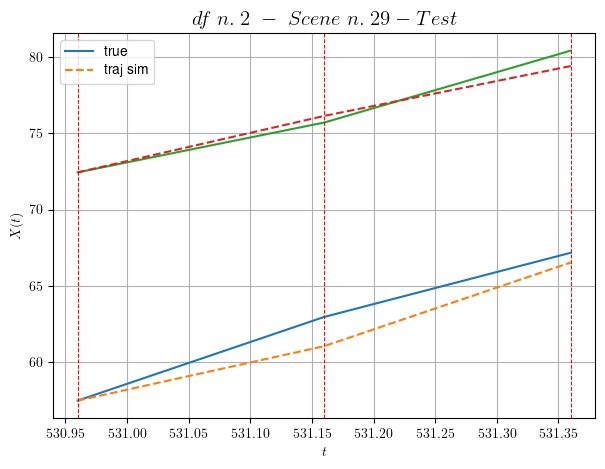

        For scene 29/63:
        * MSE = 0.8838293855609066
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.30/63


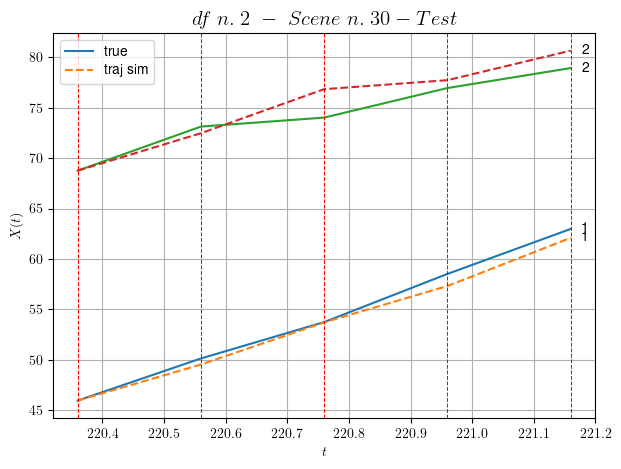

        For scene 30/63:
        * MSE = 1.4551654315279268
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.31/63


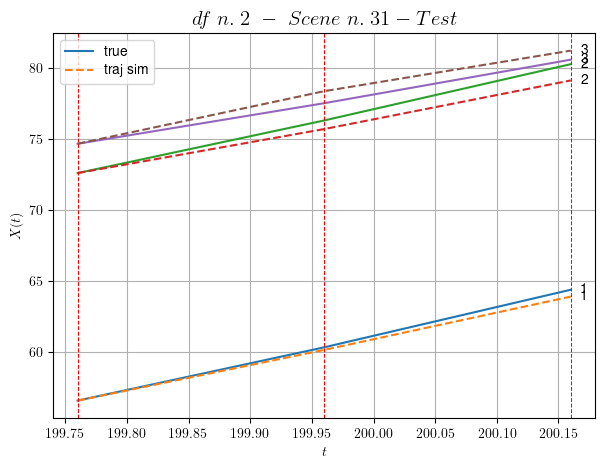

        For scene 31/63:
        * MSE = 0.3424337682460445
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.32/63


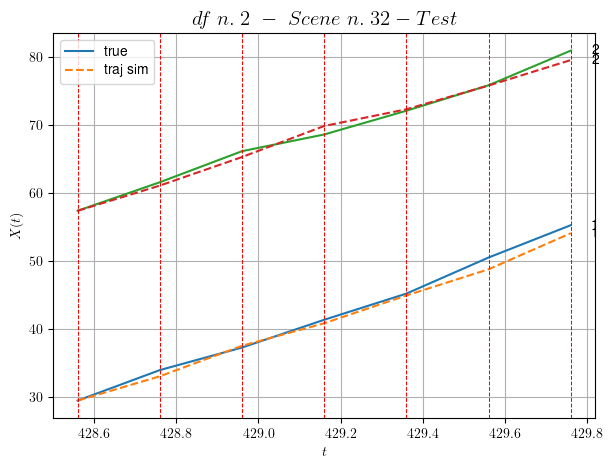

        For scene 32/63:
        * MSE = 0.7255329944464837
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.33/63


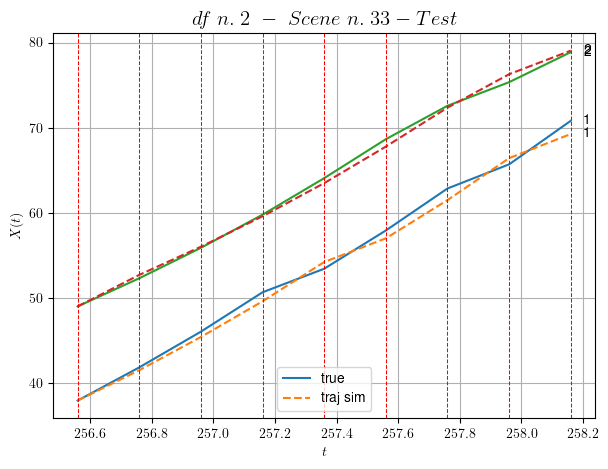

        For scene 33/63:
        * MSE = 0.5653288345516294
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.34/63


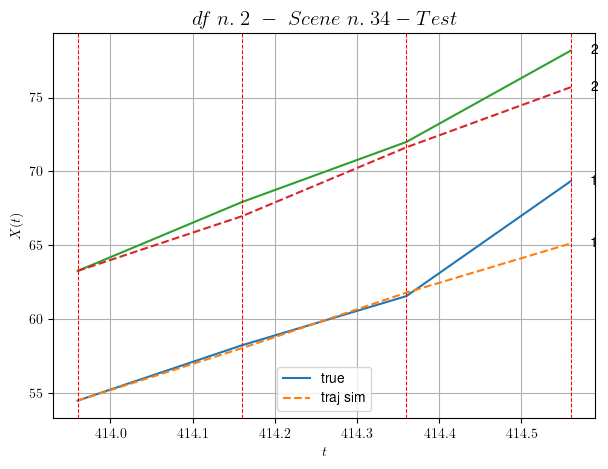

        For scene 34/63:
        * MSE = 3.1368990909610375
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.35/63


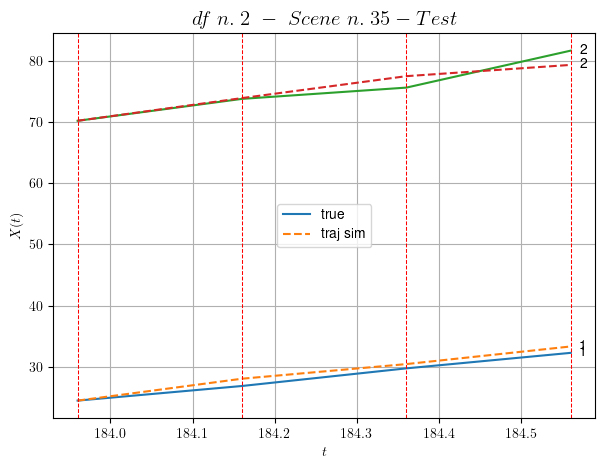

        For scene 35/63:
        * MSE = 1.4920735704923906
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.36/63


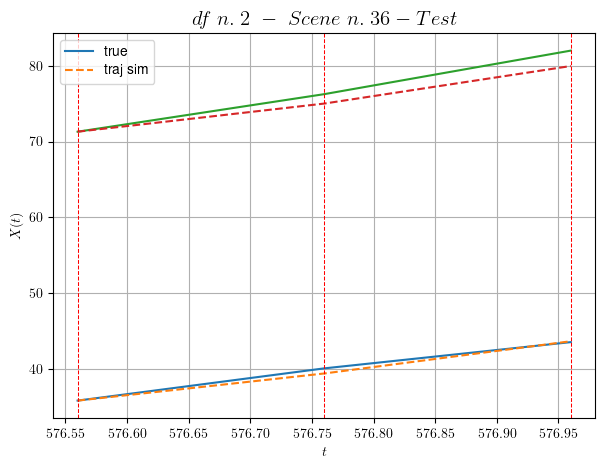

        For scene 36/63:
        * MSE = 1.0228476328359313
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.37/63


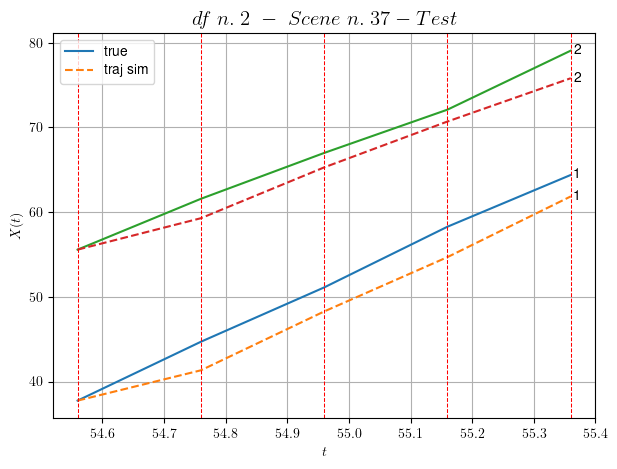

        For scene 37/63:
        * MSE = 5.946064303092907
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.38/63


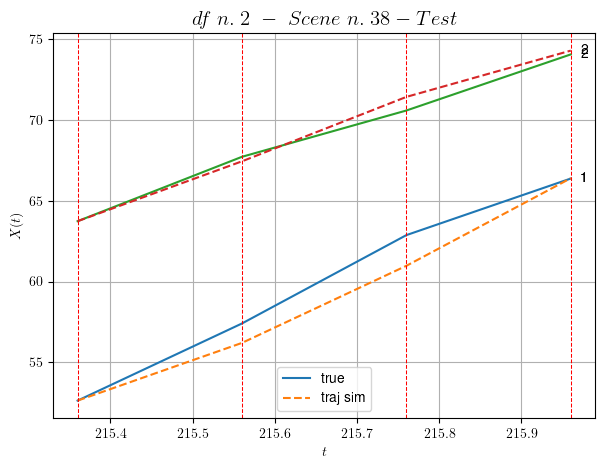

        For scene 38/63:
        * MSE = 0.7374709501379575
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.39/63


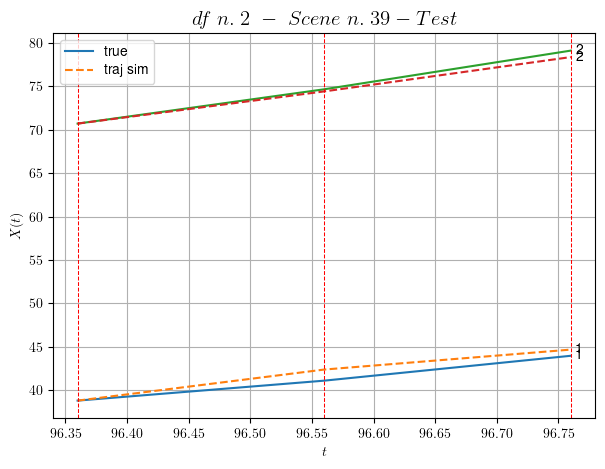

        For scene 39/63:
        * MSE = 0.4595052985388679
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.40/63


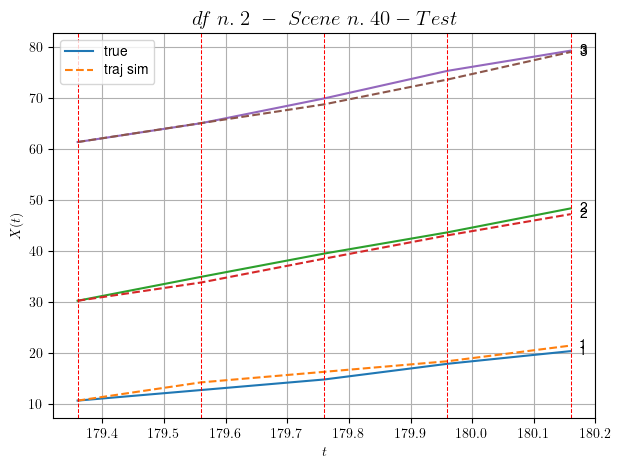

        For scene 40/63:
        * MSE = 0.9409572700432286
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.41/63


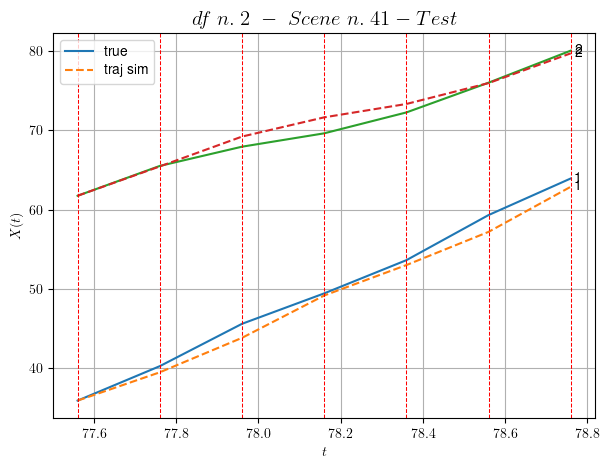

        For scene 41/63:
        * MSE = 1.1996216667809119
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.42/63


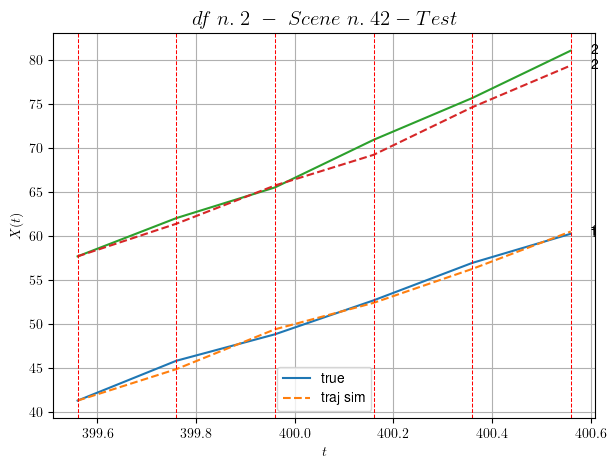

        For scene 42/63:
        * MSE = 0.7627924538535342
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.43/63


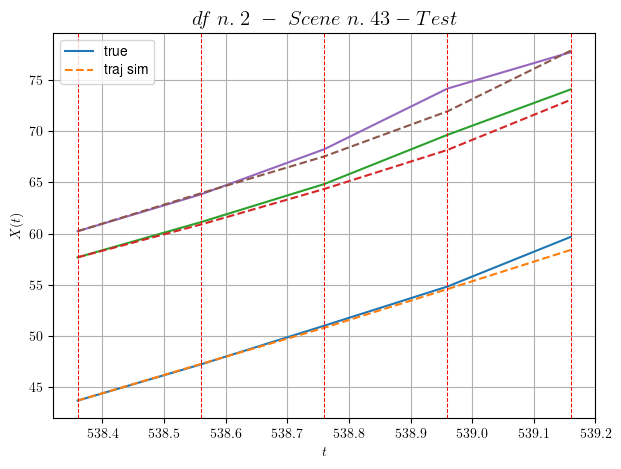

        For scene 43/63:
        * MSE = 0.7125552339030995
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.44/63


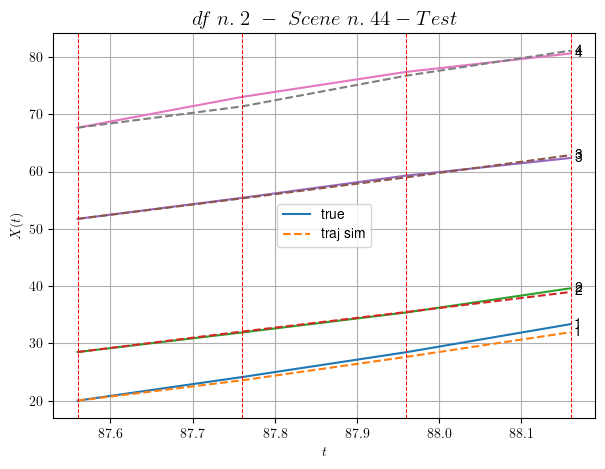

        For scene 44/63:
        * MSE = 0.45266547862854867
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.45/63


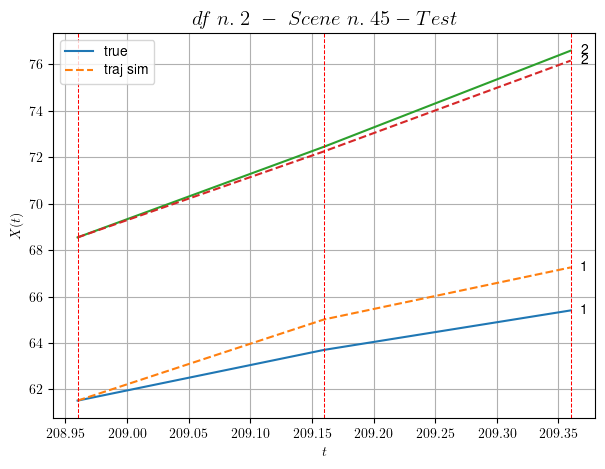

        For scene 45/63:
        * MSE = 0.8961884505473581
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.46/63


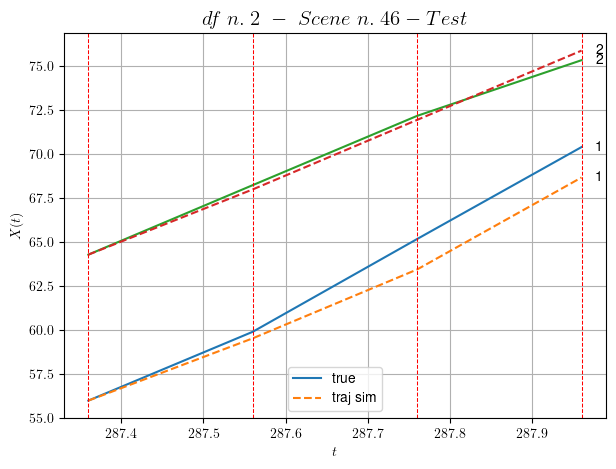

        For scene 46/63:
        * MSE = 0.8171965353094995
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.47/63


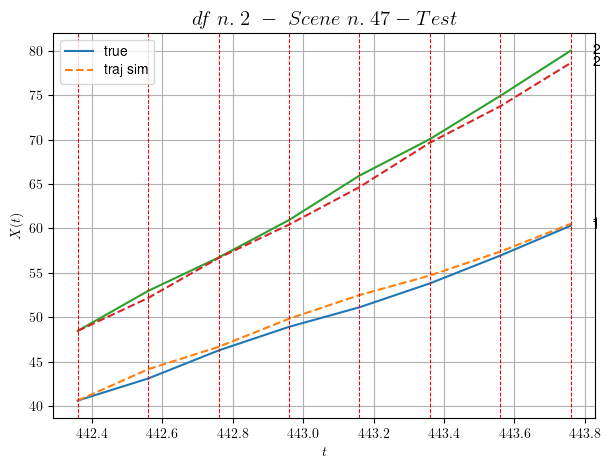

        For scene 47/63:
        * MSE = 0.6875785486800858
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.48/63


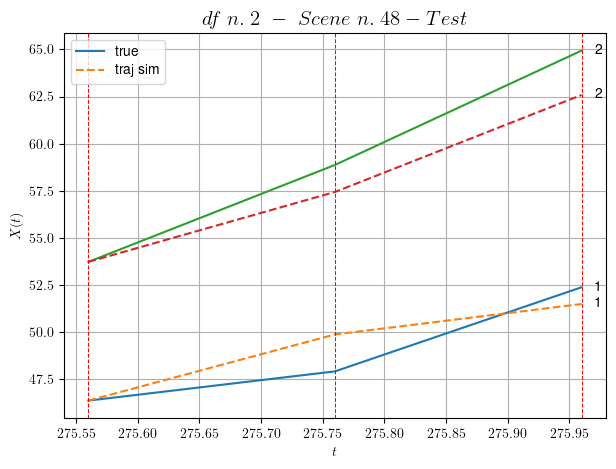

        For scene 48/63:
        * MSE = 2.0371291151834114
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.49/63


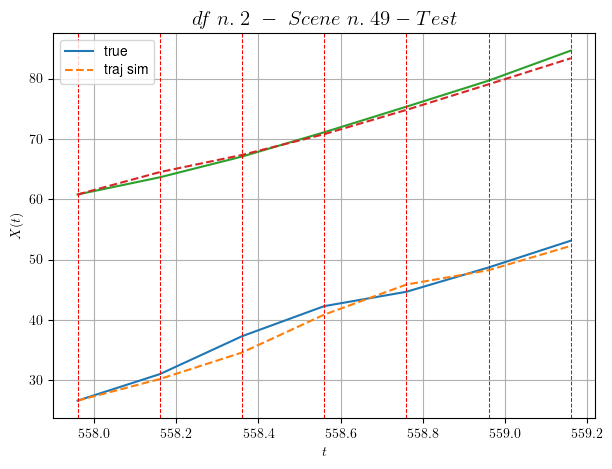

        For scene 49/63:
        * MSE = 1.1093407900453736
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.50/63


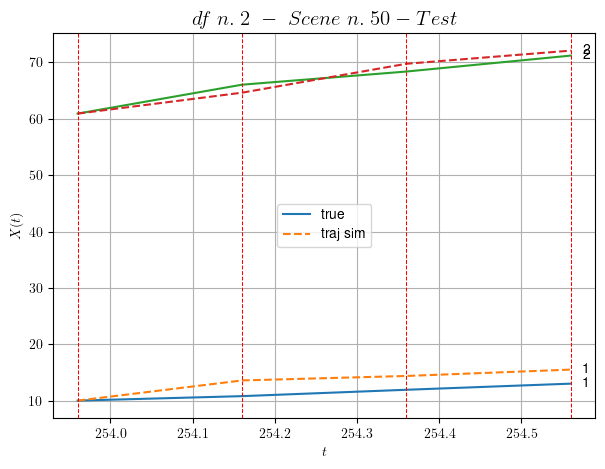

        For scene 50/63:
        * MSE = 3.078591201358705
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.51/63


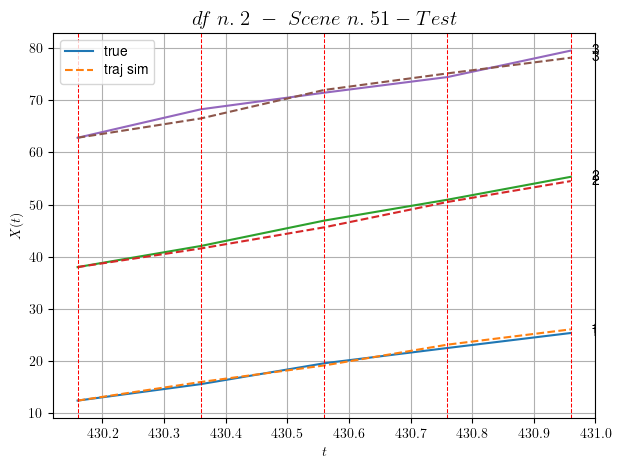

        For scene 51/63:
        * MSE = 0.6469462328664431
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.52/63


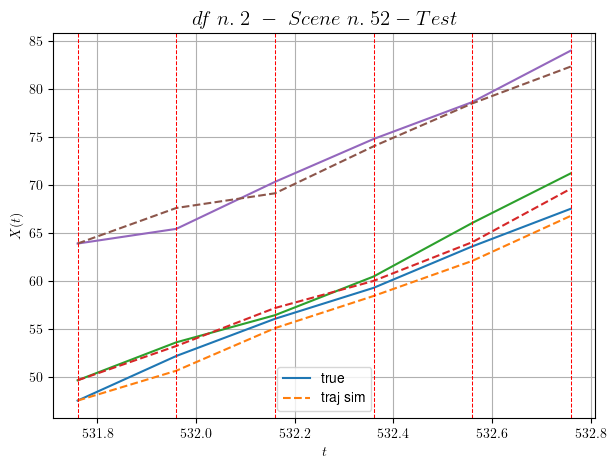

        For scene 52/63:
        * MSE = 1.328005934796025
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.53/63


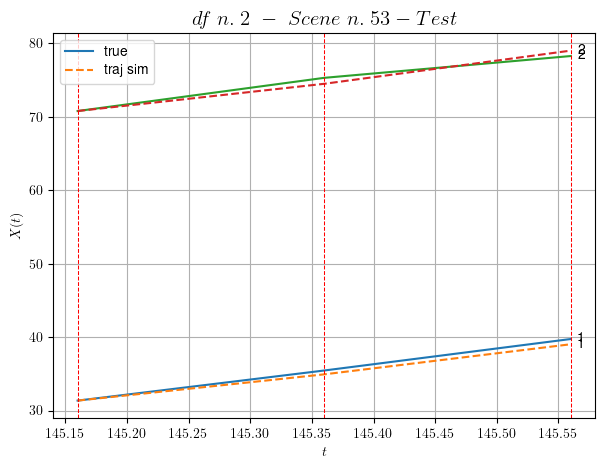

        For scene 53/63:
        * MSE = 0.33109673800606687
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.54/63


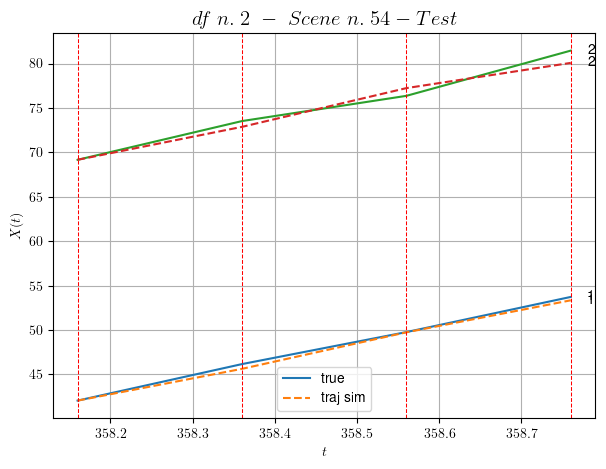

        For scene 54/63:
        * MSE = 0.43996055839613835
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.55/63


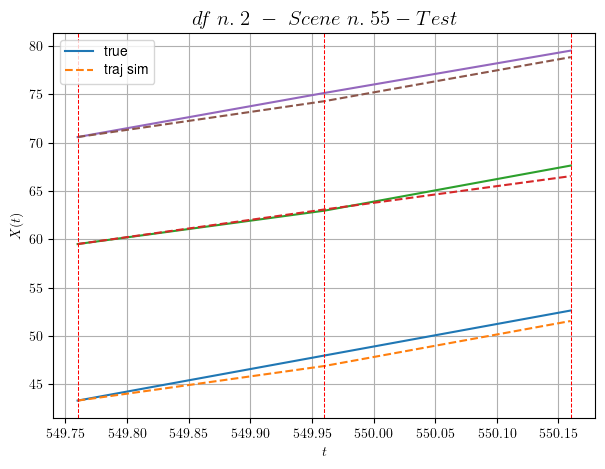

        For scene 55/63:
        * MSE = 0.5261503211280807
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.56/63


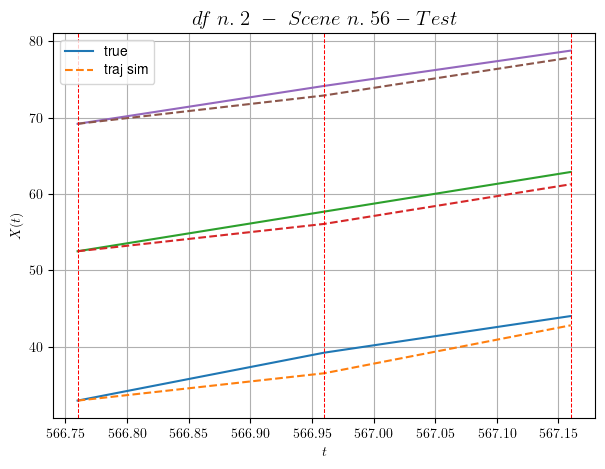

        For scene 56/63:
        * MSE = 1.8094881571132035
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.57/63


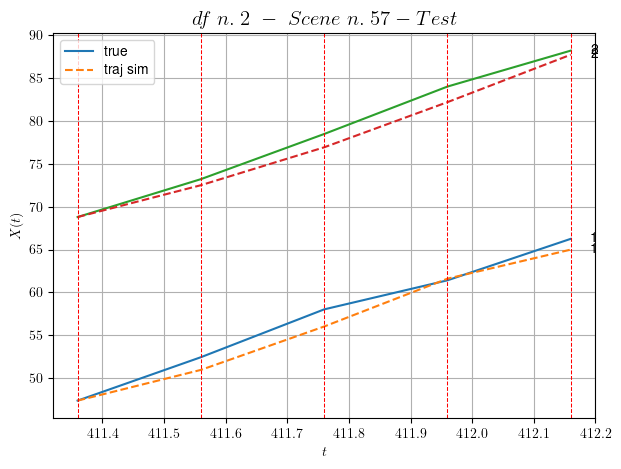

        For scene 57/63:
        * MSE = 1.4215112971205177
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.58/63


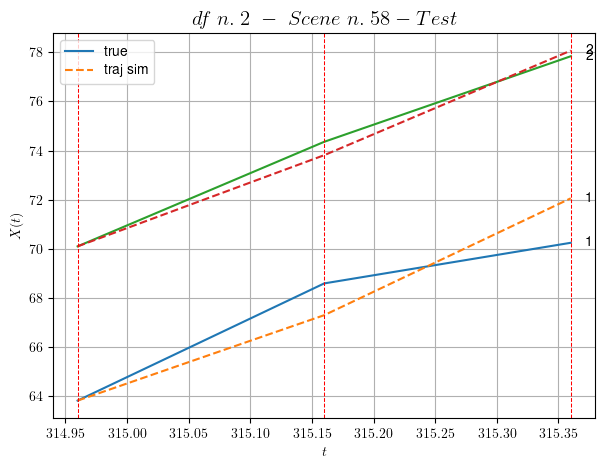

        For scene 58/63:
        * MSE = 0.8816097009081599
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.59/63


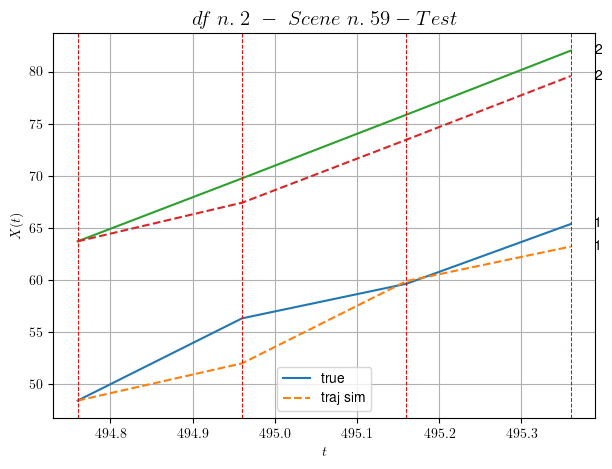

        For scene 59/63:
        * MSE = 5.0855396417904135
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.60/63


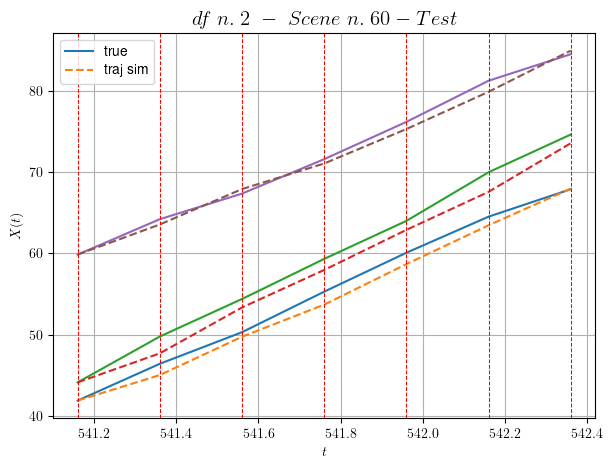

        For scene 60/63:
        * MSE = 1.2932810587113288
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.61/63


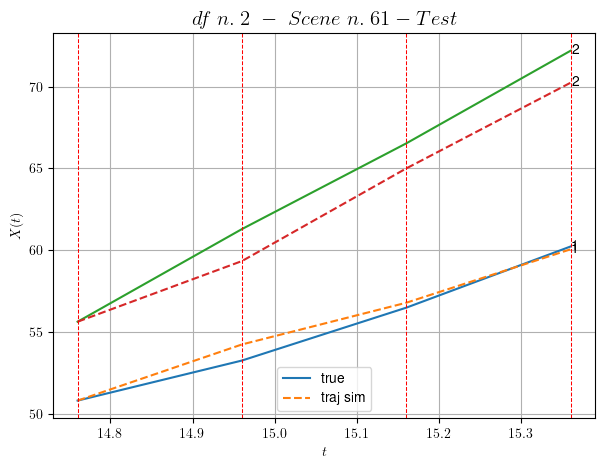

        For scene 61/63:
        * MSE = 1.3852515365779379
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.62/63


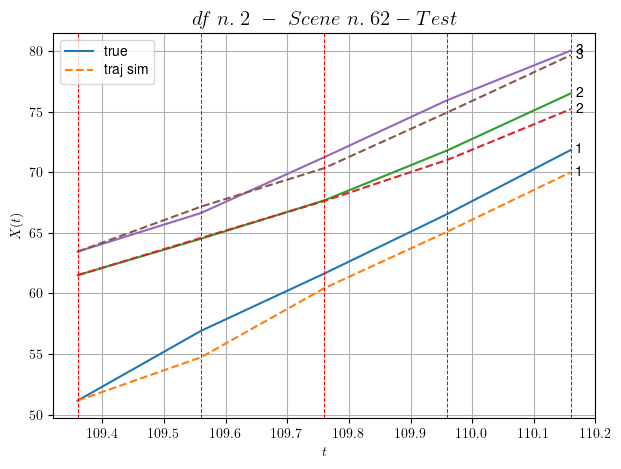

        For scene 62/63:
        * MSE = 1.0833507897058319
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.63/63


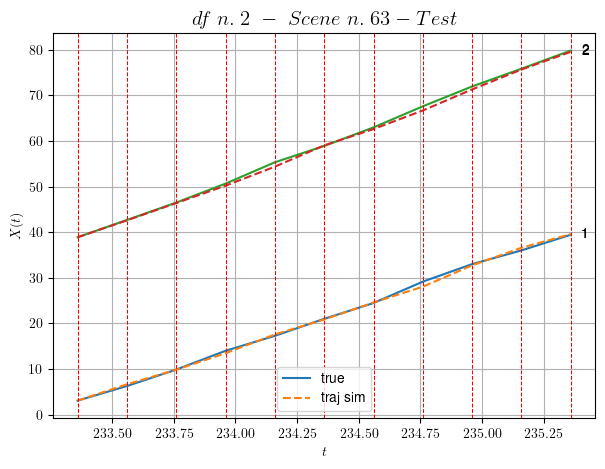

        For scene 63/63:
        * MSE = 0.2210707461839429
----------------------------------------------------------------------------------------------------


MSE test: 1.2676072877556415

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6885312733612418
          * MSE test: 1.2676072877556415
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 3/10 dfs.
In DataFrame n.3 we have 90 scenes.
    To train the model we use 9 scenes, the remaining 81 to test the model.

Training step. (9 scenes)
DataFrame n.3. Scene n.1/9
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [436.16,437.56]


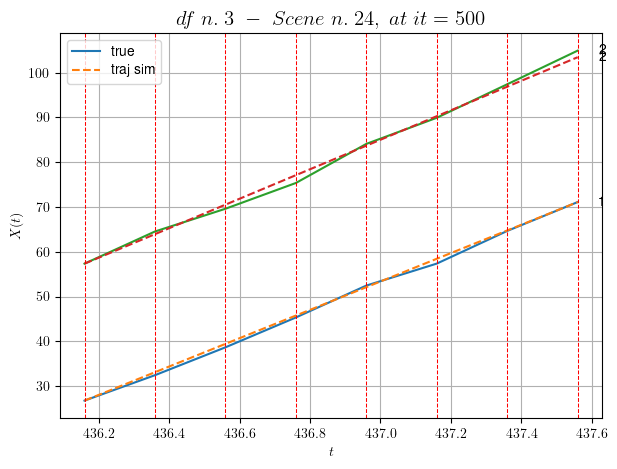

----------------------------------------------------------------------------------------------------
        For scene 1/9:
        * After LR finder: LR_NN=0.0005 with mse=4.102731619916232 at it=24
        * v0 = 32.9239393027633
        * MSE = 0.5921184746331031
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/9
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [170.36,170.76]


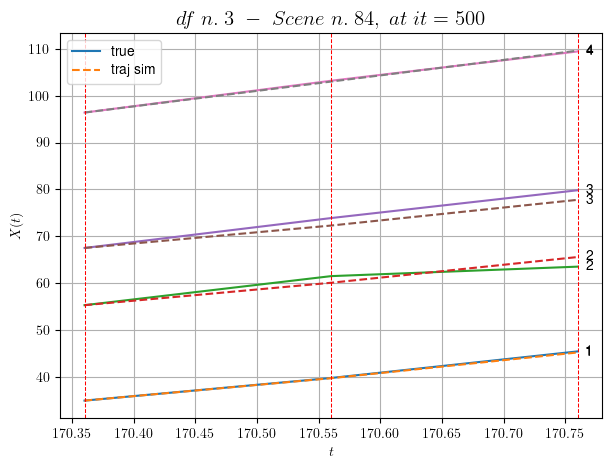

----------------------------------------------------------------------------------------------------
        For scene 2/9:
        * After LR finder: LR_NN=0.01 with mse=1.4385338354210448 at it=24
        * v0 = 32.99653993565764
        * MSE = 1.0807838284803202
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [579.56,580.56]


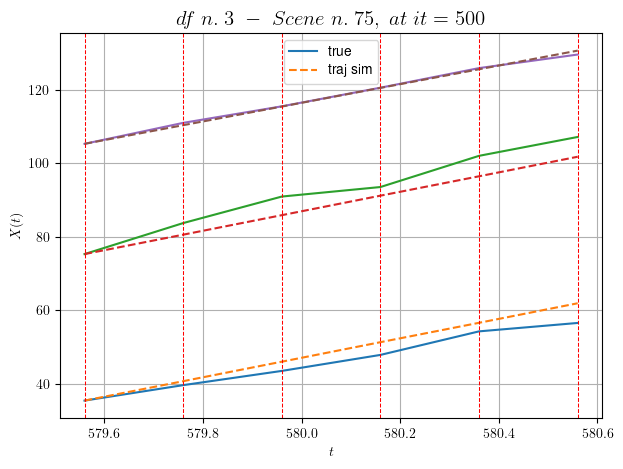

----------------------------------------------------------------------------------------------------
        For scene 3/9:
        * After LR finder: LR_NN=0.0005 with mse=11.82503696209369 at it=24
        * v0 = 25.358404463471473
        * MSE = 8.676242494195664
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/9
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [142.16,142.76]


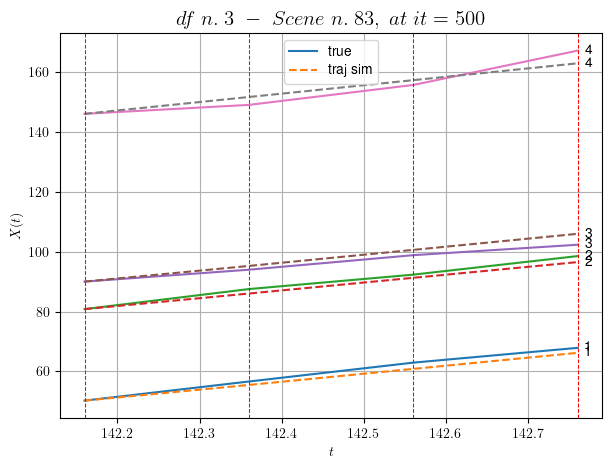

----------------------------------------------------------------------------------------------------
        For scene 4/9:
        * After LR finder: LR_NN=0.005 with mse=3.5897245904697144 at it=24
        * v0 = 28.12123774853768
        * MSE = 3.5634723963108756
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [417.16,418.16]


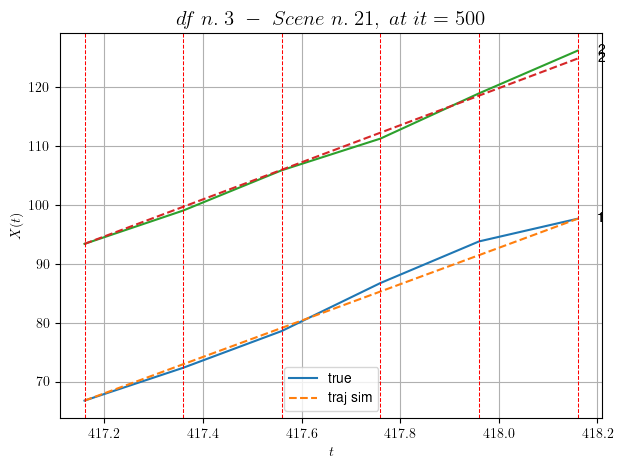

----------------------------------------------------------------------------------------------------
        For scene 5/9:
        * After LR finder: LR_NN=5e-05 with mse=2.047129341077248 at it=24
        * v0 = 31.447990123716046
        * MSE = 0.9587355167093576
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.36,388.16]


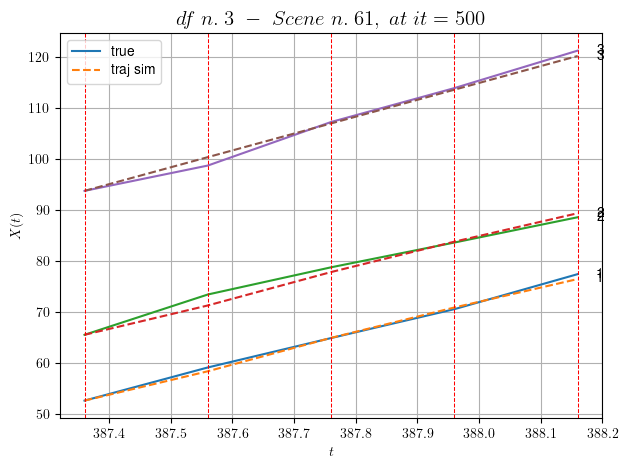

----------------------------------------------------------------------------------------------------
        For scene 6/9:
        * After LR finder: LR_NN=0.01 with mse=1.8533508913479466 at it=24
        * v0 = 33.031898088257634
        * MSE = 0.754585119241758
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [527.36,528.16]


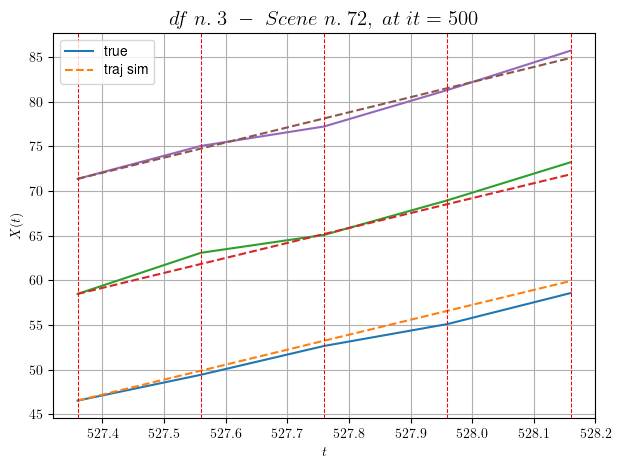

----------------------------------------------------------------------------------------------------
        For scene 7/9:
        * After LR finder: LR_NN=0.0005 with mse=13.960412119549138 at it=24
        * v0 = 16.92090602277574
        * MSE = 0.6492414918080803
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/9
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [299.76,300.56]


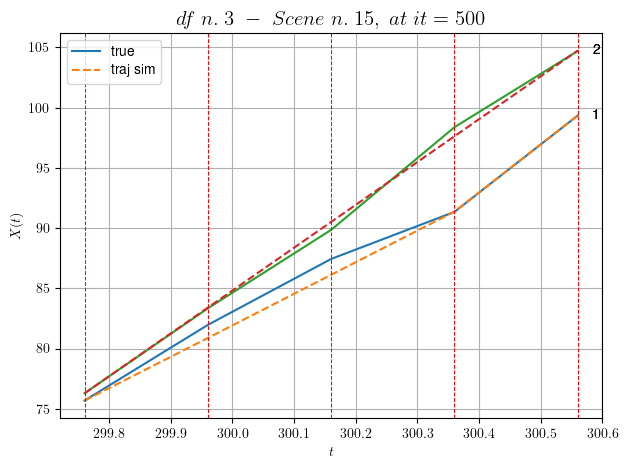

----------------------------------------------------------------------------------------------------
        For scene 8/9:
        * After LR finder: LR_NN=0.001 with mse=4.319120658327078 at it=24
        * v0 = 35.55620181997
        * MSE = 0.31368476125625944
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/9
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [218.16,219.16]


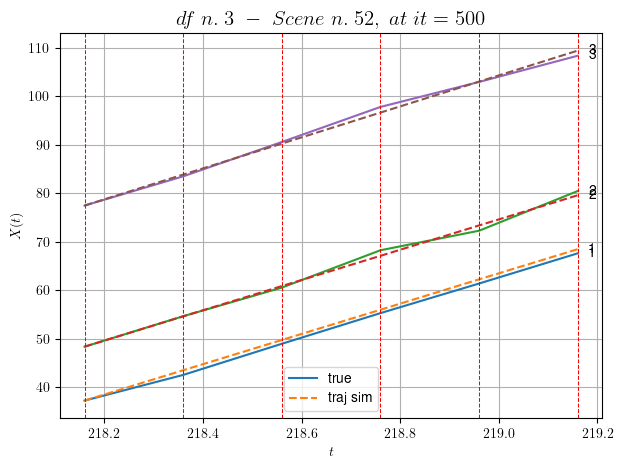

----------------------------------------------------------------------------------------------------
        For scene 9/9:
        * After LR finder: LR_NN=0.0005 with mse=0.948695574186664 at it=24
        * v0 = 31.94692558326313
        * MSE = 0.5292935610459939
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.9020175159646011
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (81 scenes)
DataFrame n.3. Scene n.1/81


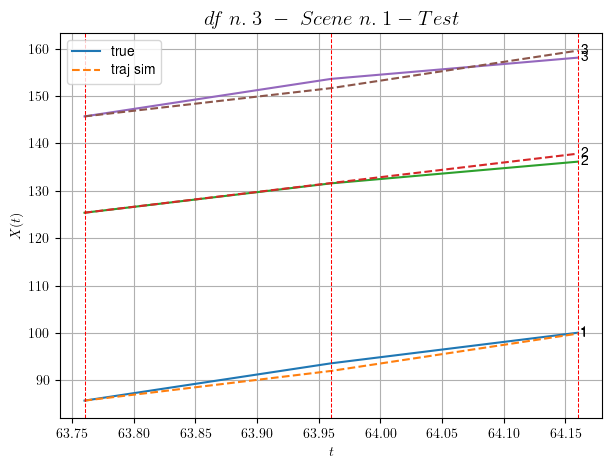

        For scene 1/81:
        * MSE = 1.275626261850176
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/81


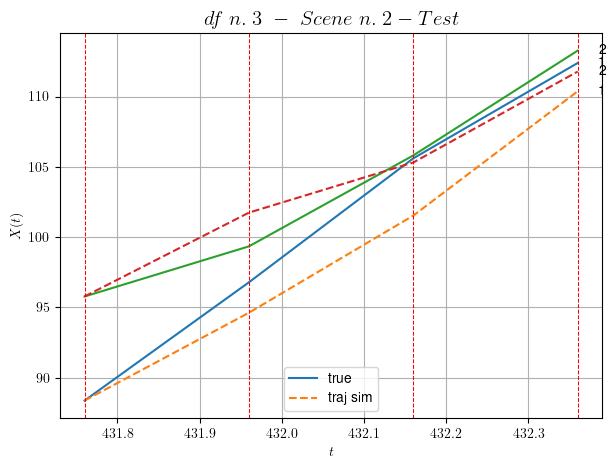

        For scene 2/81:
        * MSE = 4.187621490154816
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/81


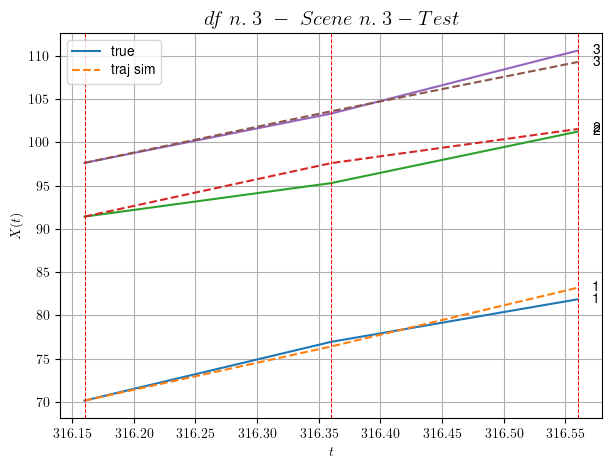

        For scene 3/81:
        * MSE = 1.0344145086997898
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/81


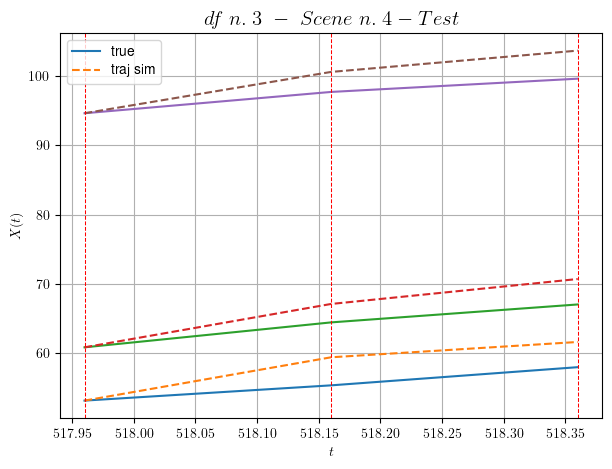

        For scene 4/81:
        * MSE = 8.322520179576449
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/81


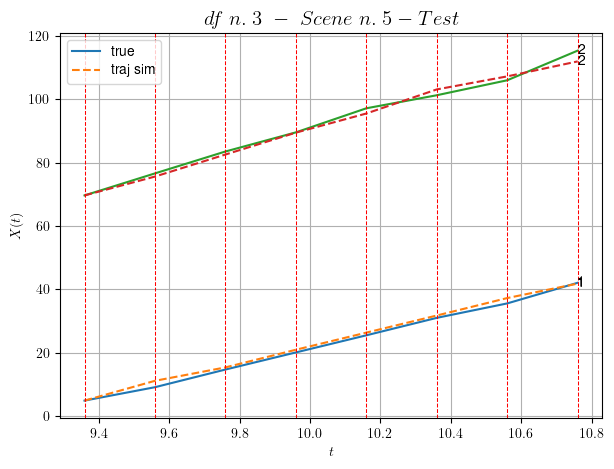

        For scene 5/81:
        * MSE = 1.9135245411645536
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/81


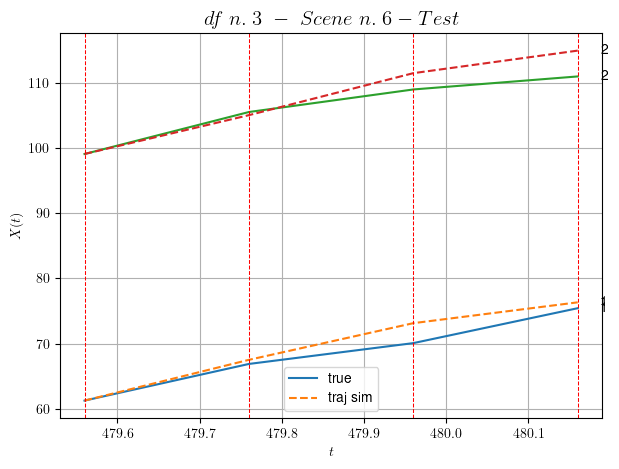

        For scene 6/81:
        * MSE = 4.096299000764533
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/81


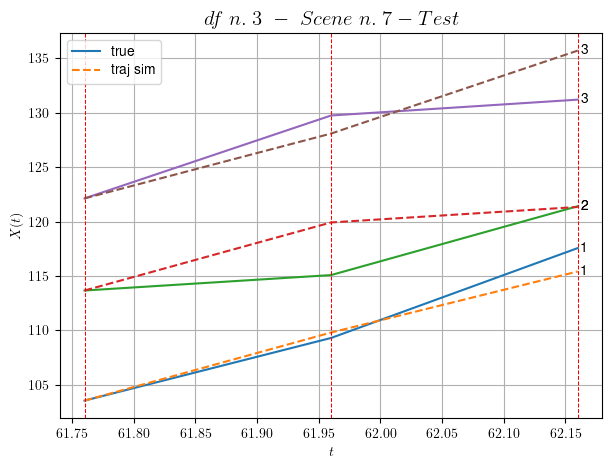

        For scene 7/81:
        * MSE = 5.703684319831148
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/81


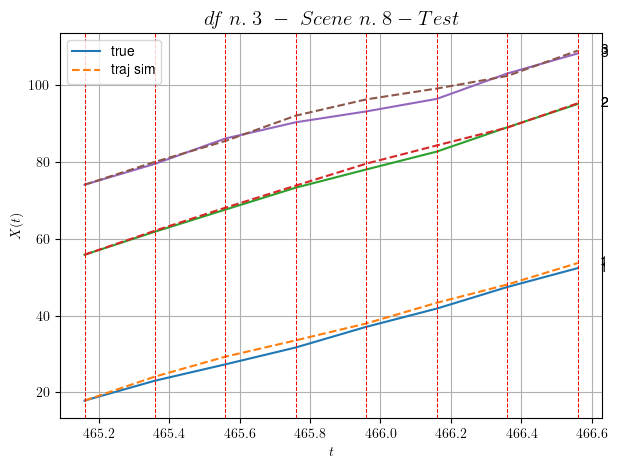

        For scene 8/81:
        * MSE = 1.7128236945988018
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/81


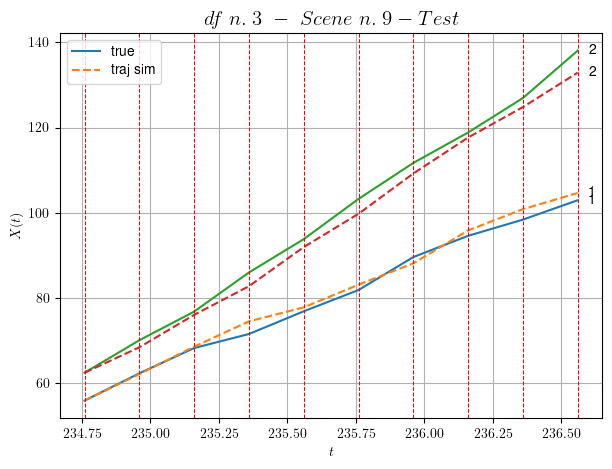

        For scene 9/81:
        * MSE = 4.612258153612862
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/81


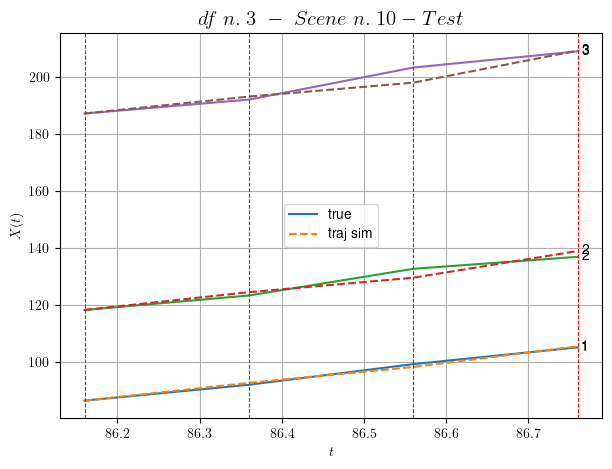

        For scene 10/81:
        * MSE = 3.8583374503349734
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/81


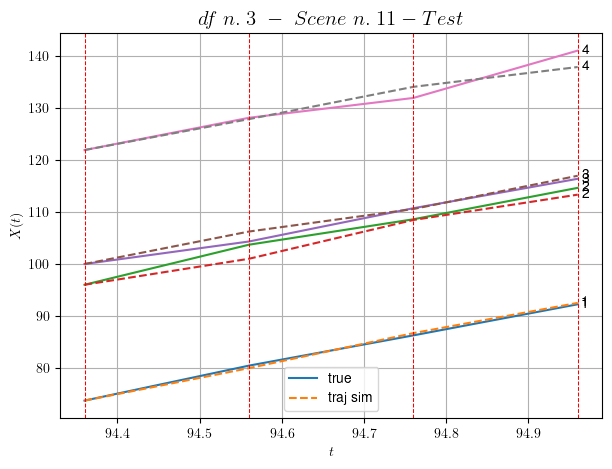

        For scene 11/81:
        * MSE = 1.7650126096771885
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/81


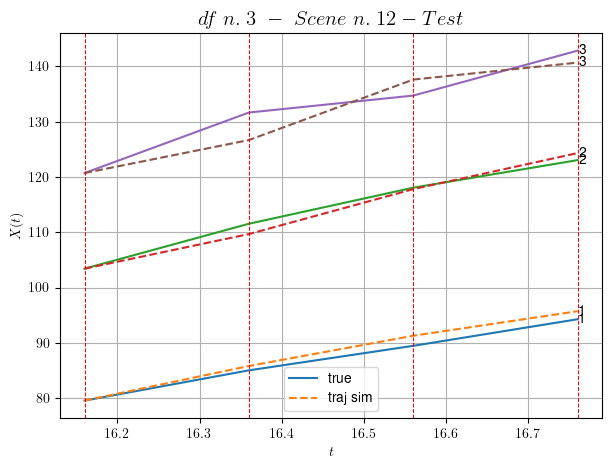

        For scene 12/81:
        * MSE = 4.084936225222191
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/81


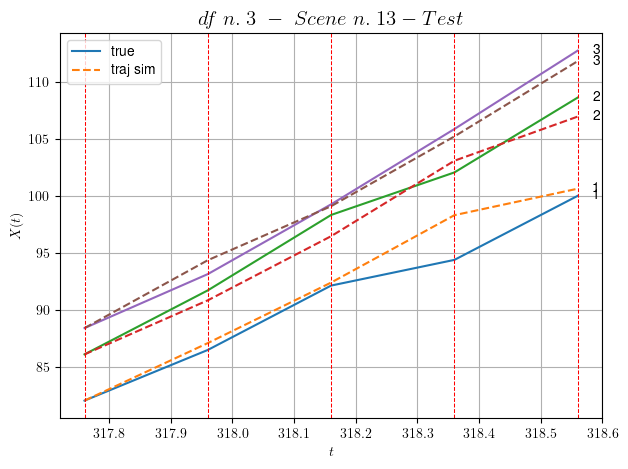

        For scene 13/81:
        * MSE = 1.8075524010632156
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/81


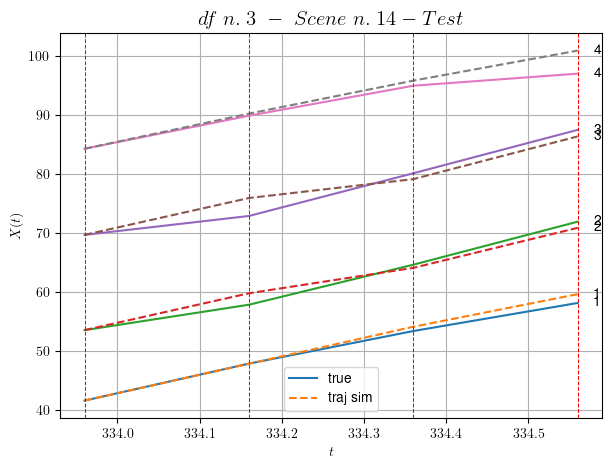

        For scene 14/81:
        * MSE = 2.224784473485567
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/81


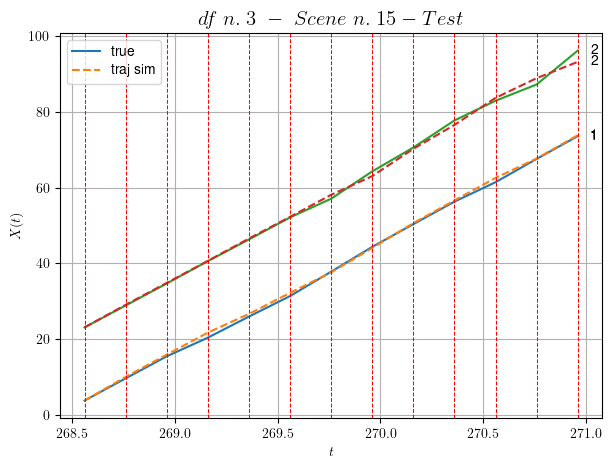

        For scene 15/81:
        * MSE = 0.8240759427944261
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/81


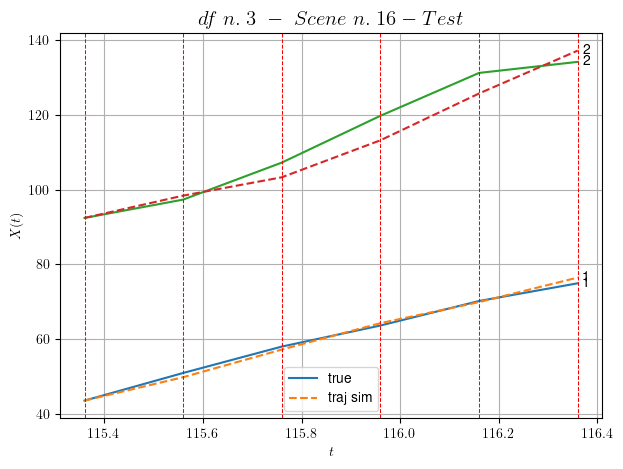

        For scene 16/81:
        * MSE = 8.602084526191671
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/81


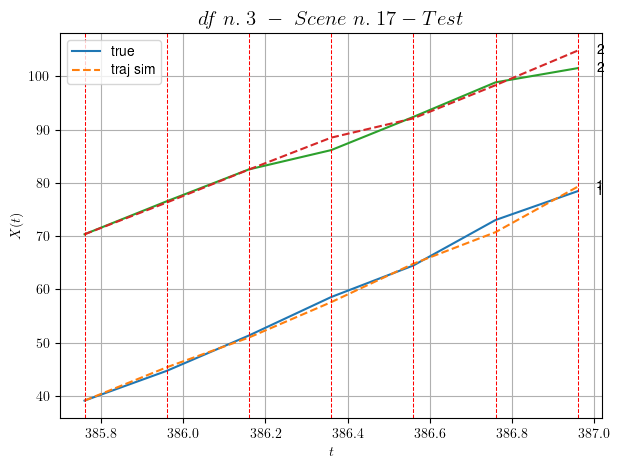

        For scene 17/81:
        * MSE = 1.7346106162275892
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/81


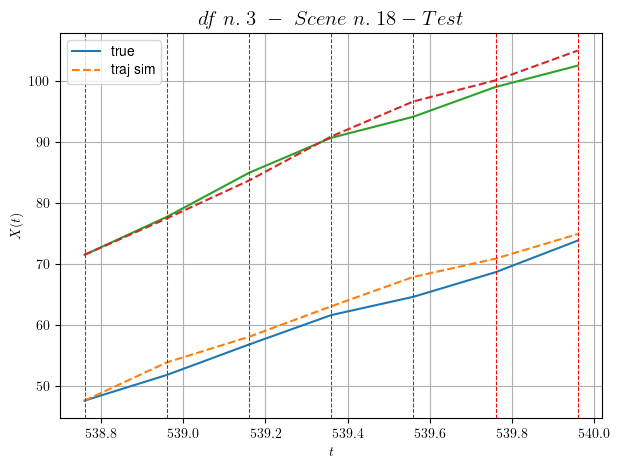

        For scene 18/81:
        * MSE = 2.8449143733835385
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/81


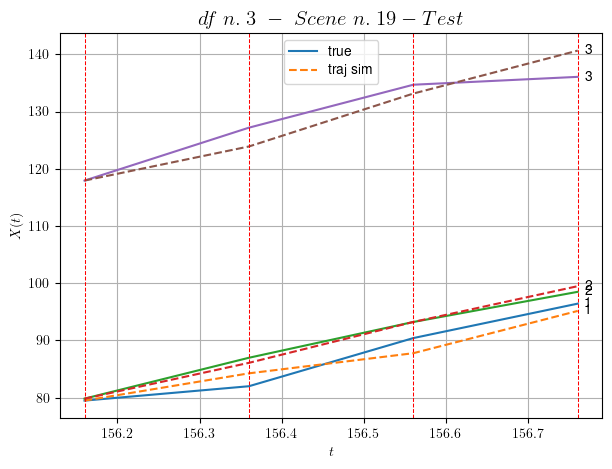

        For scene 19/81:
        * MSE = 4.139032245904377
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/81


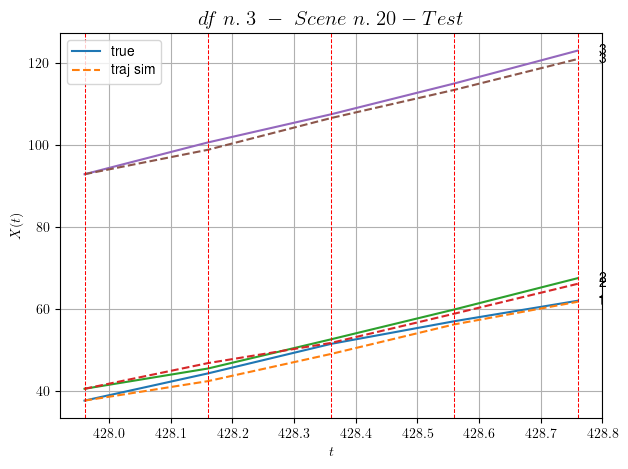

        For scene 20/81:
        * MSE = 1.7599938585138435
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/81


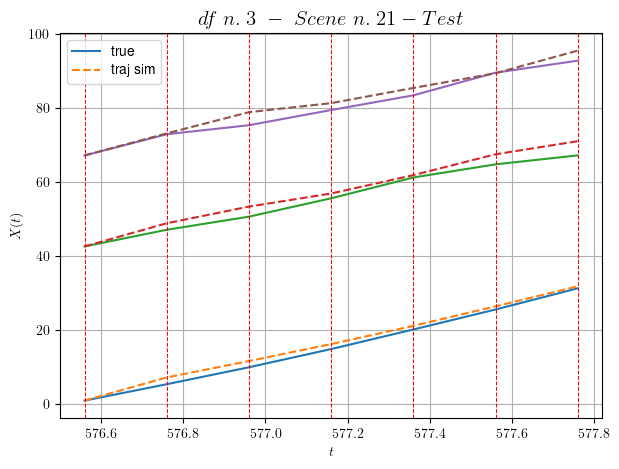

        For scene 21/81:
        * MSE = 3.4237790619556754
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/81


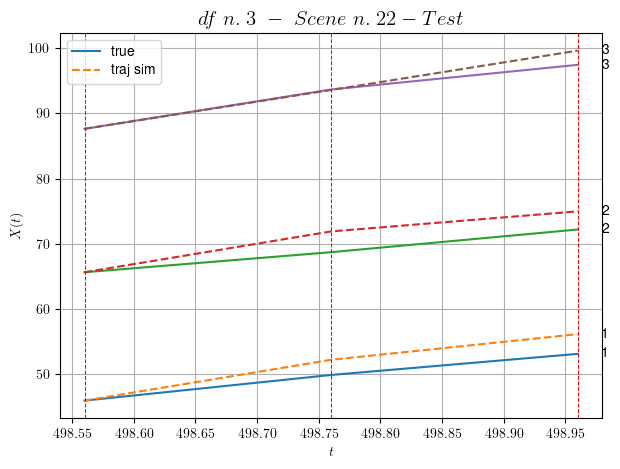

        For scene 22/81:
        * MSE = 4.131792206660328
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/81


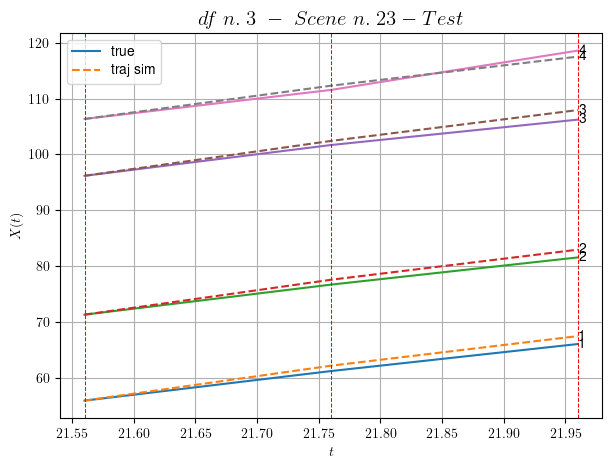

        For scene 23/81:
        * MSE = 0.9035070274786015
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/81


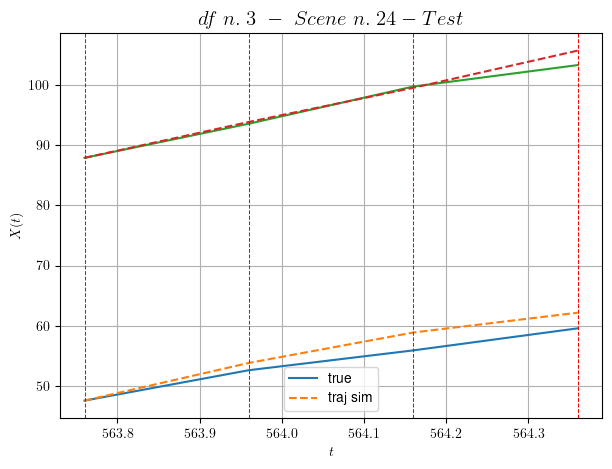

        For scene 24/81:
        * MSE = 2.8657786288573592
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/81


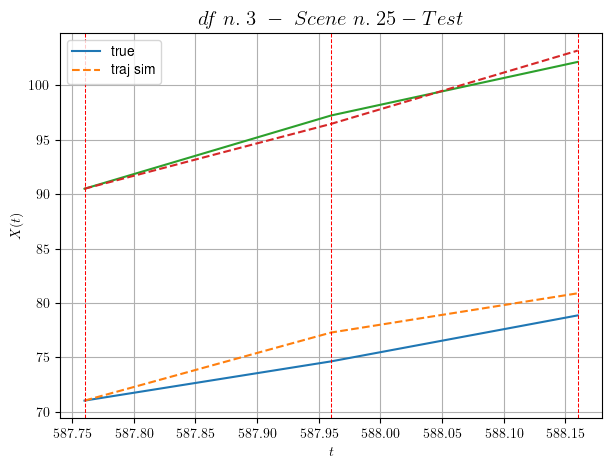

        For scene 25/81:
        * MSE = 2.1398055917843033
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/81


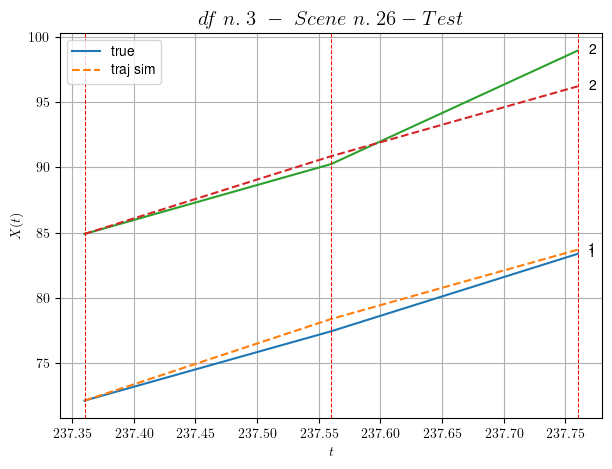

        For scene 26/81:
        * MSE = 1.4754536236023426
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/81


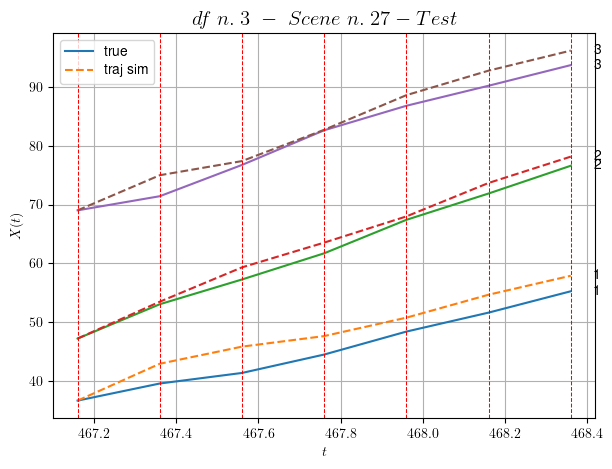

        For scene 27/81:
        * MSE = 5.0186023691245705
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/81


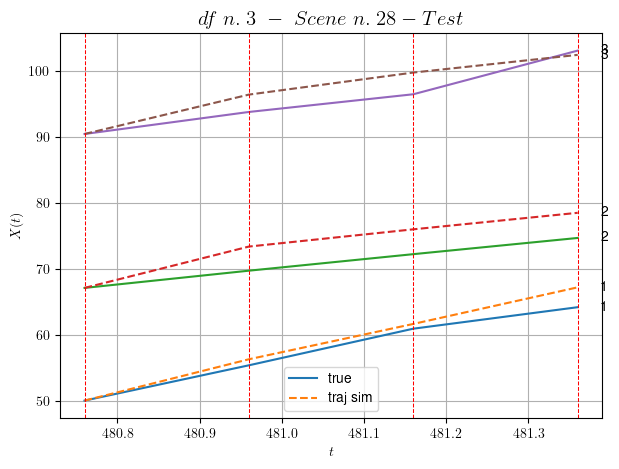

        For scene 28/81:
        * MSE = 5.868563472728984
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/81


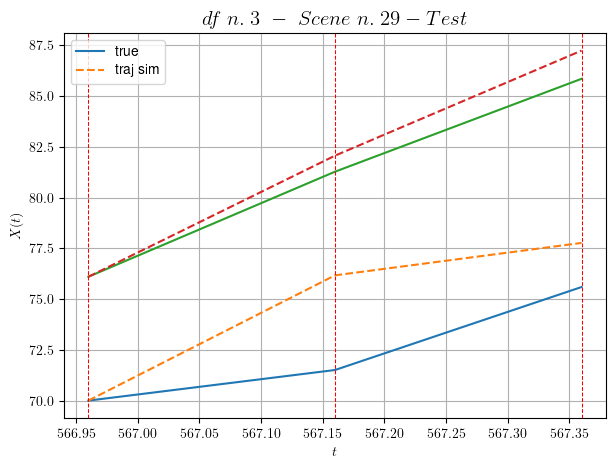

        For scene 29/81:
        * MSE = 4.832890952120173
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/81


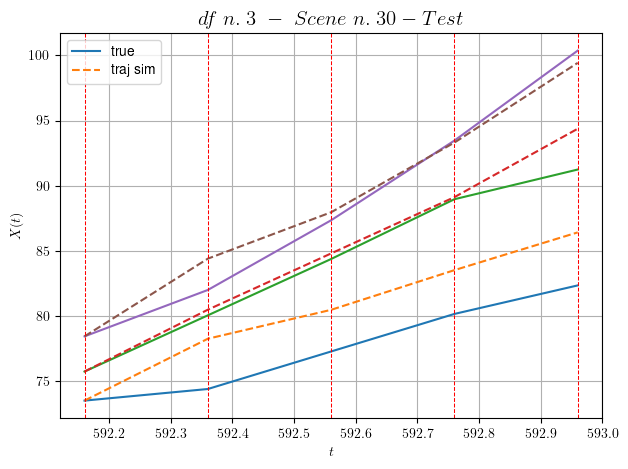

        For scene 30/81:
        * MSE = 4.6788802780634535
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.31/81


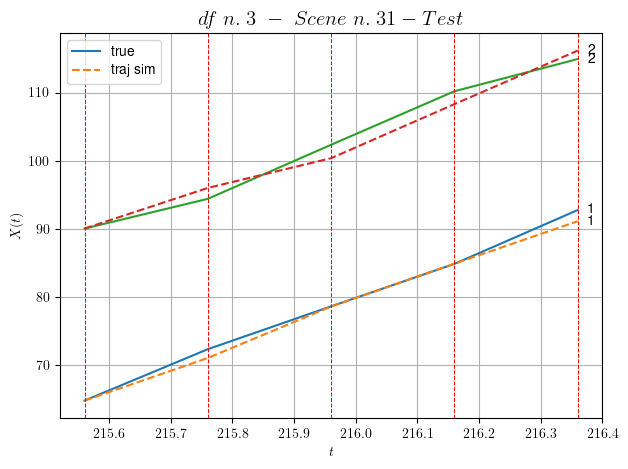

        For scene 31/81:
        * MSE = 1.5892787397581116
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.32/81


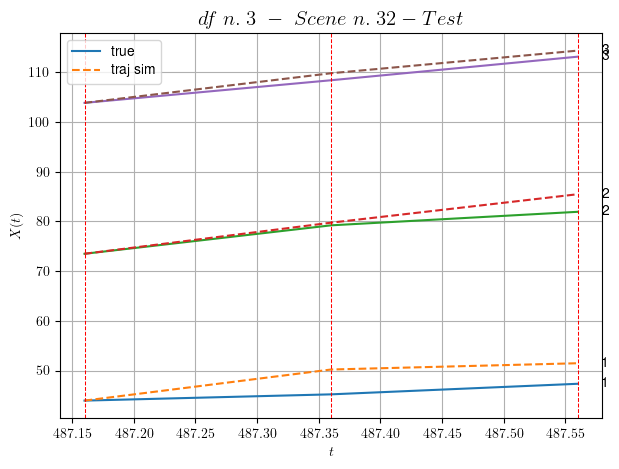

        For scene 32/81:
        * MSE = 6.482662816234529
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.33/81


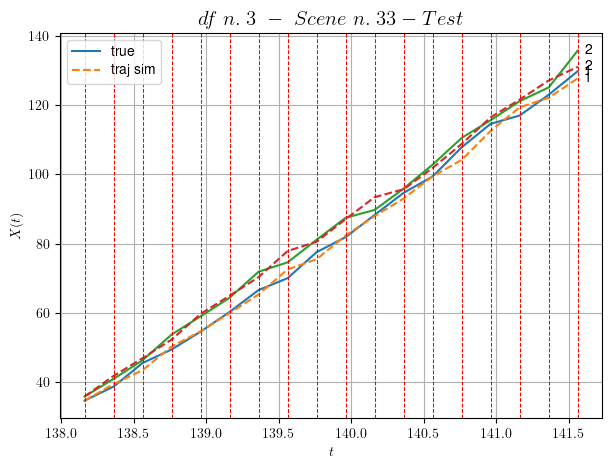

        For scene 33/81:
        * MSE = 3.0718742643066888
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.34/81


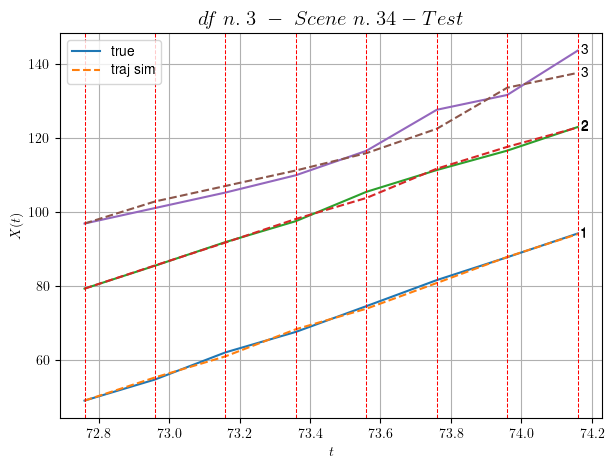

        For scene 34/81:
        * MSE = 3.421774347944703
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.35/81


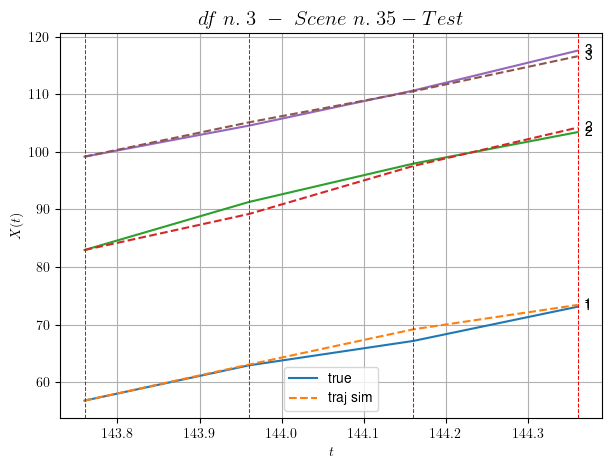

        For scene 35/81:
        * MSE = 0.8848641131883653
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.36/81


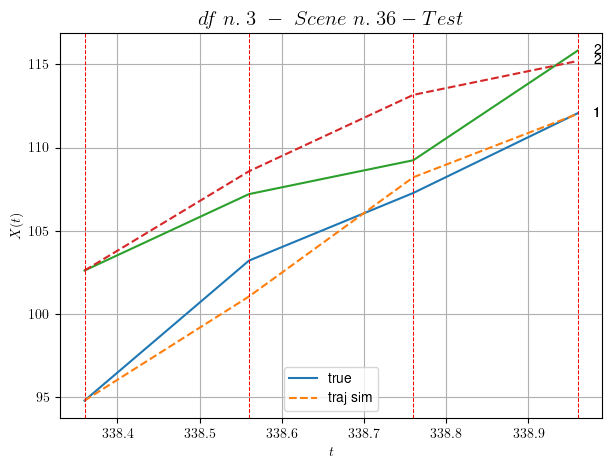

        For scene 36/81:
        * MSE = 2.9036104166707624
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.37/81


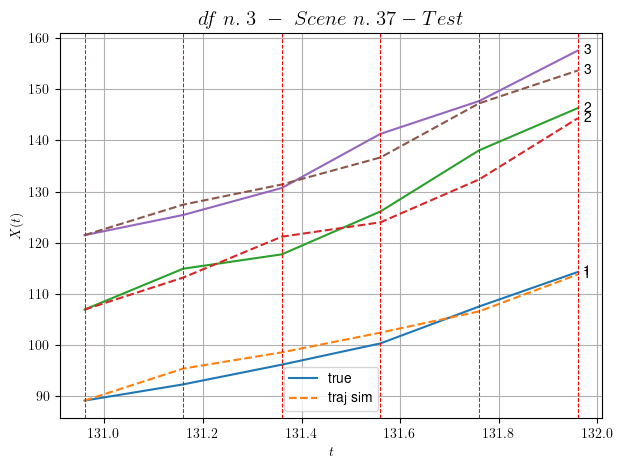

        For scene 37/81:
        * MSE = 6.551093658836488
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.38/81


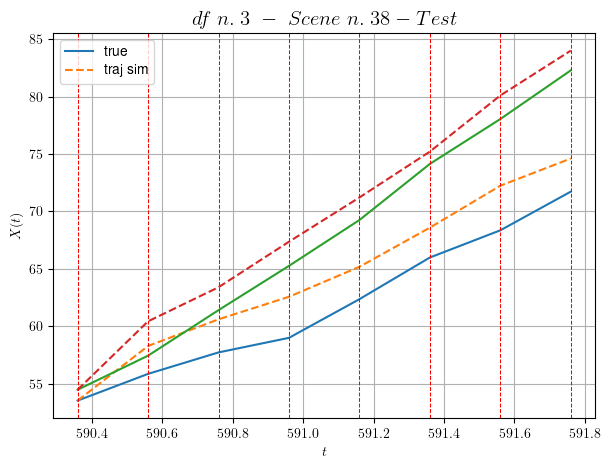

        For scene 38/81:
        * MSE = 5.921719418934101
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.39/81


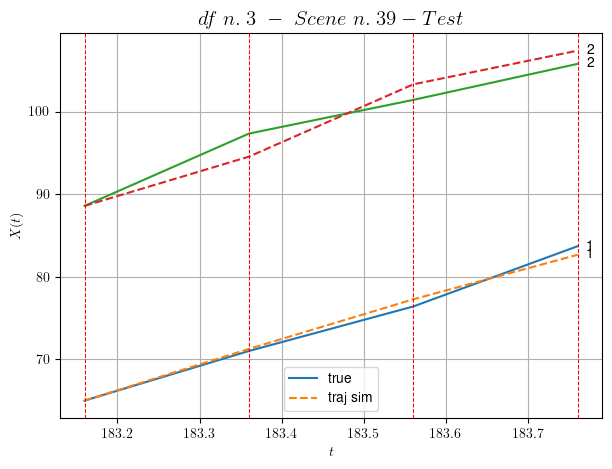

        For scene 39/81:
        * MSE = 1.9724273288552048
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.40/81


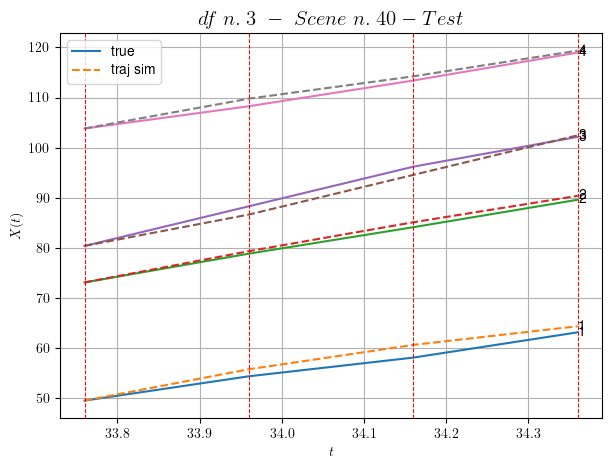

        For scene 40/81:
        * MSE = 1.2703912932139962
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.41/81


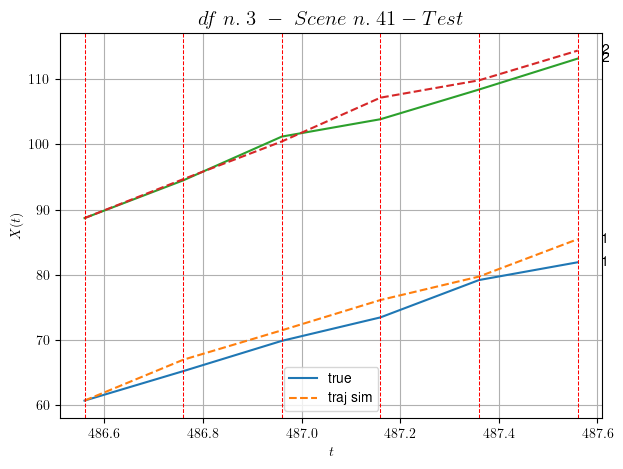

        For scene 41/81:
        * MSE = 3.3772566118683756
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.42/81


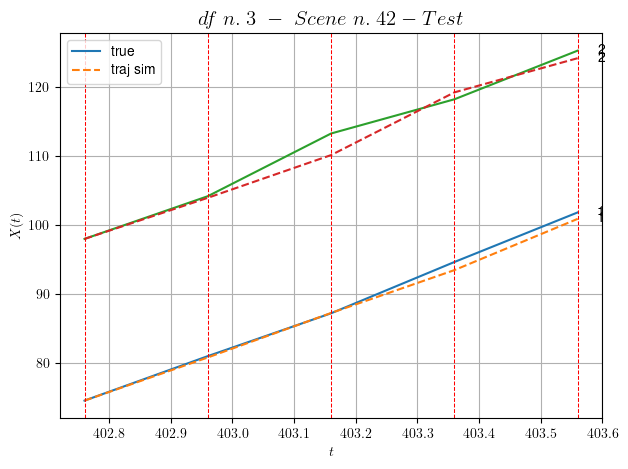

        For scene 42/81:
        * MSE = 1.4364708846501282
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.43/81


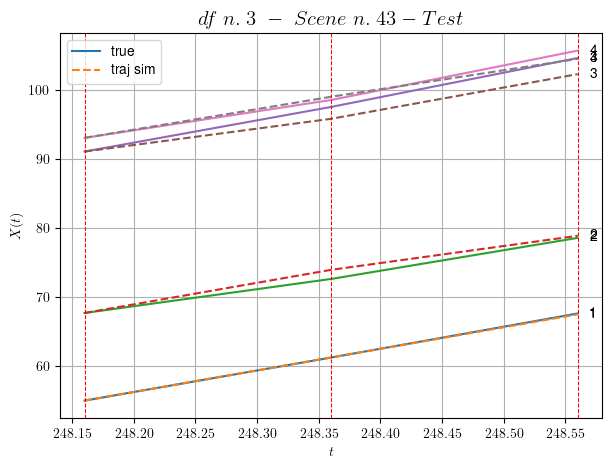

        For scene 43/81:
        * MSE = 0.9939826197876991
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.44/81


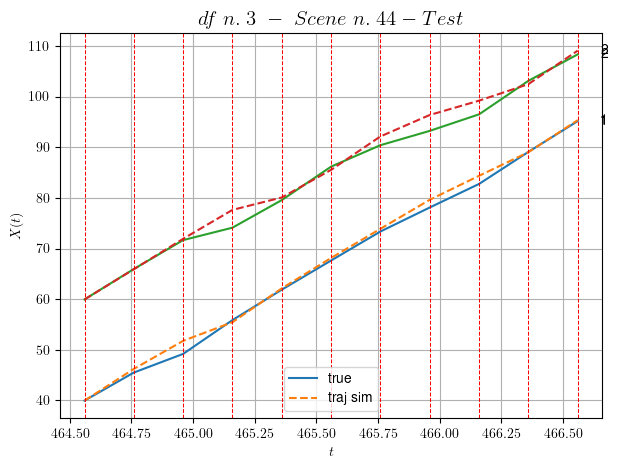

        For scene 44/81:
        * MSE = 2.1355910780160468
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.45/81


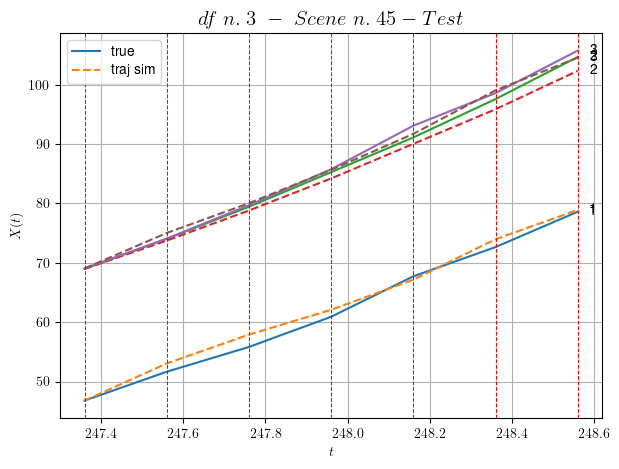

        For scene 45/81:
        * MSE = 1.2186400810858027
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.46/81


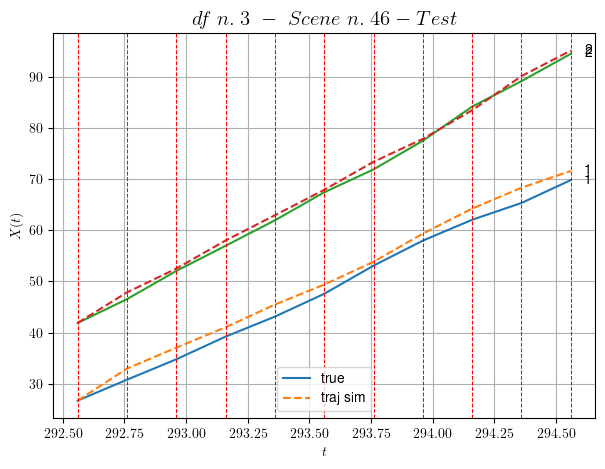

        For scene 46/81:
        * MSE = 2.258412851027499
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.47/81


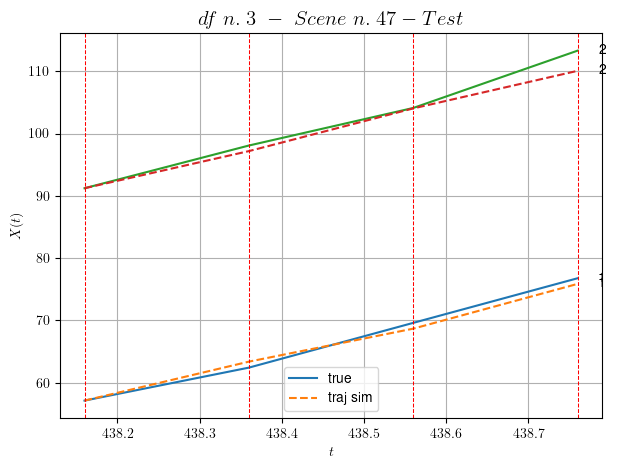

        For scene 47/81:
        * MSE = 1.7409128334139026
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.48/81


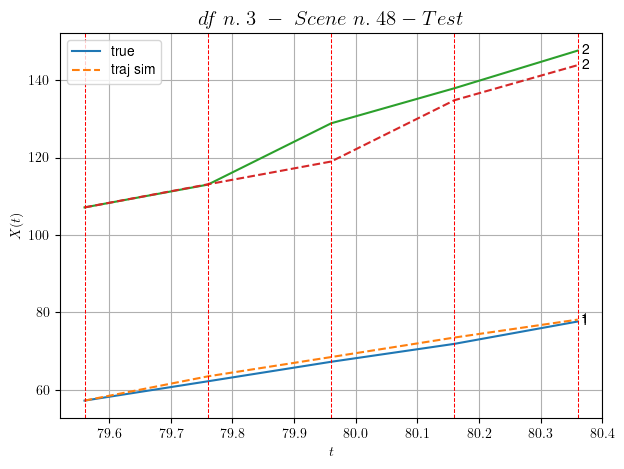

        For scene 48/81:
        * MSE = 12.700179948578912
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.49/81


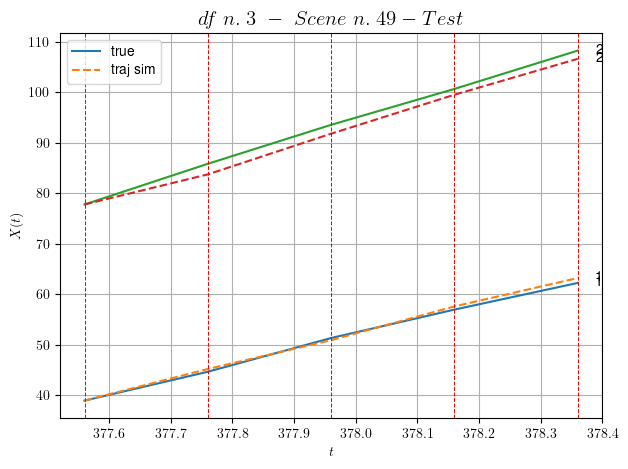

        For scene 49/81:
        * MSE = 1.3272236234783328
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.50/81


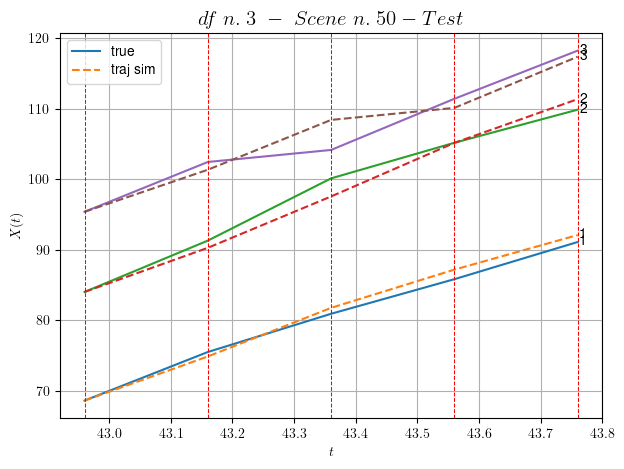

        For scene 50/81:
        * MSE = 2.3672660481744345
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.51/81


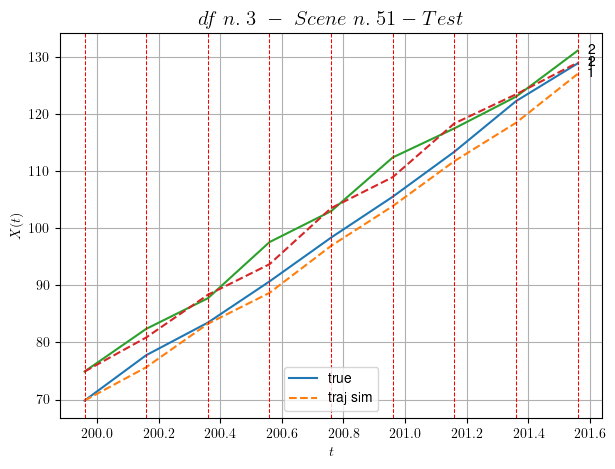

        For scene 51/81:
        * MSE = 3.8277264937949615
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.52/81


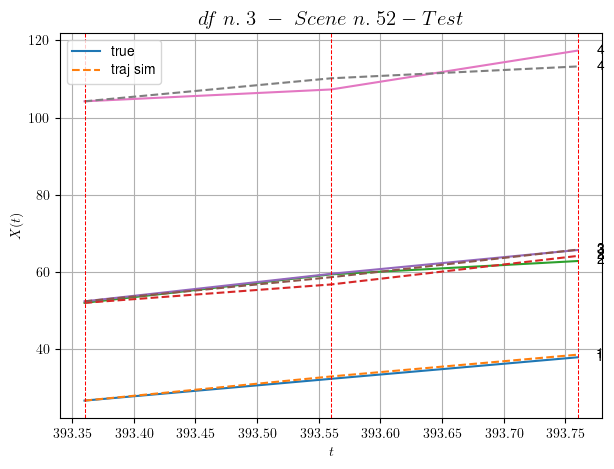

        For scene 52/81:
        * MSE = 2.947936379753609
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.53/81


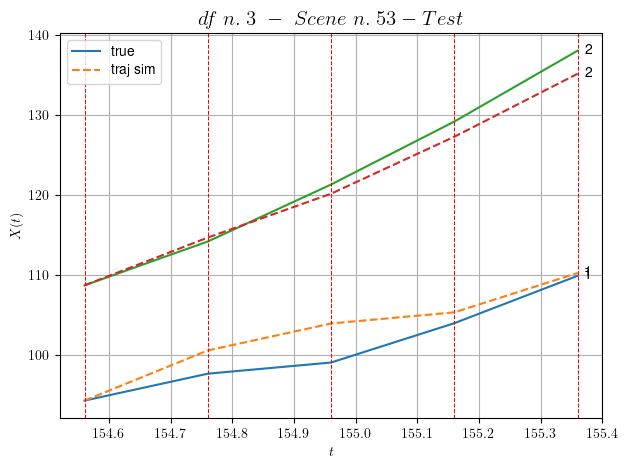

        For scene 53/81:
        * MSE = 4.746814656036451
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.54/81


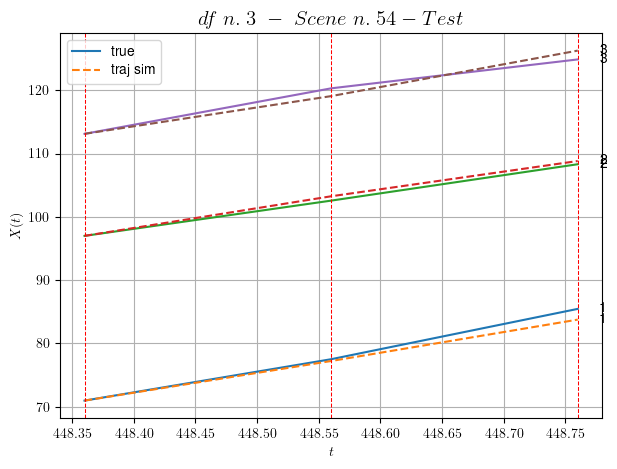

        For scene 54/81:
        * MSE = 0.7932254028886732
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.55/81


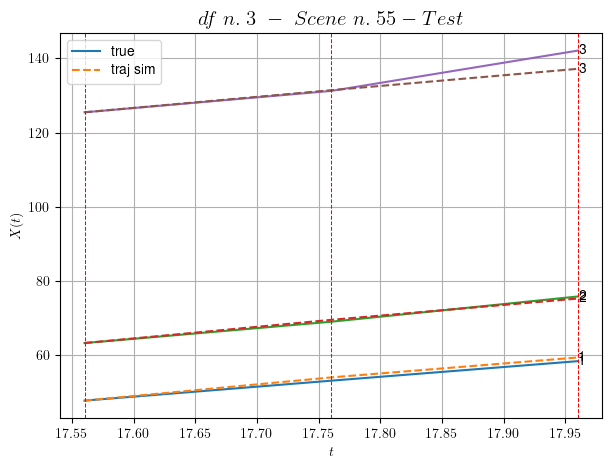

        For scene 55/81:
        * MSE = 2.9461975913296885
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.56/81


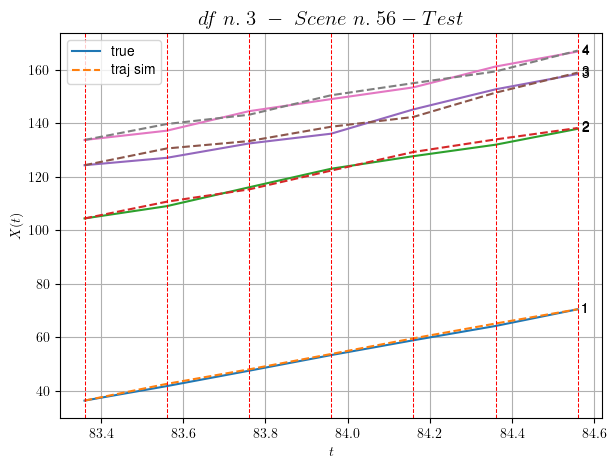

        For scene 56/81:
        * MSE = 2.0842905085501853
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.57/81


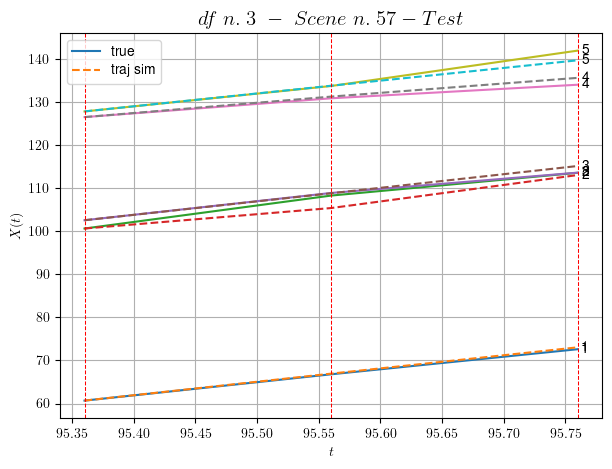

        For scene 57/81:
        * MSE = 1.2665002663766114
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.58/81


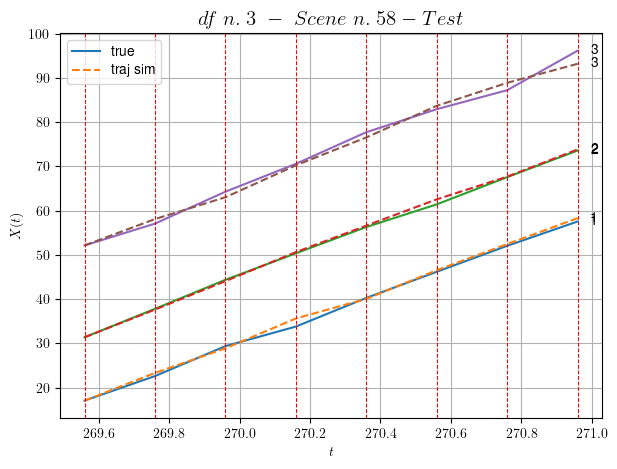

        For scene 58/81:
        * MSE = 0.9581805066628685
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.59/81


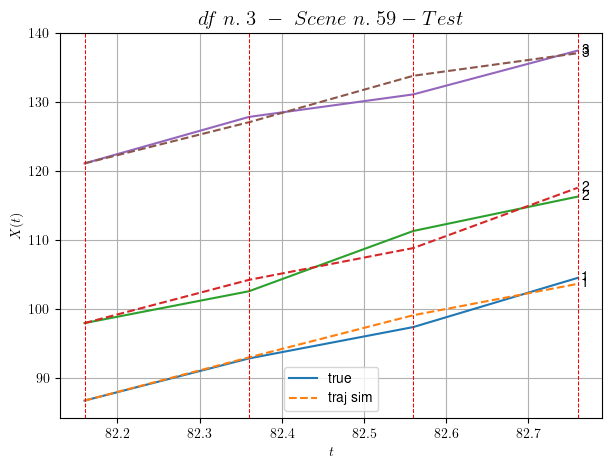

        For scene 59/81:
        * MSE = 1.8500688880223632
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.60/81


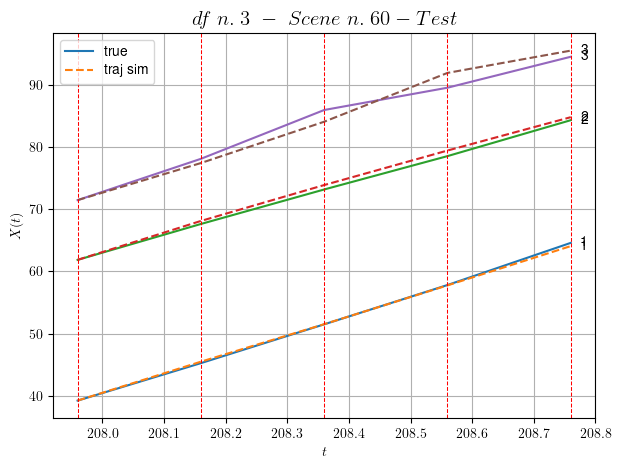

        For scene 60/81:
        * MSE = 0.8496210582032352
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.61/81


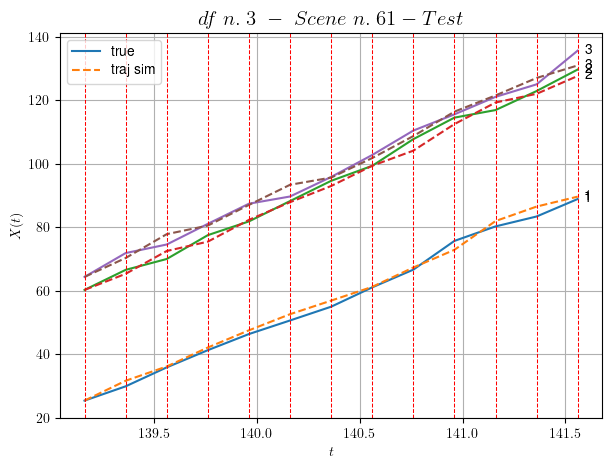

        For scene 61/81:
        * MSE = 3.469896467267598
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.62/81


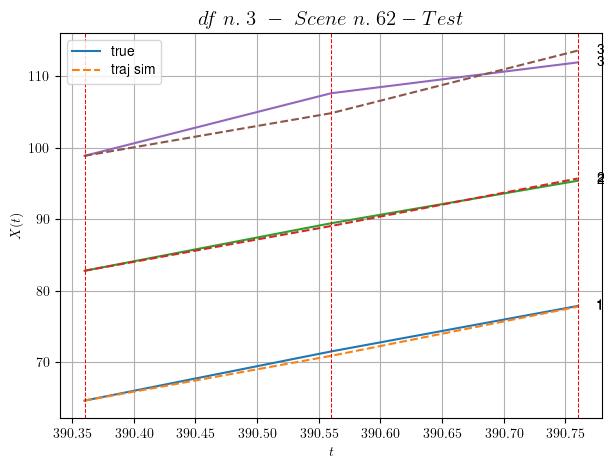

        For scene 62/81:
        * MSE = 1.2361234585880527
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.63/81


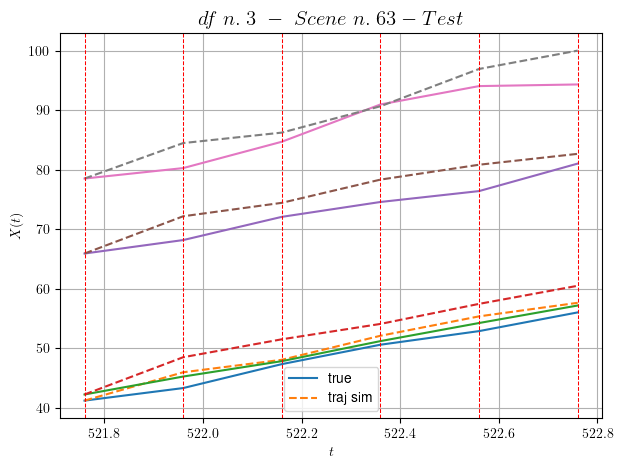

        For scene 63/81:
        * MSE = 7.95717165534985
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.64/81


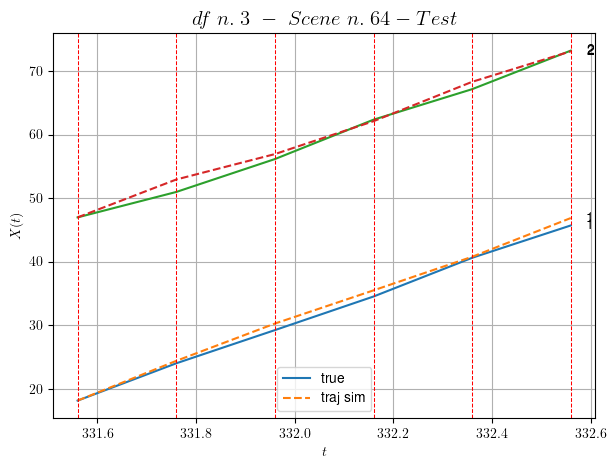

        For scene 64/81:
        * MSE = 0.7832923095921612
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.65/81


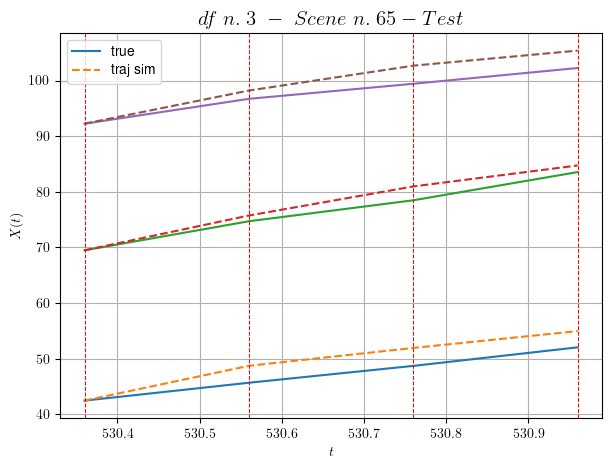

        For scene 65/81:
        * MSE = 4.95759567104454
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.66/81


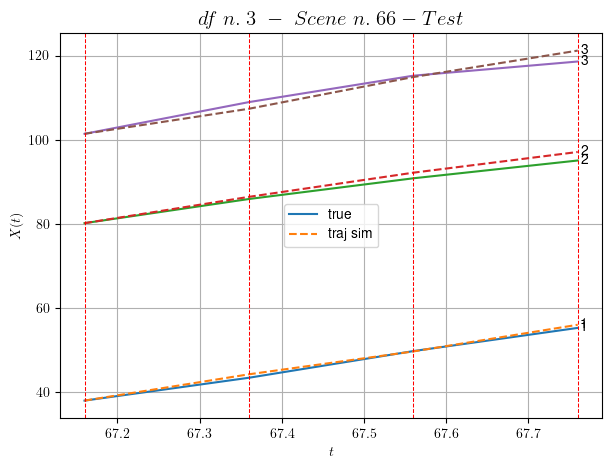

        For scene 66/81:
        * MSE = 1.392884560253357
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.67/81


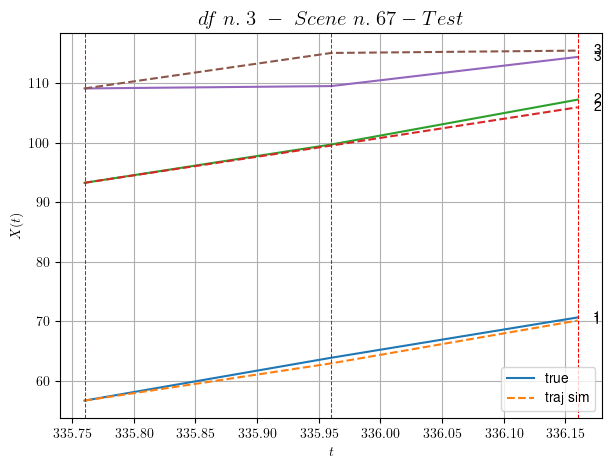

        For scene 67/81:
        * MSE = 3.8811483699553637
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.68/81


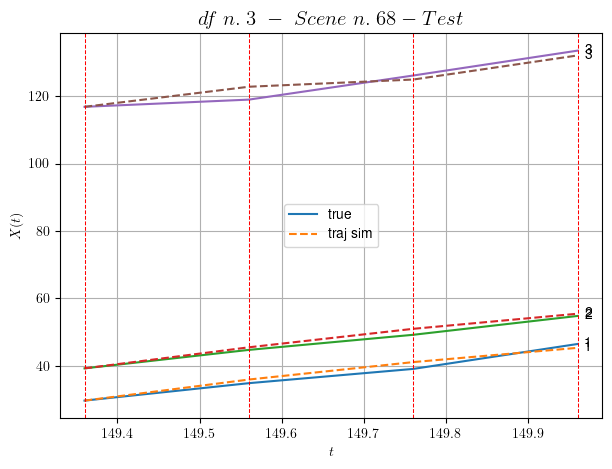

        For scene 68/81:
        * MSE = 2.401652055981766
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.69/81


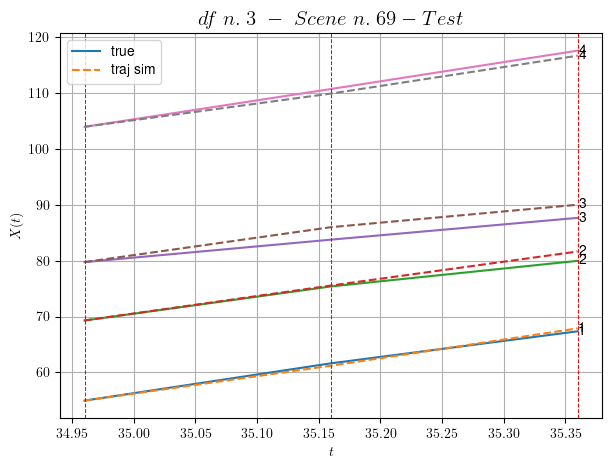

        For scene 69/81:
        * MSE = 1.27804184515446
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.70/81


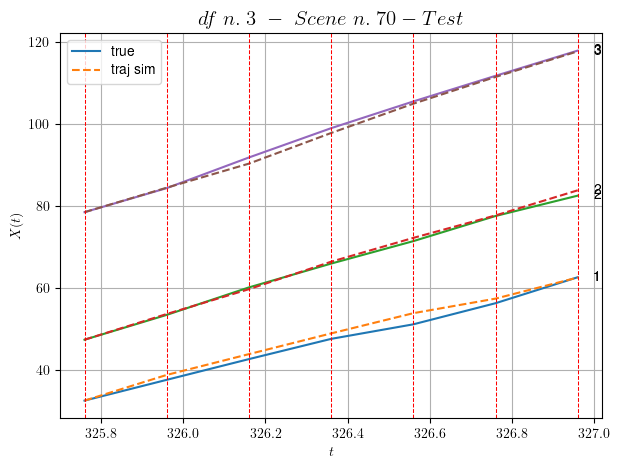

        For scene 70/81:
        * MSE = 0.9574104804817574
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.71/81


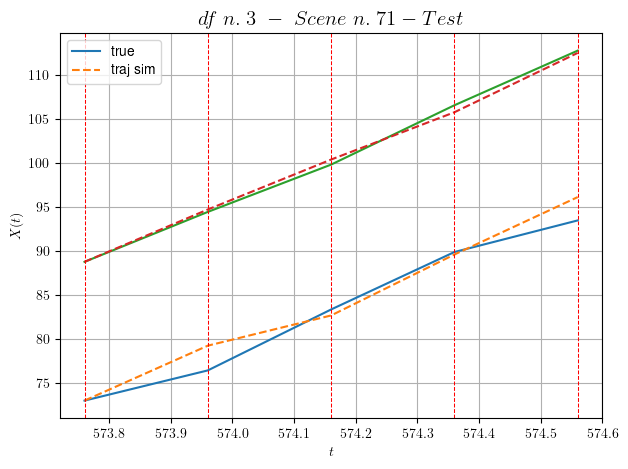

        For scene 71/81:
        * MSE = 1.665958839135471
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.72/81


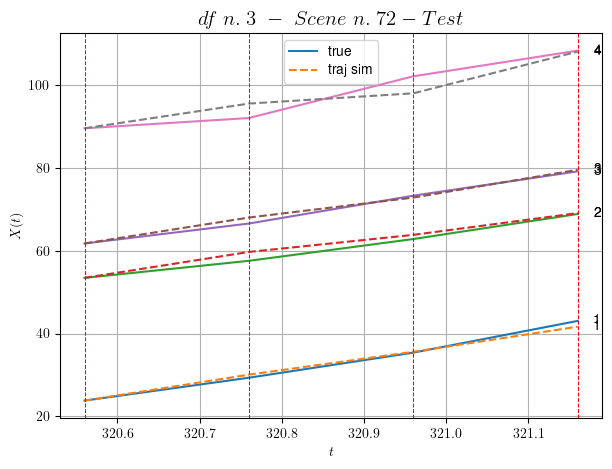

        For scene 72/81:
        * MSE = 2.473124606851762
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.73/81


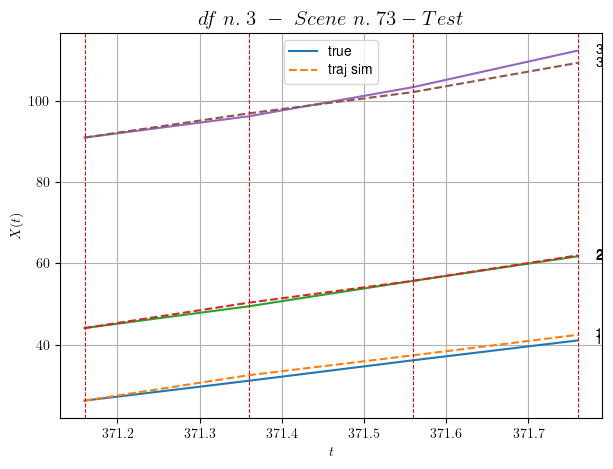

        For scene 73/81:
        * MSE = 1.4342307105791405
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.74/81


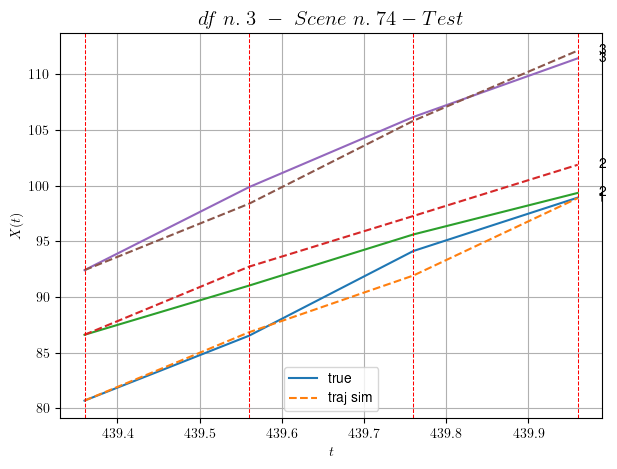

        For scene 74/81:
        * MSE = 1.6512553645318475
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.75/81


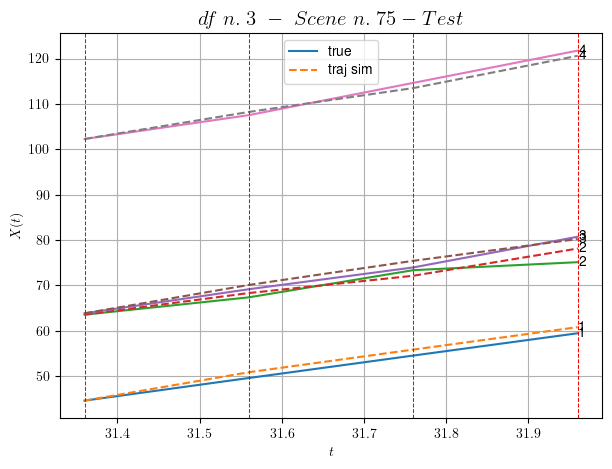

        For scene 75/81:
        * MSE = 1.435409659376443
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.76/81


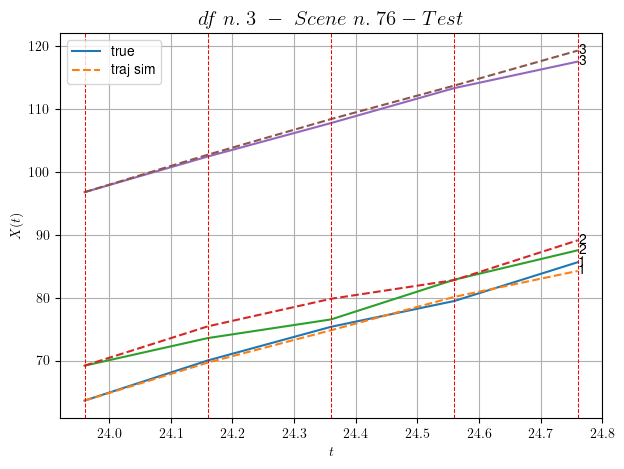

        For scene 76/81:
        * MSE = 1.5525588188378778
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.77/81


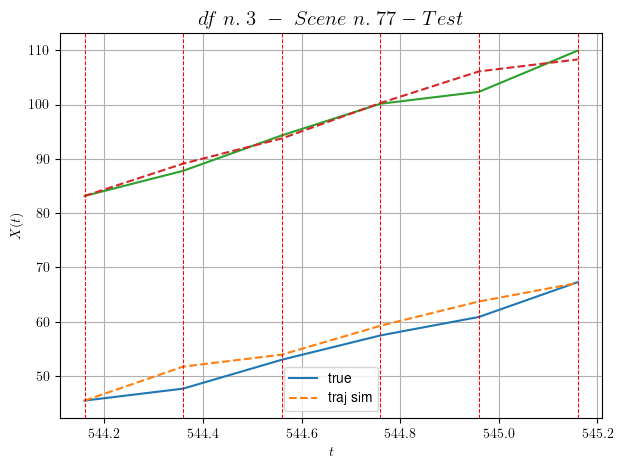

        For scene 77/81:
        * MSE = 3.9591986336809653
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.78/81


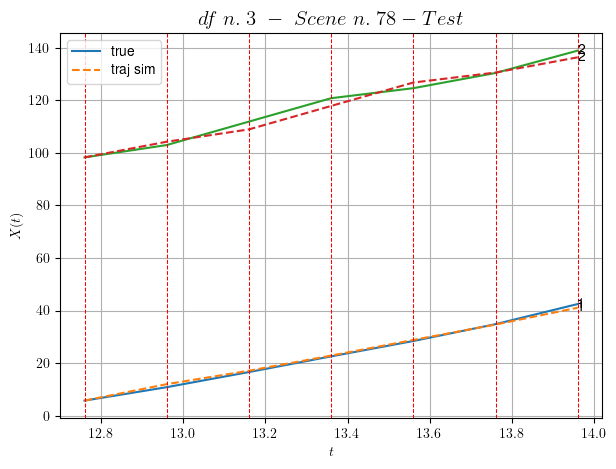

        For scene 78/81:
        * MSE = 2.42858302437093
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.79/81


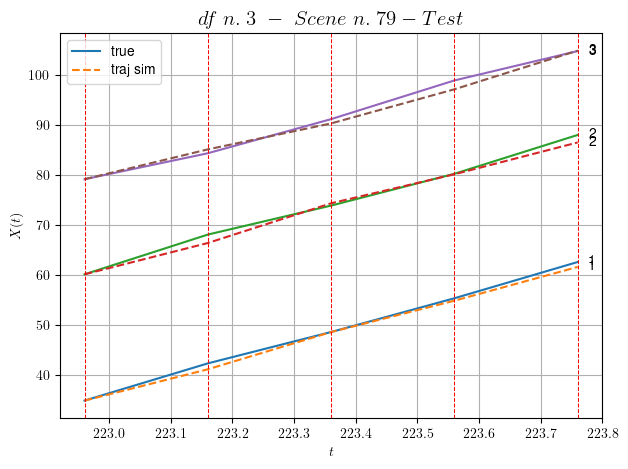

        For scene 79/81:
        * MSE = 0.8263306408116272
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.80/81


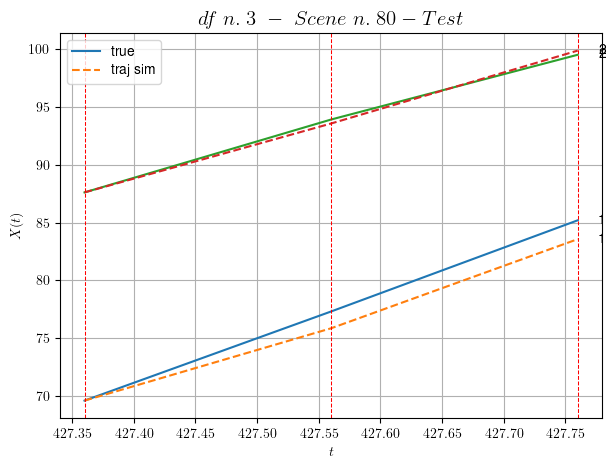

        For scene 80/81:
        * MSE = 0.8370733229416696
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.81/81


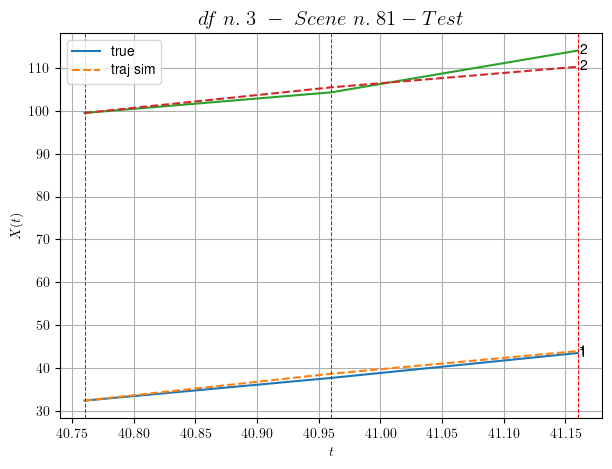

        For scene 81/81:
        * MSE = 2.7748609145745435
----------------------------------------------------------------------------------------------------


MSE test: 2.927076002770758

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.9020175159646011
          * MSE test: 2.927076002770758
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 4/10 dfs.
In DataFrame n.4 we have 69 scenes.
    To train the model we use 6 scenes, the remaining 63 to test the model.

Training step. (6 scenes)
DataFrame n.4. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [65.04,65.64]


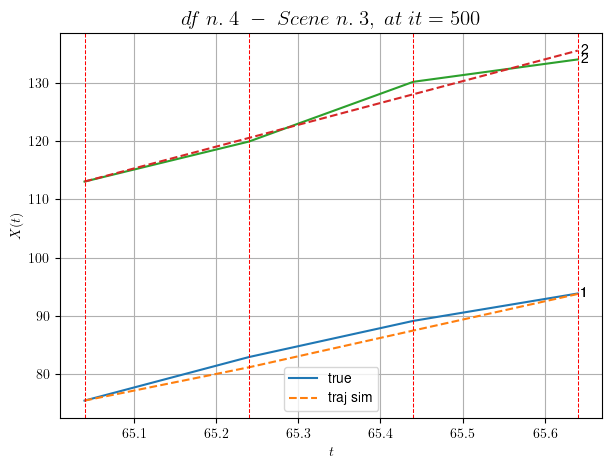

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=0.005 with mse=5.413976967025317 at it=24
        * v0 = 37.41903742148373
        * MSE = 1.6223188444164025
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.44,321.04]


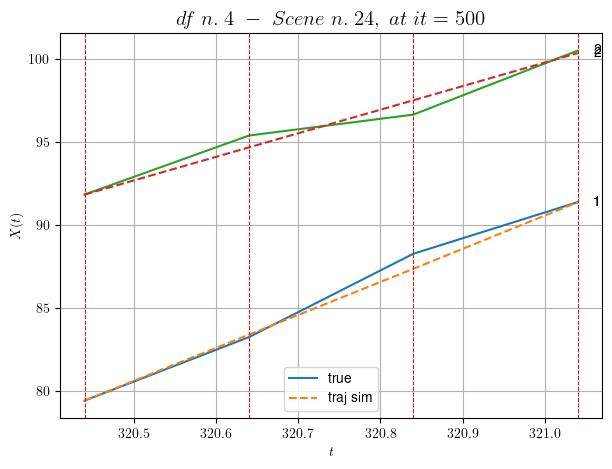

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=0.001 with mse=22.14173766550698 at it=24
        * v0 = 14.162426648992575
        * MSE = 0.26376064724825826
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [285.84,287.44]


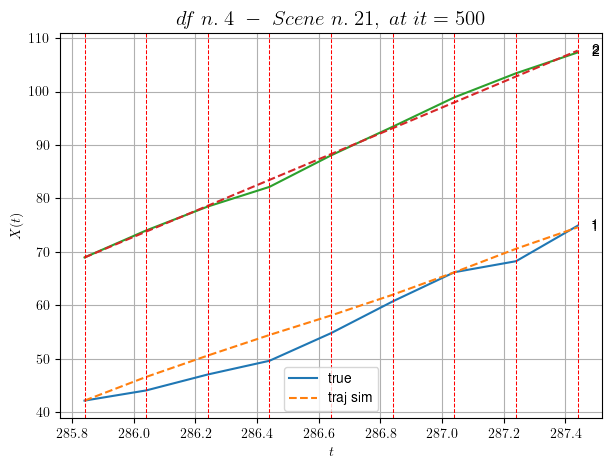

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=0.01 with mse=16.946752423596124 at it=24
        * v0 = 24.201830847421597
        * MSE = 2.183774920216831
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.64,555.04]


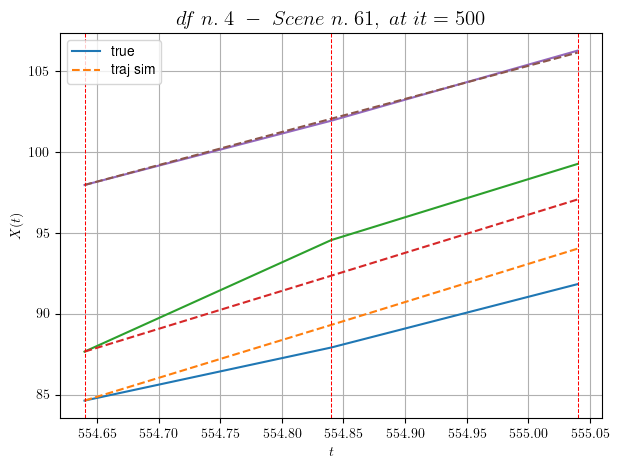

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=0.001 with mse=3.8743070874892376 at it=24
        * v0 = 20.44072781876475
        * MSE = 1.8228679182996004
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [182.04,183.64]


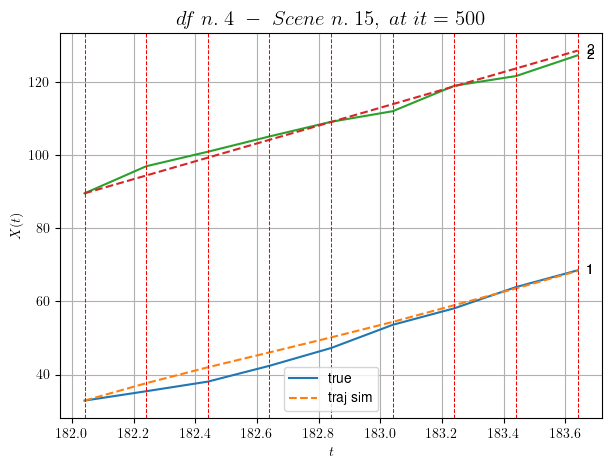

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=0.01 with mse=19.551599445857136 at it=24
        * v0 = 24.38495342857986
        * MSE = 2.3160799716526057
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [233.84,235.24]


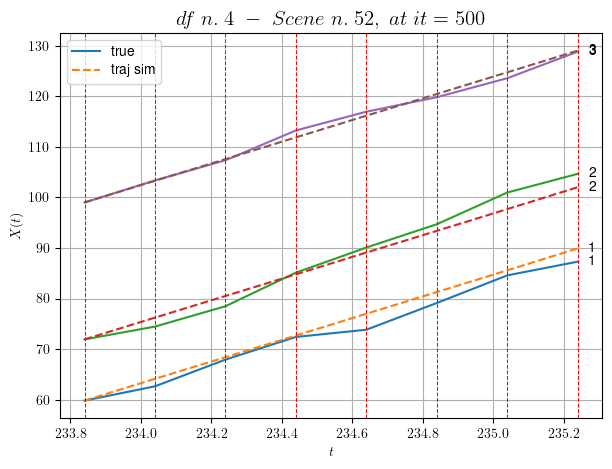

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.001 with mse=20.1444535622596 at it=24
        * v0 = 21.462806471988372
        * MSE = 2.3813512458603023
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.7650255912823336
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (63 scenes)
DataFrame n.4. Scene n.1/63


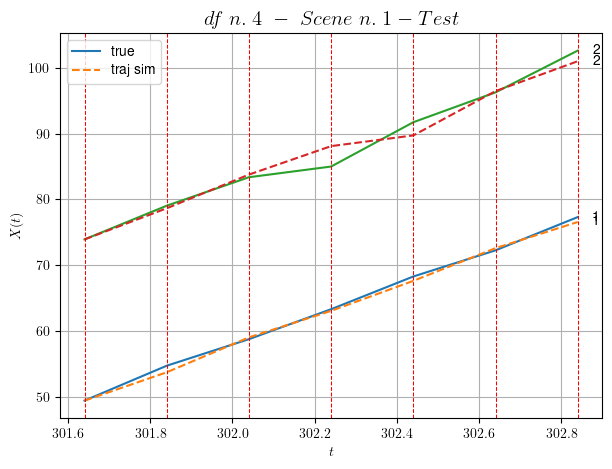

        For scene 1/63:
        * MSE = 1.3504532395090276
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/63


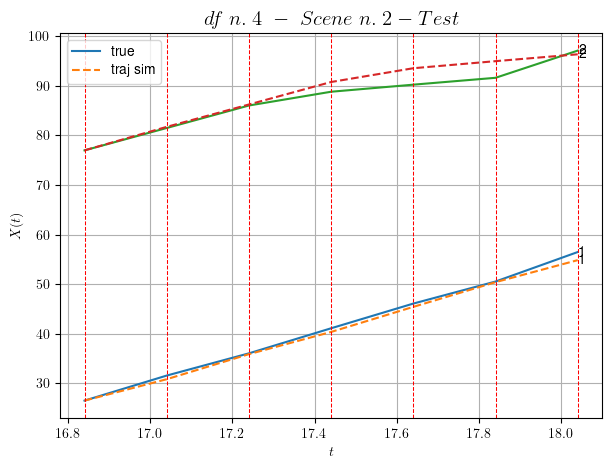

        For scene 2/63:
        * MSE = 2.210256497946034
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/63


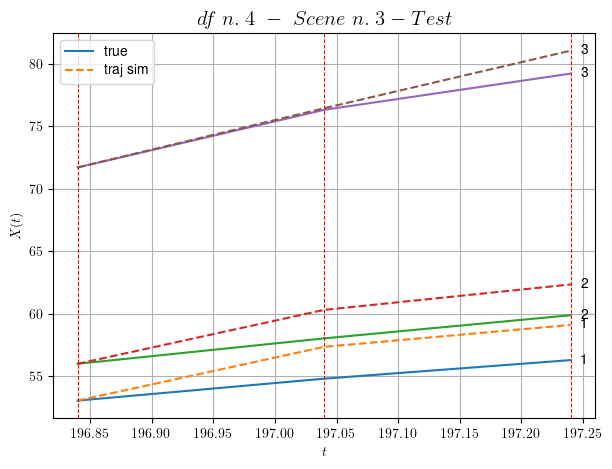

        For scene 3/63:
        * MSE = 3.2239038537321973
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/63


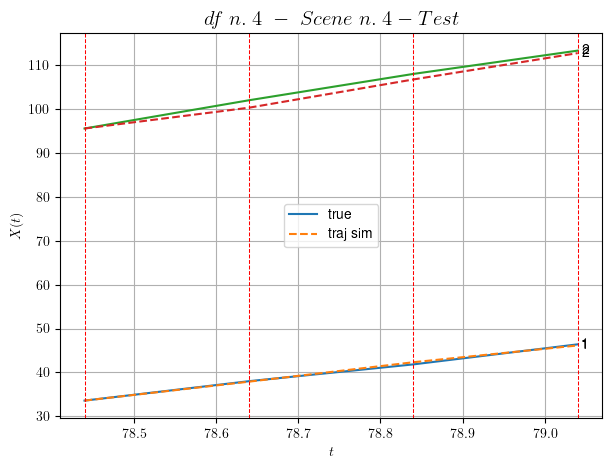

        For scene 4/63:
        * MSE = 0.6371833684422749
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/63


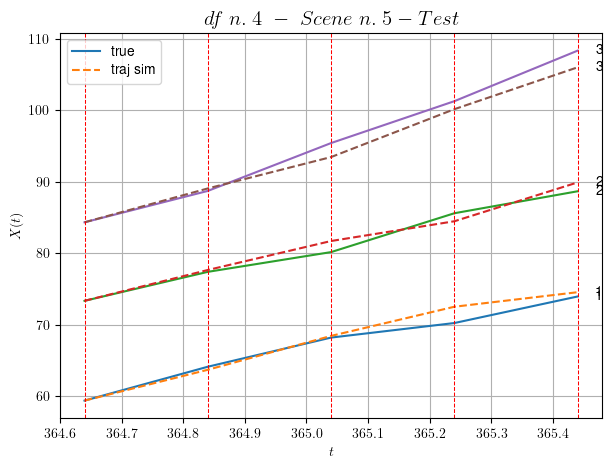

        For scene 5/63:
        * MSE = 1.4452579629172895
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/63


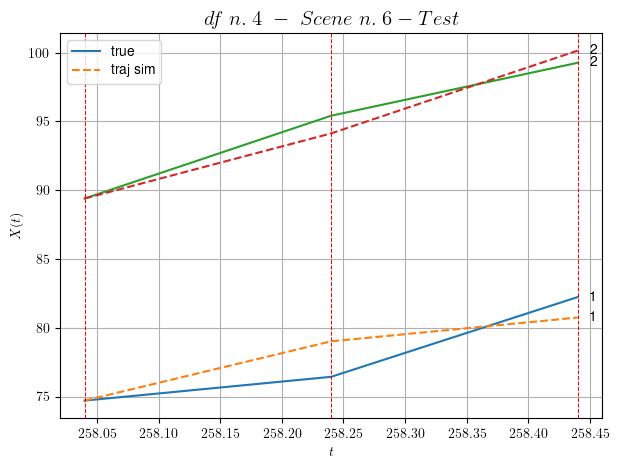

        For scene 6/63:
        * MSE = 1.8859742726101985
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/63


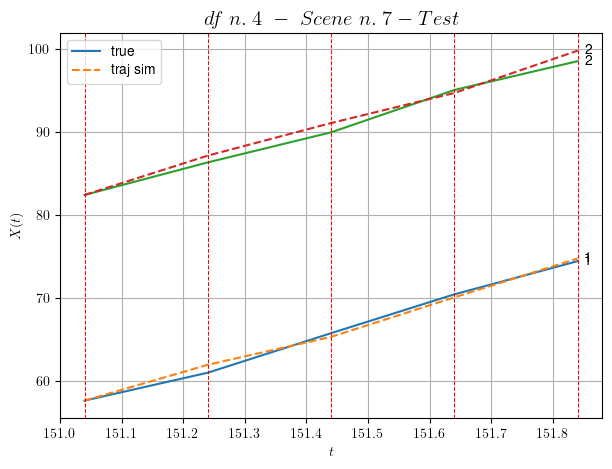

        For scene 7/63:
        * MSE = 0.4996936618322889
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/63


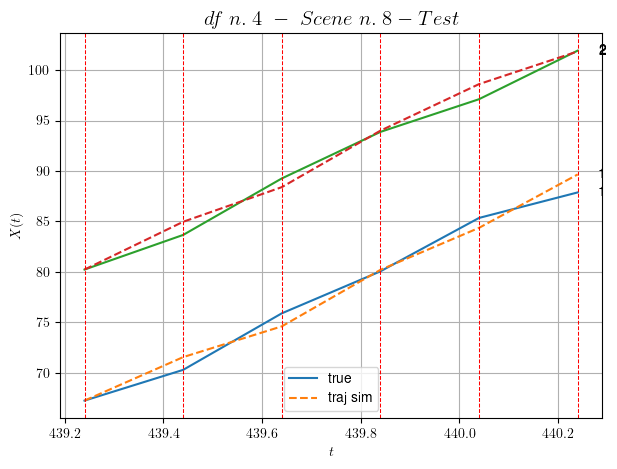

        For scene 8/63:
        * MSE = 1.0106008175584276
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/63


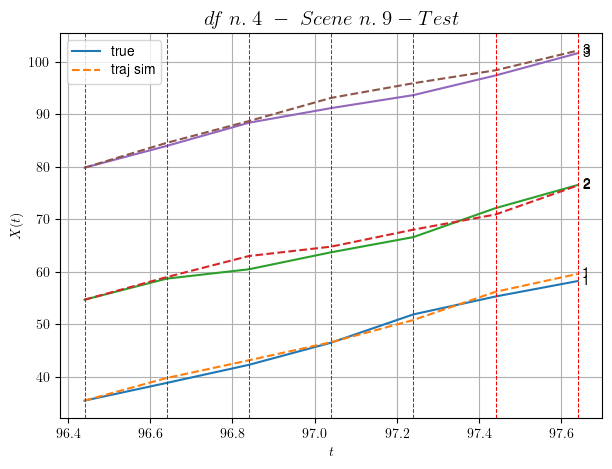

        For scene 9/63:
        * MSE = 1.2933155658328845
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/63


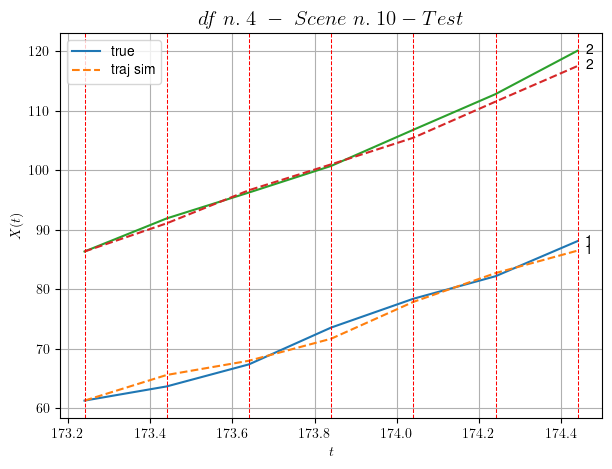

        For scene 10/63:
        * MSE = 1.544677076974018
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/63


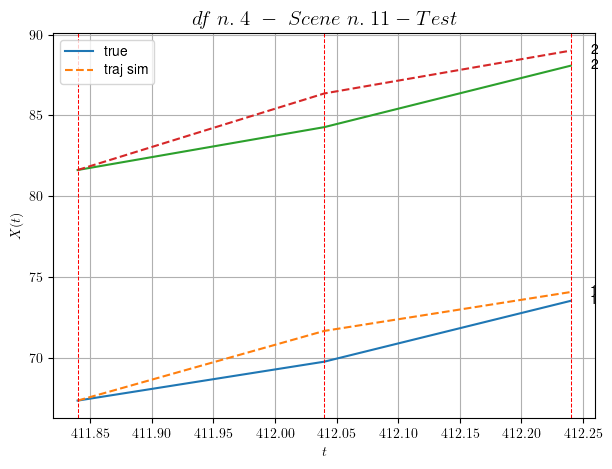

        For scene 11/63:
        * MSE = 1.521114768583232
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/63


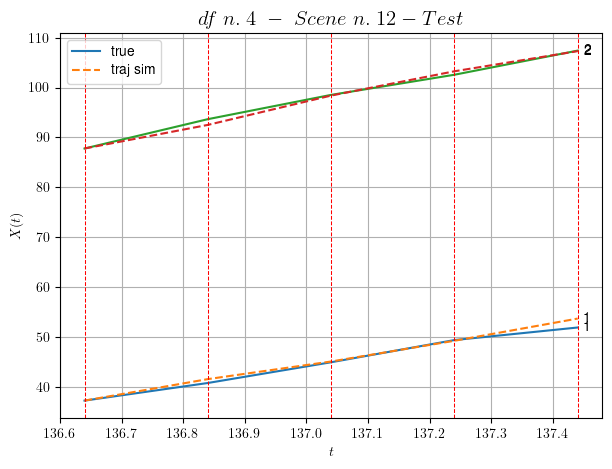

        For scene 12/63:
        * MSE = 0.5689105365668594
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/63


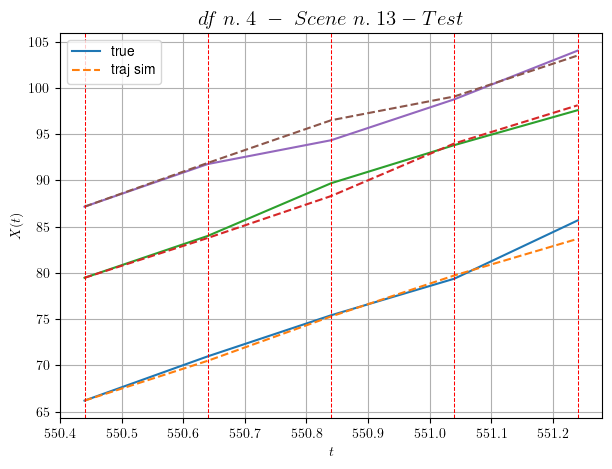

        For scene 13/63:
        * MSE = 0.7782452158144215
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/63


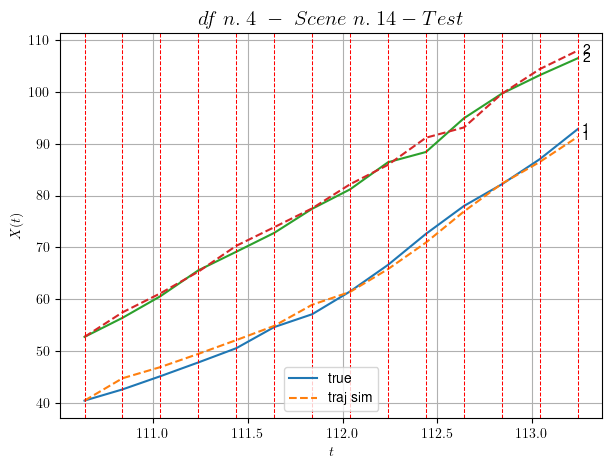

        For scene 14/63:
        * MSE = 1.5342571793742321
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/63


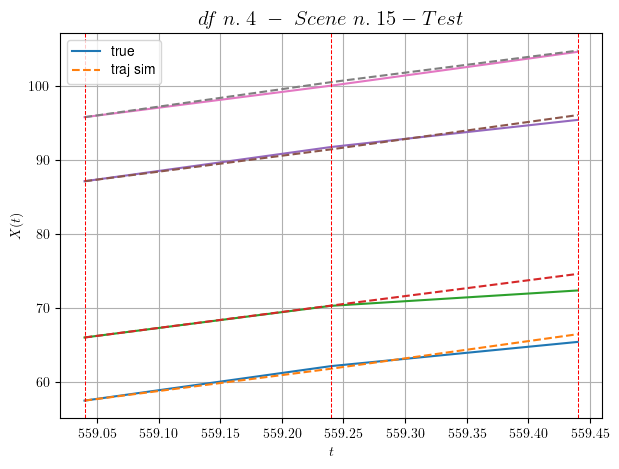

        For scene 15/63:
        * MSE = 0.5823219512222129
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/63


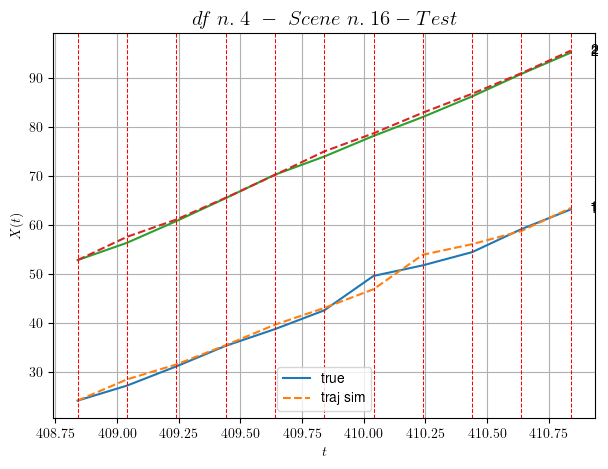

        For scene 16/63:
        * MSE = 0.9938162243984111
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/63


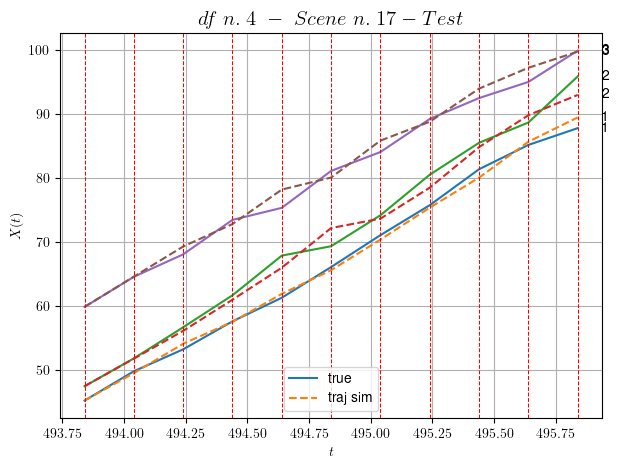

        For scene 17/63:
        * MSE = 1.6791049948506511
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/63


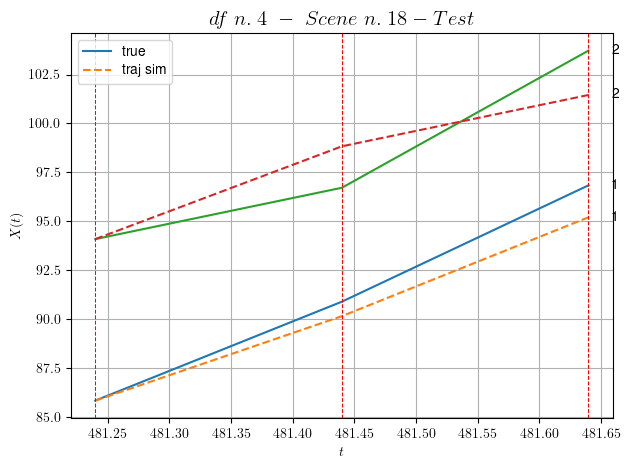

        For scene 18/63:
        * MSE = 2.13501886030578
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/63


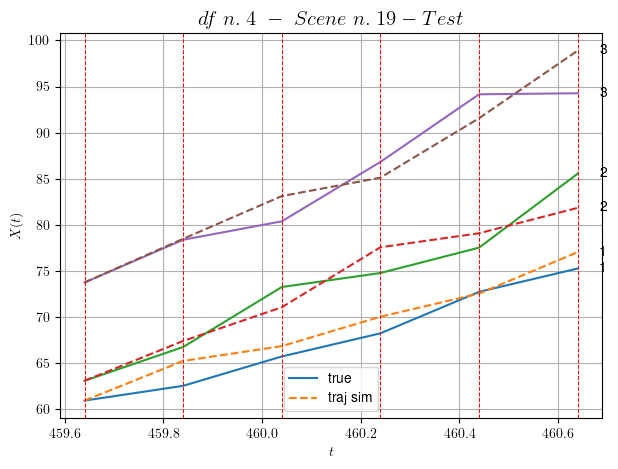

        For scene 19/63:
        * MSE = 4.593088200975077
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/63


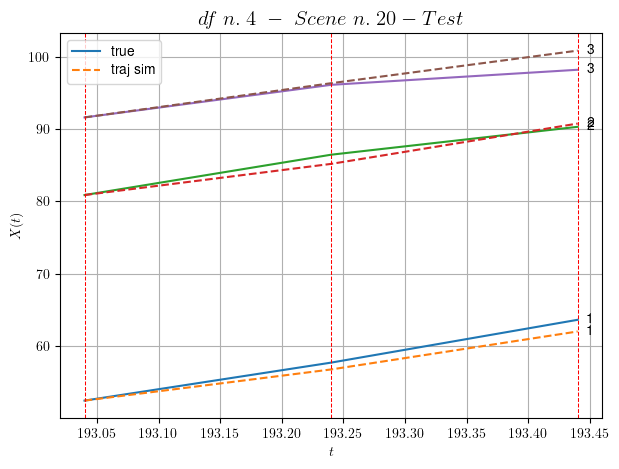

        For scene 20/63:
        * MSE = 1.3762390415067367
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/63


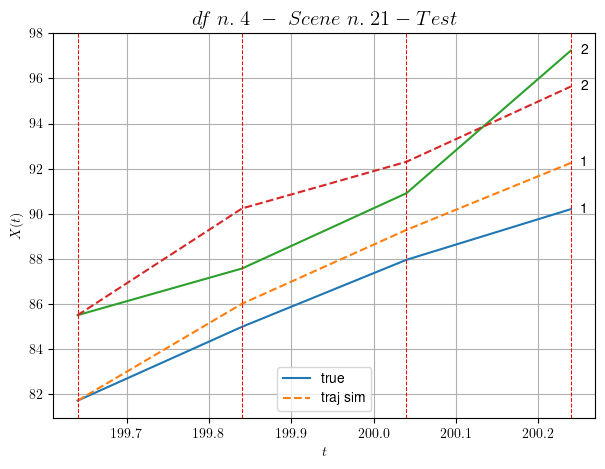

        For scene 21/63:
        * MSE = 2.326557031409477
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/63


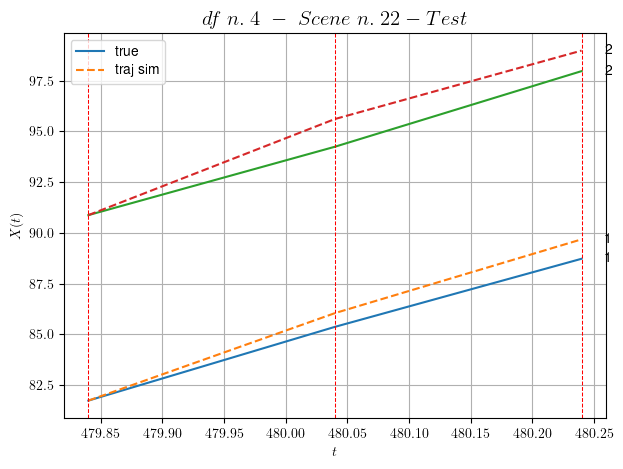

        For scene 22/63:
        * MSE = 0.7099657255717389
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/63


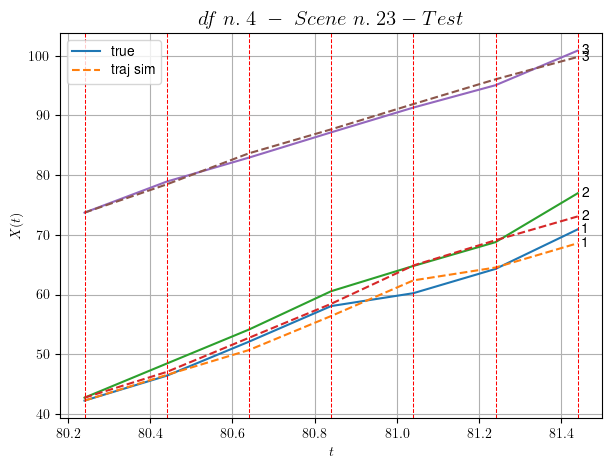

        For scene 23/63:
        * MSE = 1.9866084667555128
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.24/63


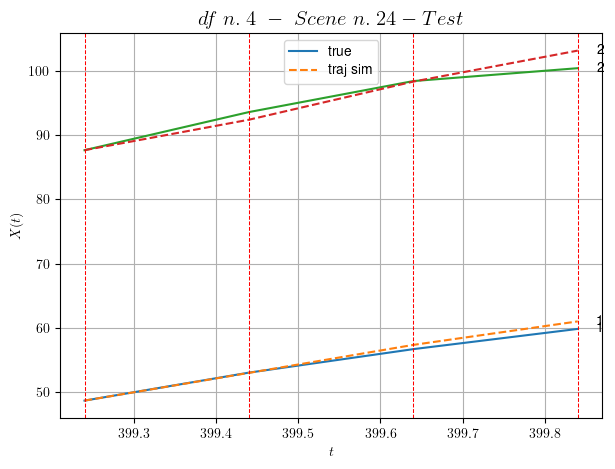

        For scene 24/63:
        * MSE = 1.3363416444517469
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.25/63


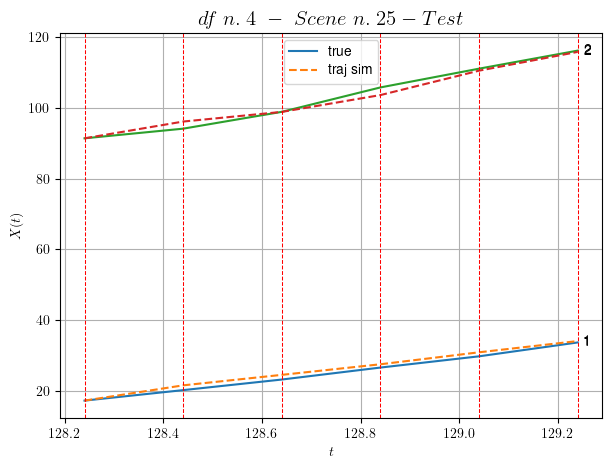

        For scene 25/63:
        * MSE = 1.2531988163344452
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.26/63


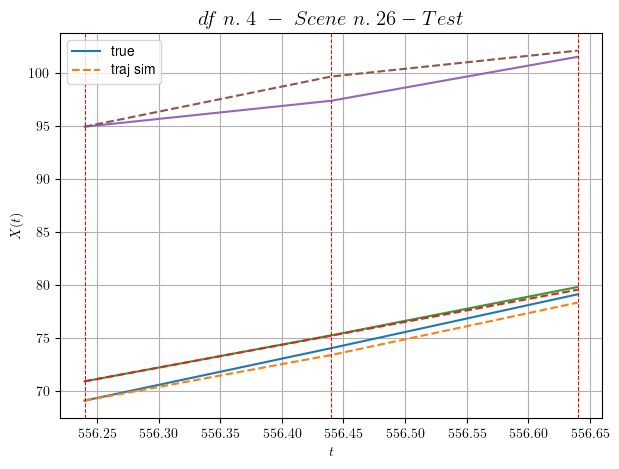

        For scene 26/63:
        * MSE = 0.7412886175914534
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.27/63


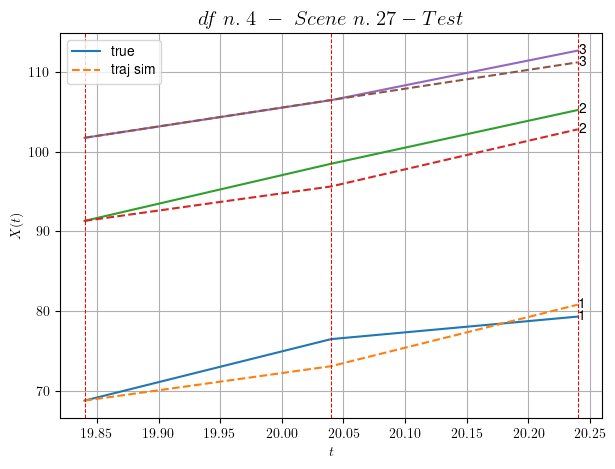

        For scene 27/63:
        * MSE = 3.3094384050022794
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.28/63


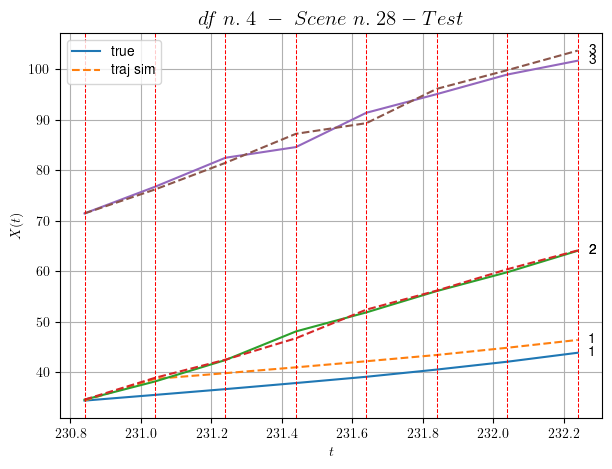

        For scene 28/63:
        * MSE = 3.4467196157631625
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.29/63


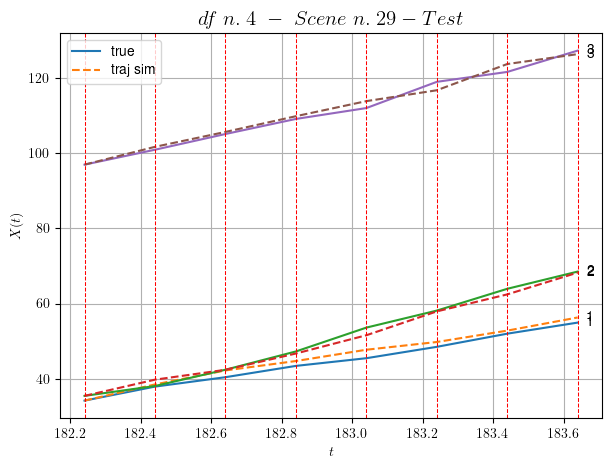

        For scene 29/63:
        * MSE = 1.6337505752389834
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.30/63


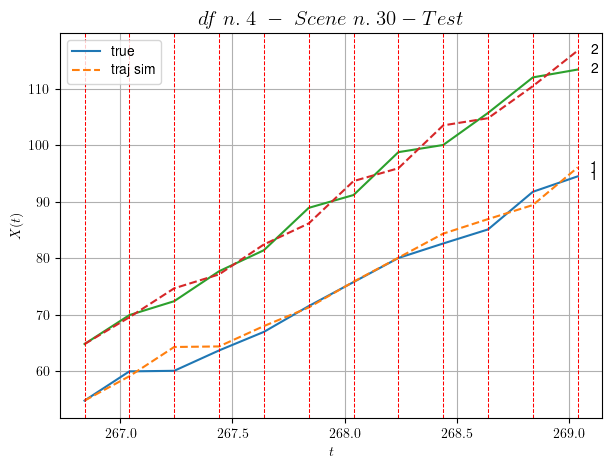

        For scene 30/63:
        * MSE = 3.7230209733454855
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.31/63


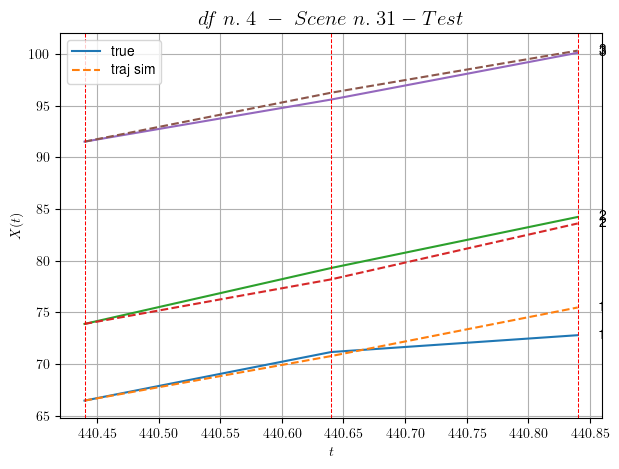

        For scene 31/63:
        * MSE = 1.0472275709994185
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.32/63


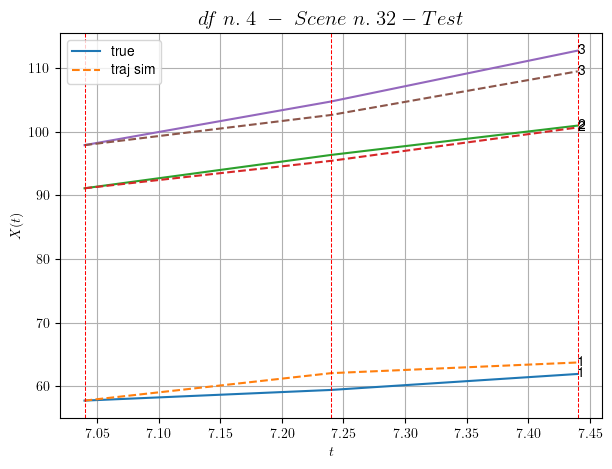

        For scene 32/63:
        * MSE = 2.9104145436890376
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.33/63


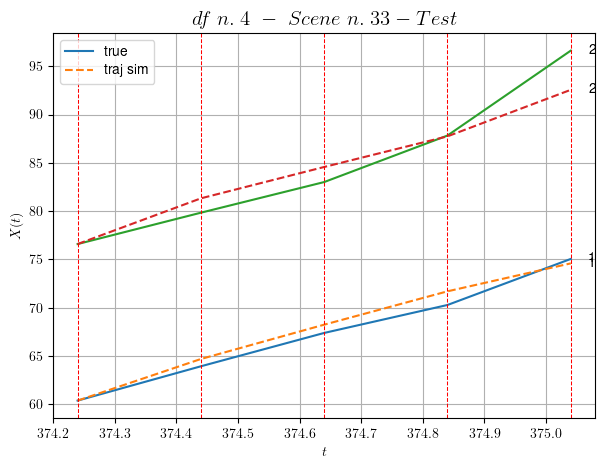

        For scene 33/63:
        * MSE = 2.4672289060346113
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.34/63


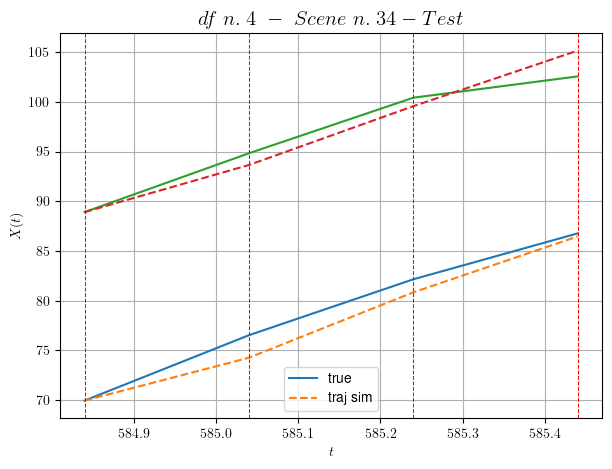

        For scene 34/63:
        * MSE = 1.9738241552068743
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.35/63


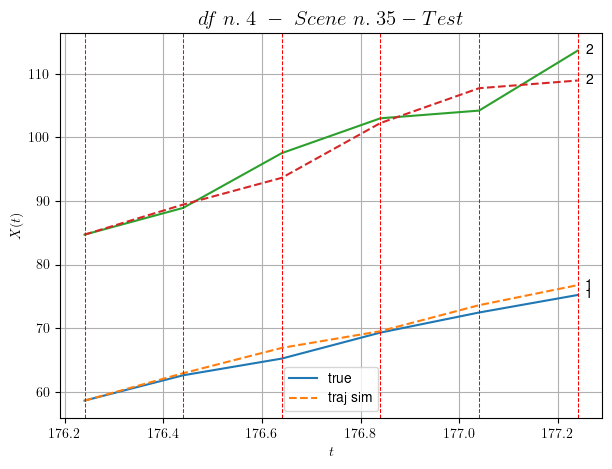

        For scene 35/63:
        * MSE = 4.7689685615303015
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.36/63


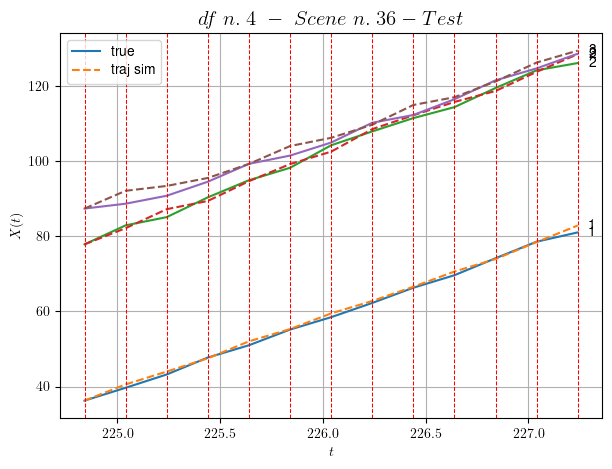

        For scene 36/63:
        * MSE = 1.6931409637142216
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.37/63


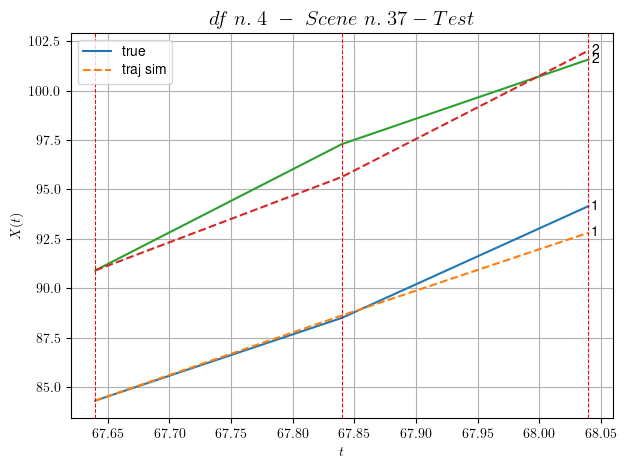

        For scene 37/63:
        * MSE = 0.7998483657063198
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.38/63


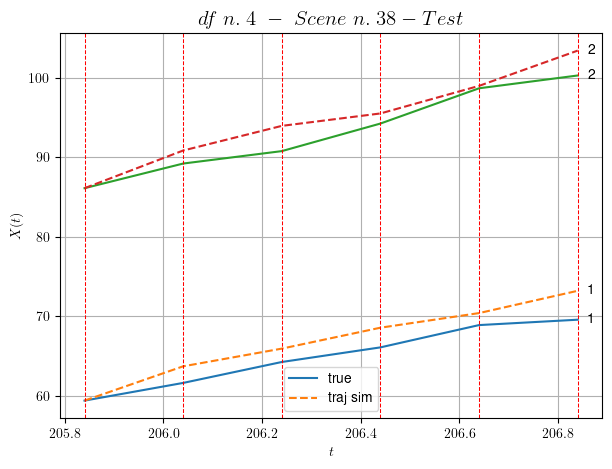

        For scene 38/63:
        * MSE = 4.419027896109407
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.39/63


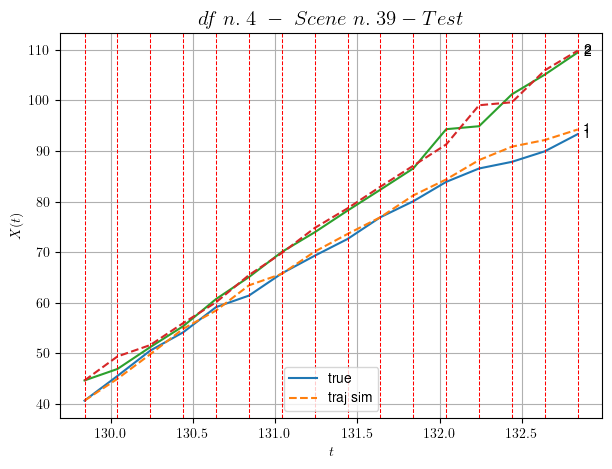

        For scene 39/63:
        * MSE = 2.03541900401743
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.40/63


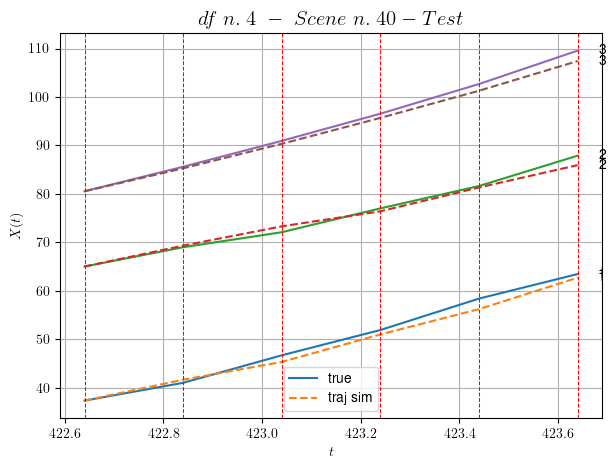

        For scene 40/63:
        * MSE = 1.2228955865946078
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.41/63


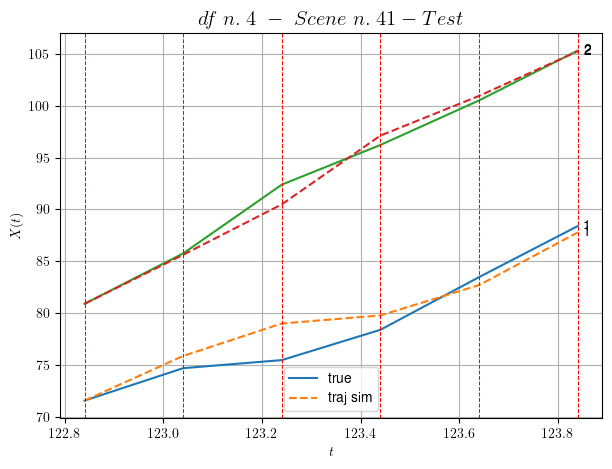

        For scene 41/63:
        * MSE = 1.7841930007045972
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.42/63


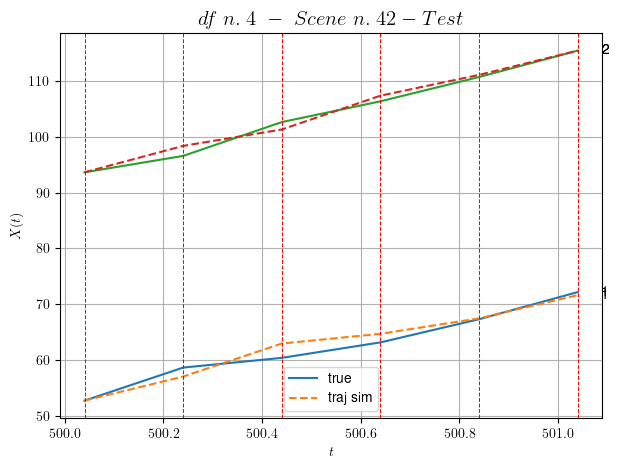

        For scene 42/63:
        * MSE = 1.5040905030179146
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.43/63


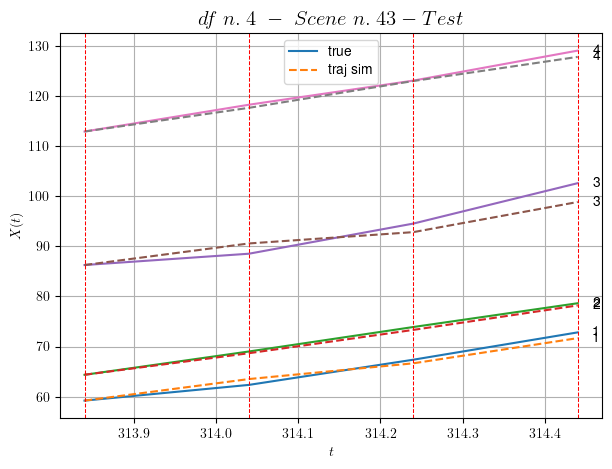

        For scene 43/63:
        * MSE = 1.692191822624428
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.44/63


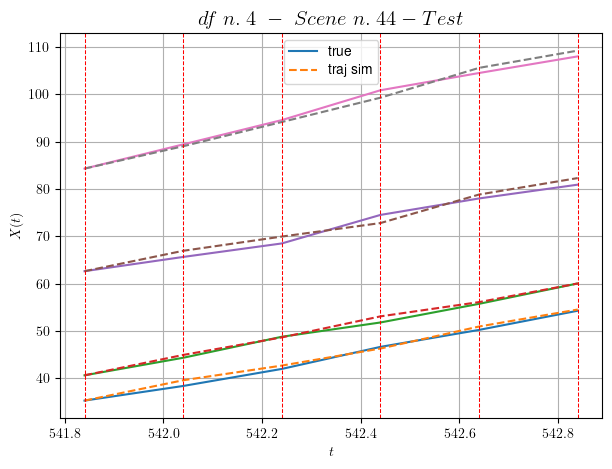

        For scene 44/63:
        * MSE = 0.8206118811045466
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.45/63


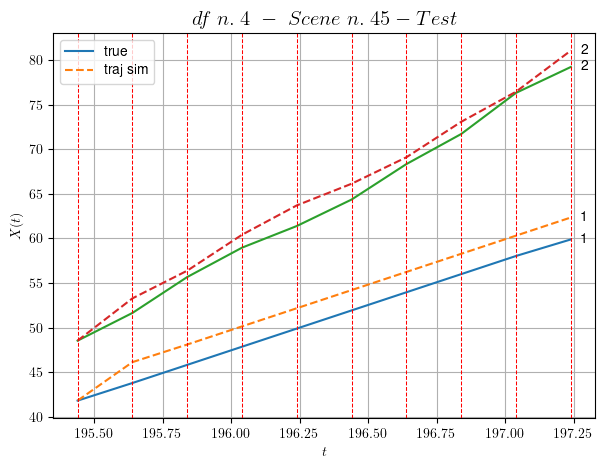

        For scene 45/63:
        * MSE = 3.3708052913161124
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.46/63


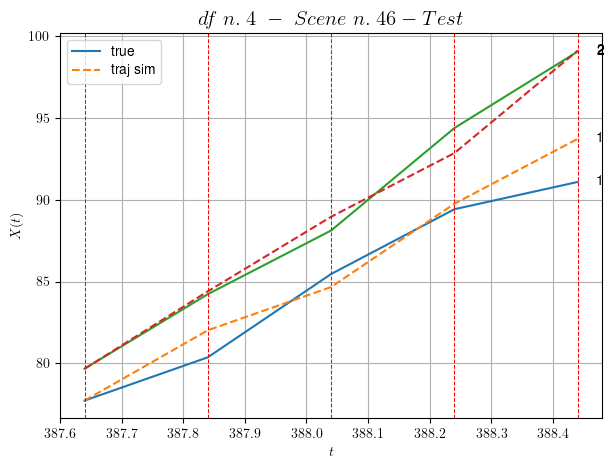

        For scene 46/63:
        * MSE = 1.3518096748364965
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.47/63


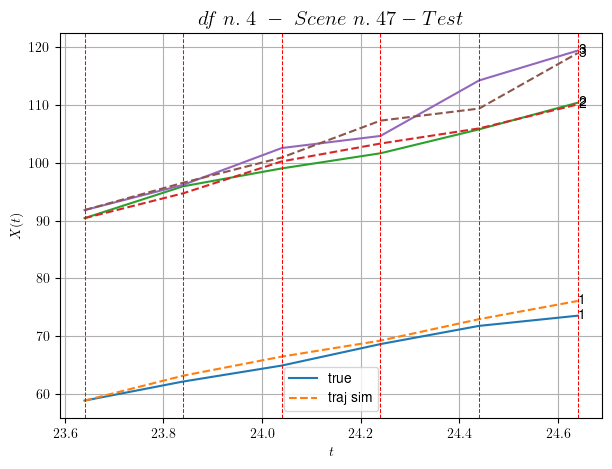

        For scene 47/63:
        * MSE = 2.840999018091784
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.48/63


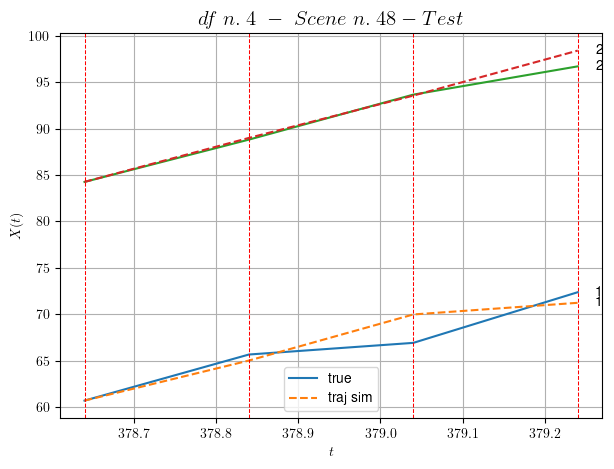

        For scene 48/63:
        * MSE = 1.7480679391252
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.49/63


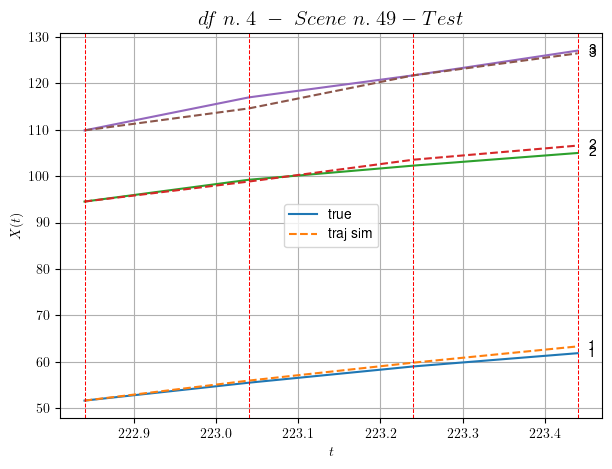

        For scene 49/63:
        * MSE = 1.1058619845461513
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.50/63


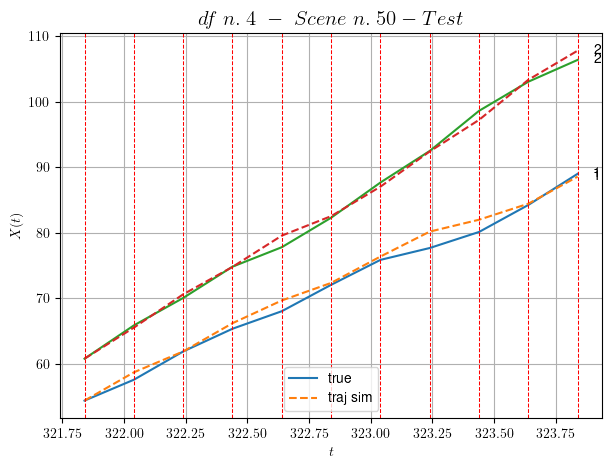

        For scene 50/63:
        * MSE = 1.0442663031935657
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.51/63


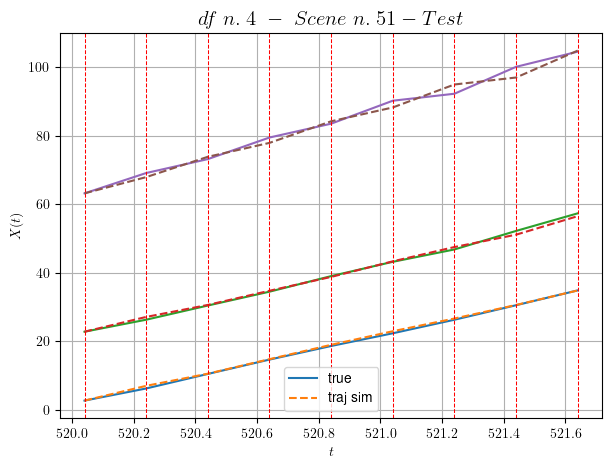

        For scene 51/63:
        * MSE = 1.1173645723983676
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.52/63


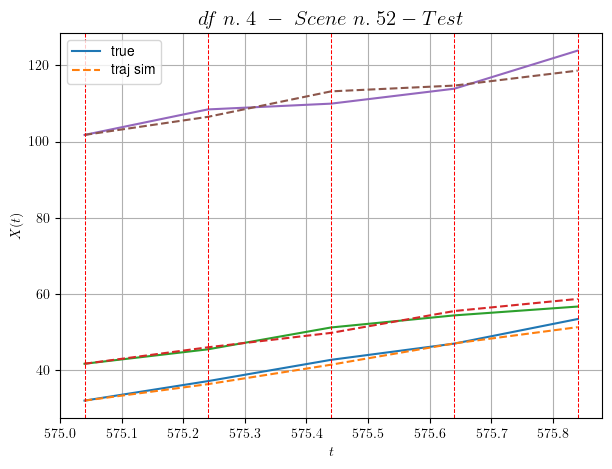

        For scene 52/63:
        * MSE = 3.780233701216273
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.53/63


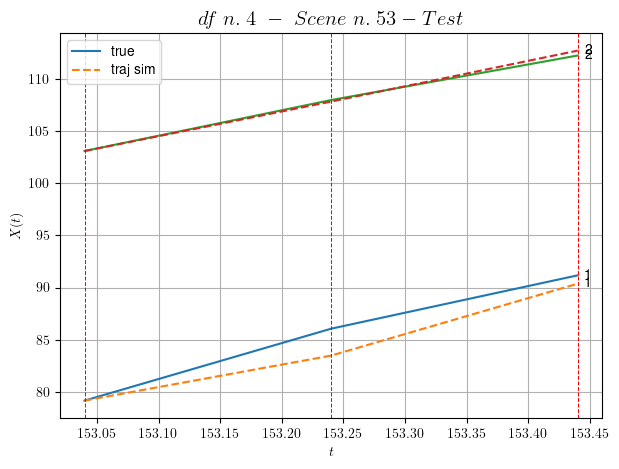

        For scene 53/63:
        * MSE = 1.2518463728322864
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.54/63


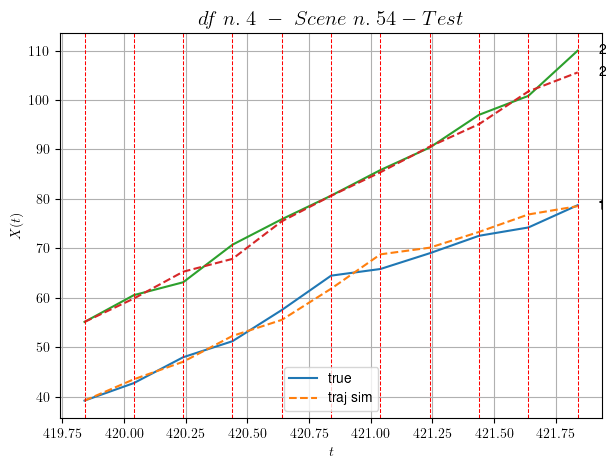

        For scene 54/63:
        * MSE = 3.120846615748511
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.55/63


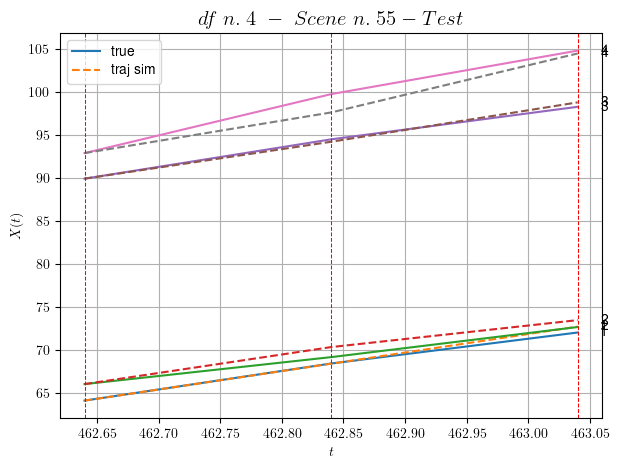

        For scene 55/63:
        * MSE = 0.6256479873826717
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.56/63


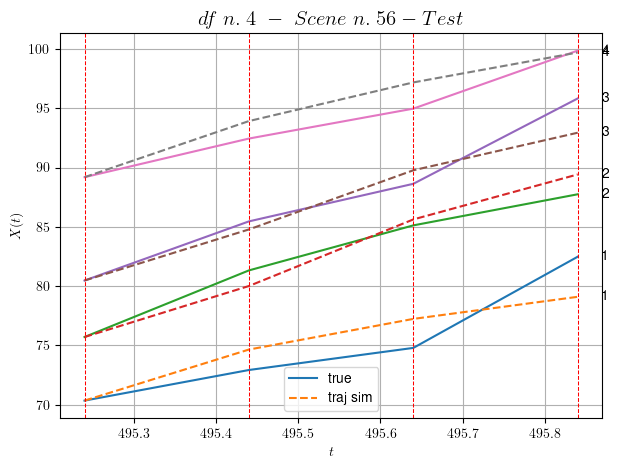

        For scene 56/63:
        * MSE = 2.6499523683743416
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.57/63


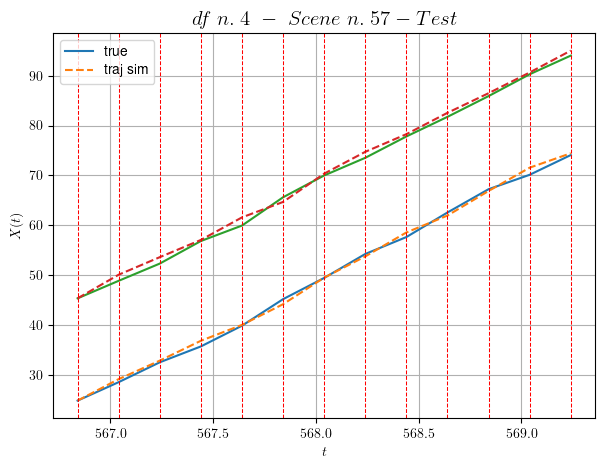

        For scene 57/63:
        * MSE = 0.661439980331817
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.58/63


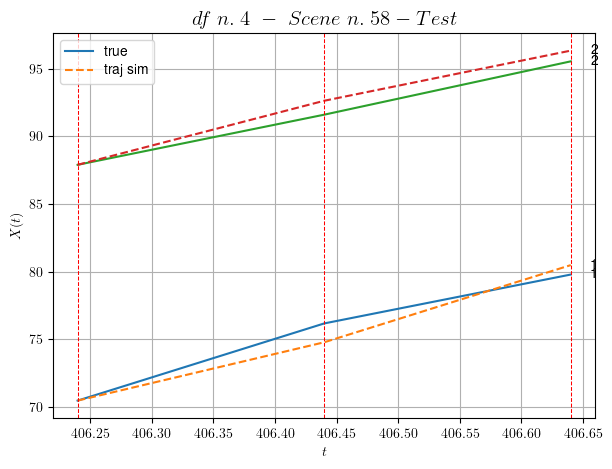

        For scene 58/63:
        * MSE = 0.6857900995031182
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.59/63


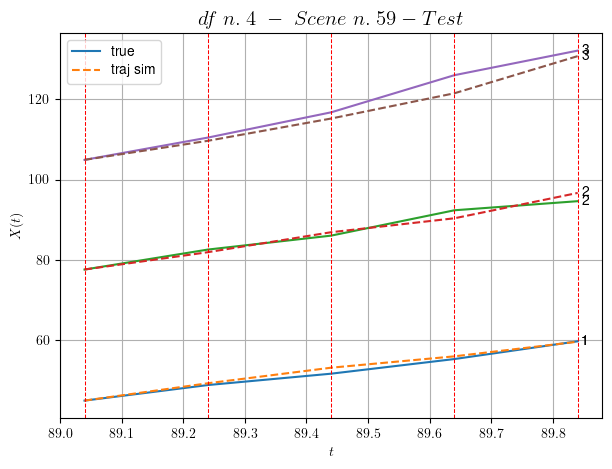

        For scene 59/63:
        * MSE = 2.4863614773039306
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.60/63


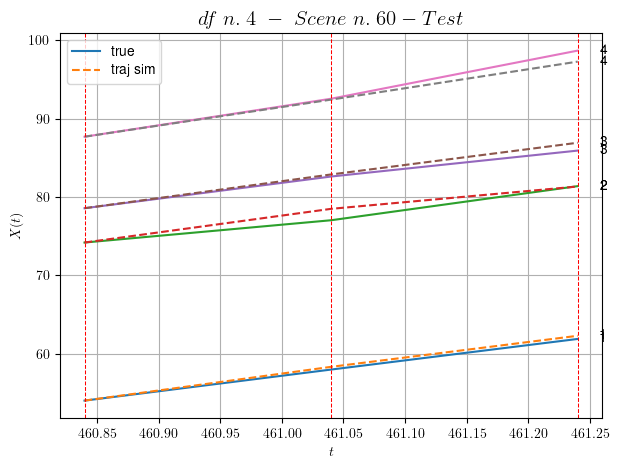

        For scene 60/63:
        * MSE = 0.4551682387677479
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.61/63


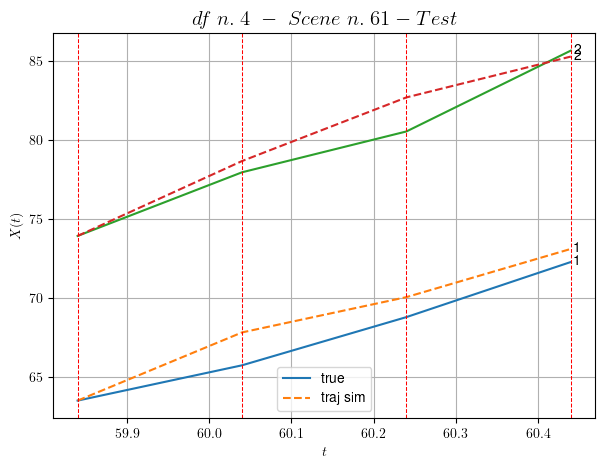

        For scene 61/63:
        * MSE = 1.4859923413872278
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.62/63


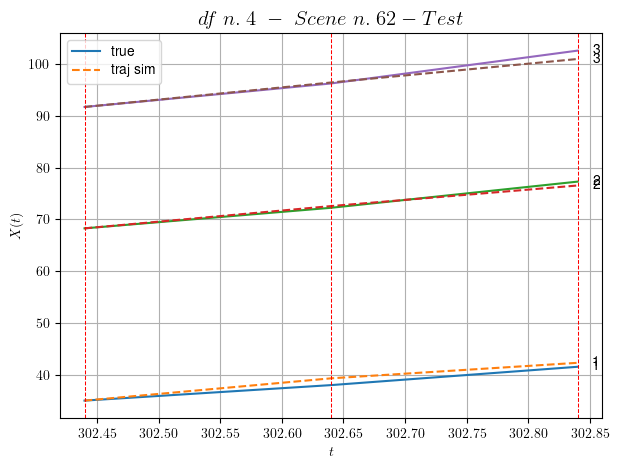

        For scene 62/63:
        * MSE = 0.6255289480784519
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.63/63


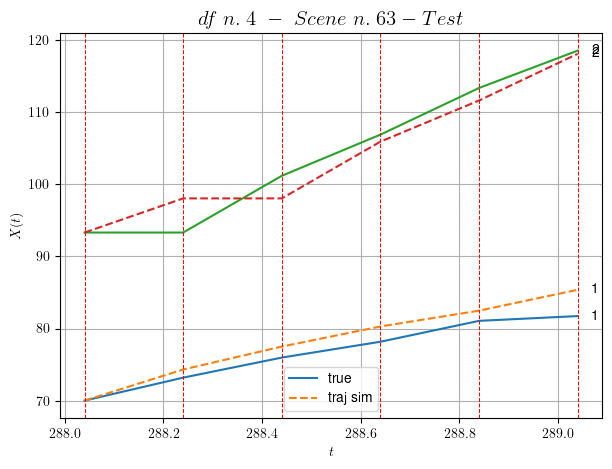

        For scene 63/63:
        * MSE = 4.984344664813119
----------------------------------------------------------------------------------------------------


MSE test: 1.839075134963769

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.7650255912823336
          * MSE test: 1.839075134963769
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 5/10 dfs.
In DataFrame n.5 we have 66 scenes.
    To train the model we use 6 scenes, the remaining 60 to test the model.

Training step. (6 scenes)
DataFrame n.5. Scene n.1/6
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [226.72,227.92]


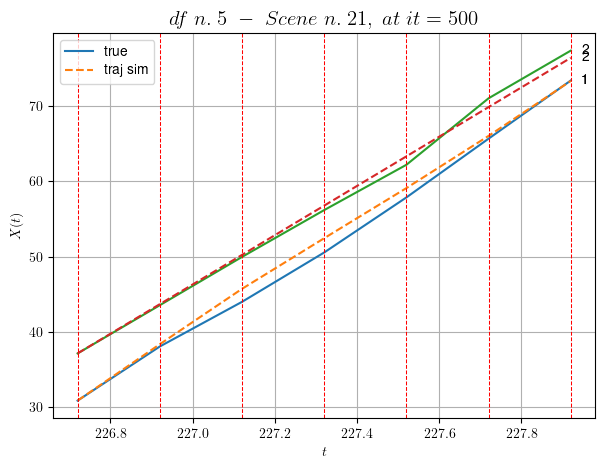

----------------------------------------------------------------------------------------------------
        For scene 1/6:
        * After LR finder: LR_NN=0.01 with mse=2.7230168695298267 at it=24
        * v0 = 32.69366457961361
        * MSE = 0.5305012161564042
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/6
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [330.12,330.52]


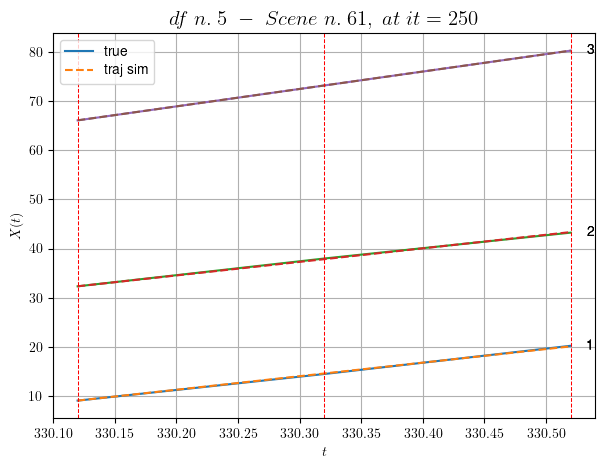

----------------------------------------------------------------------------------------------------
        For scene 2/6:
        * After LR finder: LR_NN=0.001 with mse=0.6735279350502908 at it=24
        * v0 = 35.477501601632675
        * MSE = 0.006571414379513251
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [78.72,79.32]


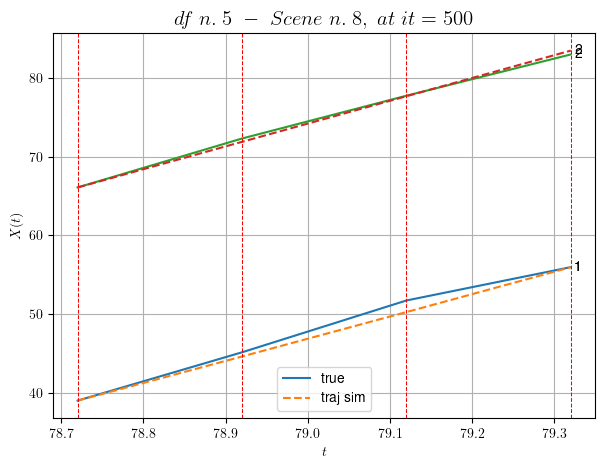

----------------------------------------------------------------------------------------------------
        For scene 3/6:
        * After LR finder: LR_NN=0.001 with mse=0.7277740935963053 at it=24
        * v0 = 28.9654072956113
        * MSE = 0.3571705583737654
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/6
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [449.12,450.12]


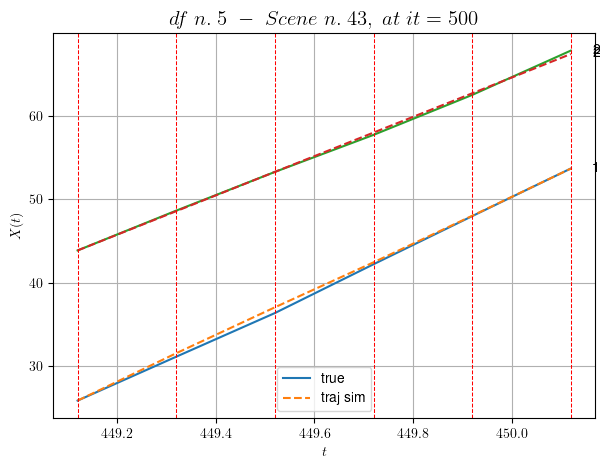

----------------------------------------------------------------------------------------------------
        For scene 4/6:
        * After LR finder: LR_NN=0.01 with mse=7.629276680440633 at it=24
        * v0 = 23.527604275732603
        * MSE = 0.061773028436603546
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/6
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [149.92,150.72]


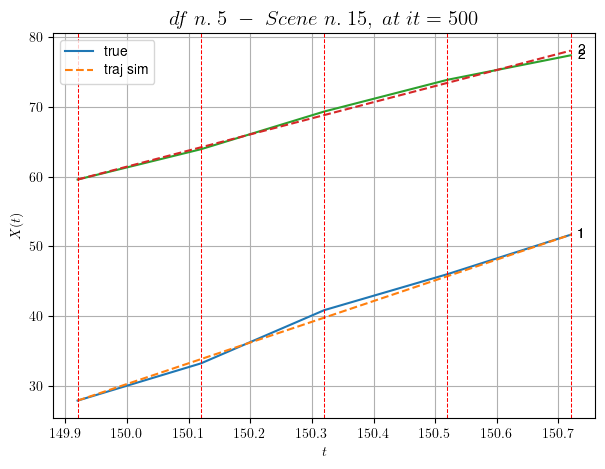

----------------------------------------------------------------------------------------------------
        For scene 5/6:
        * After LR finder: LR_NN=5e-05 with mse=6.157582299398476 at it=24
        * v0 = 23.102993584361716
        * MSE = 0.25897878338541264
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/6
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [535.32,535.92]


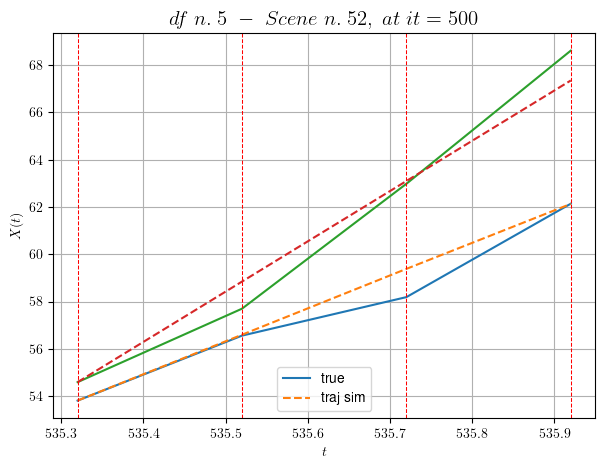

----------------------------------------------------------------------------------------------------
        For scene 6/6:
        * After LR finder: LR_NN=0.001 with mse=4.718792406961681 at it=24
        * v0 = 21.278077520483933
        * MSE = 0.49778123167273136
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.2854627054007384
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (60 scenes)
DataFrame n.5. Scene n.1/60


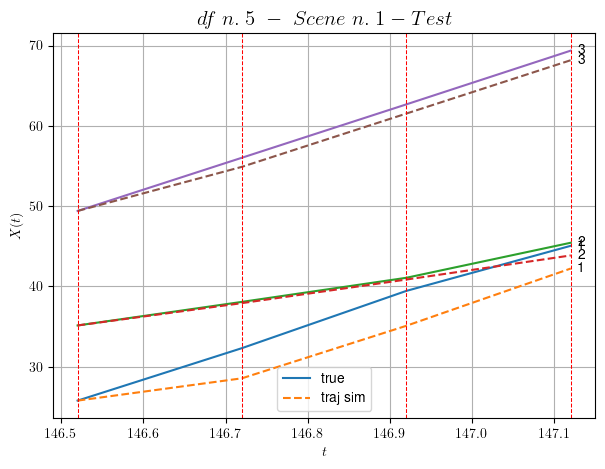

        For scene 1/60:
        * MSE = 3.969482591489428
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/60


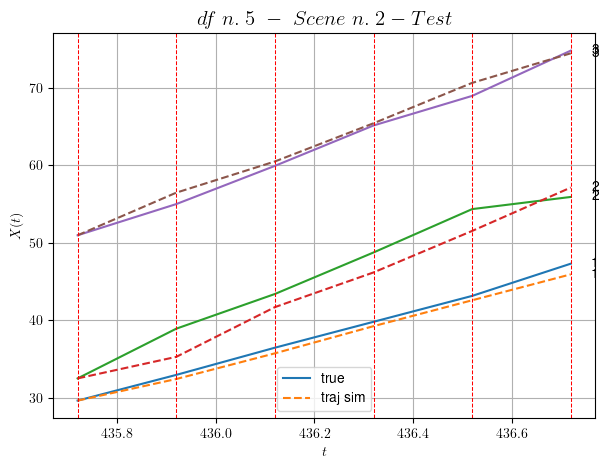

        For scene 2/60:
        * MSE = 2.278818476931218
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/60


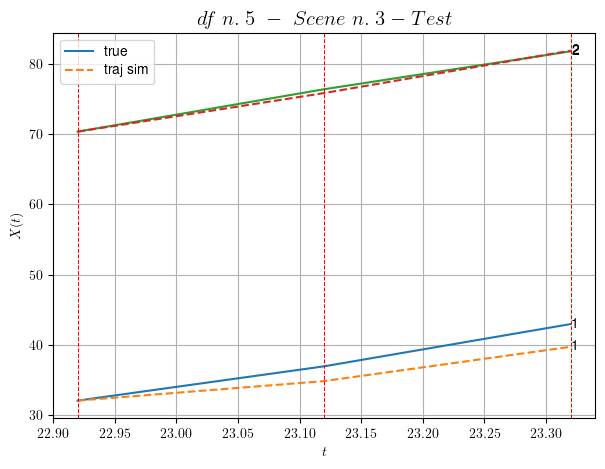

        For scene 3/60:
        * MSE = 2.5403852833783707
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/60


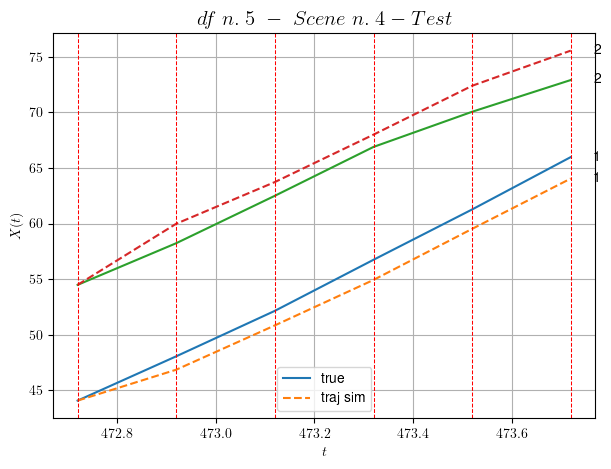

        For scene 4/60:
        * MSE = 2.627151237814357
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/60


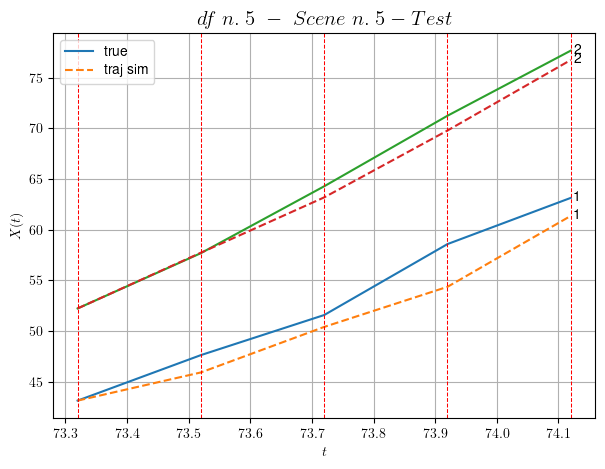

        For scene 5/60:
        * MSE = 2.942016356187505
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/60


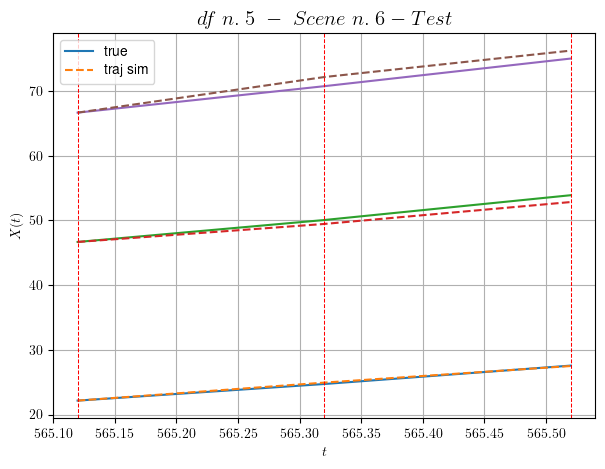

        For scene 6/60:
        * MSE = 0.5595577966237942
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/60


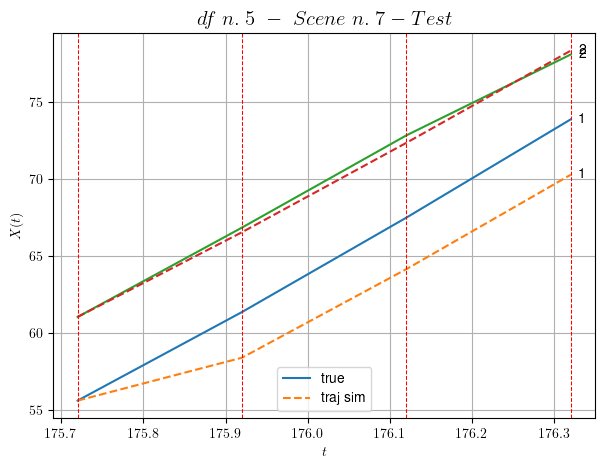

        For scene 7/60:
        * MSE = 4.160448588627202
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/60


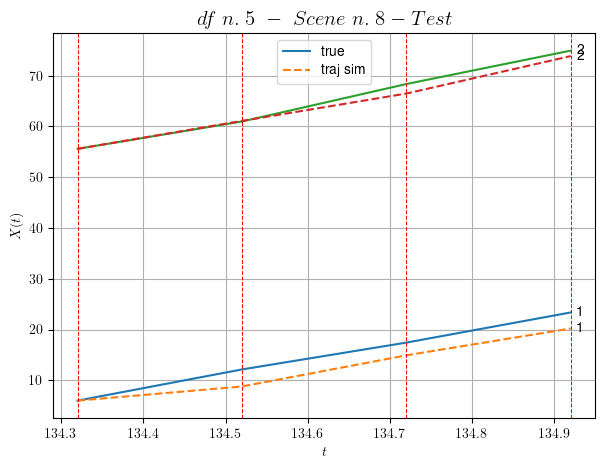

        For scene 8/60:
        * MSE = 4.018714390095101
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/60


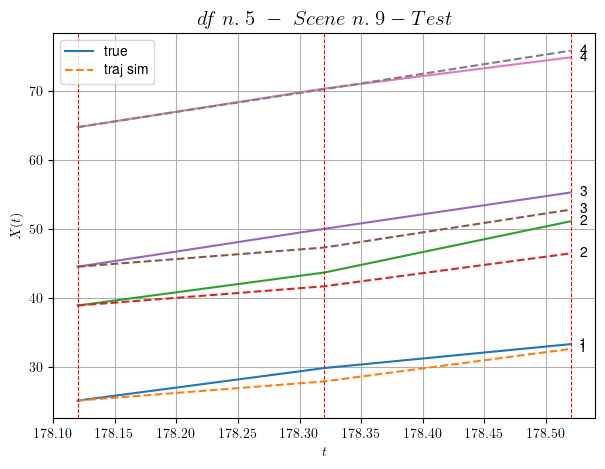

        For scene 9/60:
        * MSE = 3.6913311302247553
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/60


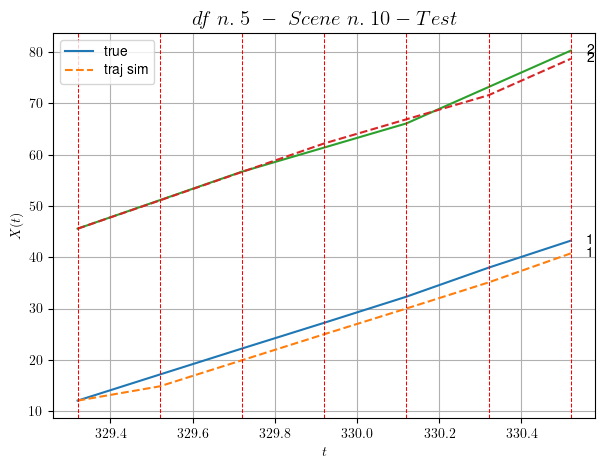

        For scene 10/60:
        * MSE = 2.970357710173521
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/60


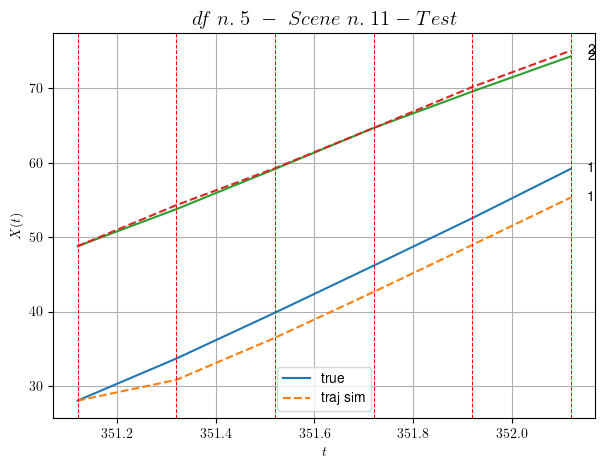

        For scene 11/60:
        * MSE = 5.091413699724336
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/60


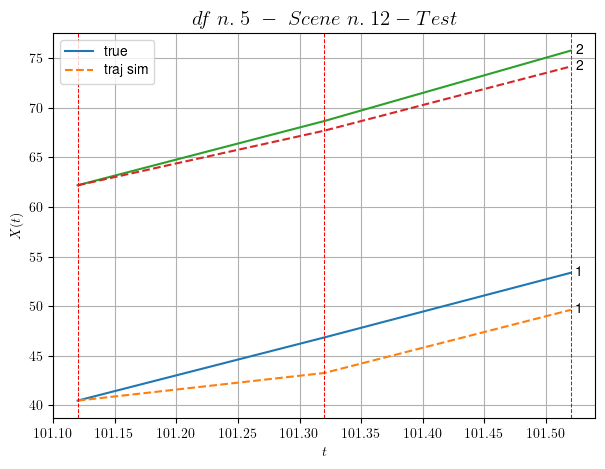

        For scene 12/60:
        * MSE = 5.0480426337652755
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/60


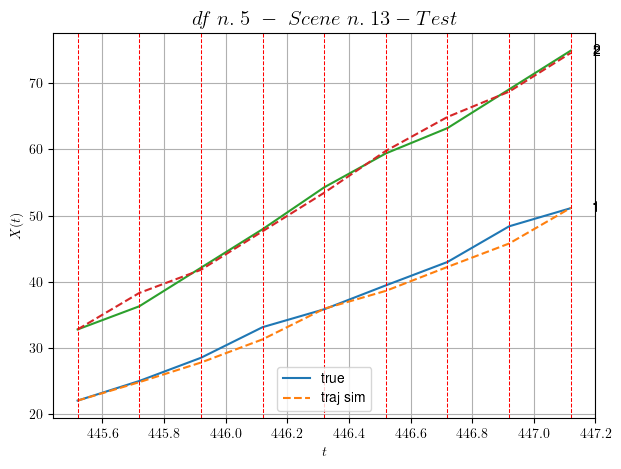

        For scene 13/60:
        * MSE = 1.1131274289727353
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/60


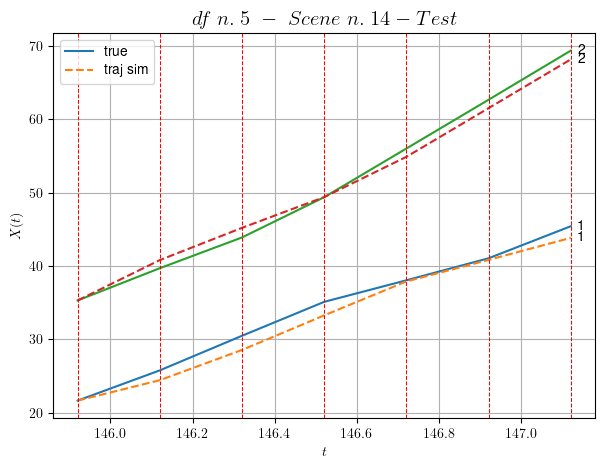

        For scene 14/60:
        * MSE = 1.317895429794117
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/60


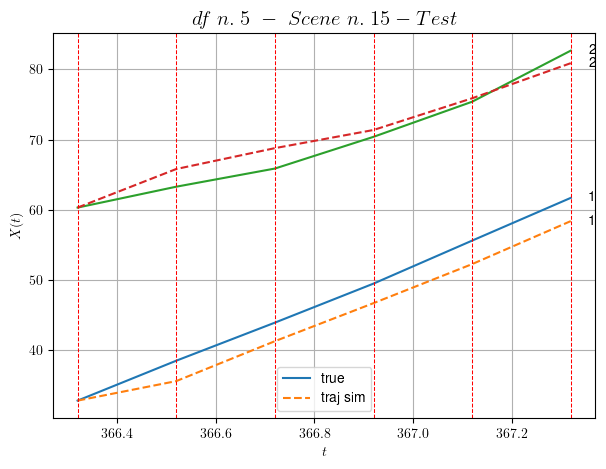

        For scene 15/60:
        * MSE = 5.392640516306025
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/60


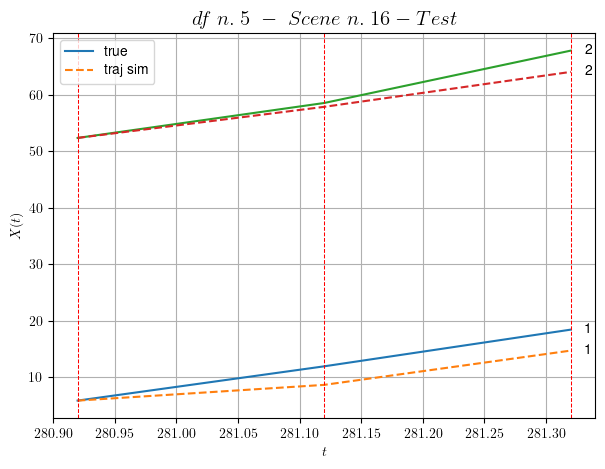

        For scene 16/60:
        * MSE = 6.524492719428617
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/60


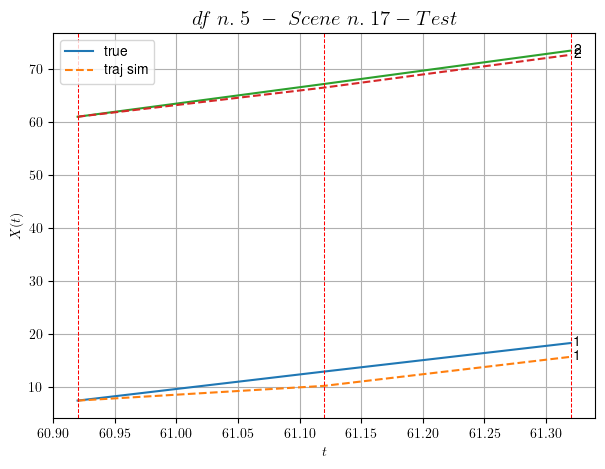

        For scene 17/60:
        * MSE = 2.522750662940907
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/60


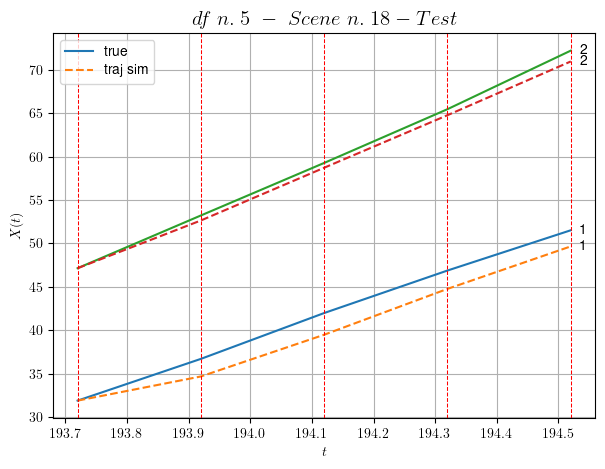

        For scene 18/60:
        * MSE = 2.097241624965651
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/60


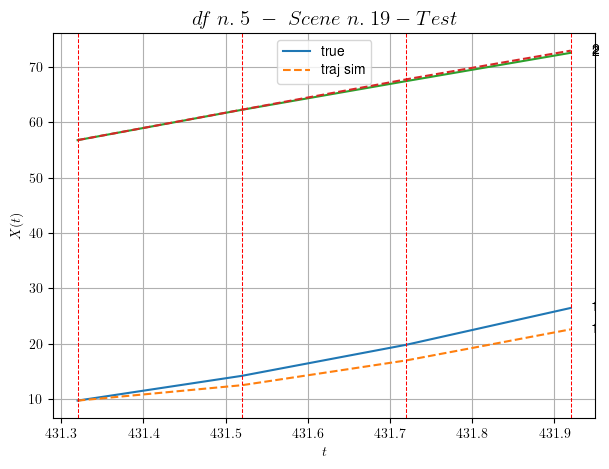

        For scene 19/60:
        * MSE = 3.2530765637249632
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/60


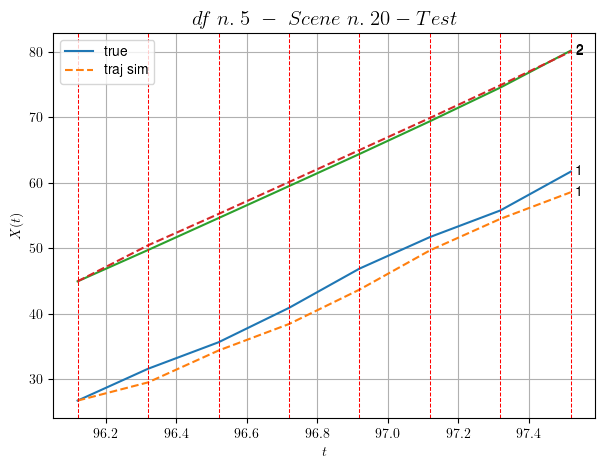

        For scene 20/60:
        * MSE = 2.5020218017038225
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/60


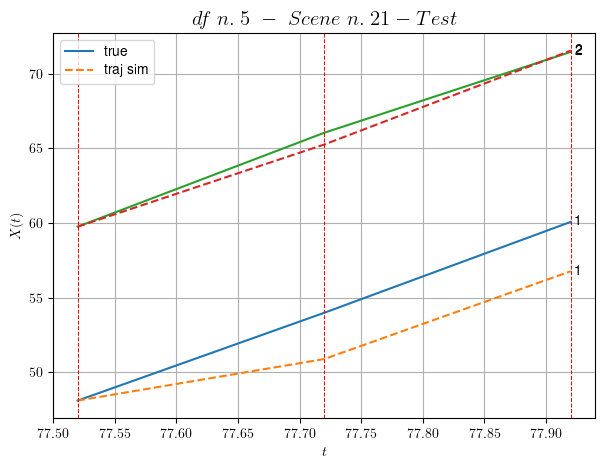

        For scene 21/60:
        * MSE = 3.5224745971587073
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/60


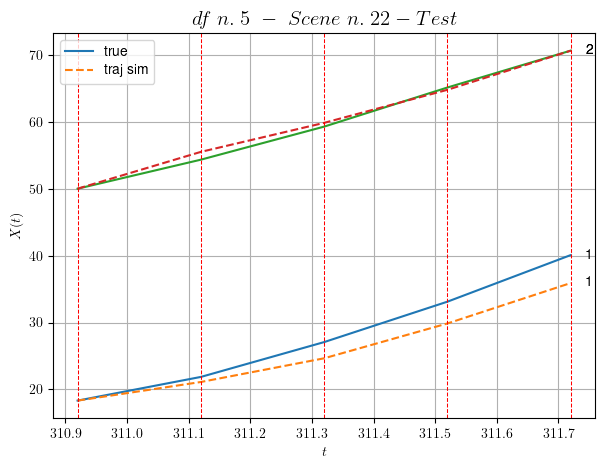

        For scene 22/60:
        * MSE = 3.6282777980434733
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.23/60


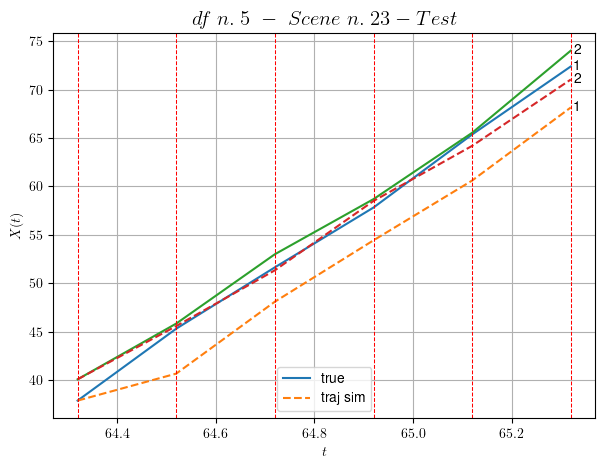

        For scene 23/60:
        * MSE = 8.312743414230564
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.24/60


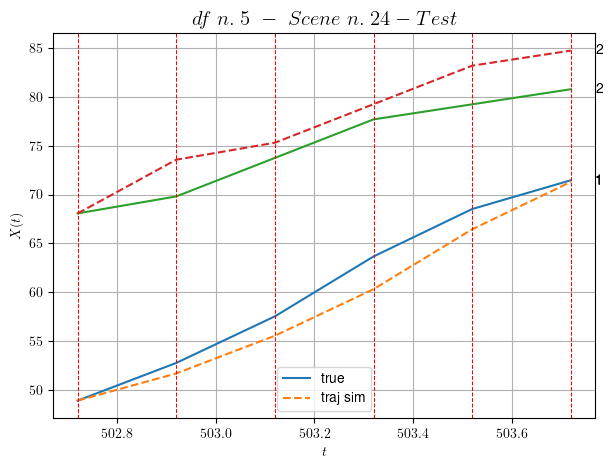

        For scene 24/60:
        * MSE = 5.914715584162697
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.25/60


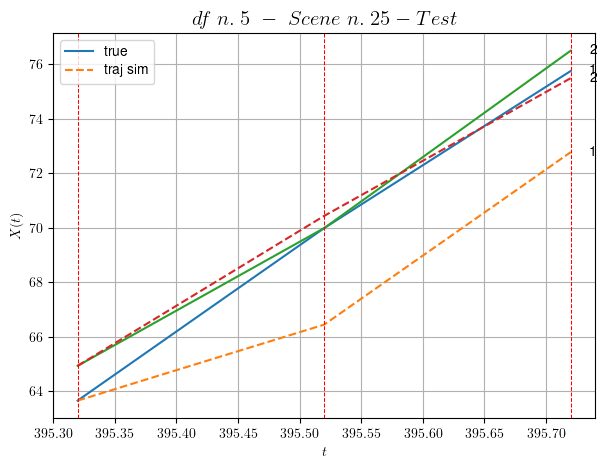

        For scene 25/60:
        * MSE = 3.7704903362849813
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.26/60


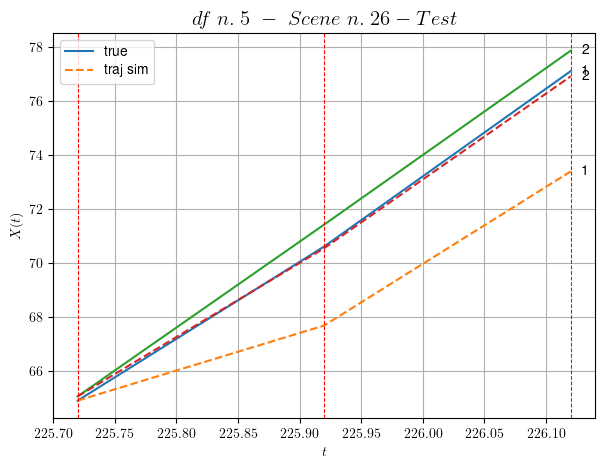

        For scene 26/60:
        * MSE = 4.022136071572558
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.27/60


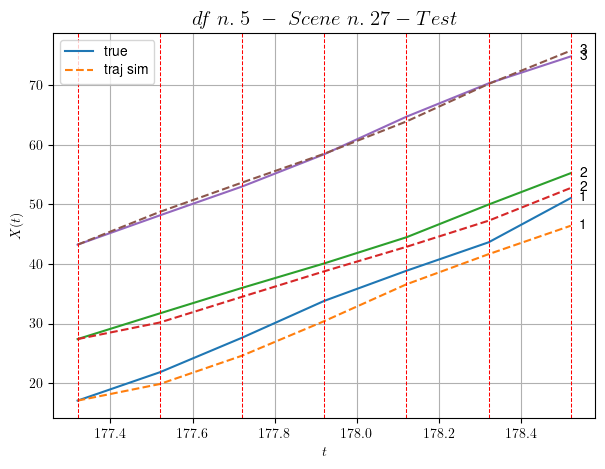

        For scene 27/60:
        * MSE = 3.816336519444047
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.28/60


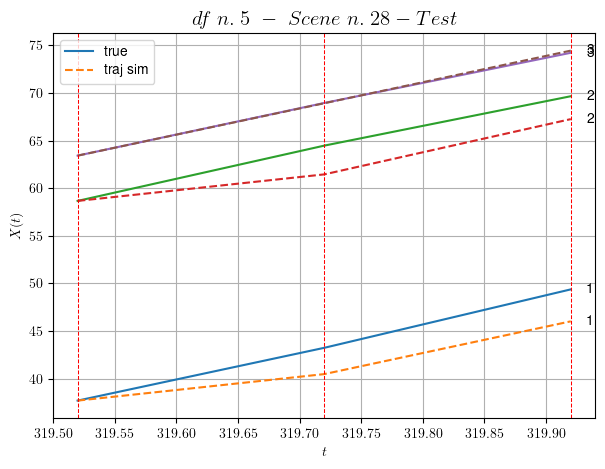

        For scene 28/60:
        * MSE = 3.760546206256404
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.29/60


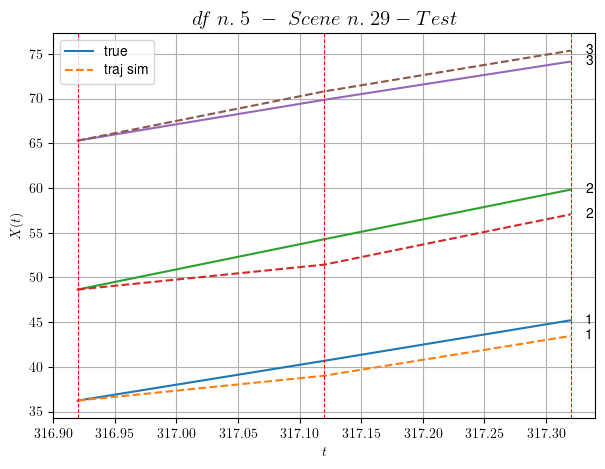

        For scene 29/60:
        * MSE = 2.6599348527968982
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.30/60


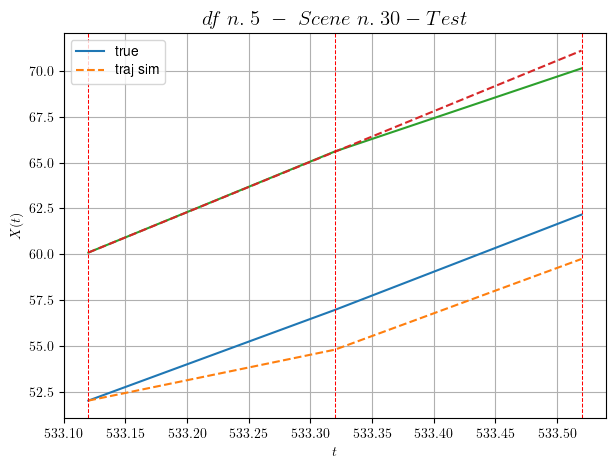

        For scene 30/60:
        * MSE = 1.9160736808463843
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.31/60


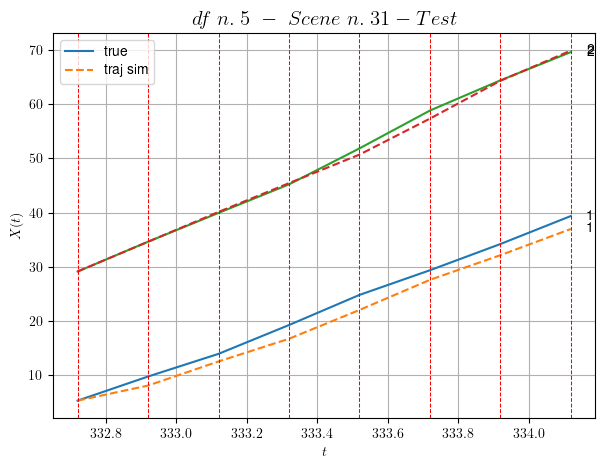

        For scene 31/60:
        * MSE = 2.2377390476684575
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.32/60


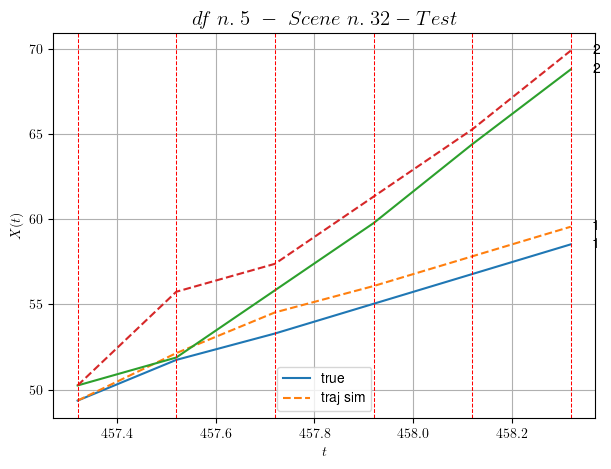

        For scene 32/60:
        * MSE = 2.221588152339106
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.33/60


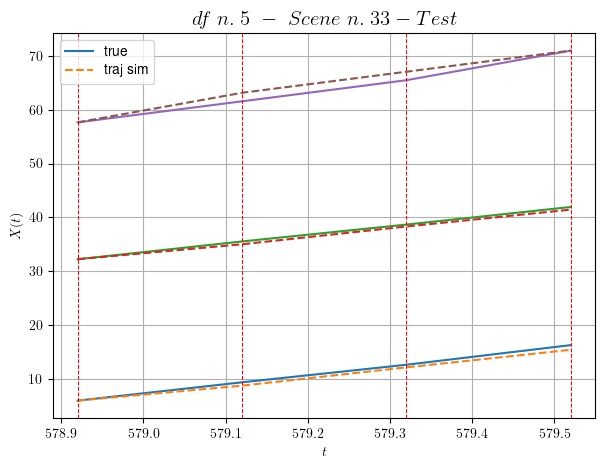

        For scene 33/60:
        * MSE = 0.5832581315092543
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.34/60


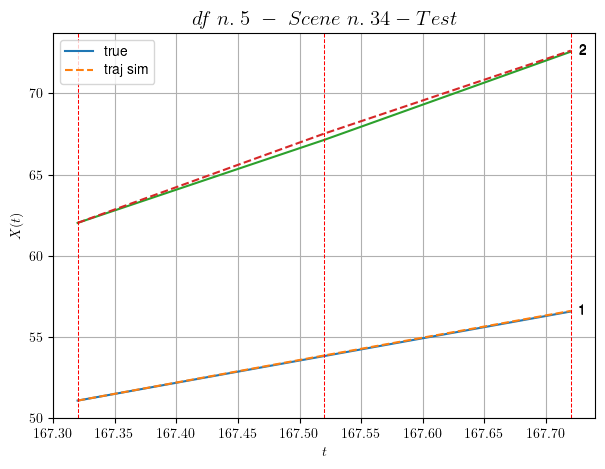

        For scene 34/60:
        * MSE = 0.02616612595338981
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.35/60


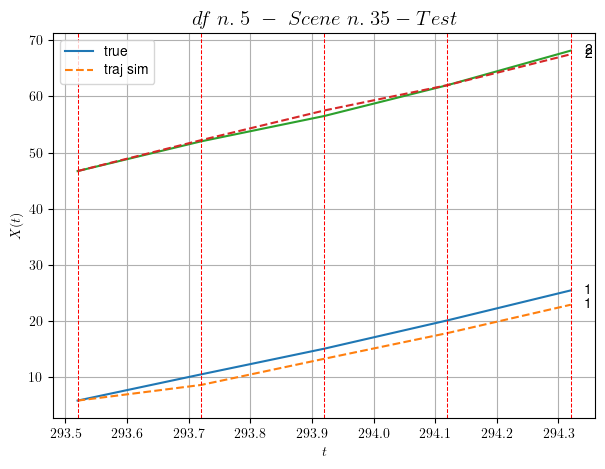

        For scene 35/60:
        * MSE = 1.9856753118632327
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.36/60


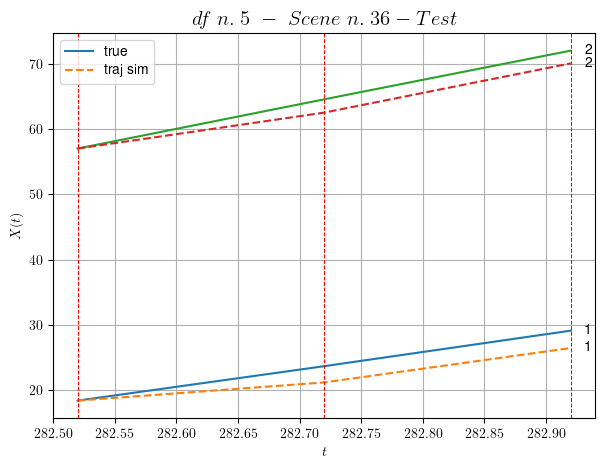

        For scene 36/60:
        * MSE = 3.527304916355101
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.37/60


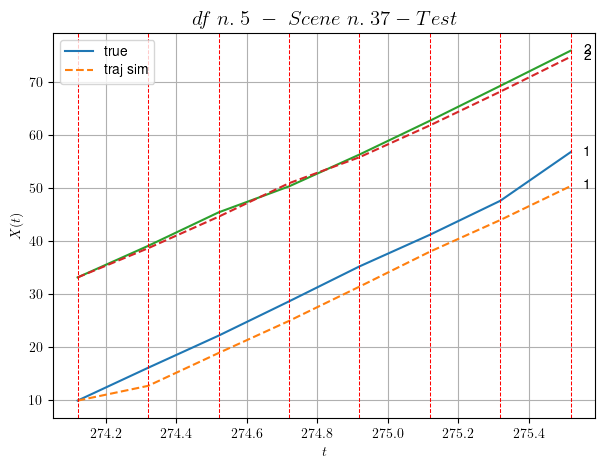

        For scene 37/60:
        * MSE = 7.479768064404152
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.38/60


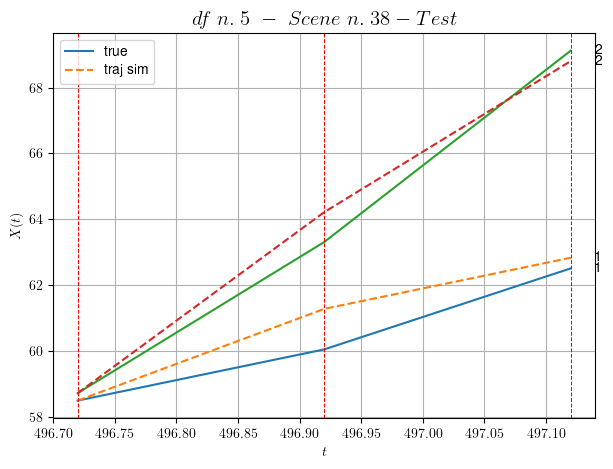

        For scene 38/60:
        * MSE = 0.4244655464426028
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.39/60


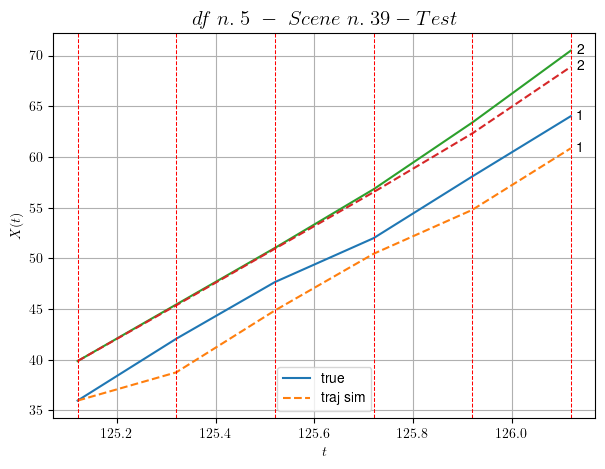

        For scene 39/60:
        * MSE = 3.823216259915281
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.40/60


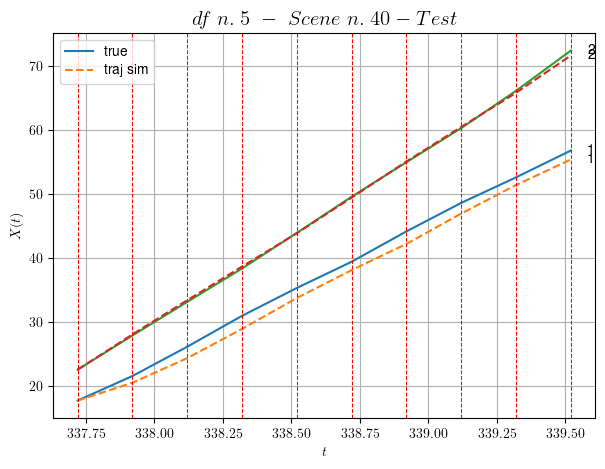

        For scene 40/60:
        * MSE = 1.1734775648255127
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.41/60


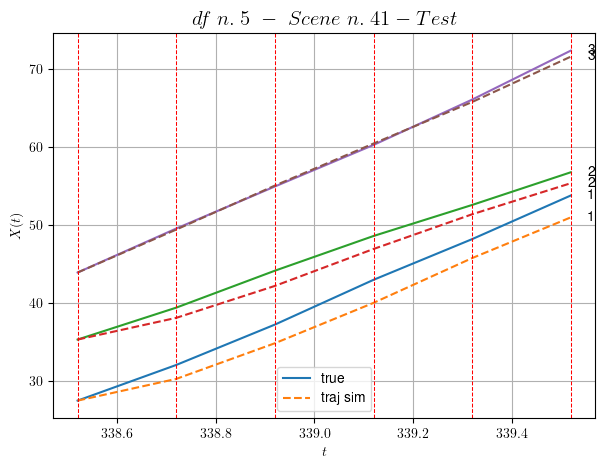

        For scene 41/60:
        * MSE = 2.4317994154350466
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.42/60


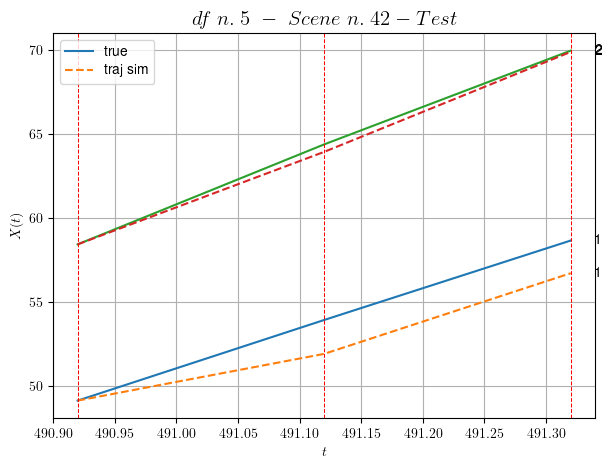

        For scene 42/60:
        * MSE = 1.3402863499533644
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.43/60


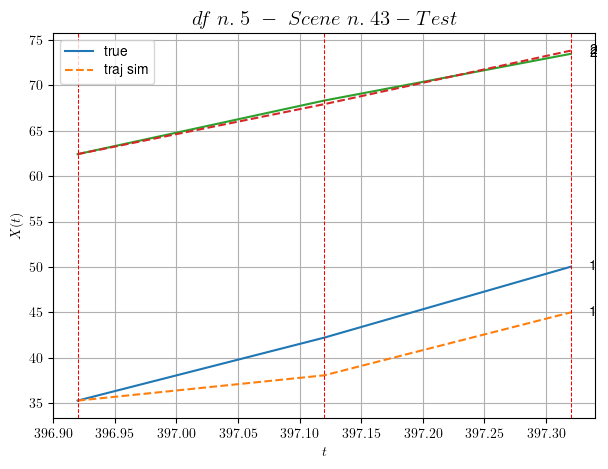

        For scene 43/60:
        * MSE = 7.131130852710693
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.44/60


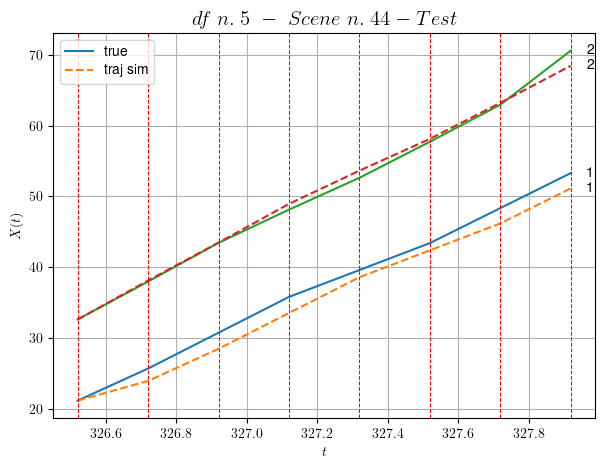

        For scene 44/60:
        * MSE = 1.9565895536208875
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.45/60


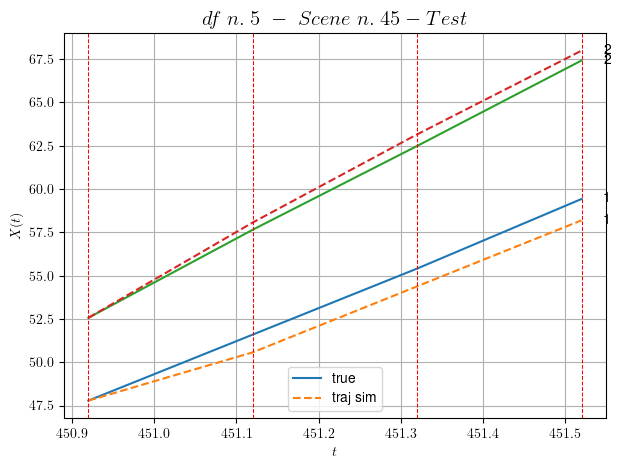

        For scene 45/60:
        * MSE = 0.5709394493299528
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.46/60


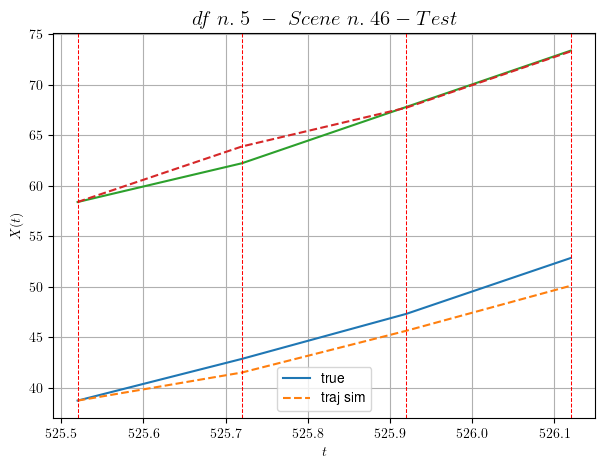

        For scene 46/60:
        * MSE = 1.8682210014369882
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.47/60


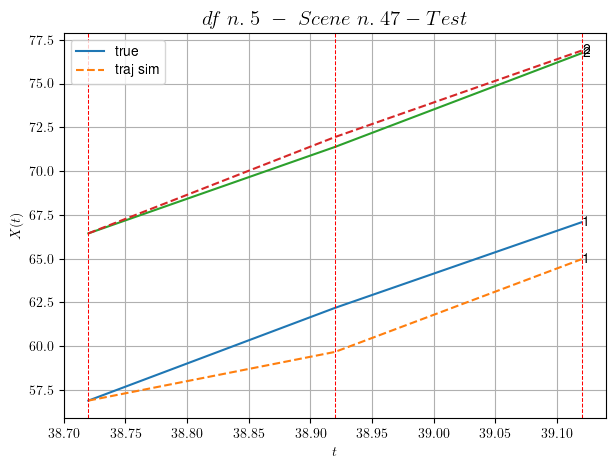

        For scene 47/60:
        * MSE = 1.8531793300837571
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.48/60


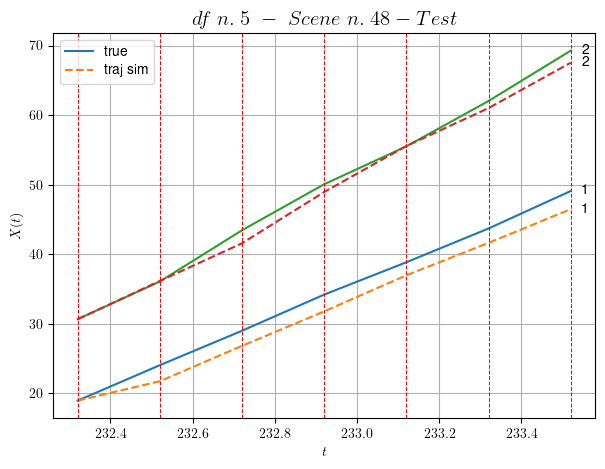

        For scene 48/60:
        * MSE = 2.80119978447025
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.49/60


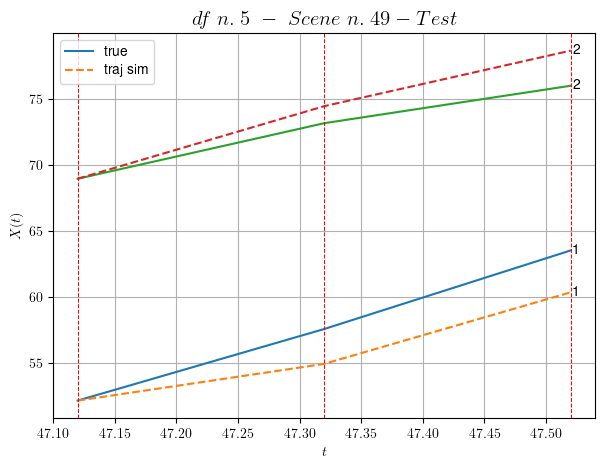

        For scene 49/60:
        * MSE = 4.300010097219689
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.50/60


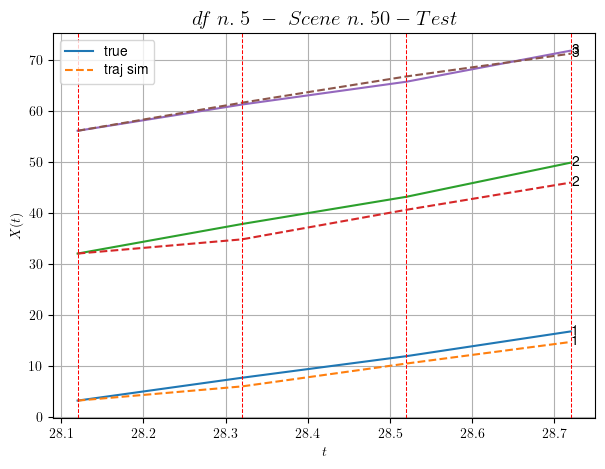

        For scene 50/60:
        * MSE = 3.463123398187795
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.51/60


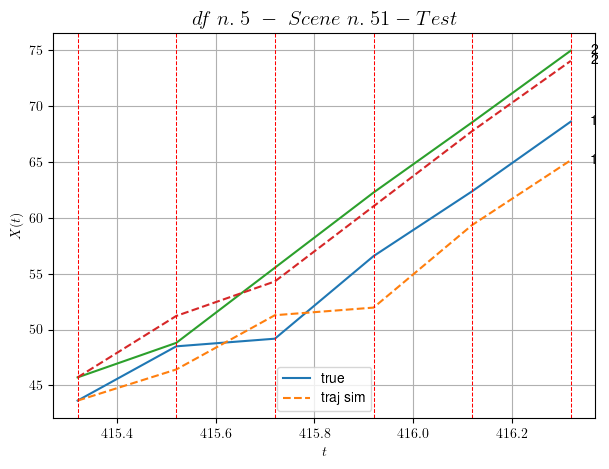

        For scene 51/60:
        * MSE = 5.113508147412967
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.52/60


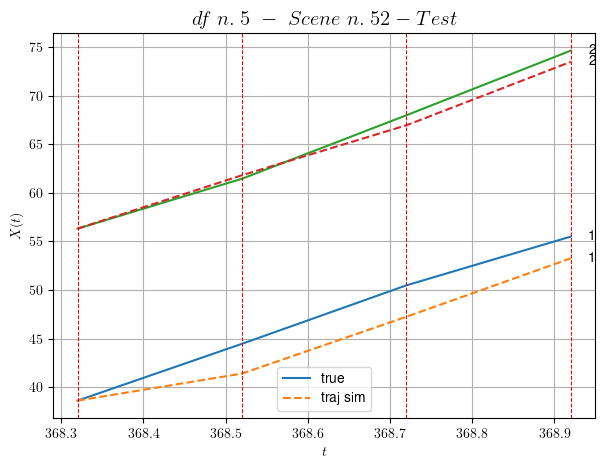

        For scene 52/60:
        * MSE = 3.4273258164821834
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.53/60


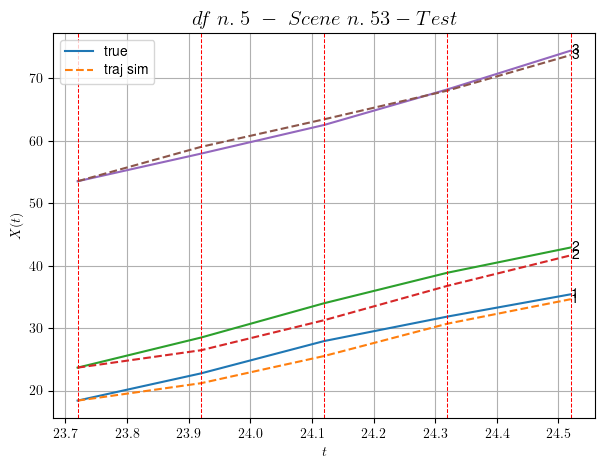

        For scene 53/60:
        * MSE = 2.0121501636215537
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.54/60


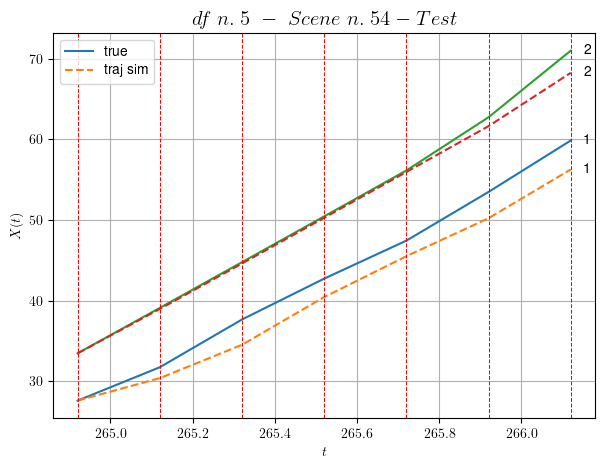

        For scene 54/60:
        * MSE = 3.7855991469032872
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.55/60


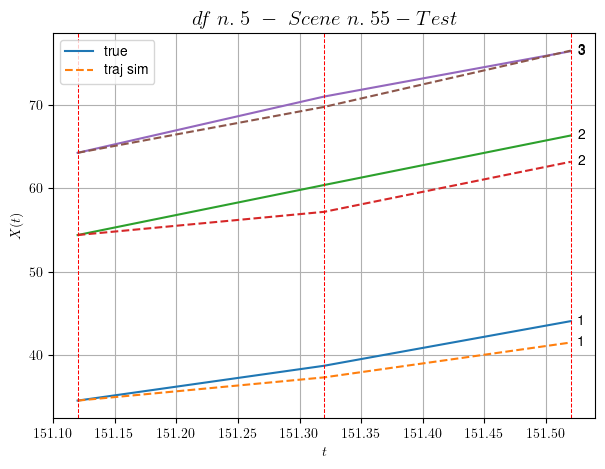

        For scene 55/60:
        * MSE = 3.3644099204834794
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.56/60


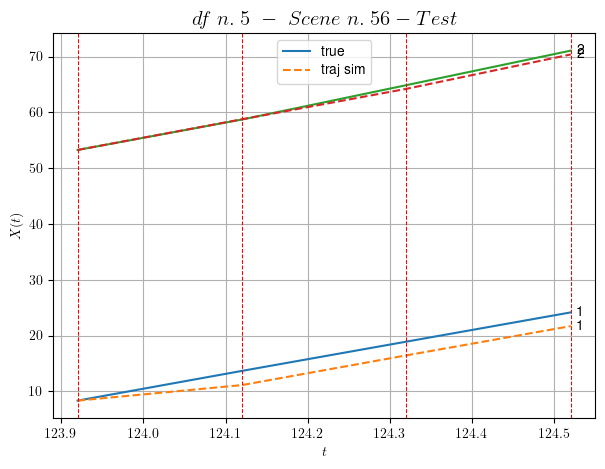

        For scene 56/60:
        * MSE = 2.434523809563924
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.57/60


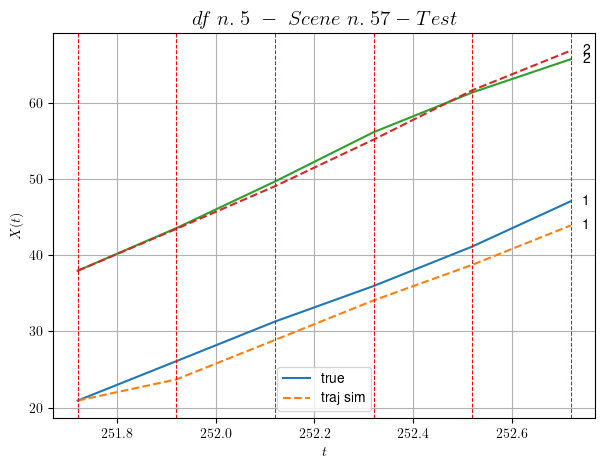

        For scene 57/60:
        * MSE = 2.8039031039524356
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.58/60


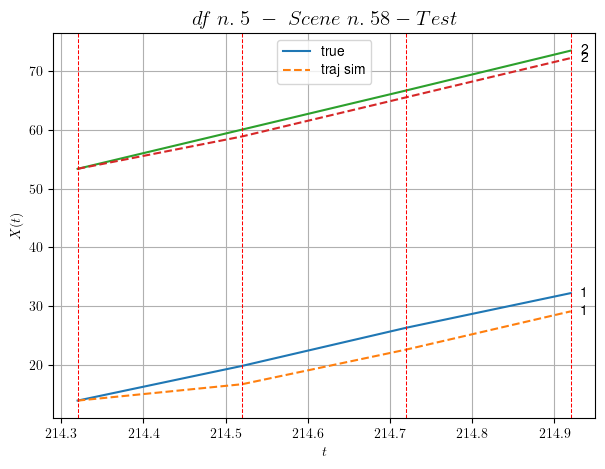

        For scene 58/60:
        * MSE = 4.674633362656137
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.59/60


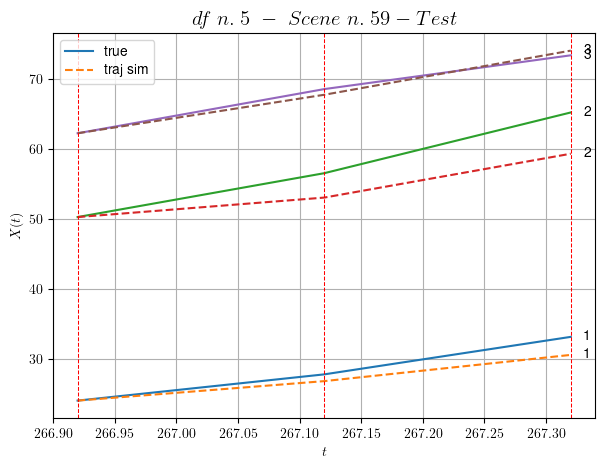

        For scene 59/60:
        * MSE = 6.179295486728769
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.60/60


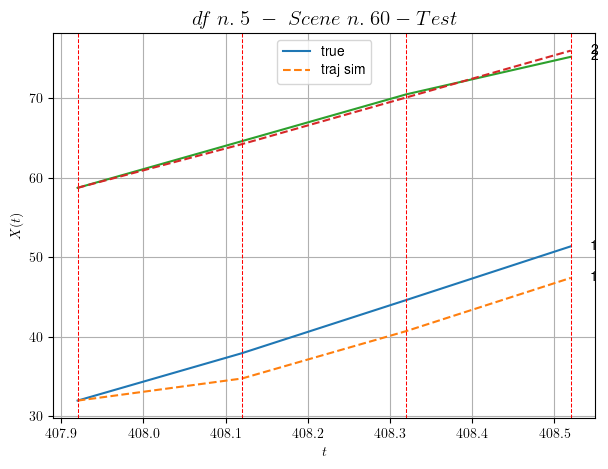

        For scene 60/60:
        * MSE = 5.267018193157584
----------------------------------------------------------------------------------------------------


MSE test: 3.270103353472587

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.2854627054007384
          * MSE test: 3.270103353472587
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 6/10 dfs.
In DataFrame n.6 we have 52 scenes.
    To train the model we use 5 scenes, the remaining 47 to test the model.

Training step. (5 scenes)
DataFrame n.6. Scene n.1/5
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.60,87.40]


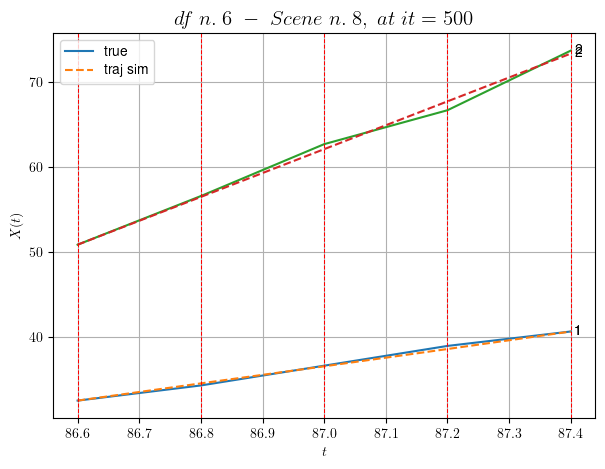

----------------------------------------------------------------------------------------------------
        For scene 1/5:
        * After LR finder: LR_NN=0.005 with mse=0.6190925538269941 at it=24
        * v0 = 28.176915163685493
        * MSE = 0.17723037785292448
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/5
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [493.80,494.40]


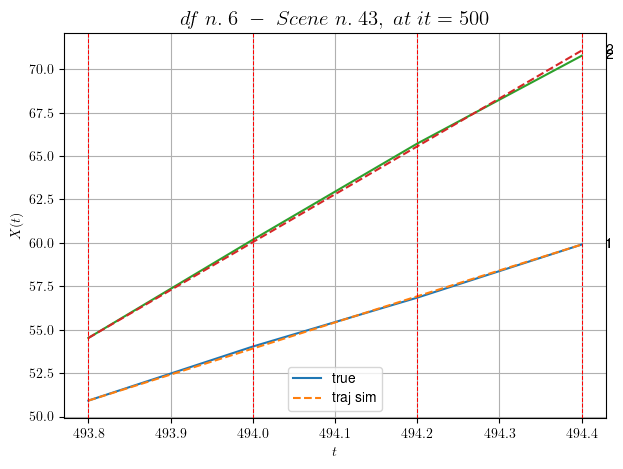

----------------------------------------------------------------------------------------------------
        For scene 2/5:
        * After LR finder: LR_NN=0.005 with mse=0.48436963344952705 at it=24
        * v0 = 27.57702754451529
        * MSE = 0.019325717518928368
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/5
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [162.20,163.60]


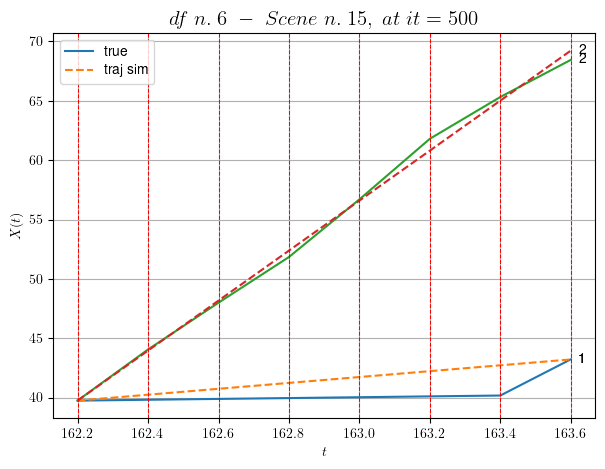

----------------------------------------------------------------------------------------------------
        For scene 3/5:
        * After LR finder: LR_NN=0.001 with mse=28.516897797448546 at it=24
        * v0 = 21.059787487615633
        * MSE = 1.1513796797856588
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/5
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [368.20,369.20]


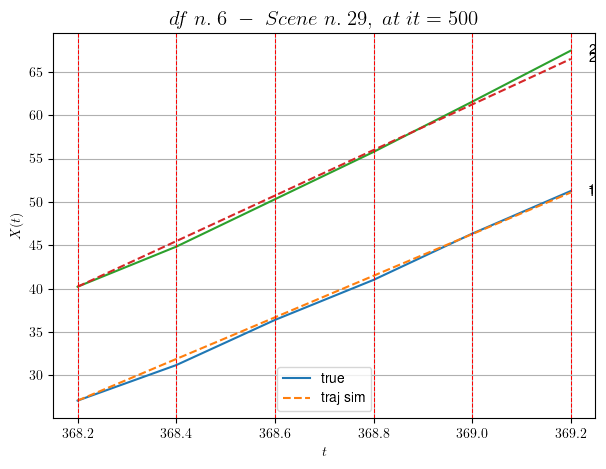

----------------------------------------------------------------------------------------------------
        For scene 4/5:
        * After LR finder: LR_NN=5e-05 with mse=2.225375384458072 at it=24
        * v0 = 26.26965461417286
        * MSE = 0.20487302442956212
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/5
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [465.20,466.40]


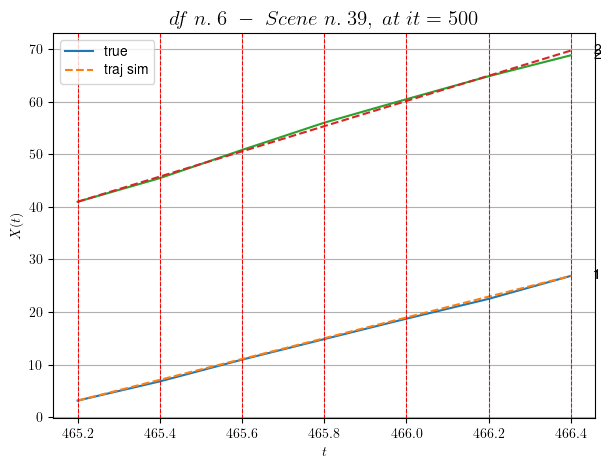

----------------------------------------------------------------------------------------------------
        For scene 5/5:
        * After LR finder: LR_NN=5e-05 with mse=9.993756879842582 at it=24
        * v0 = 23.956962458801478
        * MSE = 0.13397036249920372
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.3373558324172555
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (47 scenes)
DataFrame n.6. Scene n.1/47


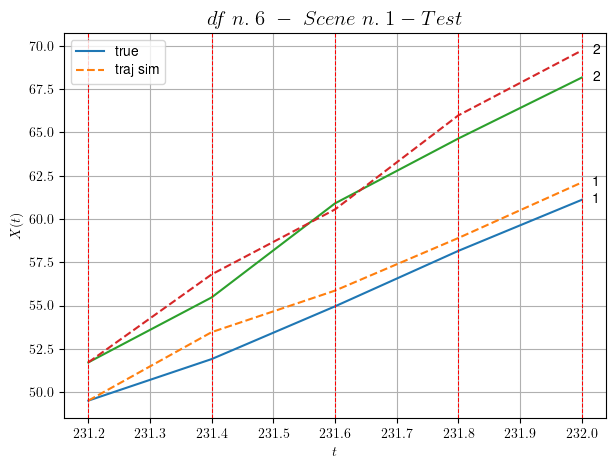

        For scene 1/47:
        * MSE = 1.091939259221029
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/47


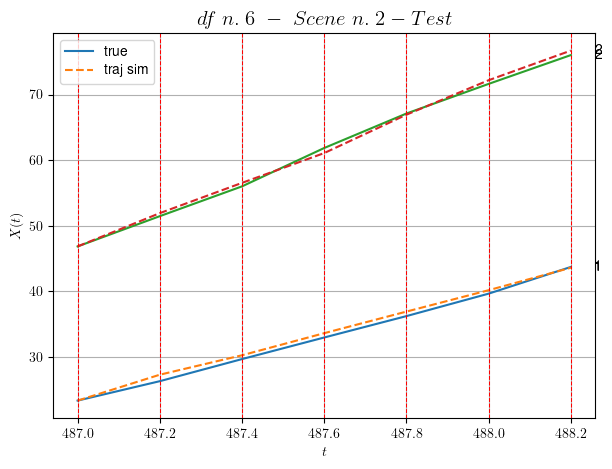

        For scene 2/47:
        * MSE = 0.3161975078132916
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/47


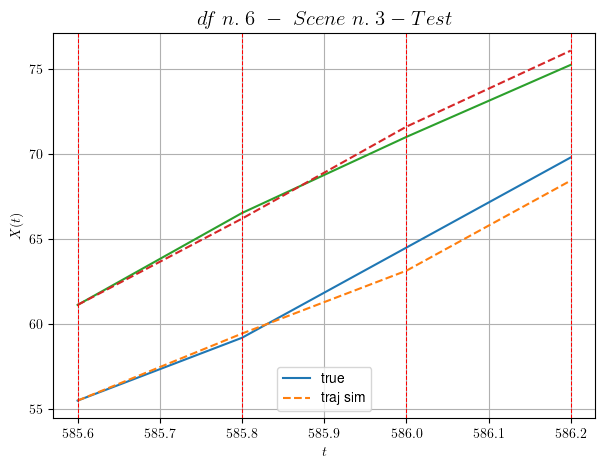

        For scene 3/47:
        * MSE = 0.6180902458009492
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/47


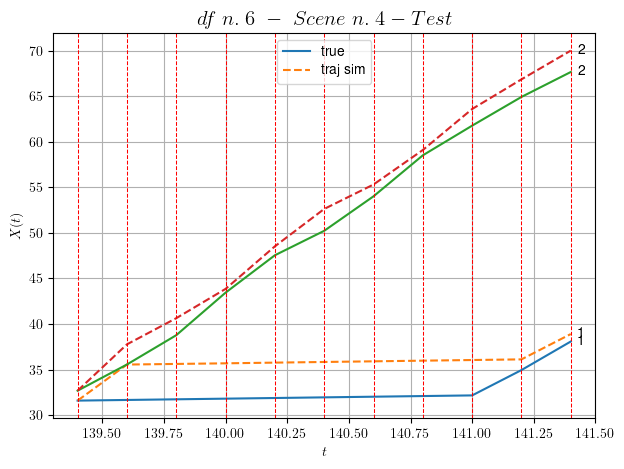

        For scene 4/47:
        * MSE = 6.9291281379369565
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/47


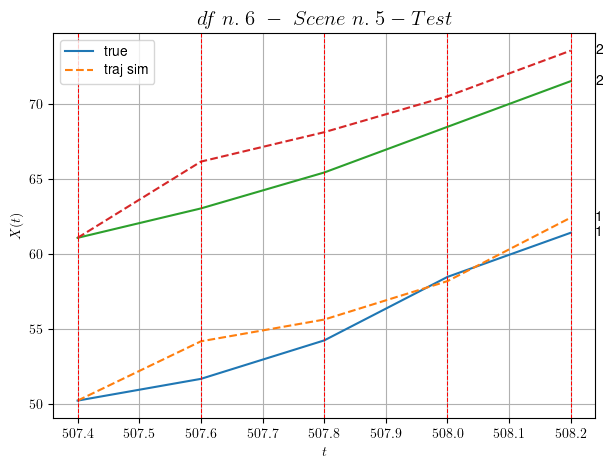

        For scene 5/47:
        * MSE = 3.453574294958319
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/47


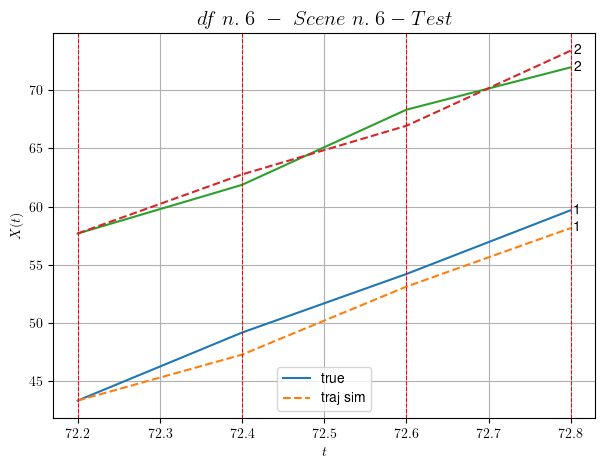

        For scene 6/47:
        * MSE = 1.489003036481654
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/47


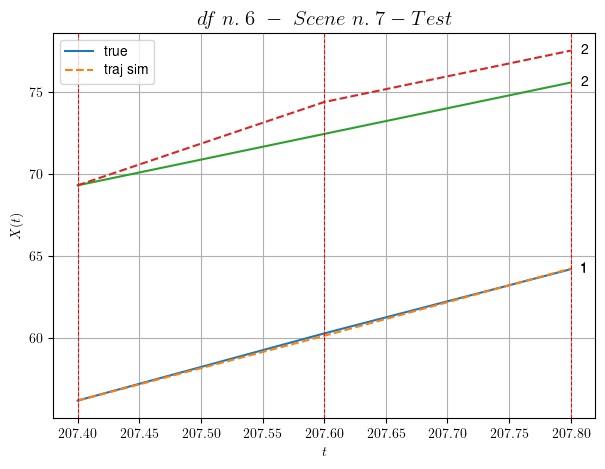

        For scene 7/47:
        * MSE = 1.2664252397524
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/47


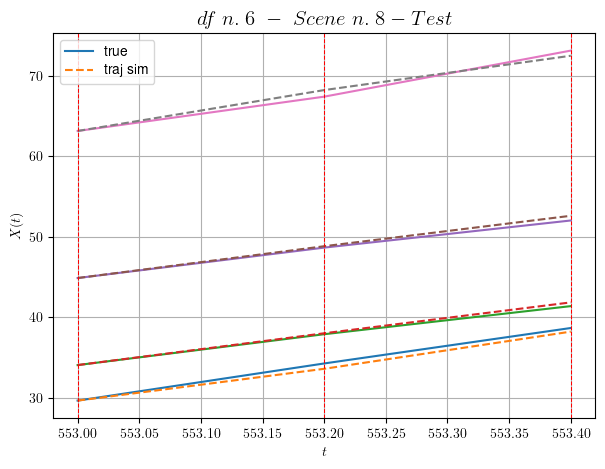

        For scene 8/47:
        * MSE = 0.19332381633919488
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/47


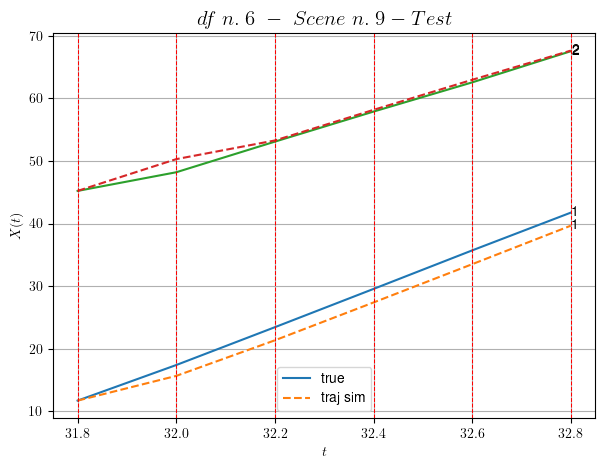

        For scene 9/47:
        * MSE = 2.1677793736098474
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/47


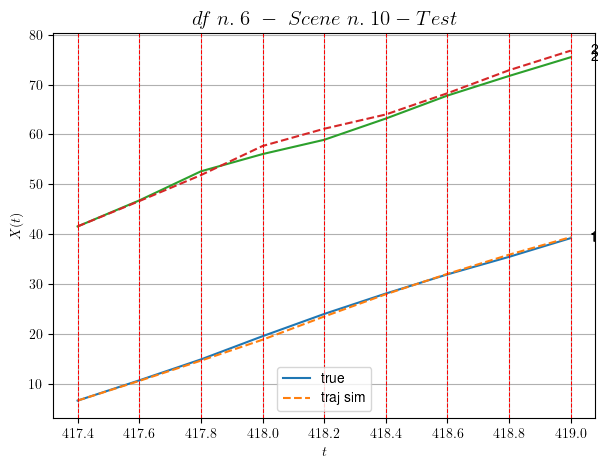

        For scene 10/47:
        * MSE = 0.7320103186672288
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/47


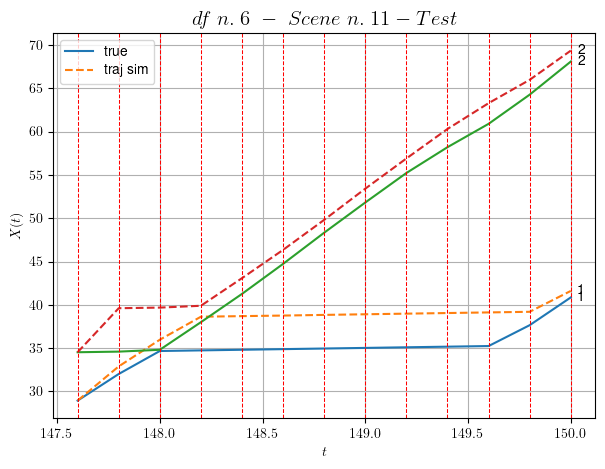

        For scene 11/47:
        * MSE = 7.941262399512005
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/47


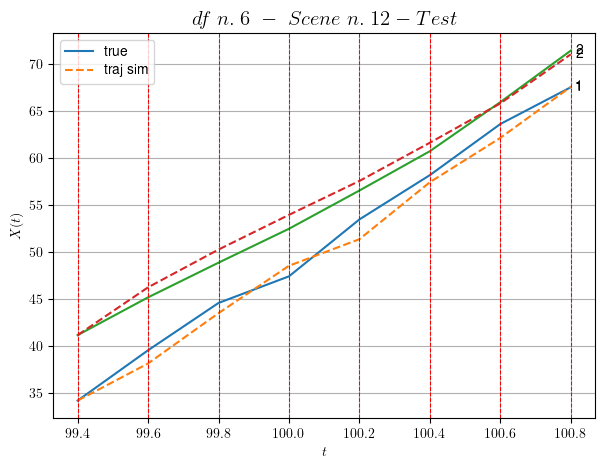

        For scene 12/47:
        * MSE = 1.1772233690121088
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/47


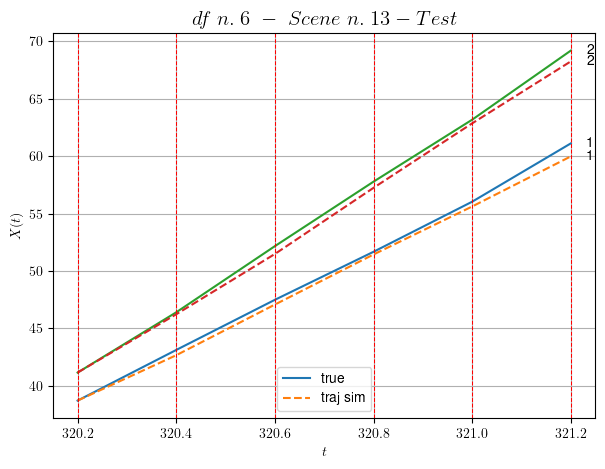

        For scene 13/47:
        * MSE = 0.30509097564747256
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/47


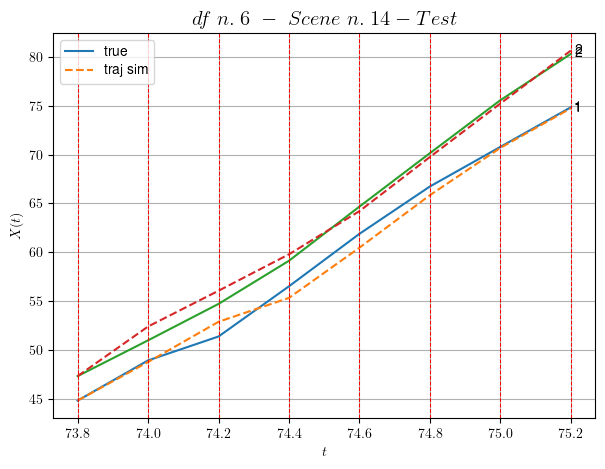

        For scene 14/47:
        * MSE = 0.7126460500258537
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/47


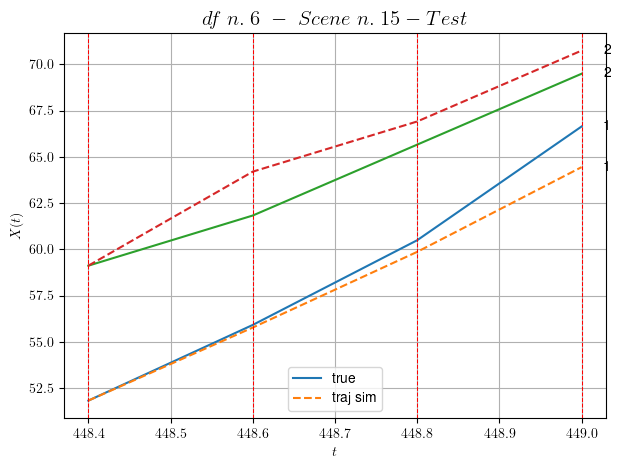

        For scene 15/47:
        * MSE = 1.7495853555757916
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/47


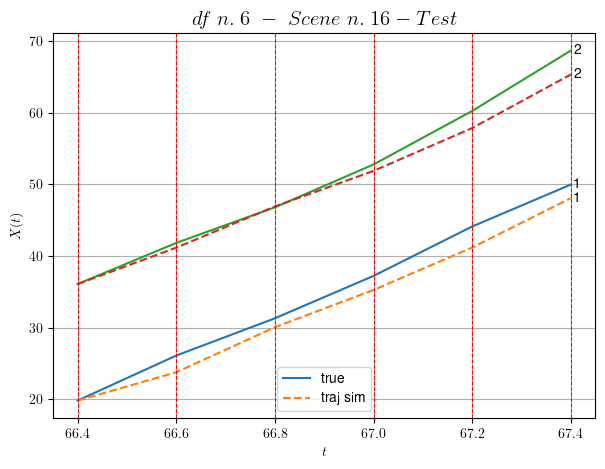

        For scene 16/47:
        * MSE = 3.4253191441945874
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/47


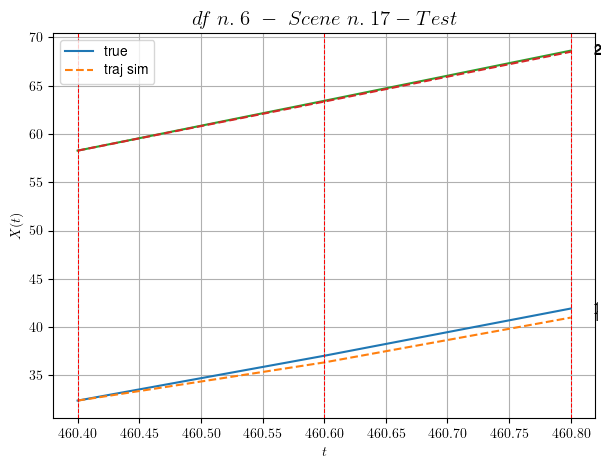

        For scene 17/47:
        * MSE = 0.22959428515430844
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/47


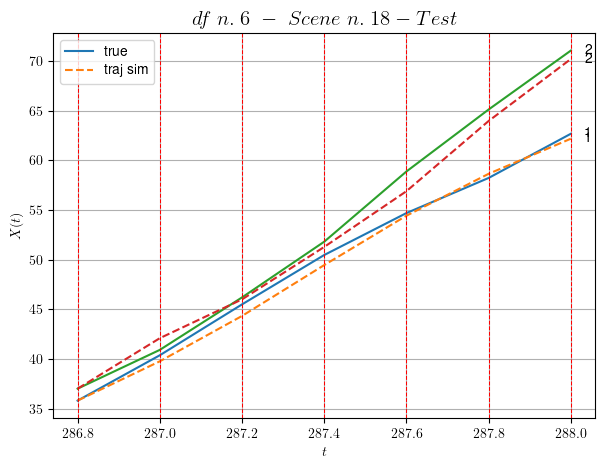

        For scene 18/47:
        * MSE = 0.7818557059398284
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.19/47


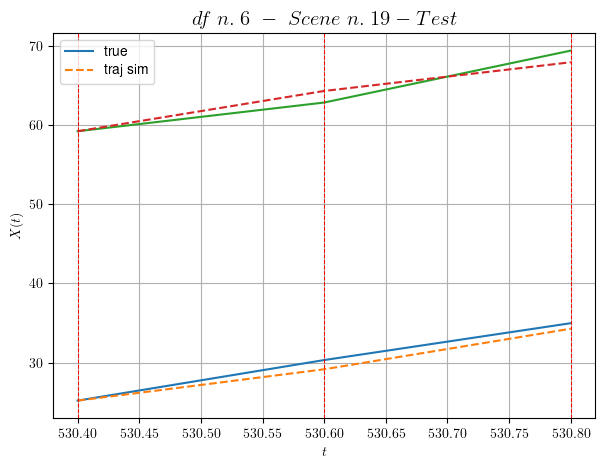

        For scene 19/47:
        * MSE = 1.021033588188696
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.20/47


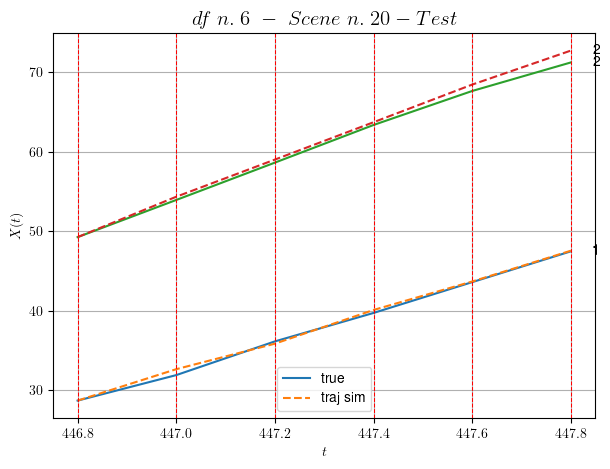

        For scene 20/47:
        * MSE = 0.34074777507995735
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.21/47


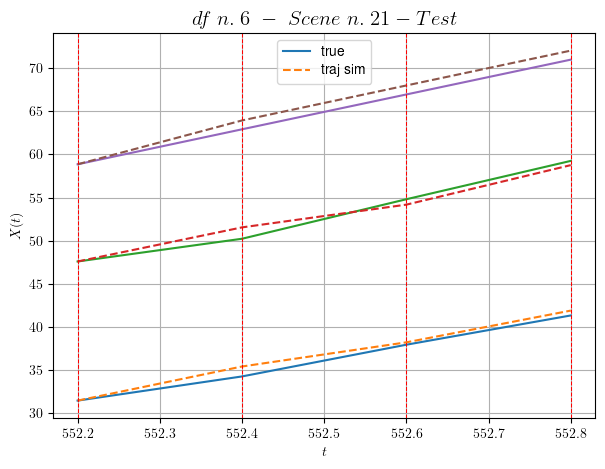

        For scene 21/47:
        * MSE = 0.6102847950201318
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.22/47


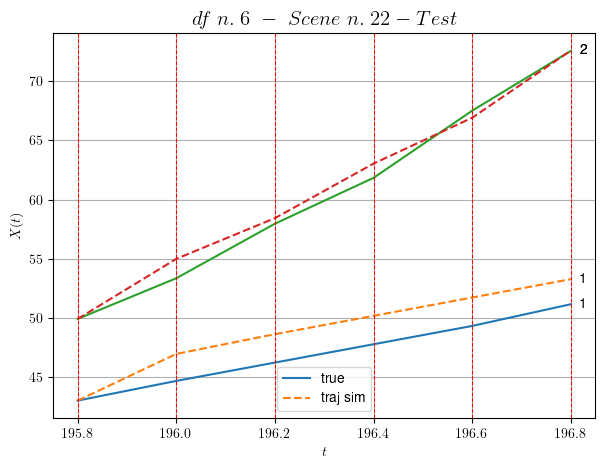

        For scene 22/47:
        * MSE = 2.6443260833361326
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.23/47


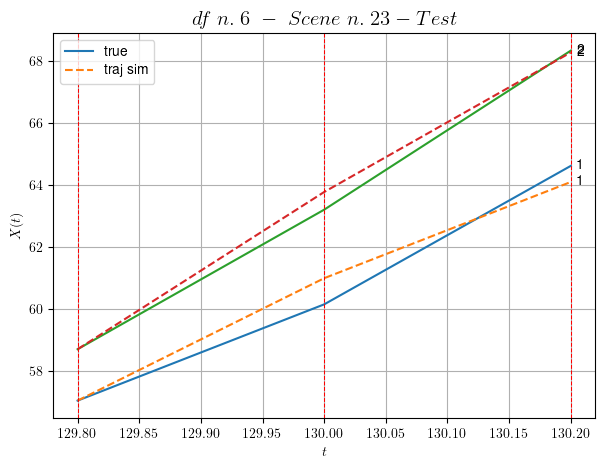

        For scene 23/47:
        * MSE = 0.2191259900695231
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.24/47


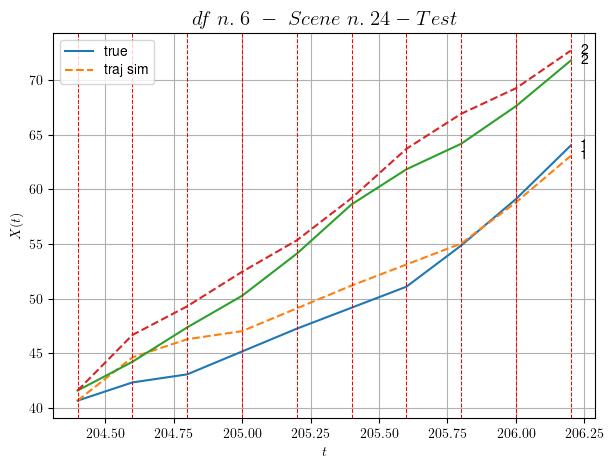

        For scene 24/47:
        * MSE = 3.135947882607752
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.25/47


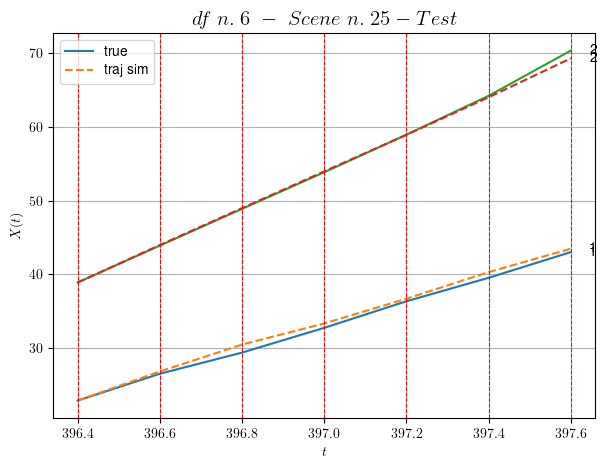

        For scene 25/47:
        * MSE = 0.26666920775443154
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.26/47


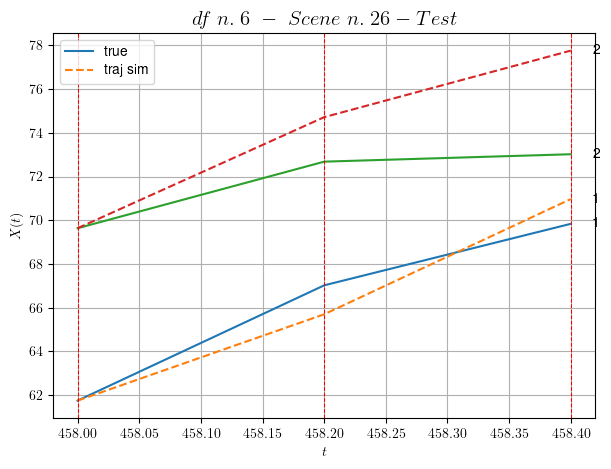

        For scene 26/47:
        * MSE = 4.9456586281849875
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.27/47


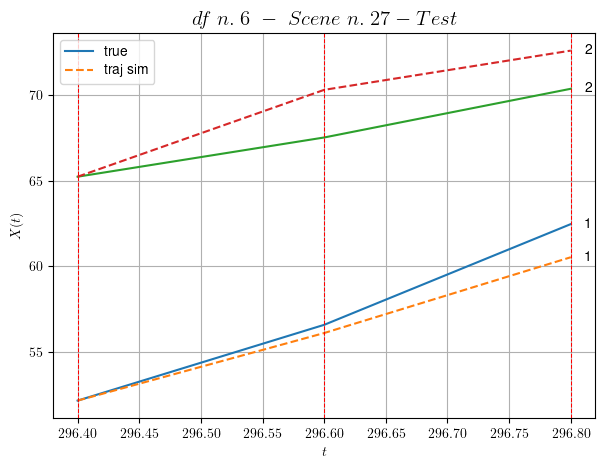

        For scene 27/47:
        * MSE = 2.789575661199624
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.28/47


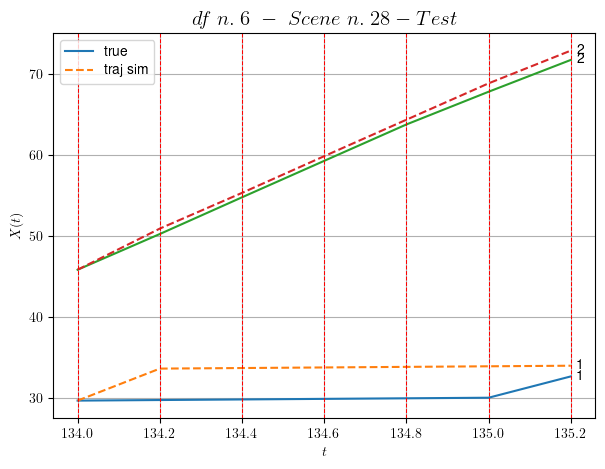

        For scene 28/47:
        * MSE = 5.781096053338892
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.29/47


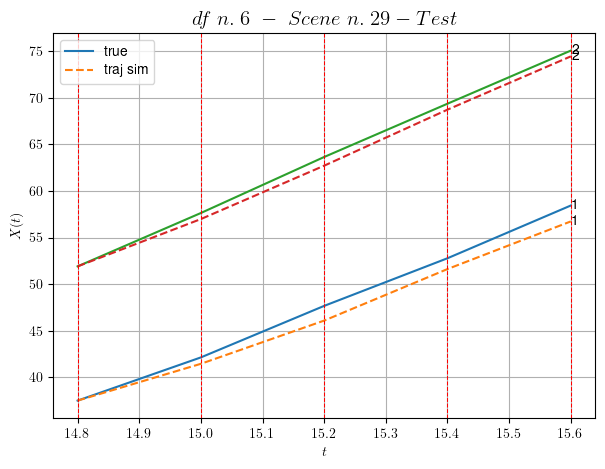

        For scene 29/47:
        * MSE = 0.930690749576585
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.30/47


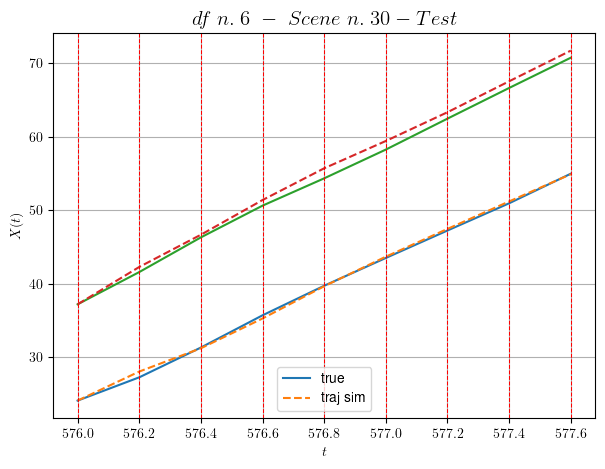

        For scene 30/47:
        * MSE = 0.43946360416009933
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.31/47


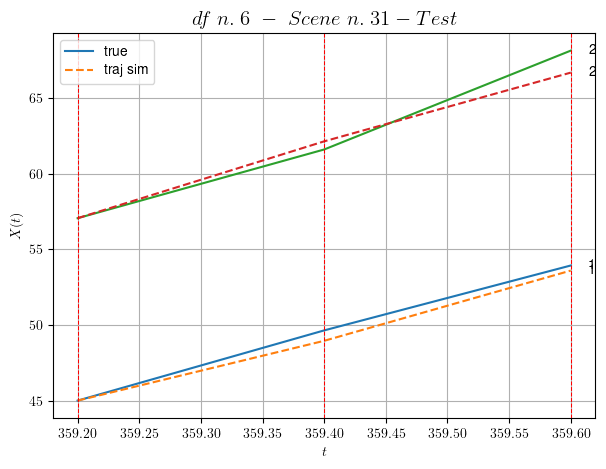

        For scene 31/47:
        * MSE = 0.4985072457841347
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.32/47


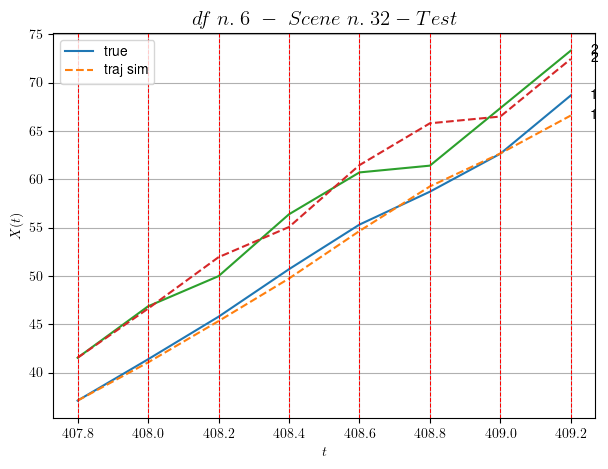

        For scene 32/47:
        * MSE = 2.0760938327531253
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.33/47


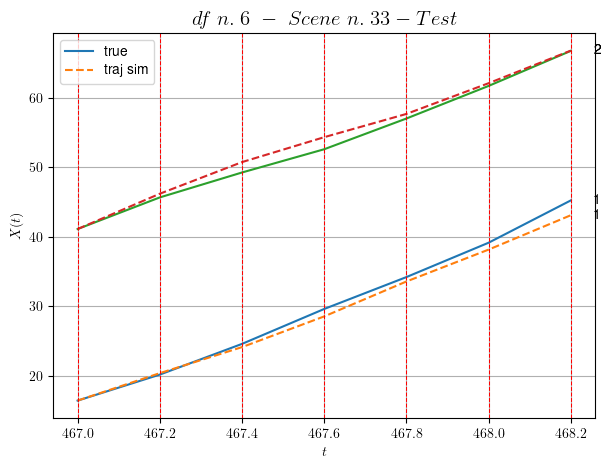

        For scene 33/47:
        * MSE = 0.9617620856136335
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.34/47


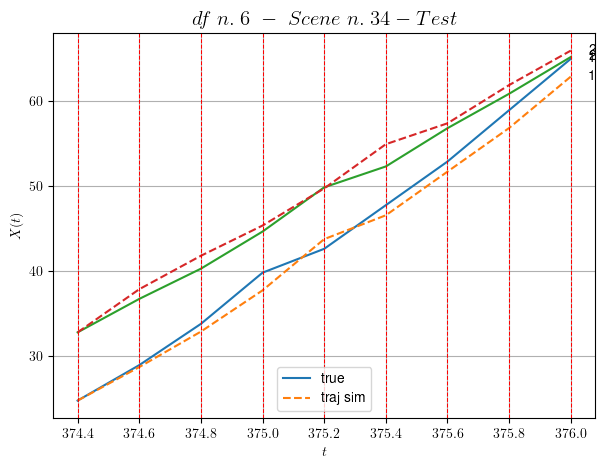

        For scene 34/47:
        * MSE = 1.7272396166684791
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.35/47


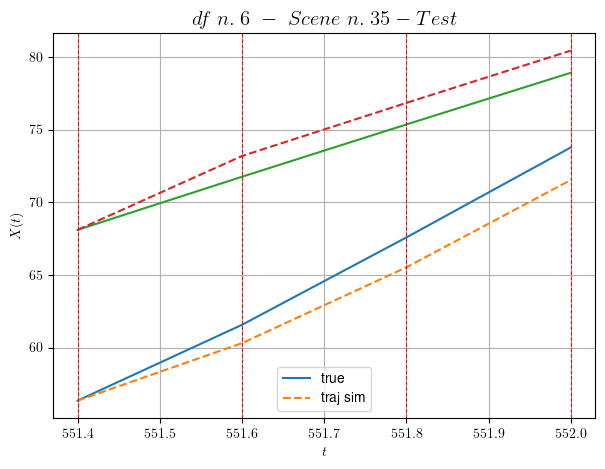

        For scene 35/47:
        * MSE = 2.1754490981972054
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.36/47


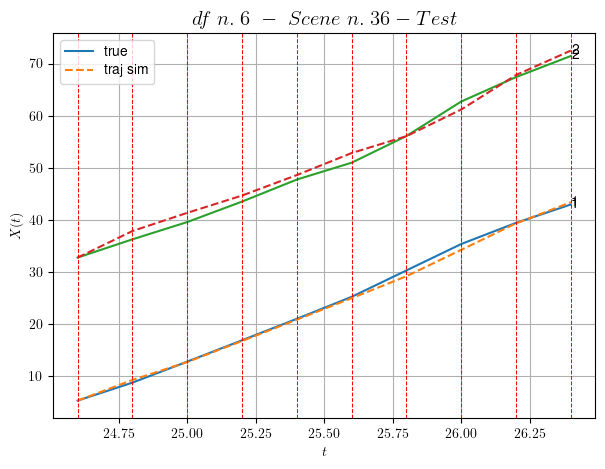

        For scene 36/47:
        * MSE = 0.888013992869332
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.37/47


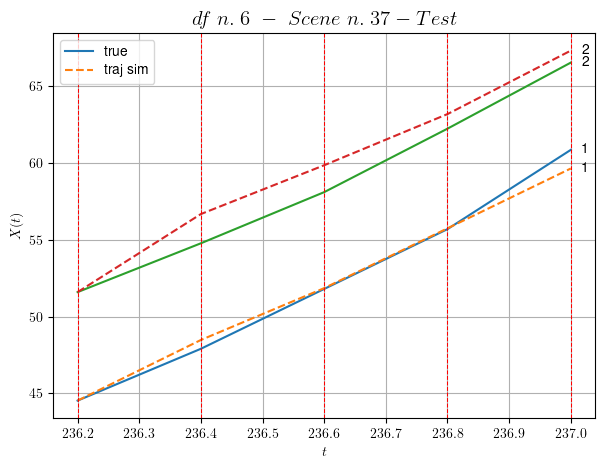

        For scene 37/47:
        * MSE = 1.0007176757264538
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.38/47


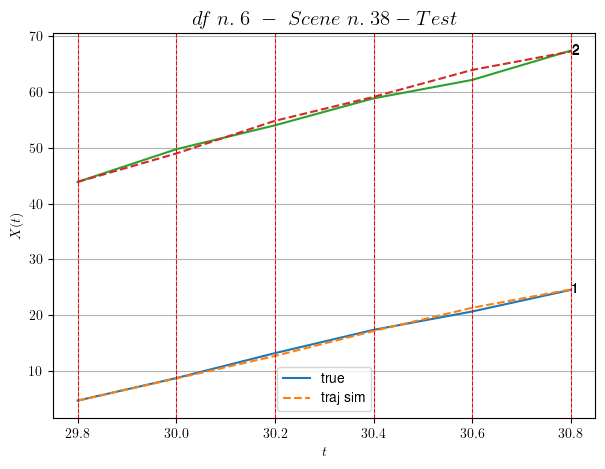

        For scene 38/47:
        * MSE = 0.4372893305966809
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.39/47


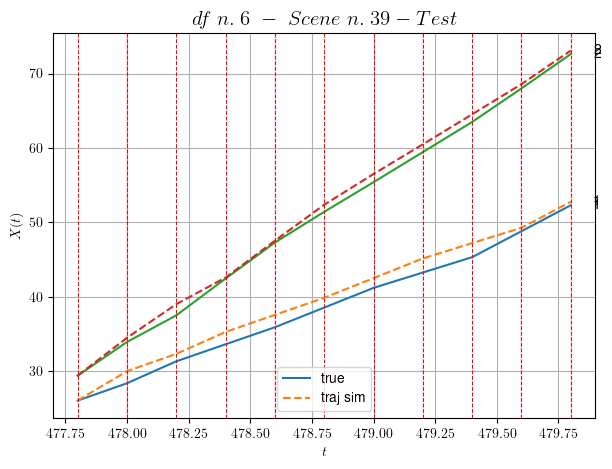

        For scene 39/47:
        * MSE = 1.2527368754678625
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.40/47


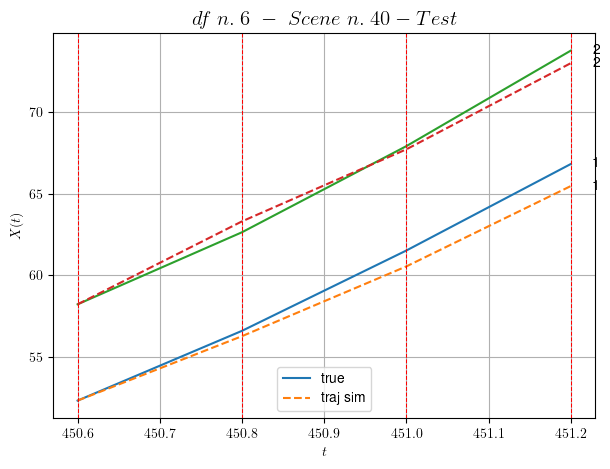

        For scene 40/47:
        * MSE = 0.49417690646353374
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.41/47


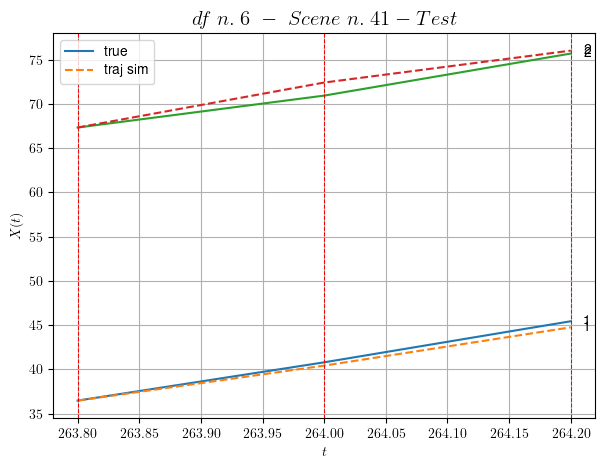

        For scene 41/47:
        * MSE = 0.48230791622674185
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.42/47


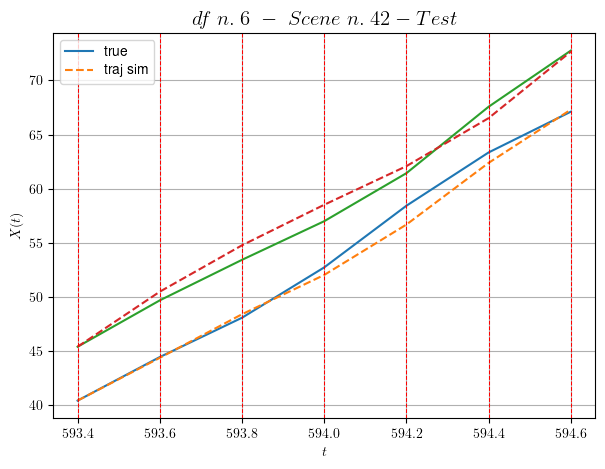

        For scene 42/47:
        * MSE = 0.7755984674914562
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.43/47


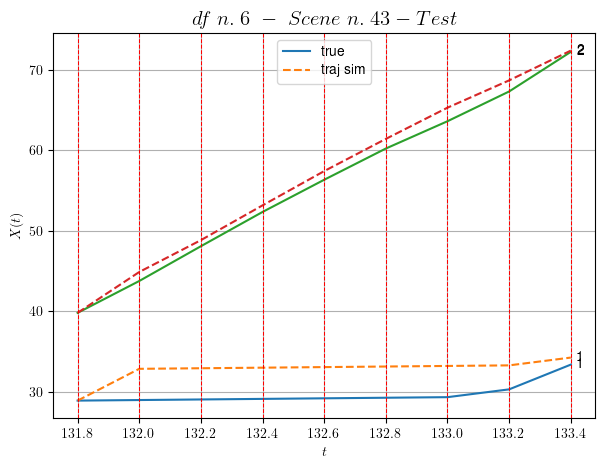

        For scene 43/47:
        * MSE = 6.10931652712079
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.44/47


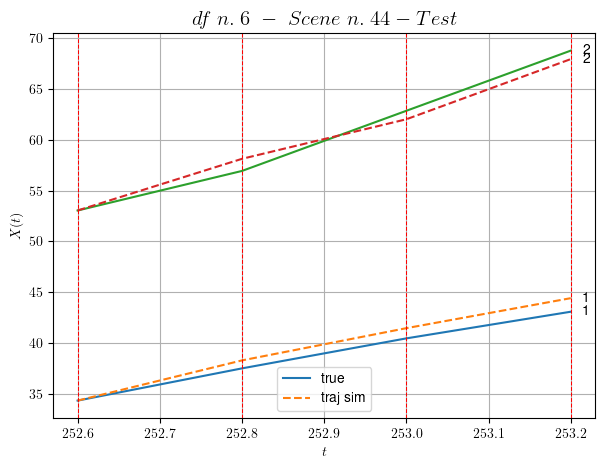

        For scene 44/47:
        * MSE = 0.7762506657296575
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.45/47


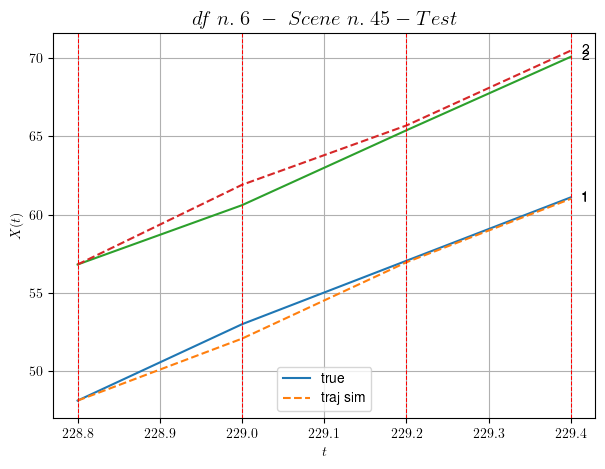

        For scene 45/47:
        * MSE = 0.3497480406440712
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.46/47


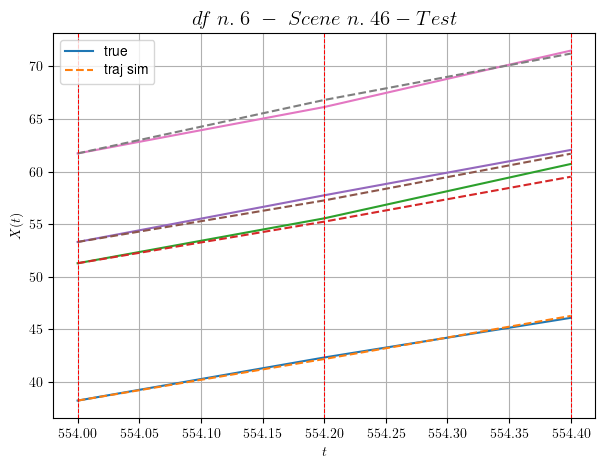

        For scene 46/47:
        * MSE = 0.2105941290296358
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.47/47


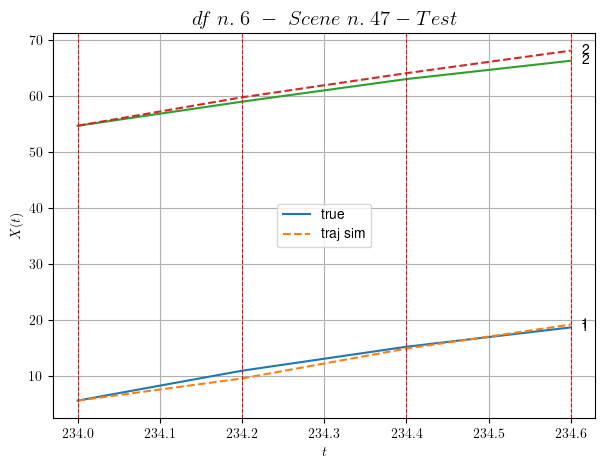

        For scene 47/47:
        * MSE = 0.9070328714090474
----------------------------------------------------------------------------------------------------


MSE test: 1.6771809321691806

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.3373558324172555
          * MSE test: 1.6771809321691806
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 7/10 dfs.
In DataFrame n.7 we have 30 scenes.
    To train the model we use 3 scenes, the remaining 27 to test the model.

Training step. (3 scenes)
DataFrame n.7. Scene n.1/3
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [162.36,163.16]


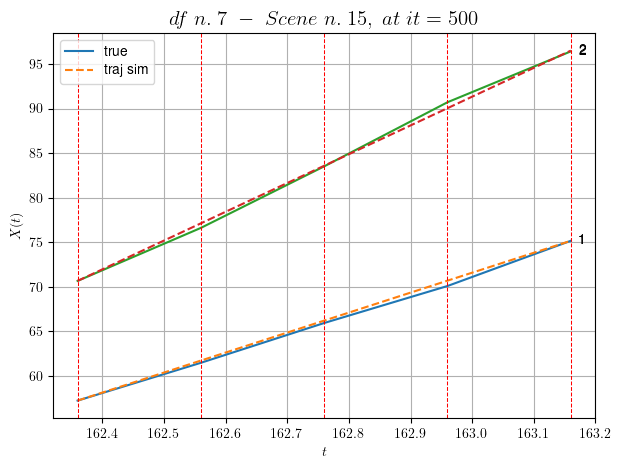

----------------------------------------------------------------------------------------------------
        For scene 1/3:
        * After LR finder: LR_NN=0.001 with mse=0.8573993875030573 at it=24
        * v0 = 32.323787690864414
        * MSE = 0.12119380274780855
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [206.96,207.56]


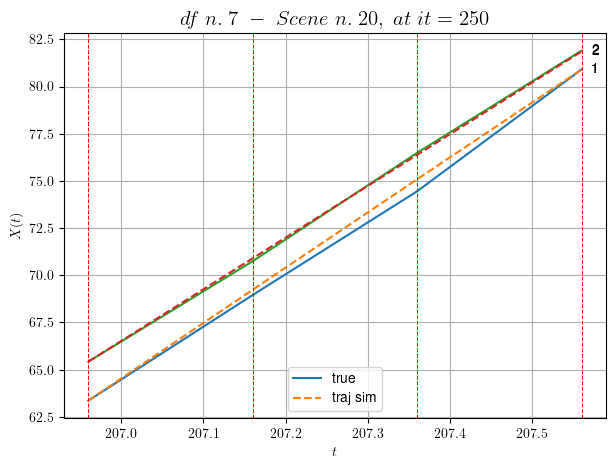

----------------------------------------------------------------------------------------------------
        For scene 2/3:
        * After LR finder: LR_NN=0.001 with mse=0.6056551064539033 at it=24
        * v0 = 27.39926372250182
        * MSE = 0.06444588885780957
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


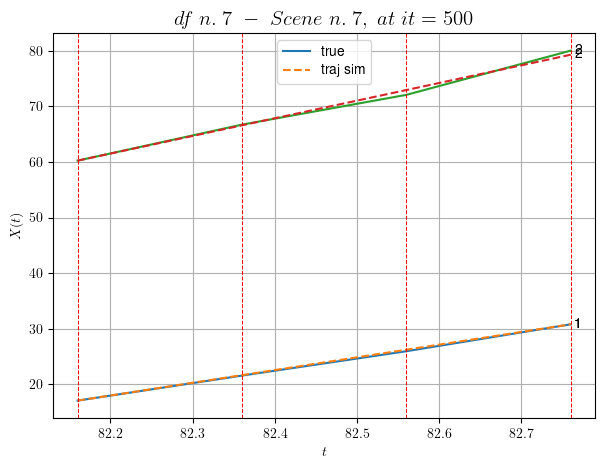

----------------------------------------------------------------------------------------------------
        For scene 3/3:
        * After LR finder: LR_NN=0.001 with mse=0.4420647529011768 at it=24
        * v0 = 31.74543102335636
        * MSE = 0.17371750304638173
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.11978573155066662
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (27 scenes)
DataFrame n.7. Scene n.1/27


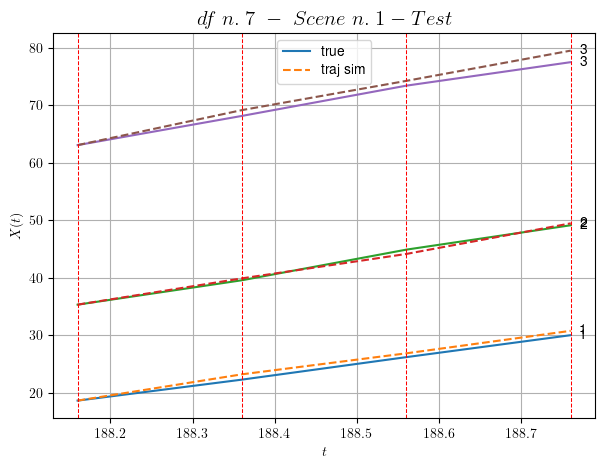

        For scene 1/27:
        * MSE = 0.6997382577393024
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/27


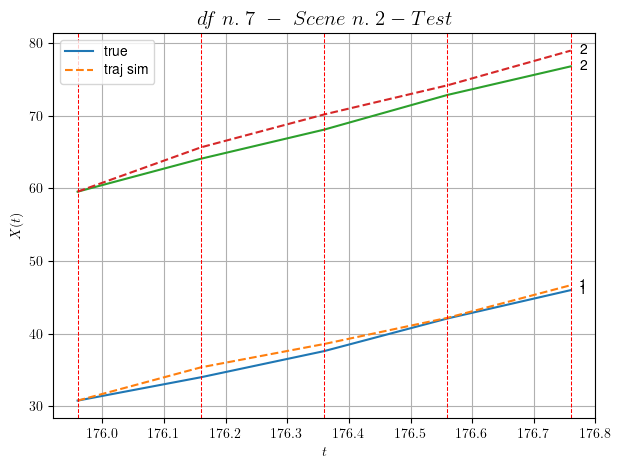

        For scene 2/27:
        * MSE = 1.6551044665325647
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/27


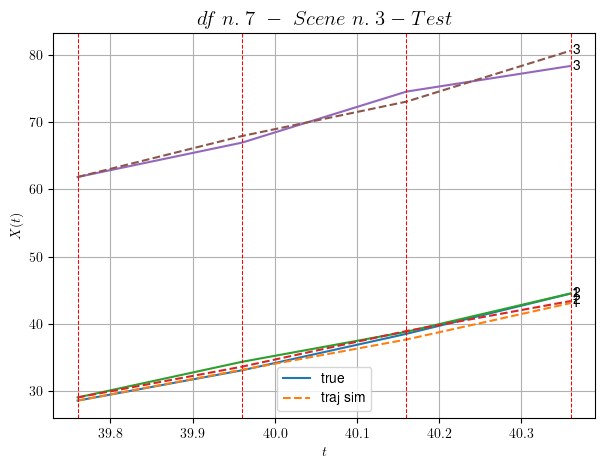

        For scene 3/27:
        * MSE = 1.0769236848808317
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/27


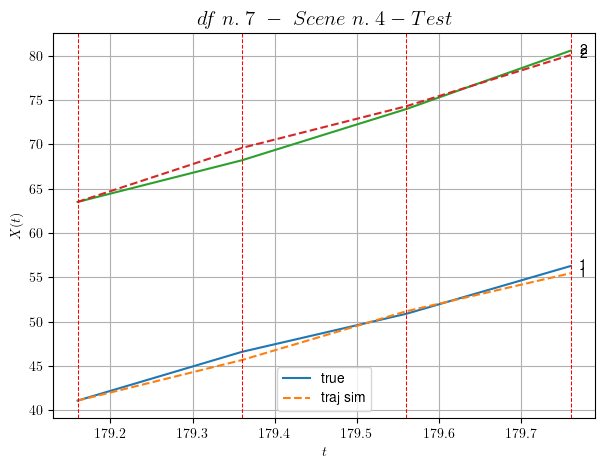

        For scene 4/27:
        * MSE = 0.4862110601756631
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/27


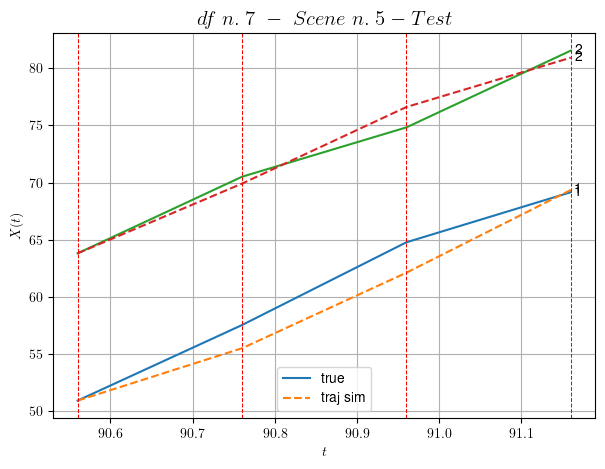

        For scene 5/27:
        * MSE = 1.8941188582116109
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/27


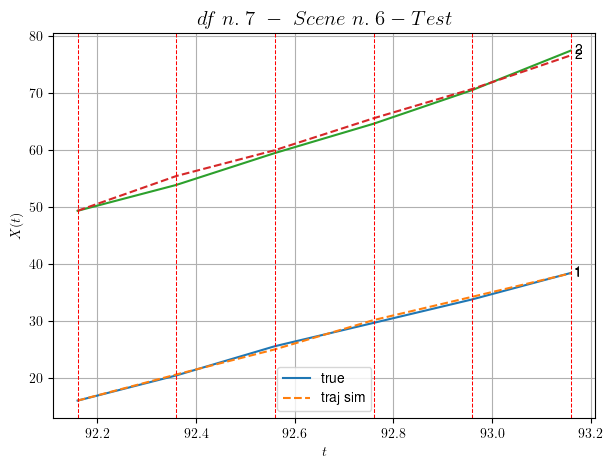

        For scene 6/27:
        * MSE = 0.4270795434289815
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/27


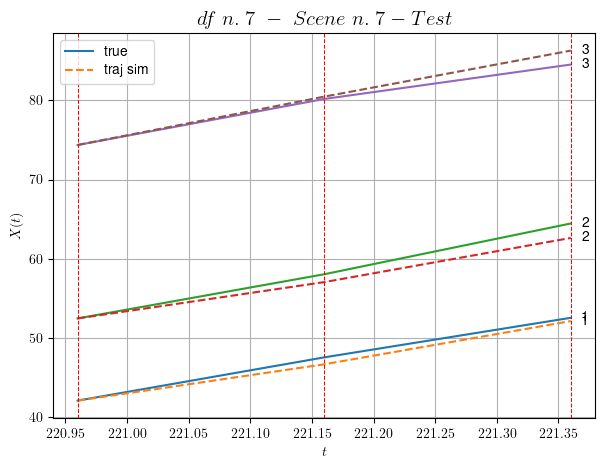

        For scene 7/27:
        * MSE = 0.9349051543279622
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/27


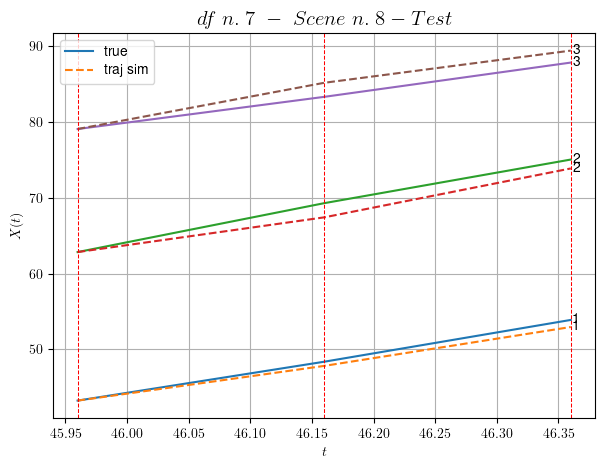

        For scene 8/27:
        * MSE = 1.3311588123243174
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/27


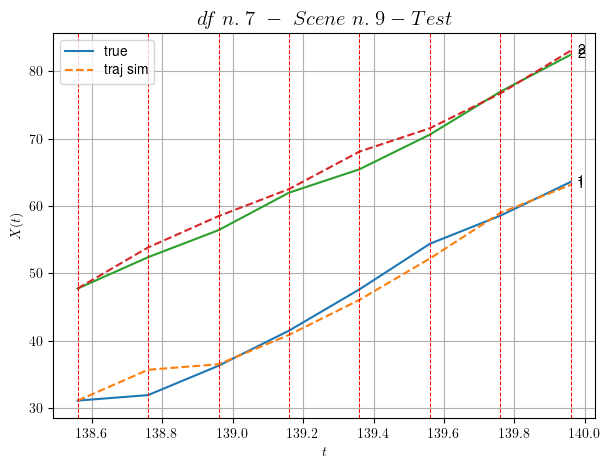

        For scene 9/27:
        * MSE = 2.3185093792033222
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/27


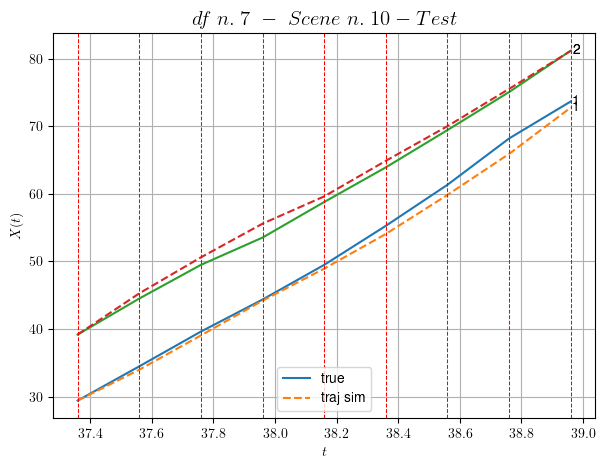

        For scene 10/27:
        * MSE = 1.0487172157854379
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.11/27


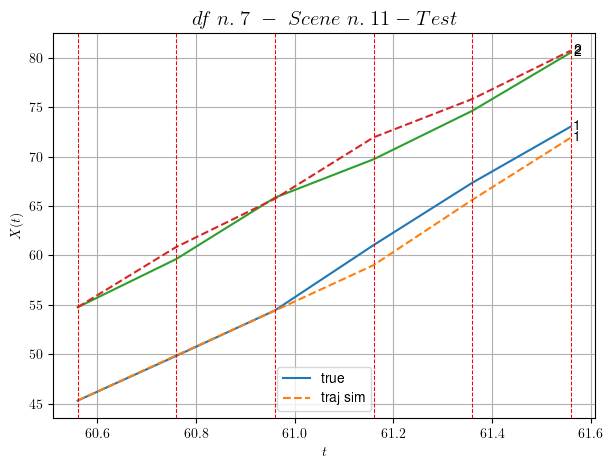

        For scene 11/27:
        * MSE = 1.3513464170394696
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.12/27


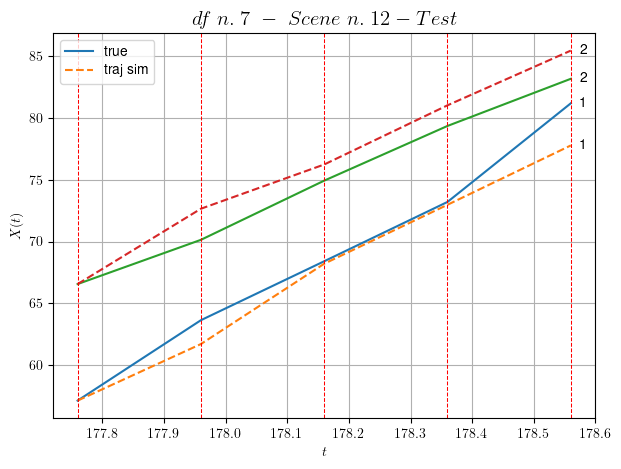

        For scene 12/27:
        * MSE = 3.1491582604882855
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.13/27


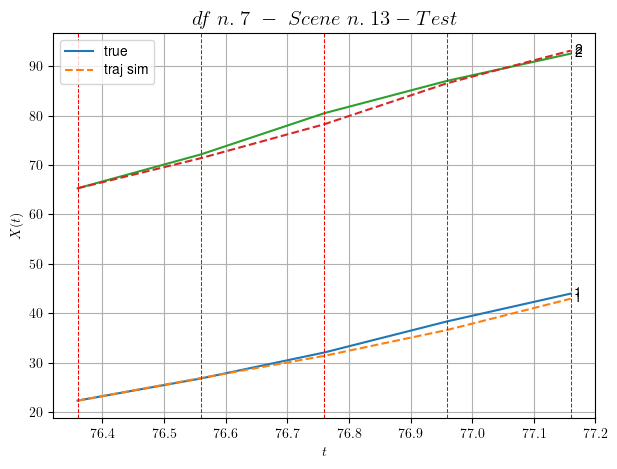

        For scene 13/27:
        * MSE = 1.0726357060700593
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.14/27


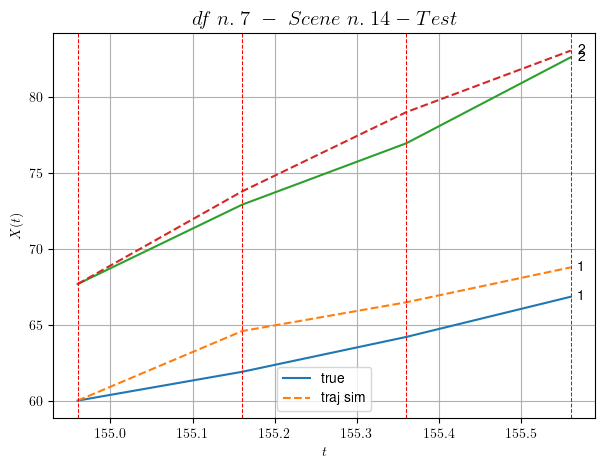

        For scene 14/27:
        * MSE = 2.659267341118995
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.15/27


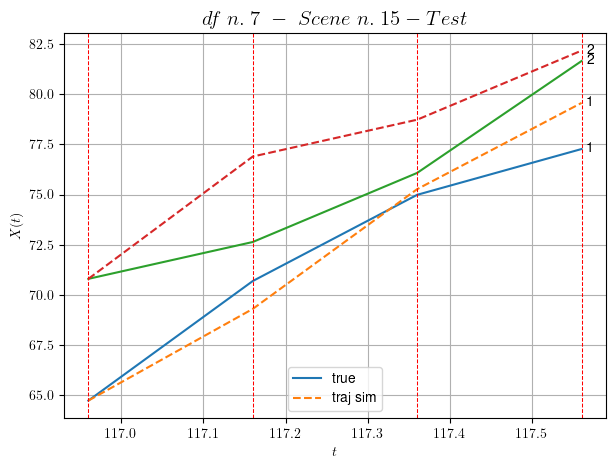

        For scene 15/27:
        * MSE = 4.095106923391904
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.16/27


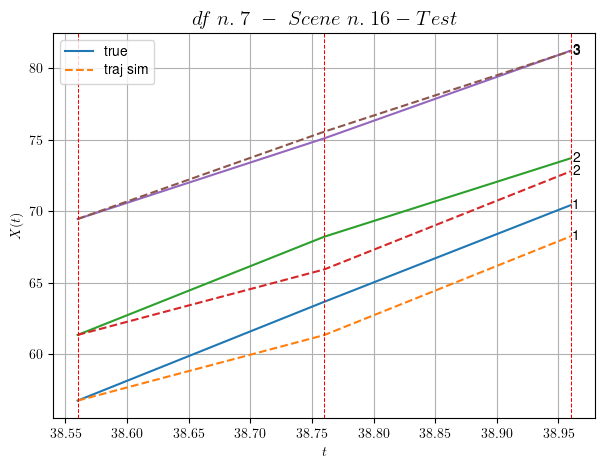

        For scene 16/27:
        * MSE = 1.8233583943412954
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.17/27


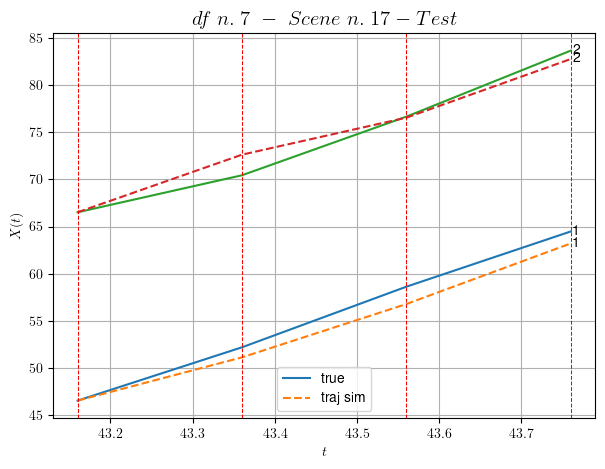

        For scene 17/27:
        * MSE = 1.4585825412411242
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.18/27


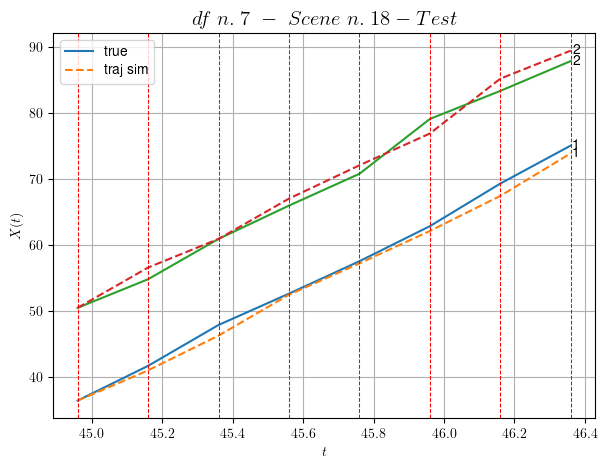

        For scene 18/27:
        * MSE = 1.5775066740019317
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.19/27


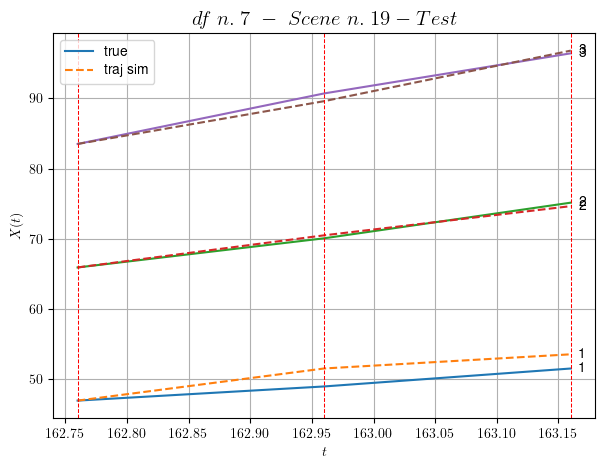

        For scene 19/27:
        * MSE = 1.3821791951881073
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.20/27


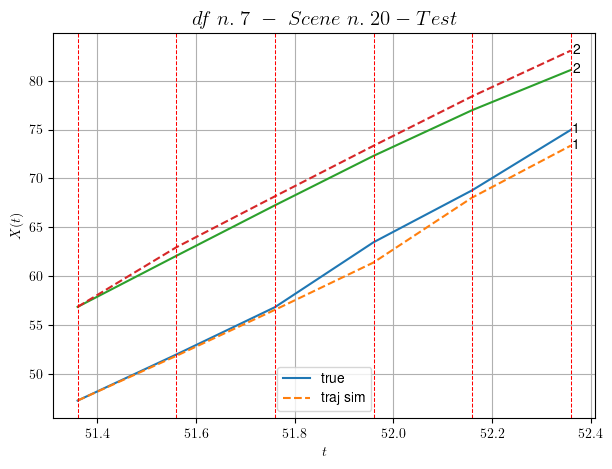

        For scene 20/27:
        * MSE = 1.3461925895728613
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.21/27


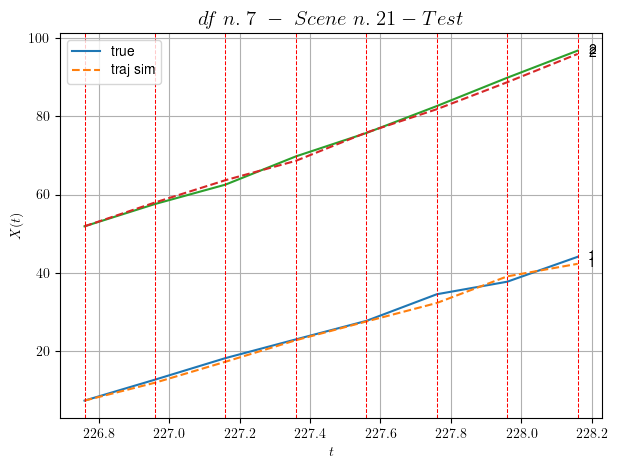

        For scene 21/27:
        * MSE = 1.0663714897535161
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.22/27


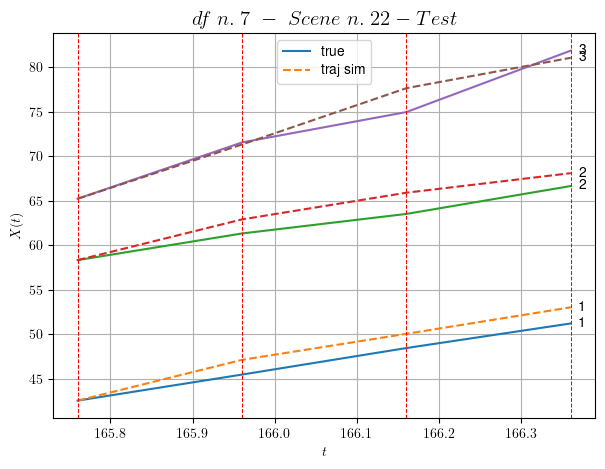

        For scene 22/27:
        * MSE = 2.228373429354384
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.23/27


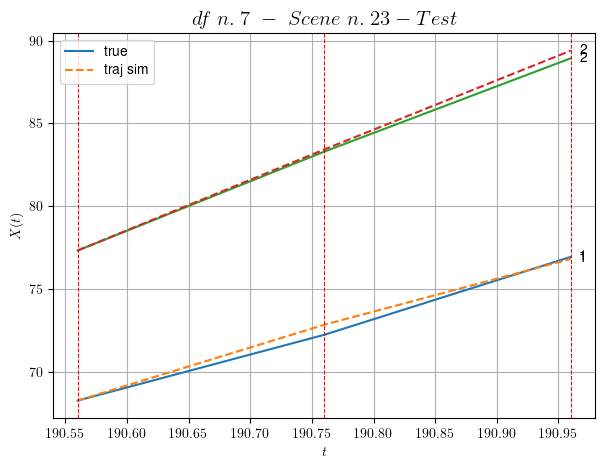

        For scene 23/27:
        * MSE = 0.10242404576697449
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.24/27


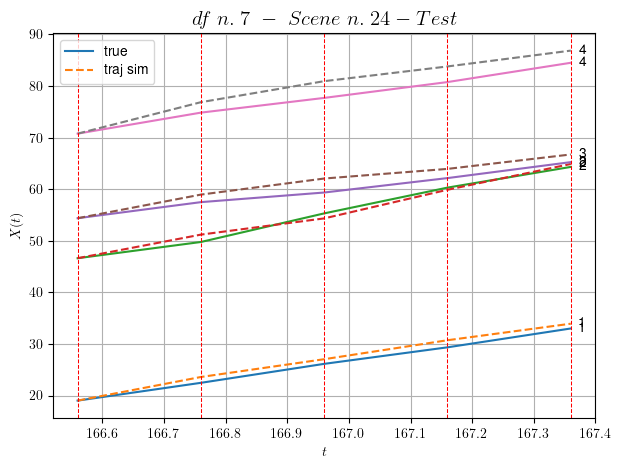

        For scene 24/27:
        * MSE = 2.6273716355089602
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.25/27


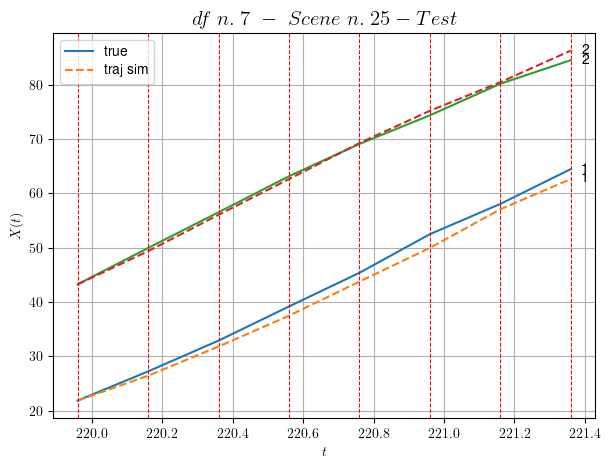

        For scene 25/27:
        * MSE = 1.420076742588313
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.26/27


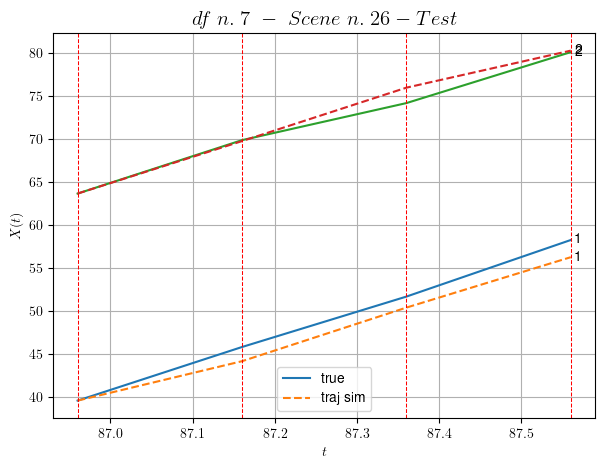

        For scene 26/27:
        * MSE = 1.450728720057227
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.27/27


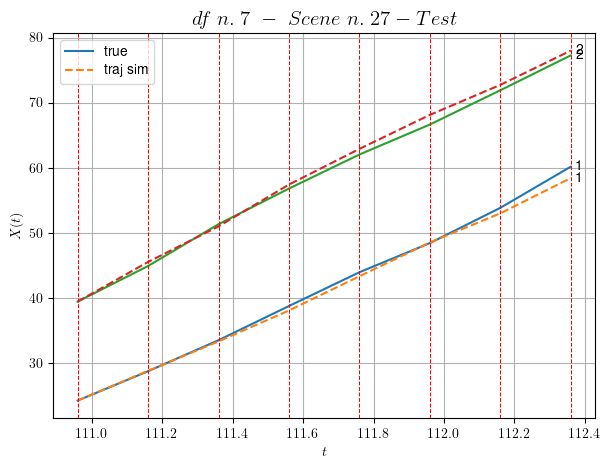

        For scene 27/27:
        * MSE = 0.6079266701432879
----------------------------------------------------------------------------------------------------


MSE test: 1.52929900771247

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.11978573155066662
          * MSE test: 1.52929900771247
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 8/10 dfs.
In DataFrame n.8 we have 79 scenes.
    To train the model we use 7 scenes, the remaining 72 to test the model.

Training step. (7 scenes)
DataFrame n.8. Scene n.1/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [48.04,48.84]


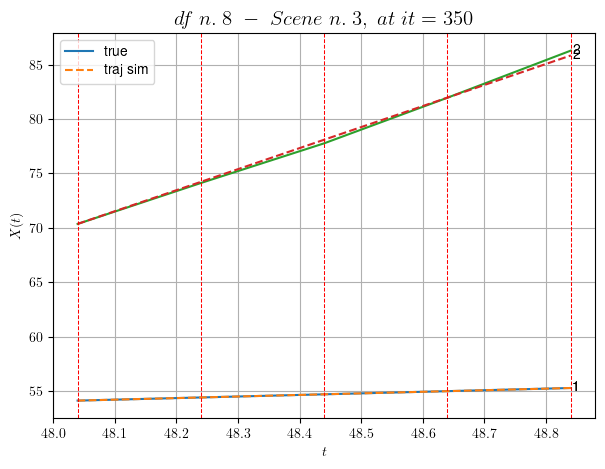

----------------------------------------------------------------------------------------------------
        For scene 1/7:
        * After LR finder: LR_NN=0.005 with mse=13.18143291542071 at it=24
        * v0 = 19.366199429857964
        * MSE = 0.02887746709855181
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/7
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [283.84,285.04]


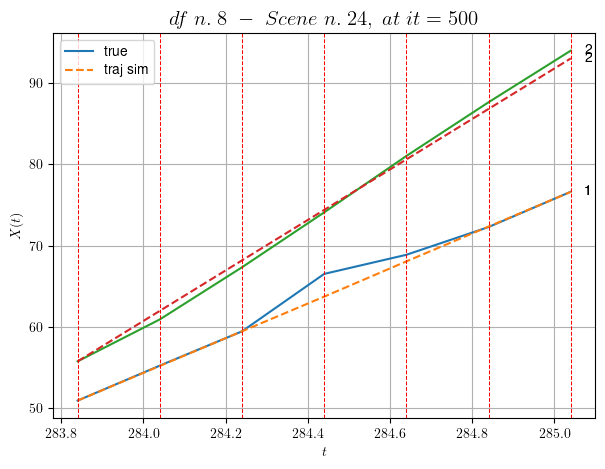

----------------------------------------------------------------------------------------------------
        For scene 2/7:
        * After LR finder: LR_NN=0.001 with mse=1.525110575583623 at it=24
        * v0 = 31.024373752742626
        * MSE = 0.863038183240458
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/7
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [276.64,277.64]


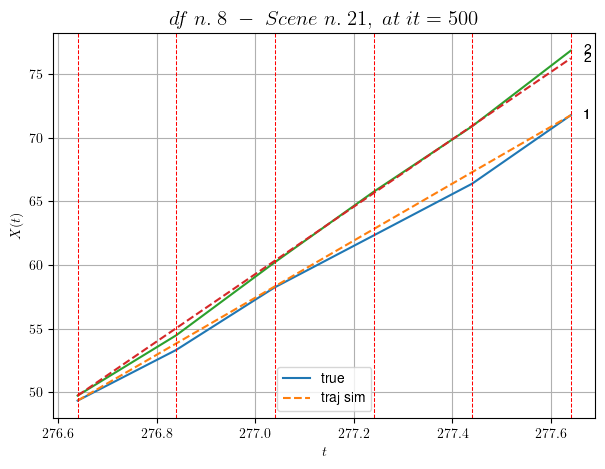

----------------------------------------------------------------------------------------------------
        For scene 3/7:
        * After LR finder: LR_NN=0.0005 with mse=2.118351077934272 at it=24
        * v0 = 26.49050884606435
        * MSE = 0.16438468998320888
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [102.24,103.04]


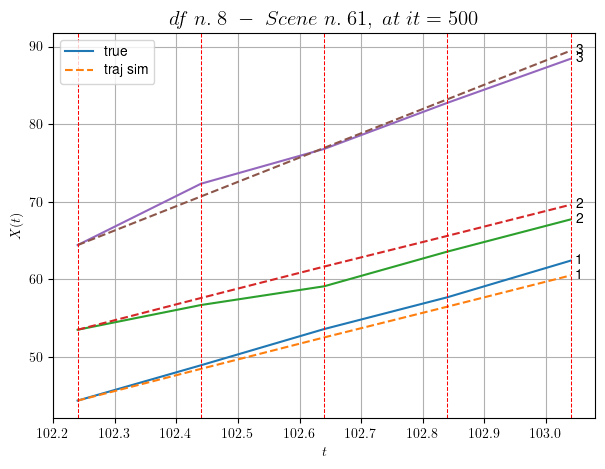

----------------------------------------------------------------------------------------------------
        For scene 4/7:
        * After LR finder: LR_NN=0.005 with mse=1.6442295831585803 at it=24
        * v0 = 31.34829198332158
        * MSE = 1.6963645611420768
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [290.84,291.44]


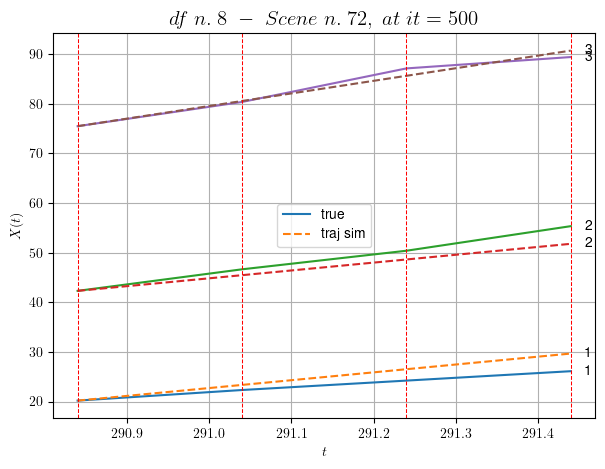

----------------------------------------------------------------------------------------------------
        For scene 5/7:
        * After LR finder: LR_NN=0.0005 with mse=2.333091956322829 at it=24
        * v0 = 25.37824427977436
        * MSE = 3.3359479214245606
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/7
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [178.44,179.24]


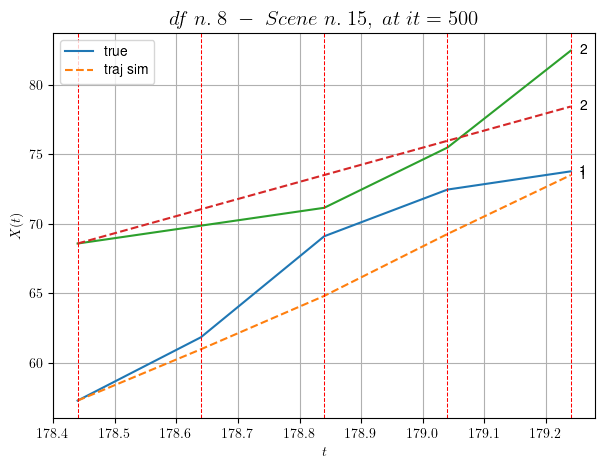

----------------------------------------------------------------------------------------------------
        For scene 6/7:
        * After LR finder: LR_NN=0.005 with mse=37.92093204783803 at it=24
        * v0 = 12.308982889931924
        * MSE = 5.269086759435309
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [536.64,537.24]


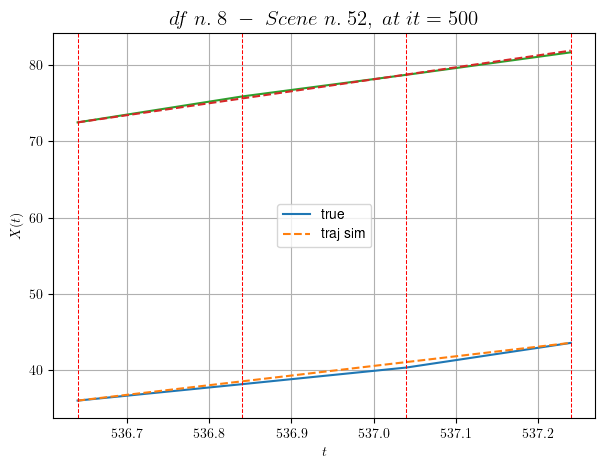

----------------------------------------------------------------------------------------------------
        For scene 7/7:
        * After LR finder: LR_NN=0.0001 with mse=14.804819439294544 at it=24
        * v0 = 15.683354883416905
        * MSE = 0.09650235281036967
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.6363145621620767
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (72 scenes)
DataFrame n.8. Scene n.1/72


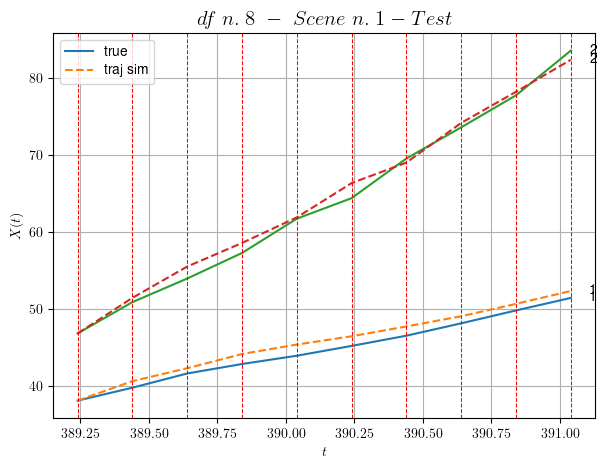

        For scene 1/72:
        * MSE = 1.0432127048157922
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/72


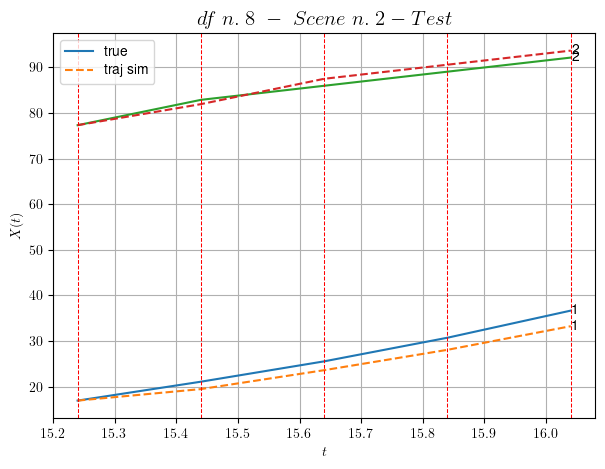

        For scene 2/72:
        * MSE = 3.2952547148351528
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/72


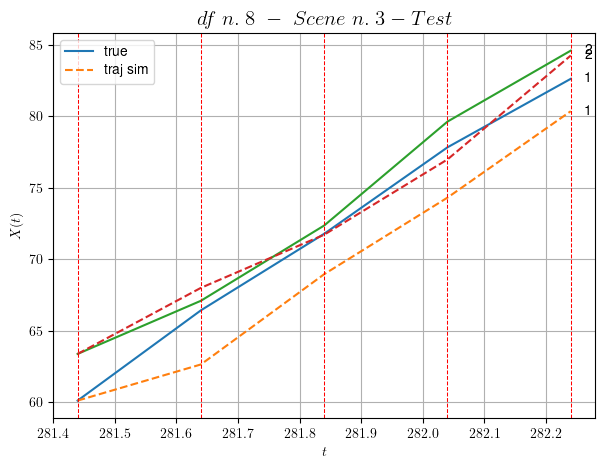

        For scene 3/72:
        * MSE = 4.807995246582481
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/72


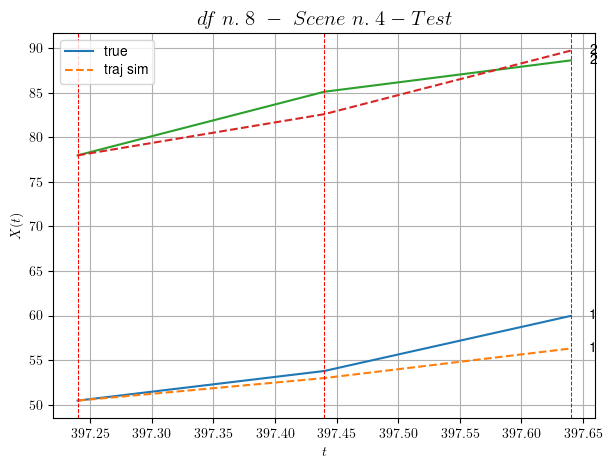

        For scene 4/72:
        * MSE = 3.5861090777002076
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/72


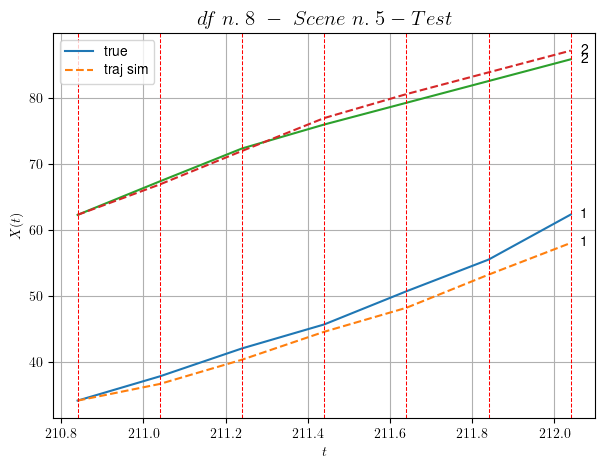

        For scene 5/72:
        * MSE = 3.008801827713007
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/72


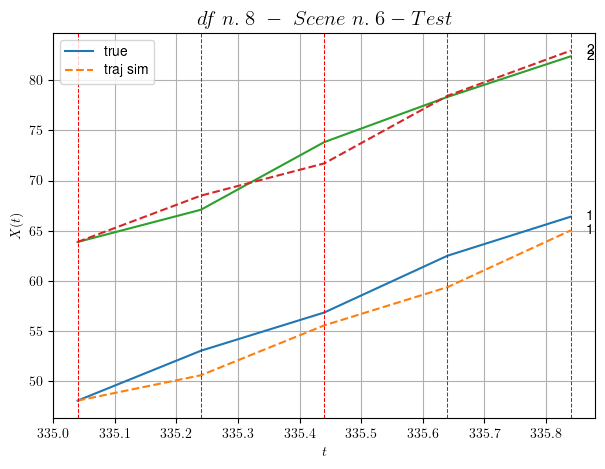

        For scene 6/72:
        * MSE = 2.6106984696844298
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/72


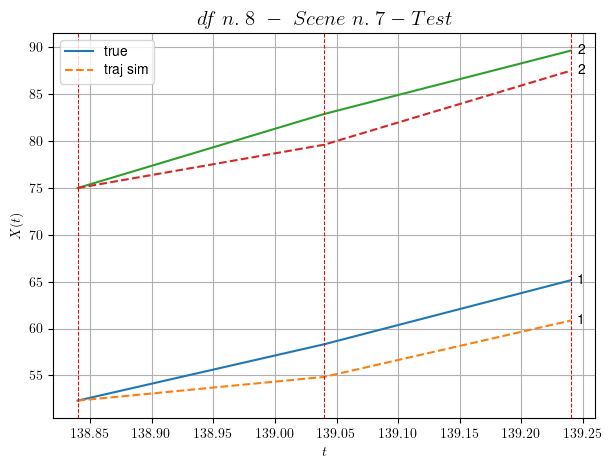

        For scene 7/72:
        * MSE = 7.634381263865531
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/72


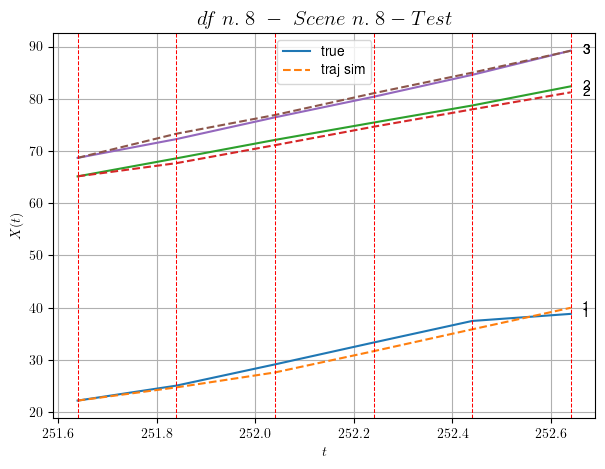

        For scene 8/72:
        * MSE = 0.8575445998867327
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/72


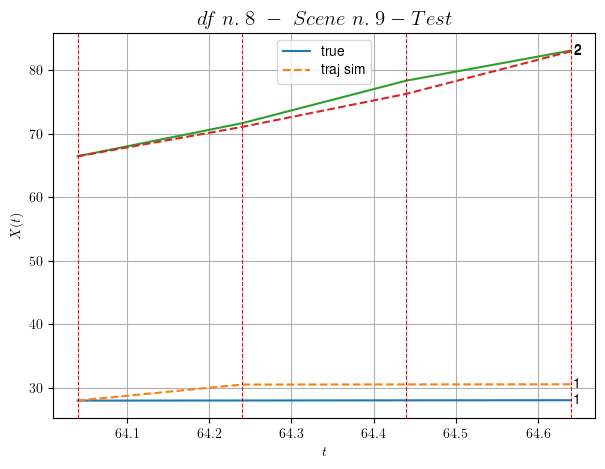

        For scene 9/72:
        * MSE = 2.9415263676594394
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/72


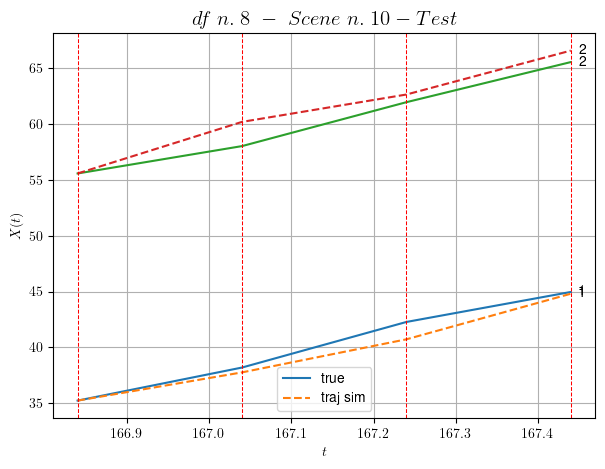

        For scene 10/72:
        * MSE = 1.106060470116921
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/72


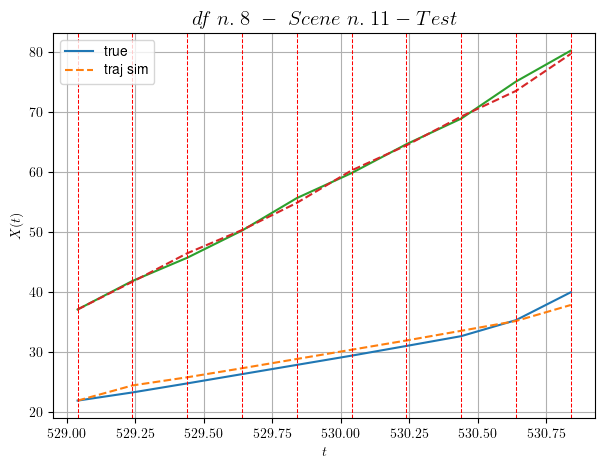

        For scene 11/72:
        * MSE = 0.7874911515431724
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/72


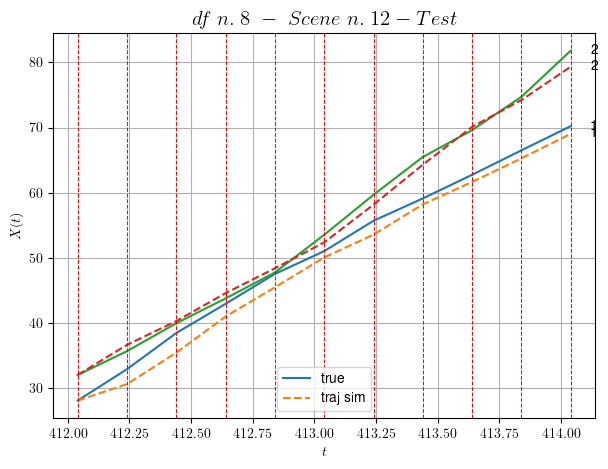

        For scene 12/72:
        * MSE = 2.1156195619758753
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/72


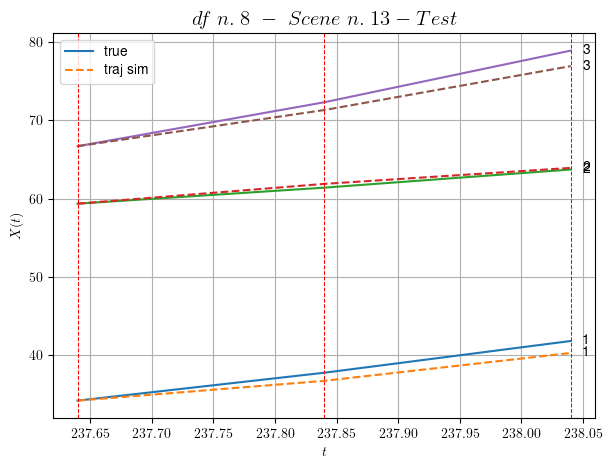

        For scene 13/72:
        * MSE = 0.9566347511966461
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/72


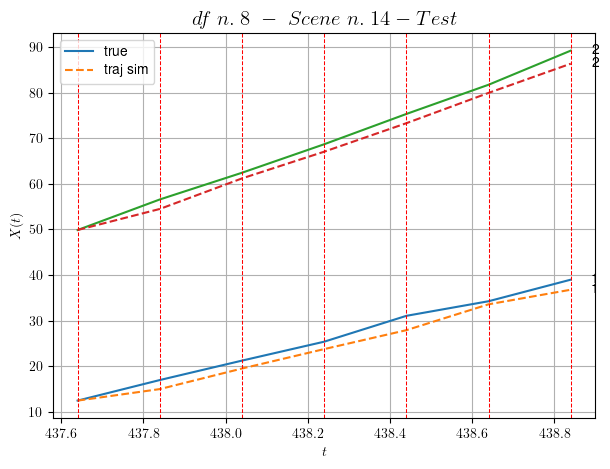

        For scene 14/72:
        * MSE = 3.4871332463590616
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/72


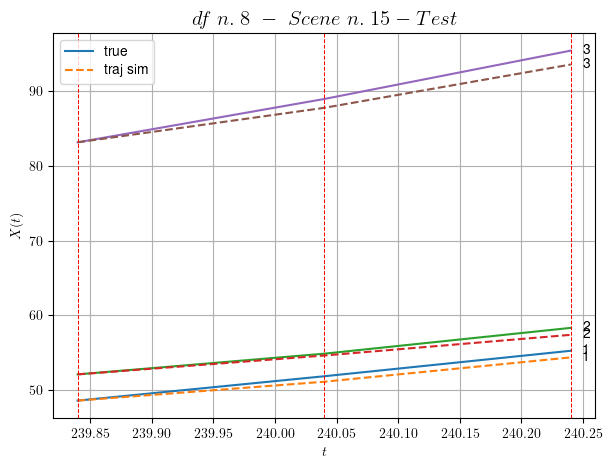

        For scene 15/72:
        * MSE = 0.7894682131100835
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/72


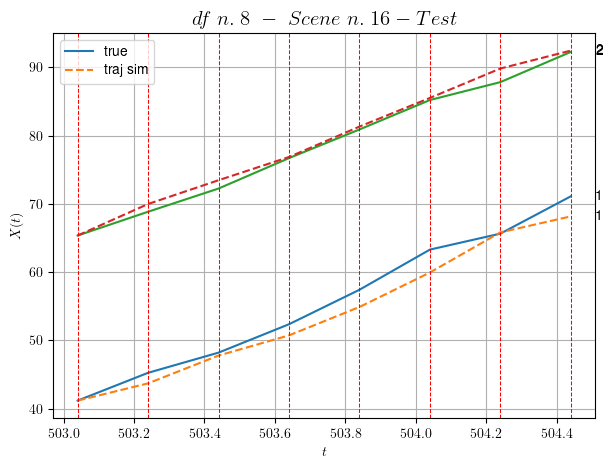

        For scene 16/72:
        * MSE = 2.4140381092784726
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/72


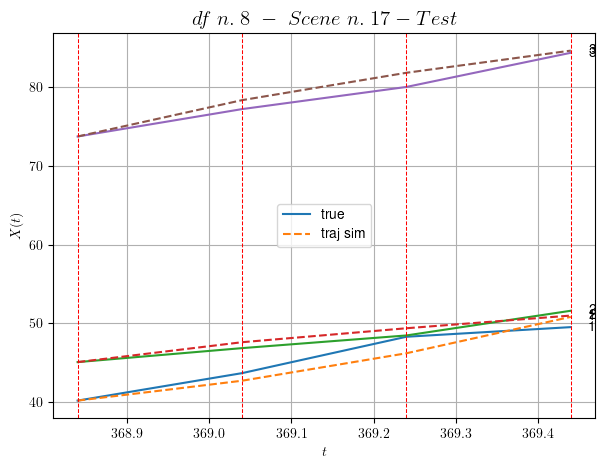

        For scene 17/72:
        * MSE = 1.1172779758042972
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/72


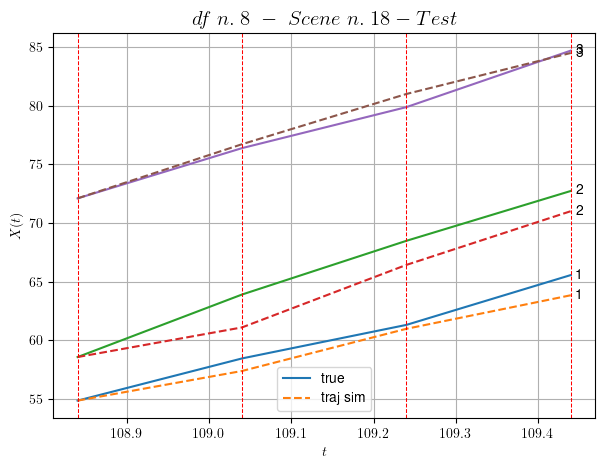

        For scene 18/72:
        * MSE = 1.723358275020737
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/72


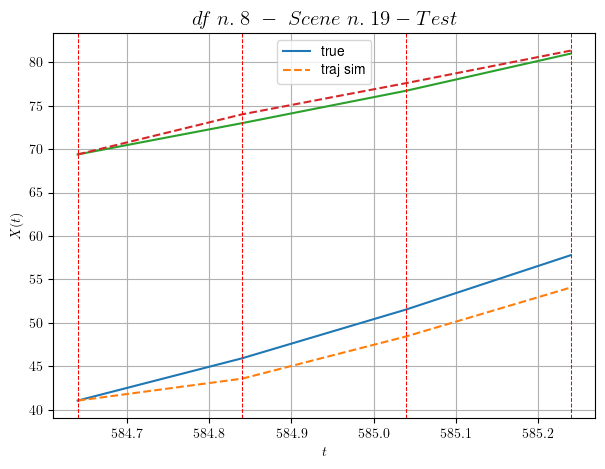

        For scene 19/72:
        * MSE = 3.8640891422275345
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/72


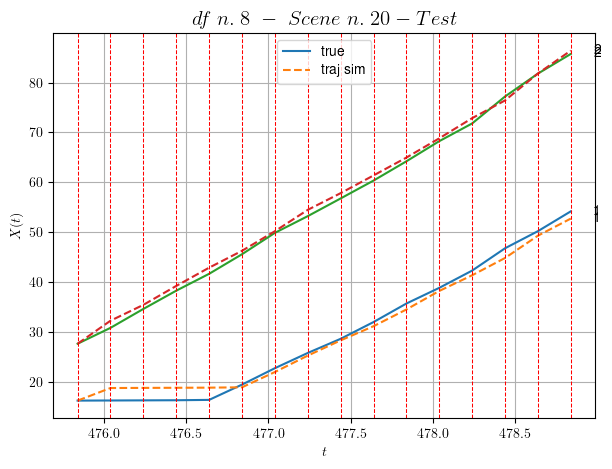

        For scene 20/72:
        * MSE = 1.5250403880910541
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/72


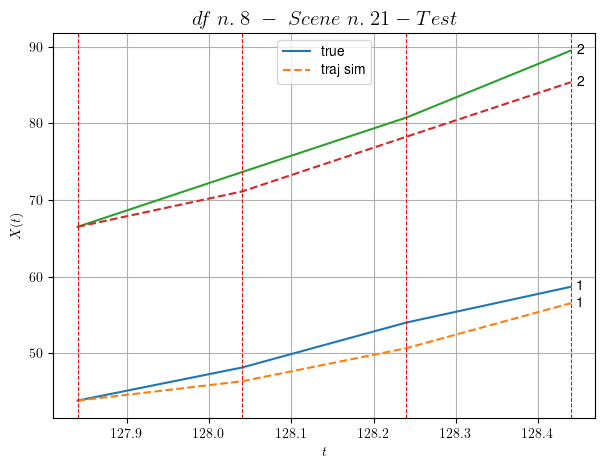

        For scene 21/72:
        * MSE = 6.0910067187602195
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/72


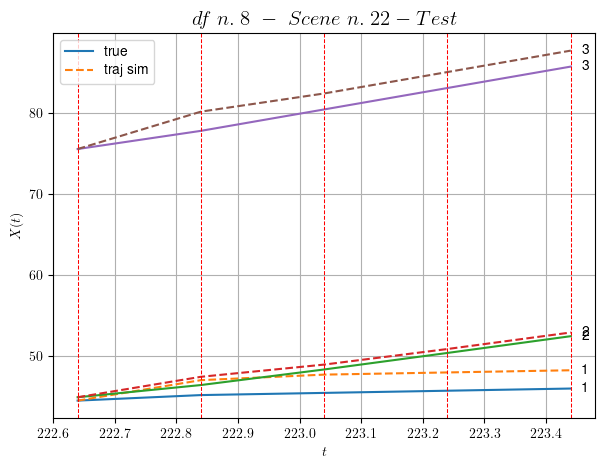

        For scene 22/72:
        * MSE = 2.5210249726828806
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/72


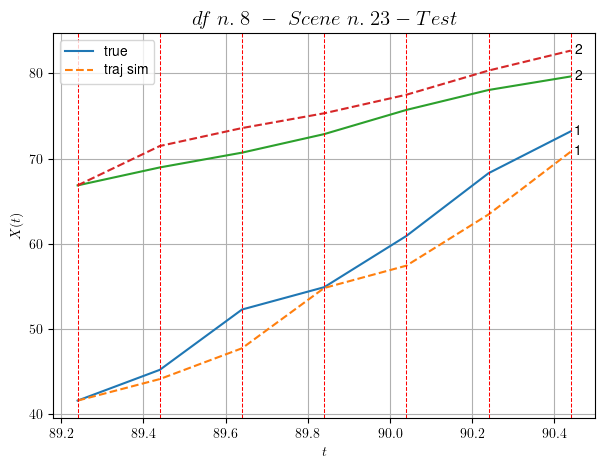

        For scene 23/72:
        * MSE = 7.225622993834617
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/72


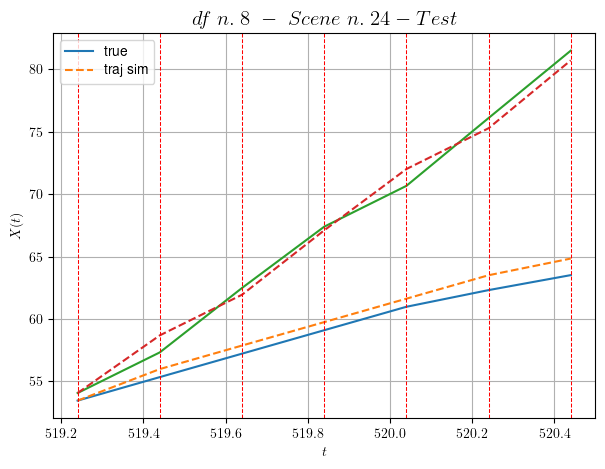

        For scene 24/72:
        * MSE = 0.7274204612010788
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/72


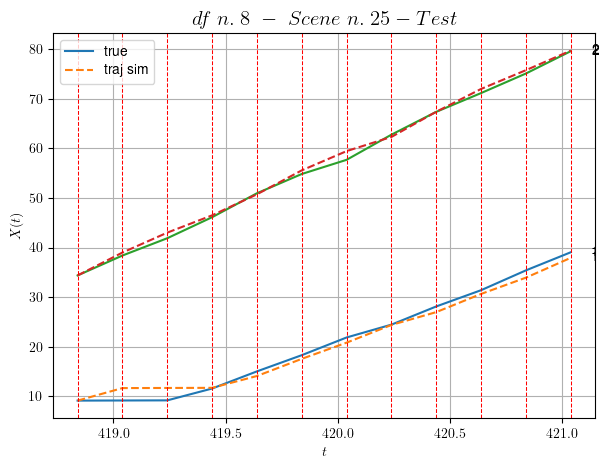

        For scene 25/72:
        * MSE = 1.1322668925376005
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/72


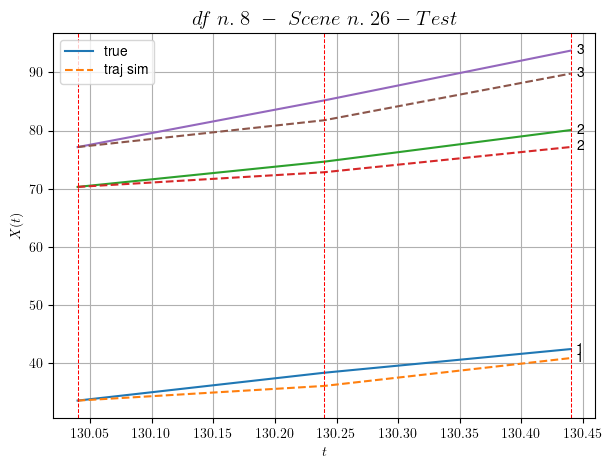

        For scene 26/72:
        * MSE = 5.184698104986499
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/72


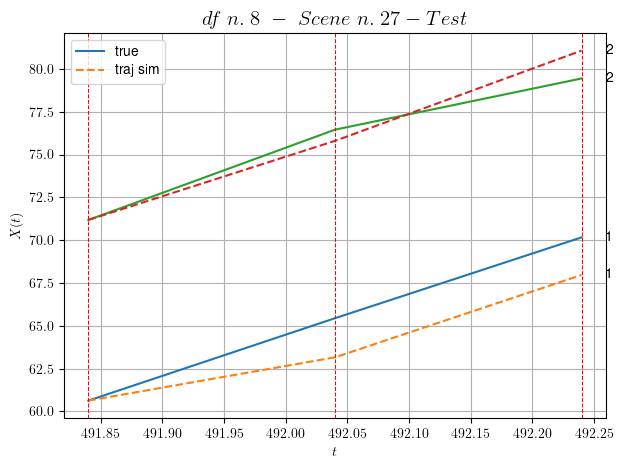

        For scene 27/72:
        * MSE = 2.1837122623047813
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.28/72


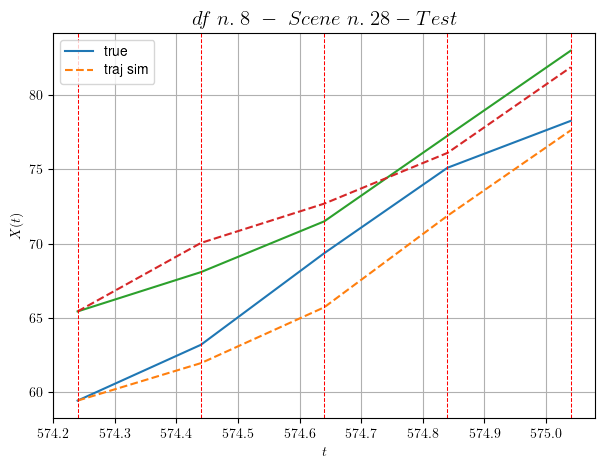

        For scene 28/72:
        * MSE = 3.361401074025686
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.29/72


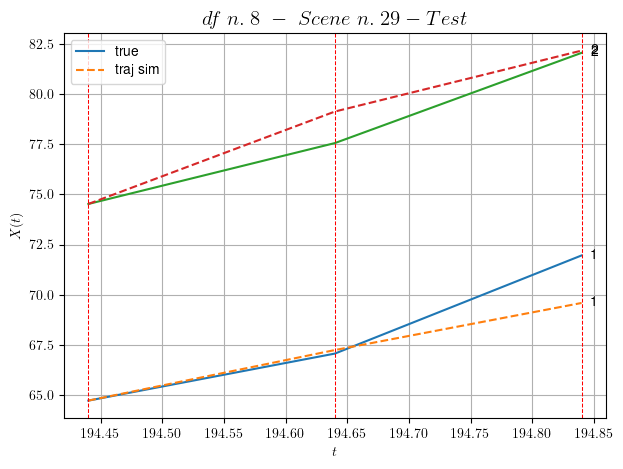

        For scene 29/72:
        * MSE = 1.3598730294574954
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.30/72


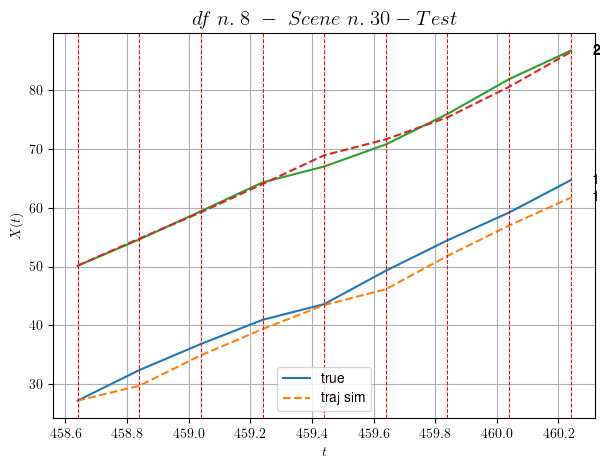

        For scene 30/72:
        * MSE = 2.8173857645274865
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.31/72


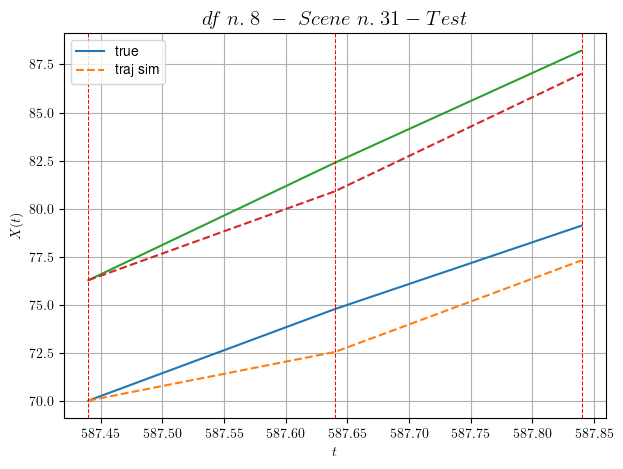

        For scene 31/72:
        * MSE = 1.9779740916216841
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.32/72


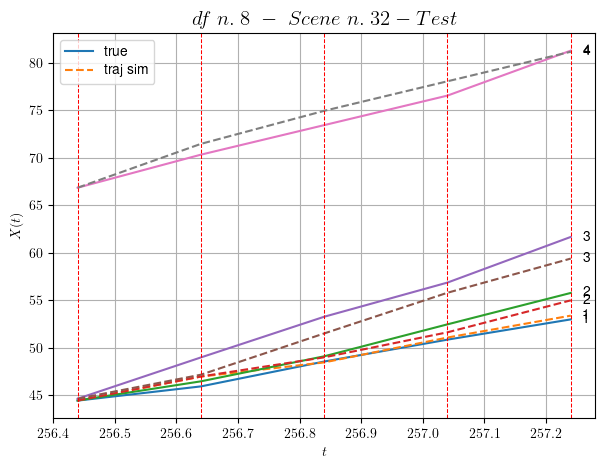

        For scene 32/72:
        * MSE = 1.072667941178433
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.33/72


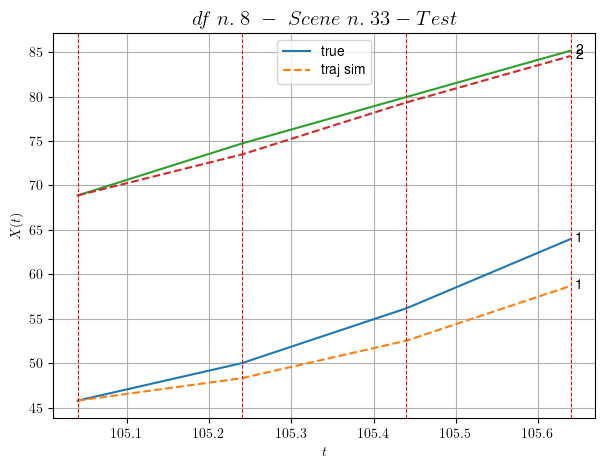

        For scene 33/72:
        * MSE = 5.779686726057899
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.34/72


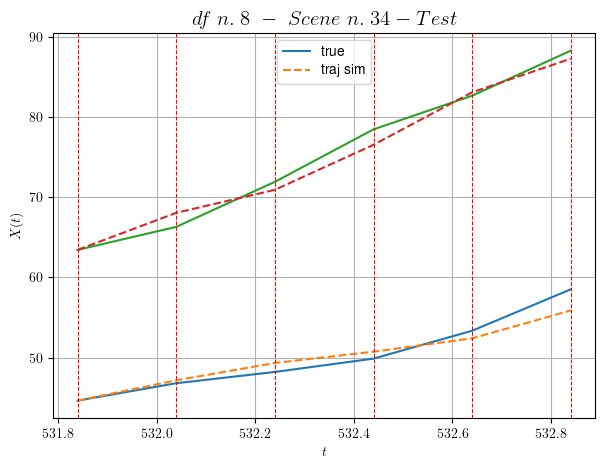

        For scene 34/72:
        * MSE = 1.5756223419139204
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.35/72


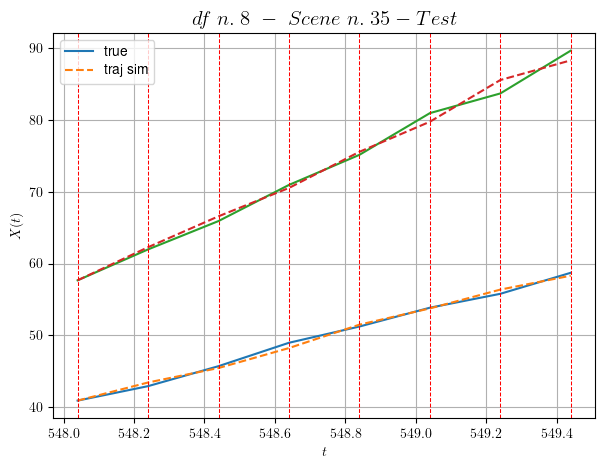

        For scene 35/72:
        * MSE = 0.5699443624944998
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.36/72


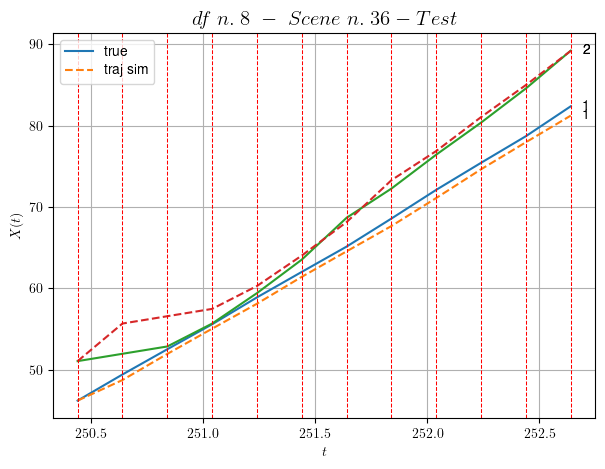

        For scene 36/72:
        * MSE = 1.7019699275345654
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.37/72


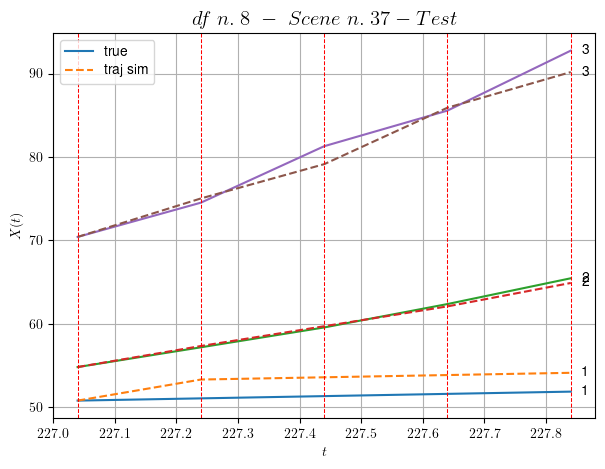

        For scene 37/72:
        * MSE = 2.164238927530195
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.38/72


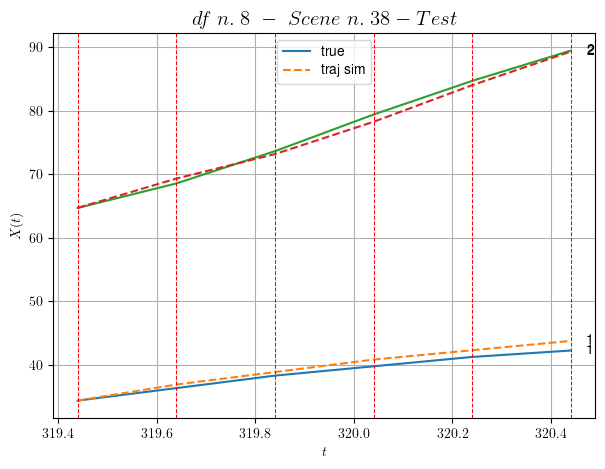

        For scene 38/72:
        * MSE = 0.6467417447464141
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.39/72


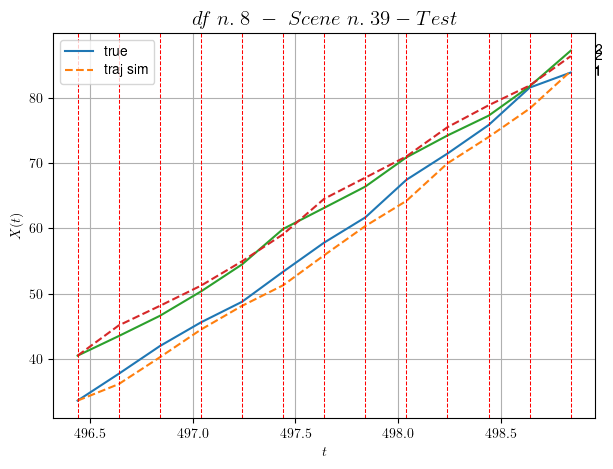

        For scene 39/72:
        * MSE = 2.2468727169409903
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.40/72


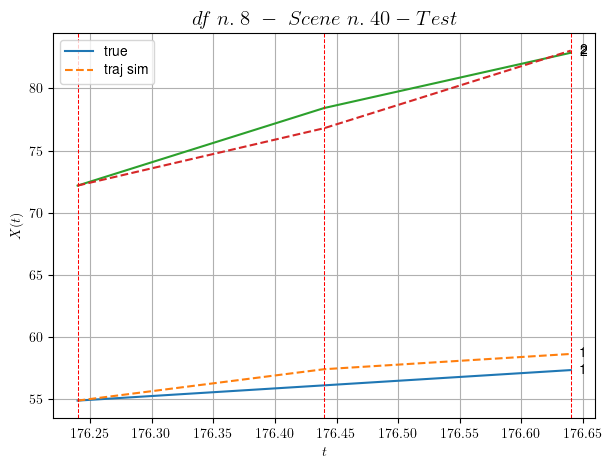

        For scene 40/72:
        * MSE = 1.0062750521506765
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.41/72


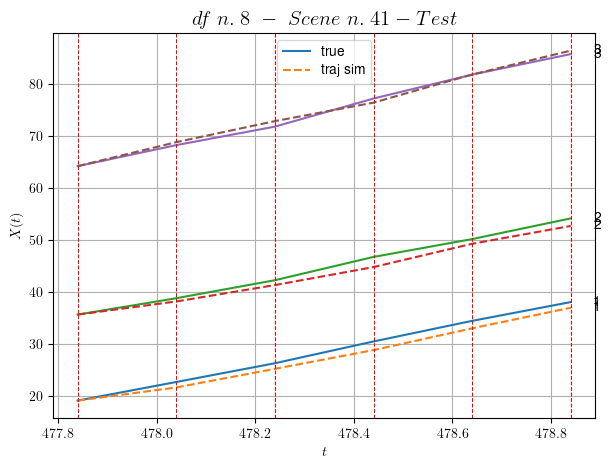

        For scene 41/72:
        * MSE = 1.0444134416715787
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.42/72


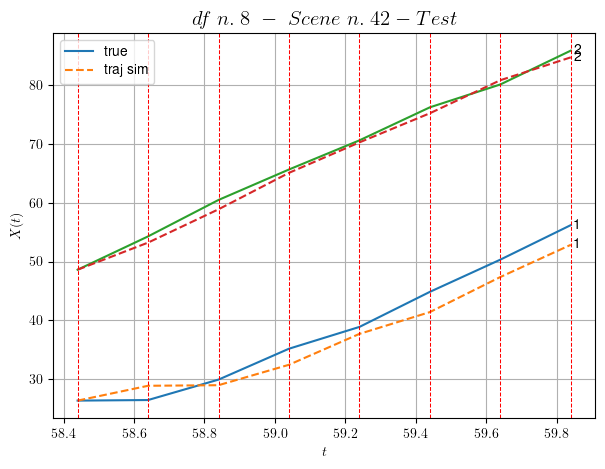

        For scene 42/72:
        * MSE = 3.4086962084645145
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.43/72


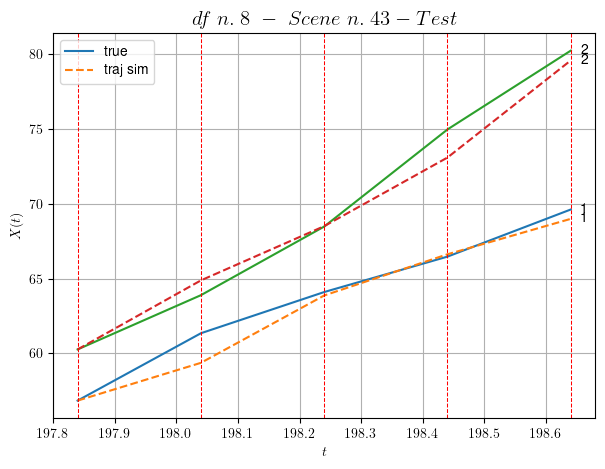

        For scene 43/72:
        * MSE = 0.932895511655911
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.44/72


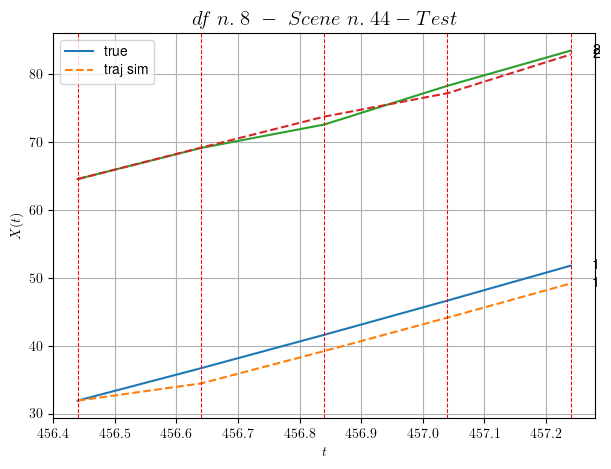

        For scene 44/72:
        * MSE = 2.6851304735132175
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.45/72


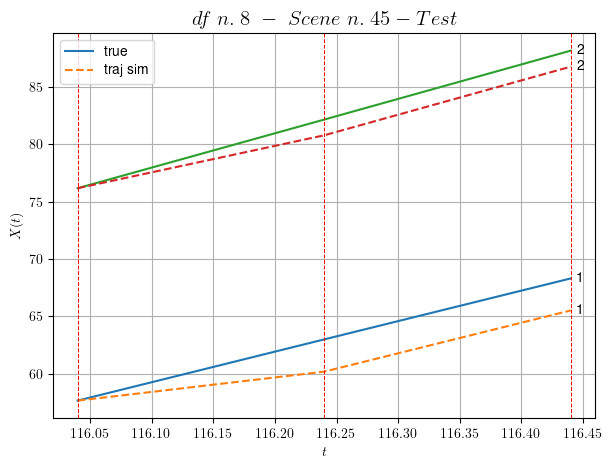

        For scene 45/72:
        * MSE = 3.26065099958356
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.46/72


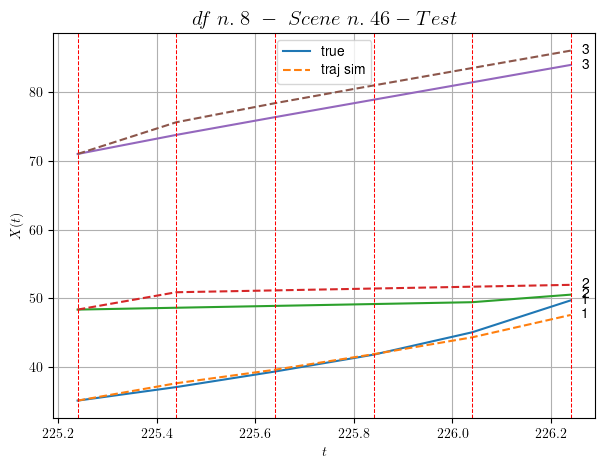

        For scene 46/72:
        * MSE = 2.687641036385782
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.47/72


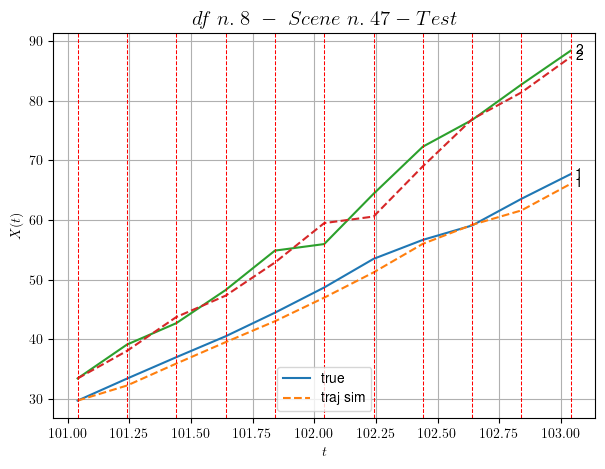

        For scene 47/72:
        * MSE = 3.1022969912344696
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.48/72


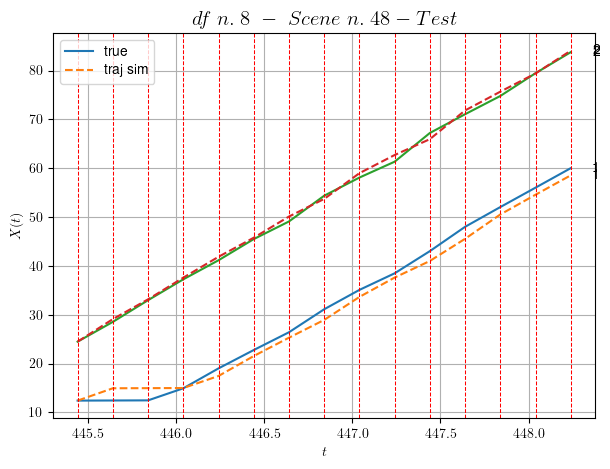

        For scene 48/72:
        * MSE = 1.6727248687023368
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.49/72


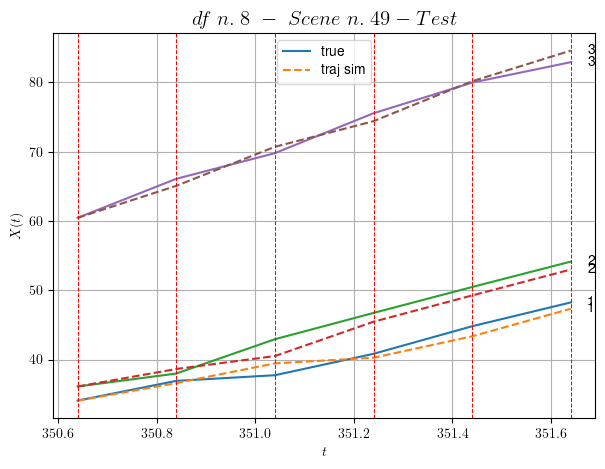

        For scene 49/72:
        * MSE = 1.2788156876426406
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.50/72


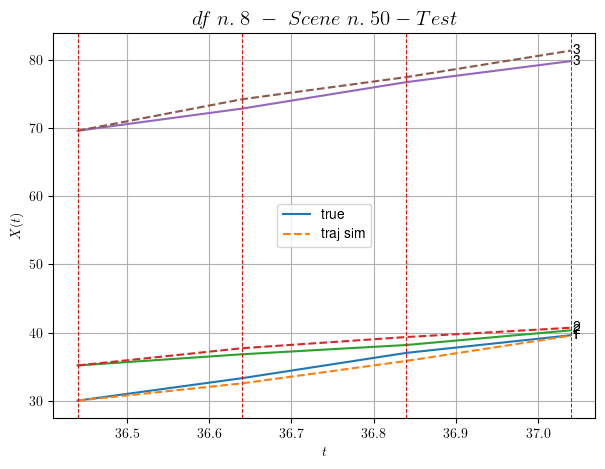

        For scene 50/72:
        * MSE = 0.7541810135538117
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.51/72


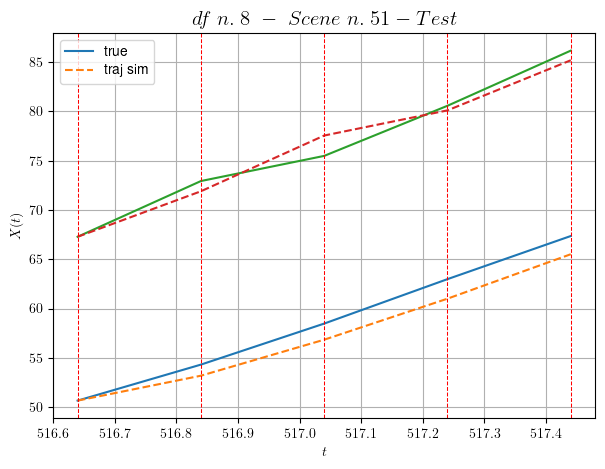

        For scene 51/72:
        * MSE = 1.7798582521932385
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.52/72


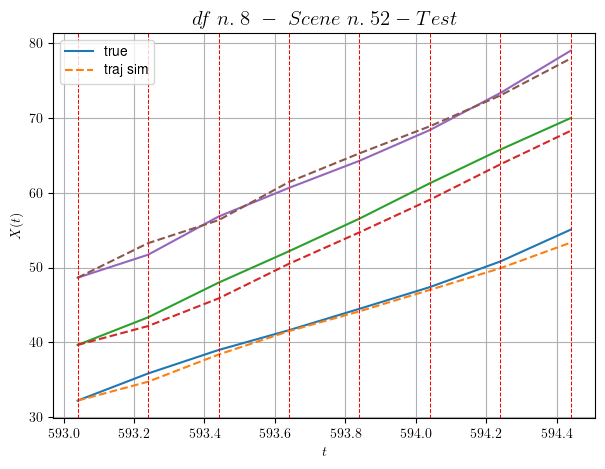

        For scene 52/72:
        * MSE = 1.4549290725548767
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.53/72


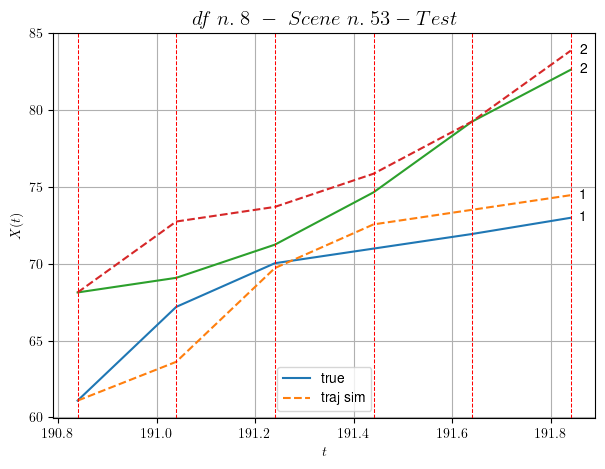

        For scene 53/72:
        * MSE = 3.5418522136490562
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.54/72


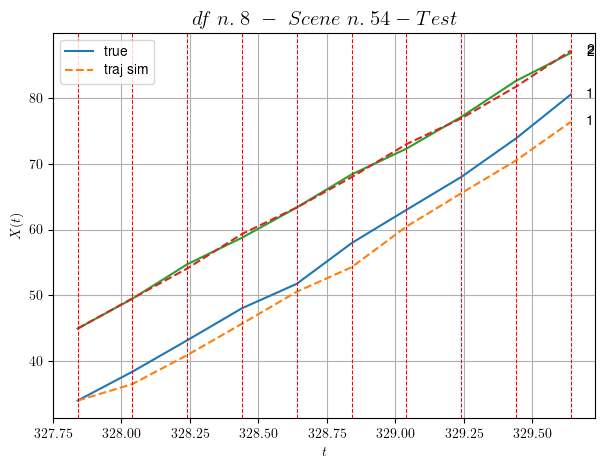

        For scene 54/72:
        * MSE = 3.6494615964095445
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.55/72


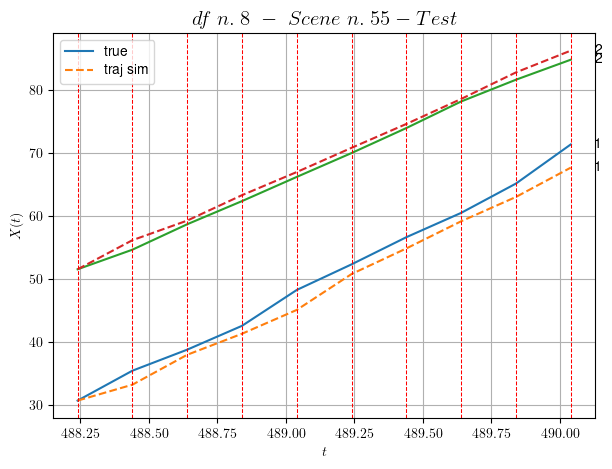

        For scene 55/72:
        * MSE = 2.571316113567953
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.56/72


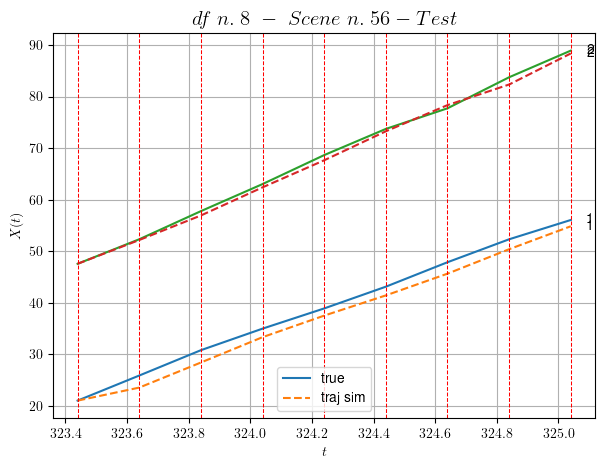

        For scene 56/72:
        * MSE = 1.8824623488824033
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.57/72


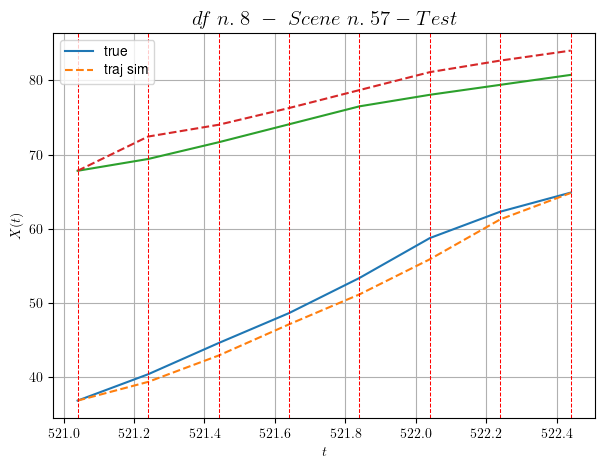

        For scene 57/72:
        * MSE = 4.717584017892074
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.58/72


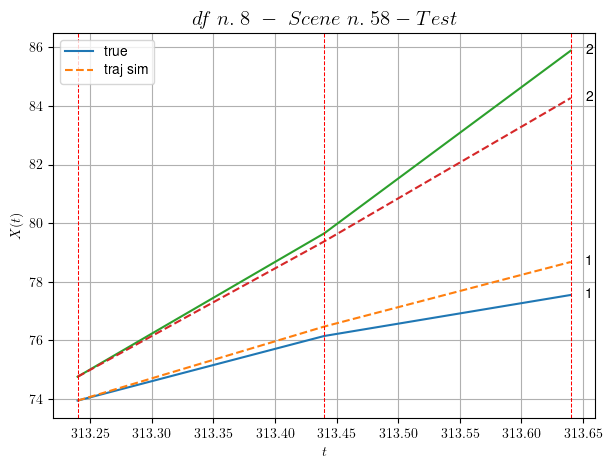

        For scene 58/72:
        * MSE = 0.6774919853191856
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.59/72


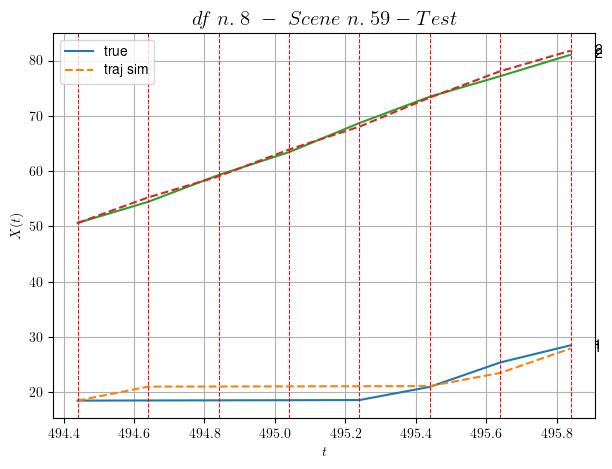

        For scene 59/72:
        * MSE = 1.9797378477854788
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.60/72


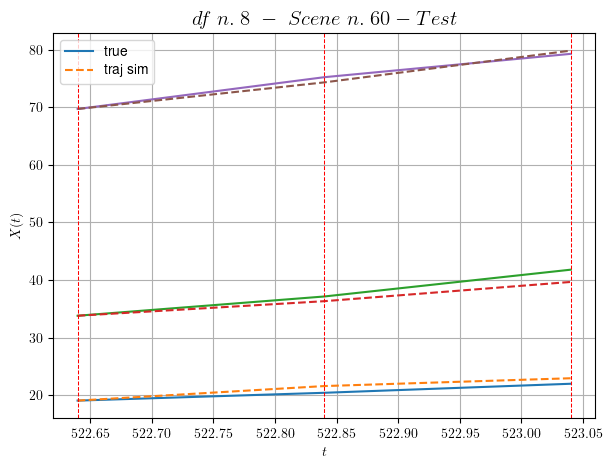

        For scene 60/72:
        * MSE = 0.9566628163799717
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.61/72


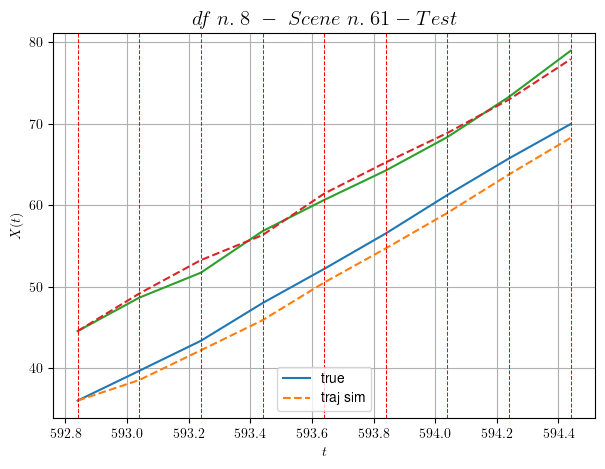

        For scene 61/72:
        * MSE = 1.7112329605458596
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.62/72


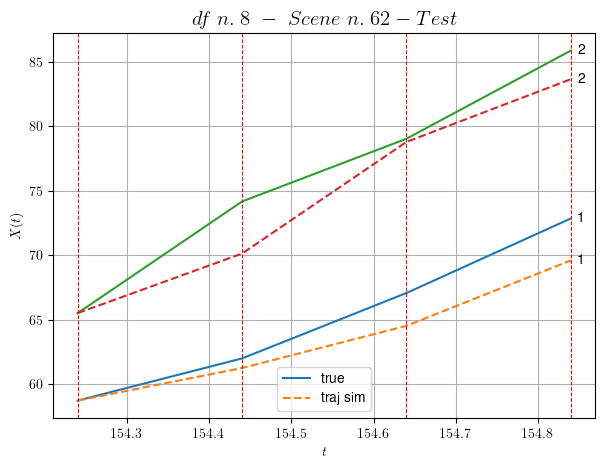

        For scene 62/72:
        * MSE = 4.861919324629108
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.63/72


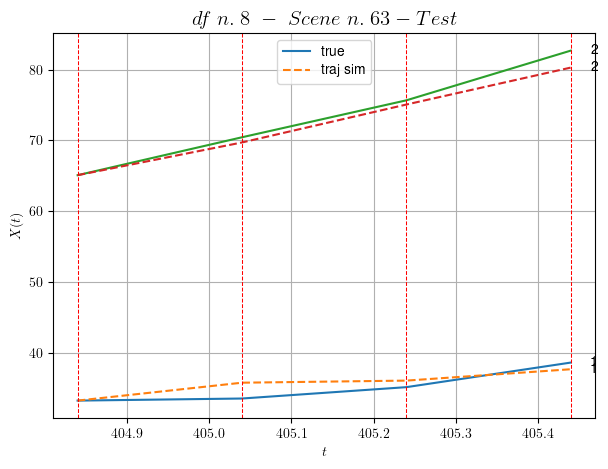

        For scene 63/72:
        * MSE = 1.6667557671658733
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.64/72


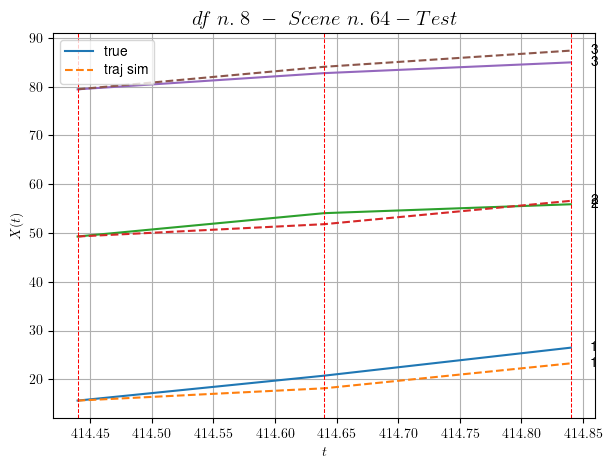

        For scene 64/72:
        * MSE = 3.349528936721228
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.65/72


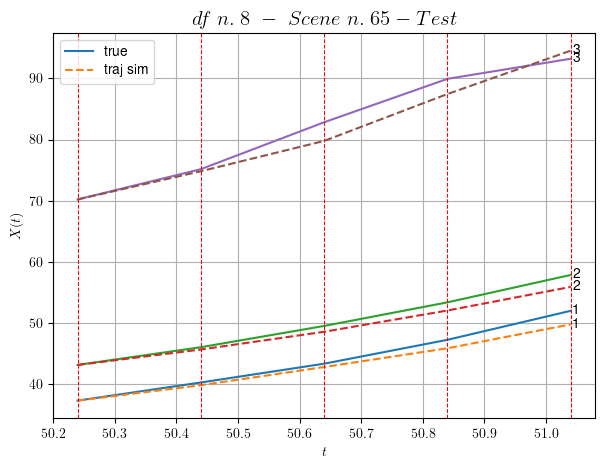

        For scene 65/72:
        * MSE = 2.0870438347300664
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.66/72


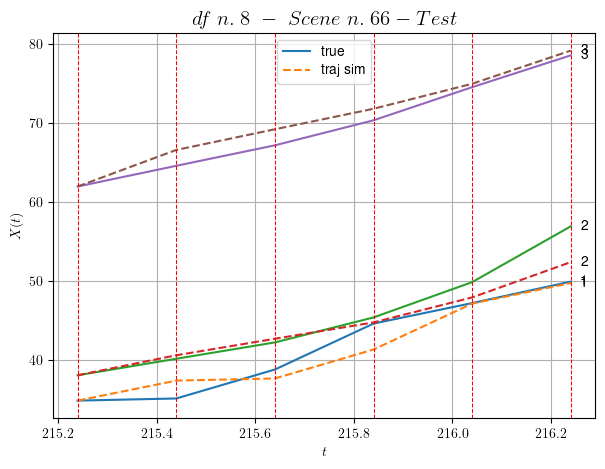

        For scene 66/72:
        * MSE = 2.942008779627159
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.67/72


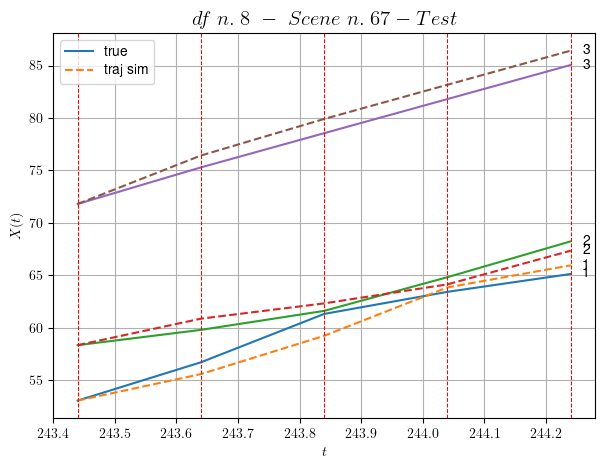

        For scene 67/72:
        * MSE = 1.081671184445477
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.68/72


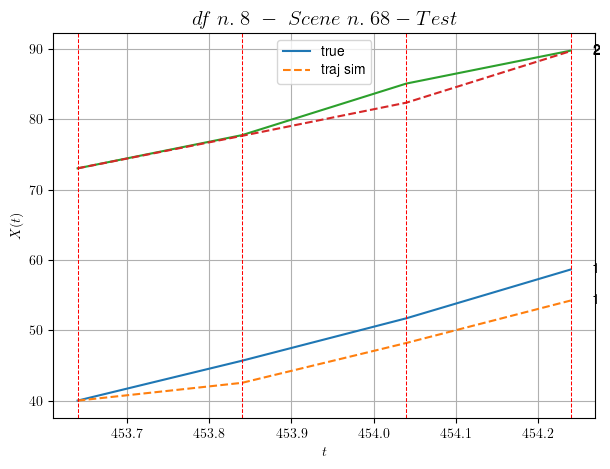

        For scene 68/72:
        * MSE = 6.1250854804506165
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.69/72


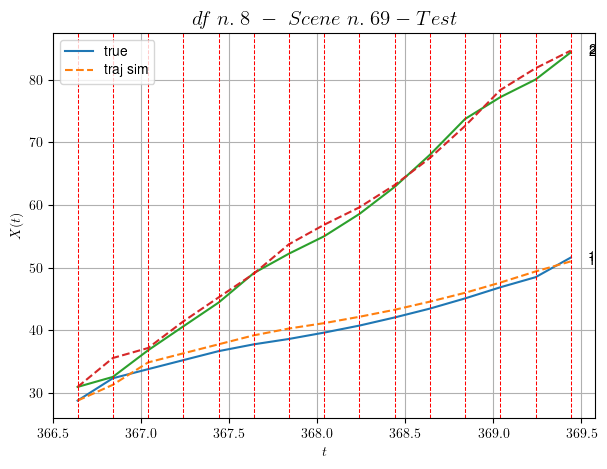

        For scene 69/72:
        * MSE = 1.4193280064212548
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.70/72


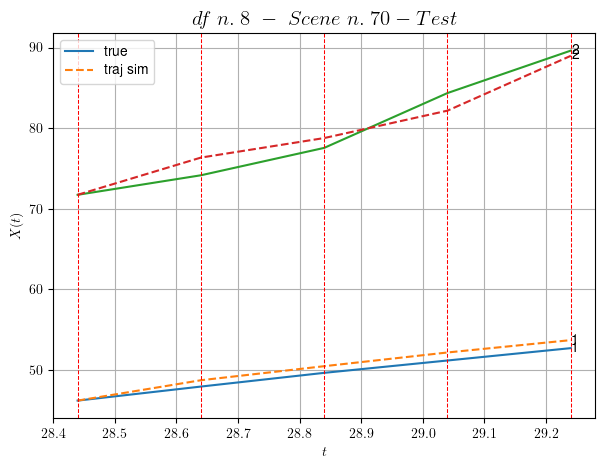

        For scene 70/72:
        * MSE = 1.4763400230844383
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.71/72


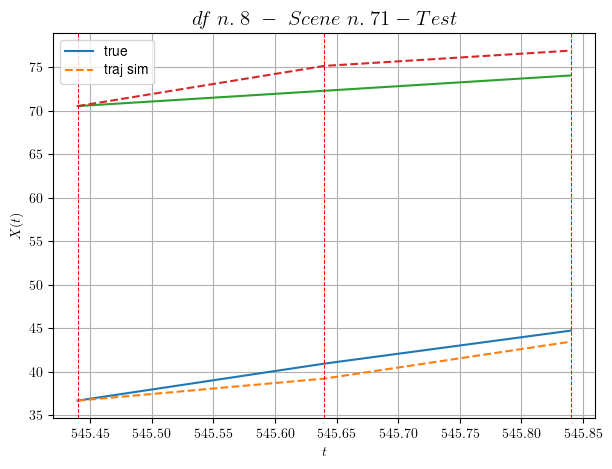

        For scene 71/72:
        * MSE = 3.4833597795779
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.72/72


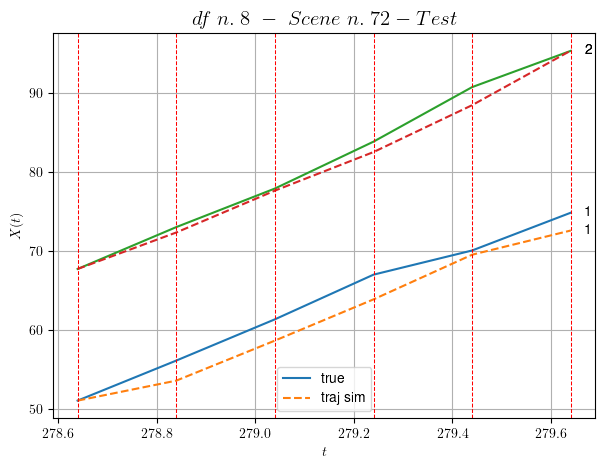

        For scene 72/72:
        * MSE = 3.029361388011476
----------------------------------------------------------------------------------------------------


MSE test: 2.4762580503667544

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.6363145621620767
          * MSE test: 2.4762580503667544
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 9/10 dfs.
In DataFrame n.9 we have 33 scenes.
    To train the model we use 3 scenes, the remaining 30 to test the model.

Training step. (3 scenes)
DataFrame n.9. Scene n.1/3
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [140.00,140.40]


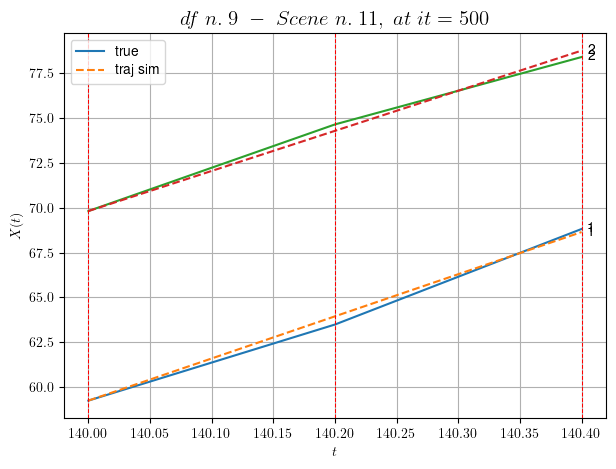

----------------------------------------------------------------------------------------------------
        For scene 1/3:
        * After LR finder: LR_NN=5e-05 with mse=2.1927883770654253 at it=24
        * v0 = 22.36518833641193
        * MSE = 0.08191716996851979
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/3
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [161.60,162.80]


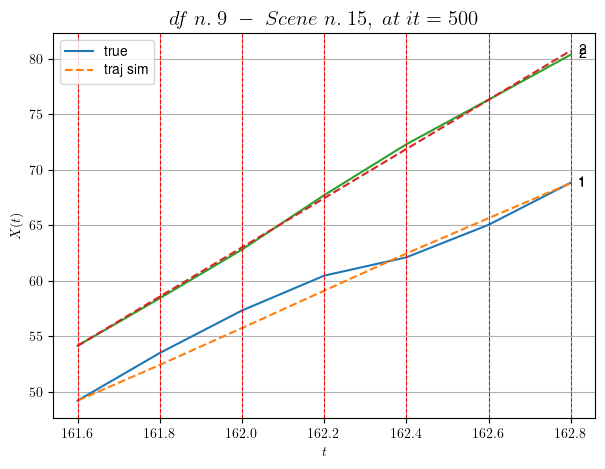

----------------------------------------------------------------------------------------------------
        For scene 2/3:
        * After LR finder: LR_NN=0.005 with mse=16.38144790177547 at it=24
        * v0 = 22.164023913692947
        * MSE = 0.44860290119829394
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/3
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [117.80,118.40]


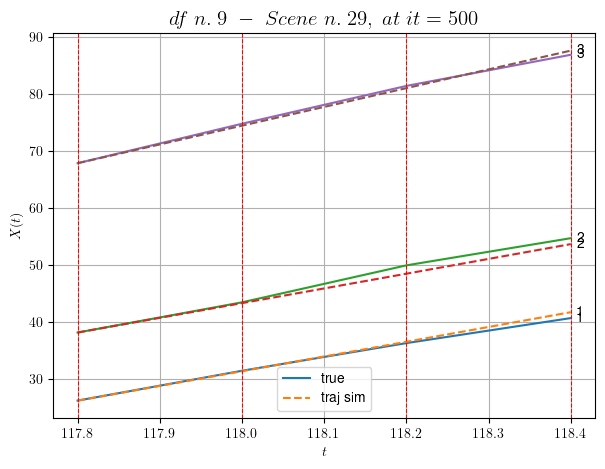

----------------------------------------------------------------------------------------------------
        For scene 3/3:
        * After LR finder: LR_NN=0.001 with mse=0.7509739886480707 at it=24
        * v0 = 32.94782563350139
        * MSE = 0.4291019688003568
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.3198740133223902
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (30 scenes)
DataFrame n.9. Scene n.1/30


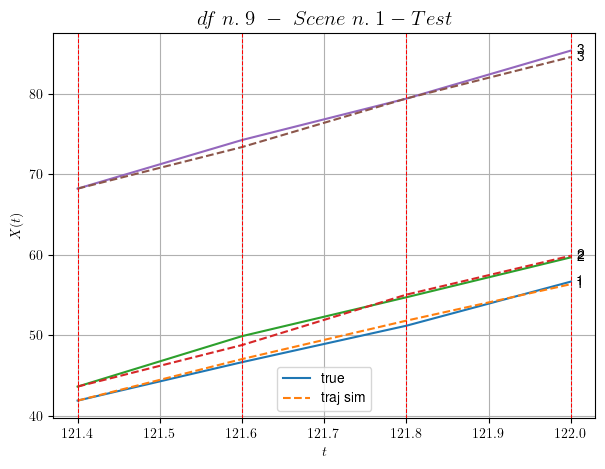

        For scene 1/30:
        * MSE = 0.2856365538154557
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/30


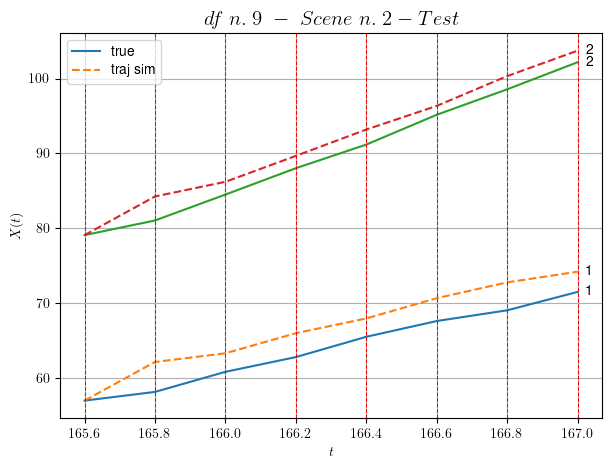

        For scene 2/30:
        * MSE = 5.98142750845623
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/30


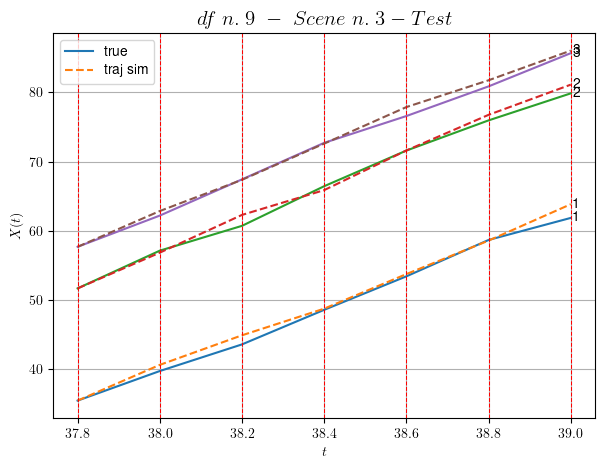

        For scene 3/30:
        * MSE = 0.7011077209624835
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/30


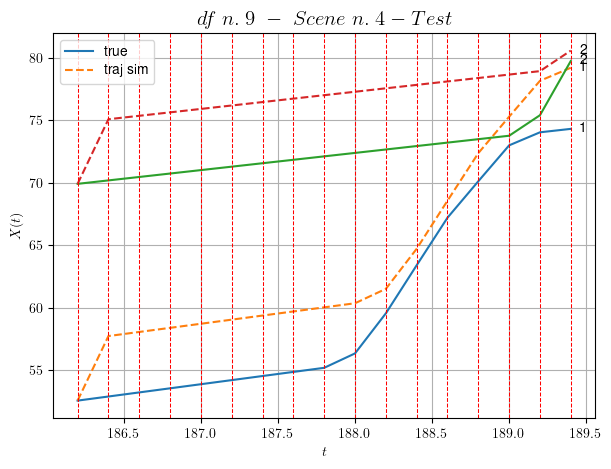

        For scene 4/30:
        * MSE = 17.925725439373853
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/30


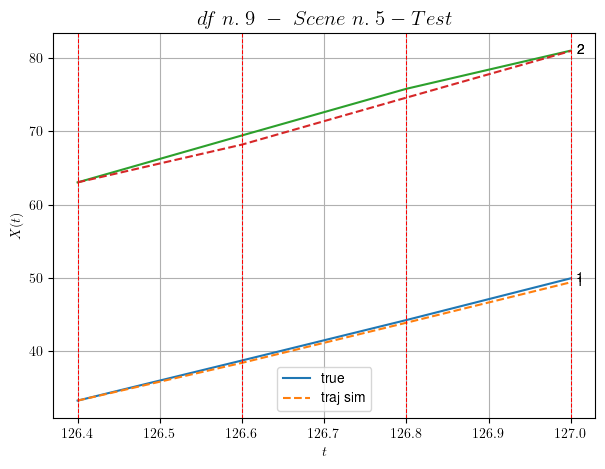

        For scene 5/30:
        * MSE = 0.44489704644052663
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/30


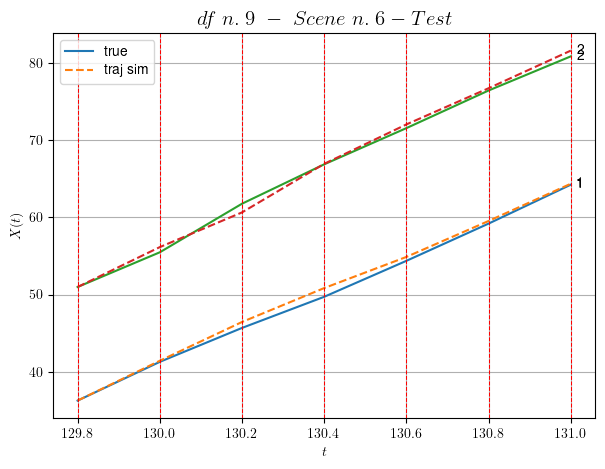

        For scene 6/30:
        * MSE = 0.34723596844394644
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/30


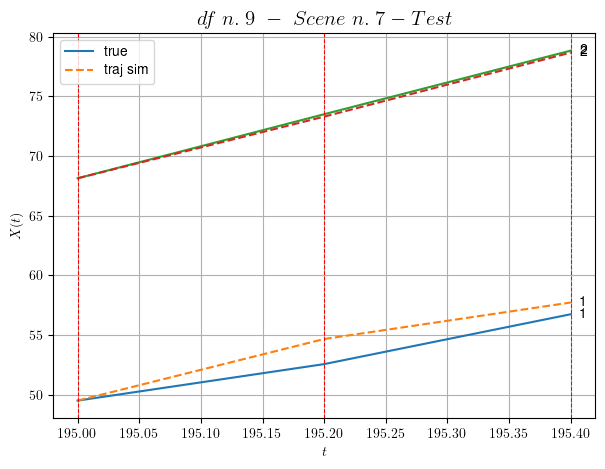

        For scene 7/30:
        * MSE = 0.9089251644554851
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/30


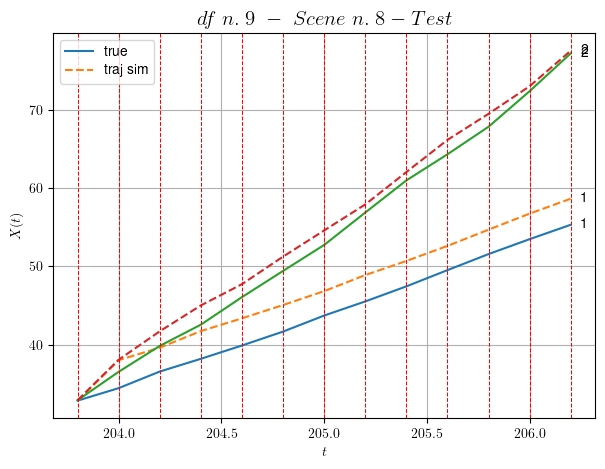

        For scene 8/30:
        * MSE = 6.175279936506406
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/30


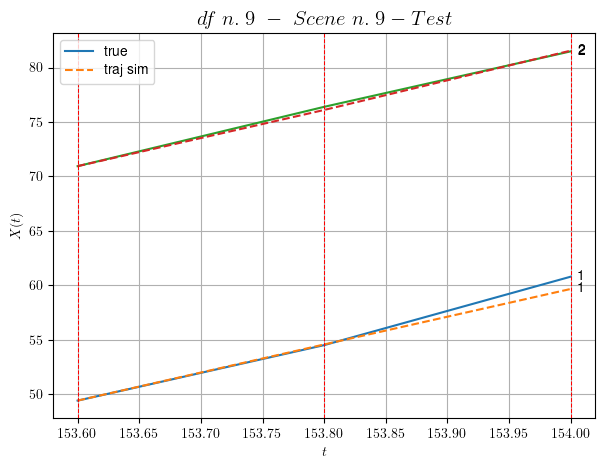

        For scene 9/30:
        * MSE = 0.22769967689696427
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/30


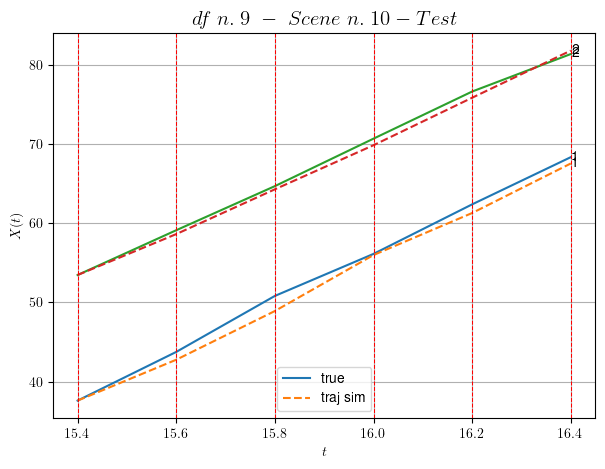

        For scene 10/30:
        * MSE = 0.6943600985004856
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/30


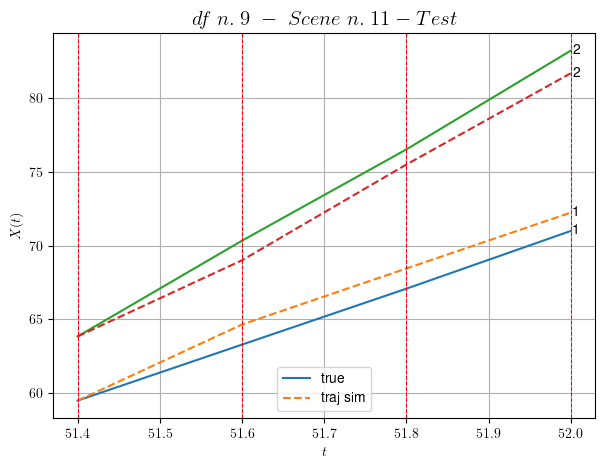

        For scene 11/30:
        * MSE = 1.3064303361569323
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.12/30


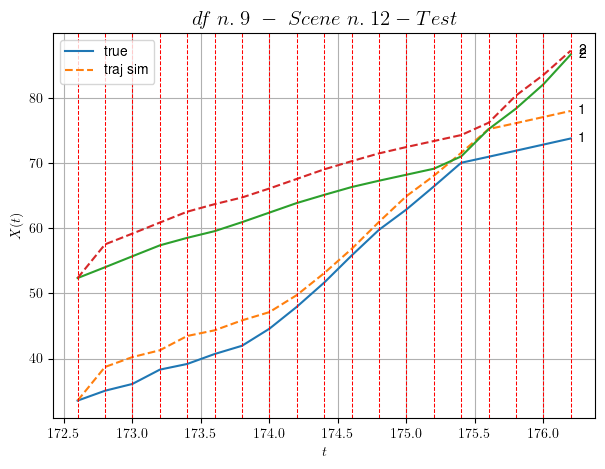

        For scene 12/30:
        * MSE = 10.402693296551472
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.13/30


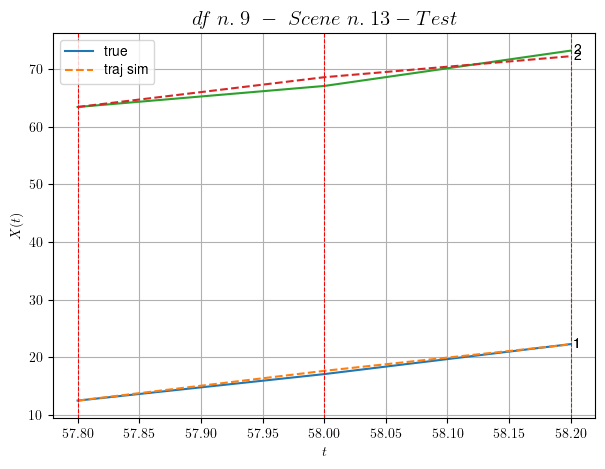

        For scene 13/30:
        * MSE = 0.5934521402234559
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.14/30


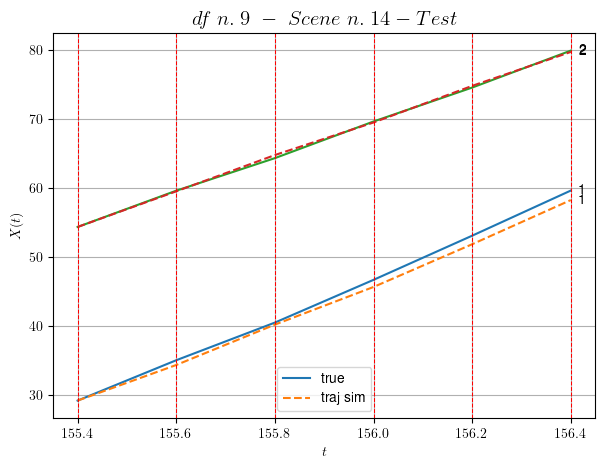

        For scene 14/30:
        * MSE = 0.44914654824046096
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.15/30


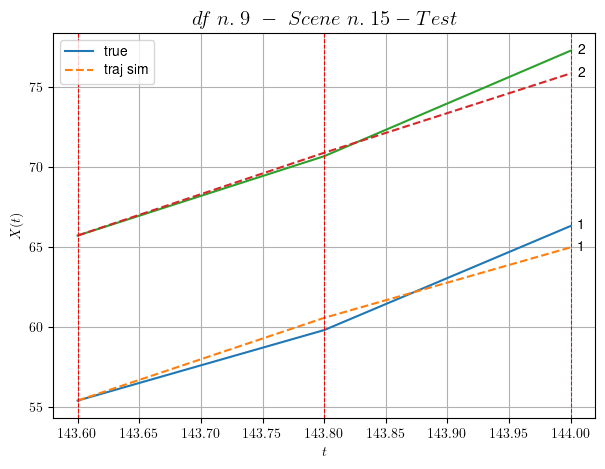

        For scene 15/30:
        * MSE = 0.7365894983157049
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.16/30


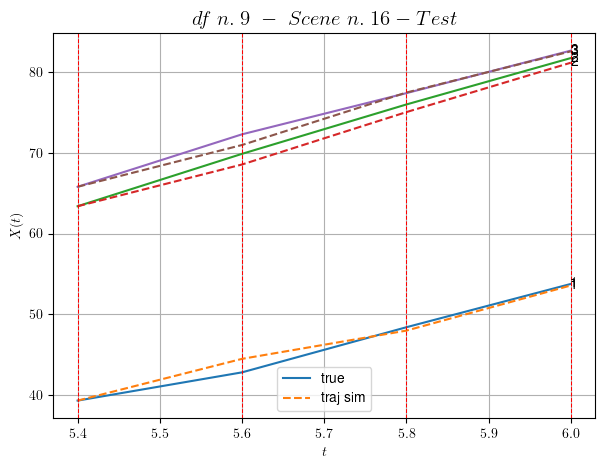

        For scene 16/30:
        * MSE = 0.6424153768444429
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.17/30


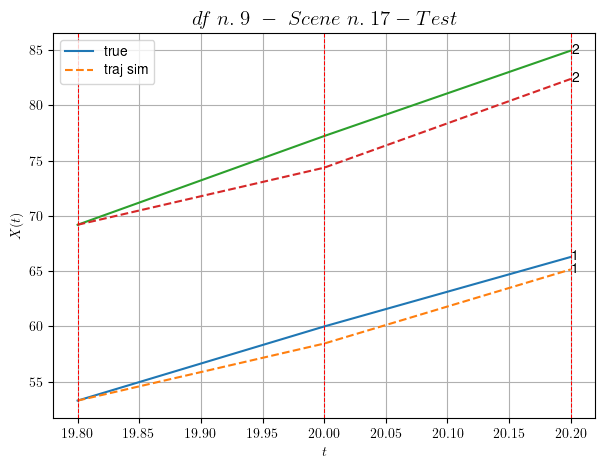

        For scene 17/30:
        * MSE = 3.0734465358918244
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.18/30


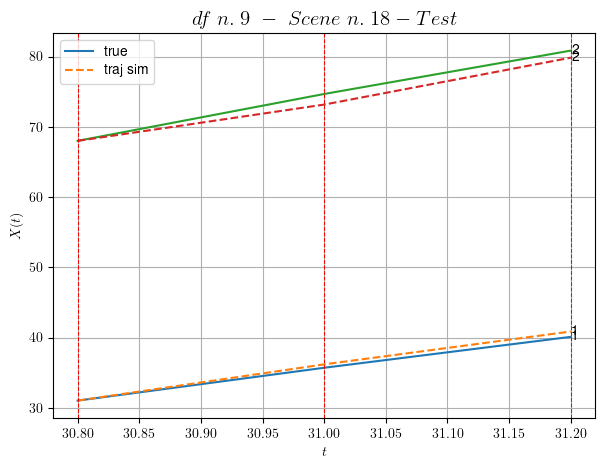

        For scene 18/30:
        * MSE = 0.6850091180389042
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.19/30


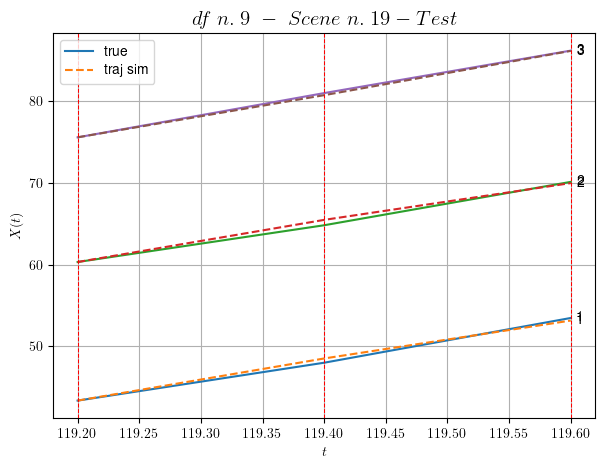

        For scene 19/30:
        * MSE = 0.09913695495755569
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.20/30


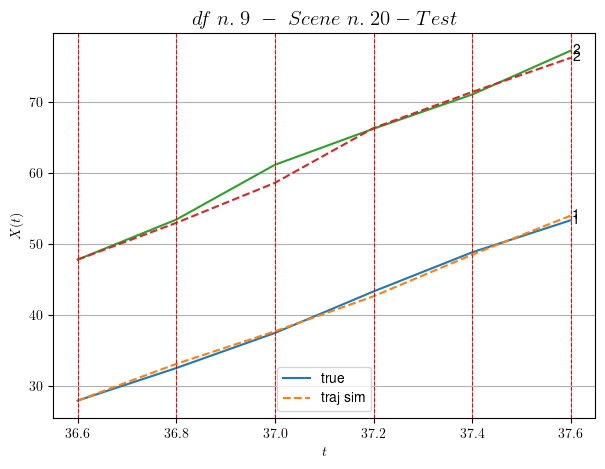

        For scene 20/30:
        * MSE = 0.7667986211246558
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.21/30


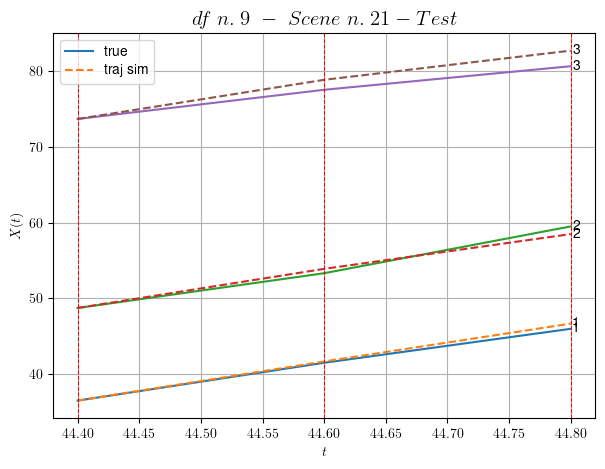

        For scene 21/30:
        * MSE = 0.8665017657430497
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.22/30


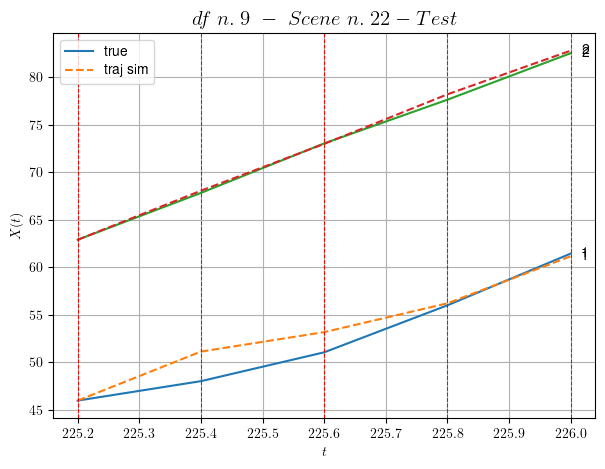

        For scene 22/30:
        * MSE = 1.4780415297289324
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.23/30


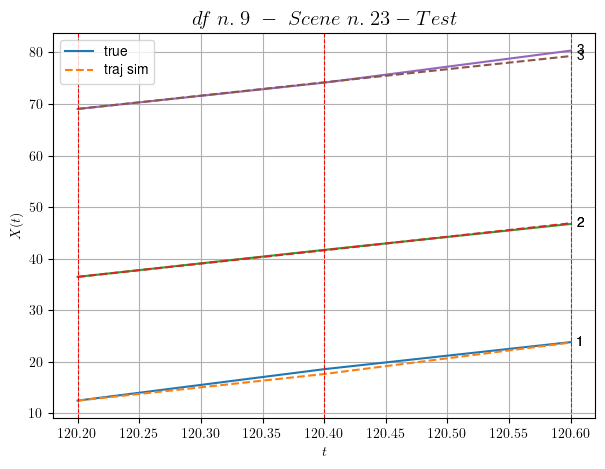

        For scene 23/30:
        * MSE = 0.22467642817703593
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.24/30


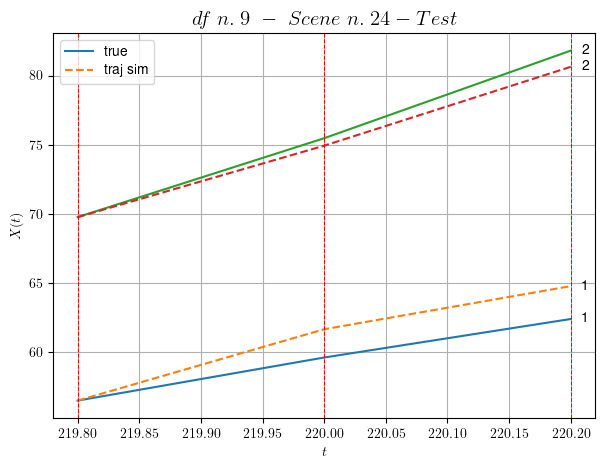

        For scene 24/30:
        * MSE = 1.9143644967309053
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.25/30


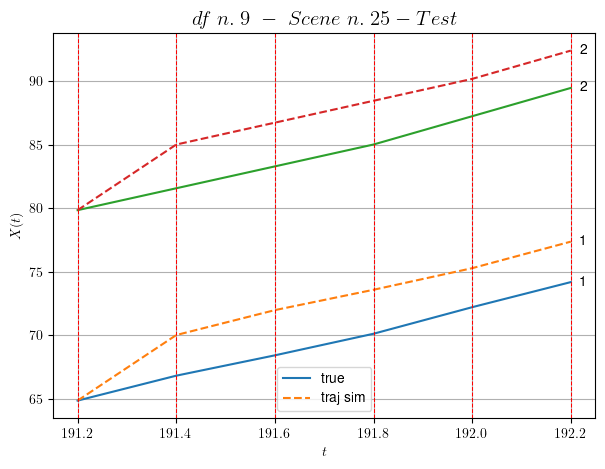

        For scene 25/30:
        * MSE = 8.940863298282984
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.26/30


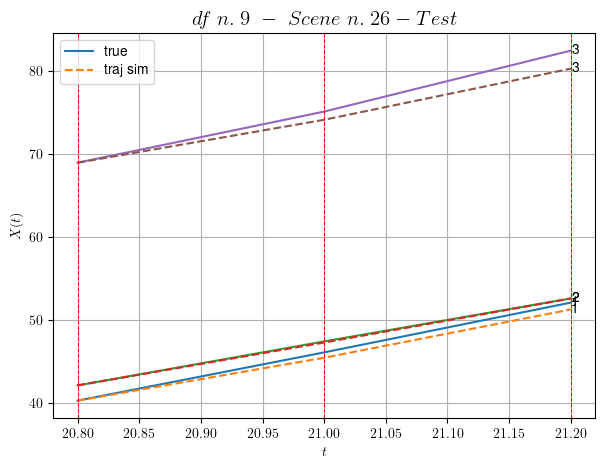

        For scene 26/30:
        * MSE = 0.7554433673328064
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.27/30


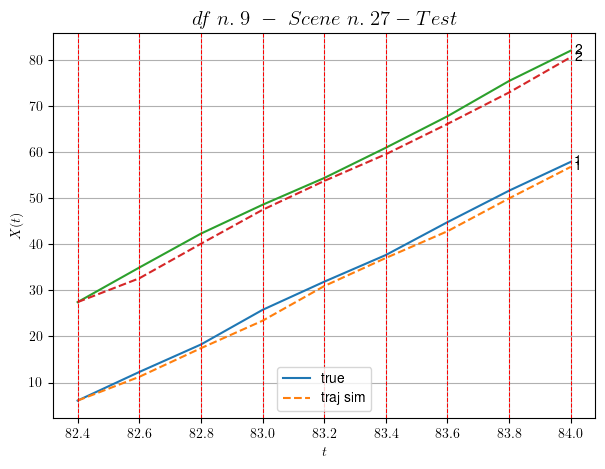

        For scene 27/30:
        * MSE = 2.30391668871538
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.28/30


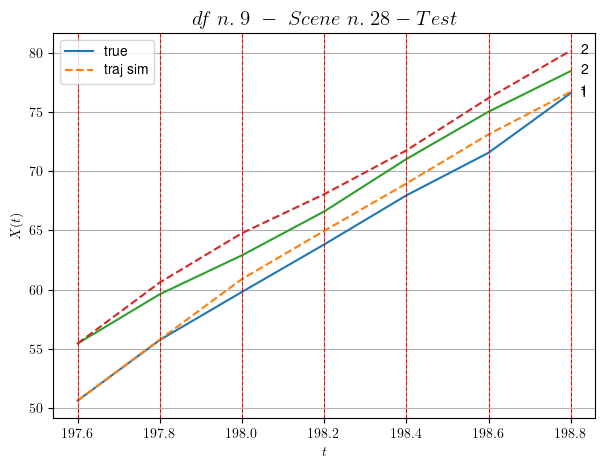

        For scene 28/30:
        * MSE = 1.243460278234306
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.29/30


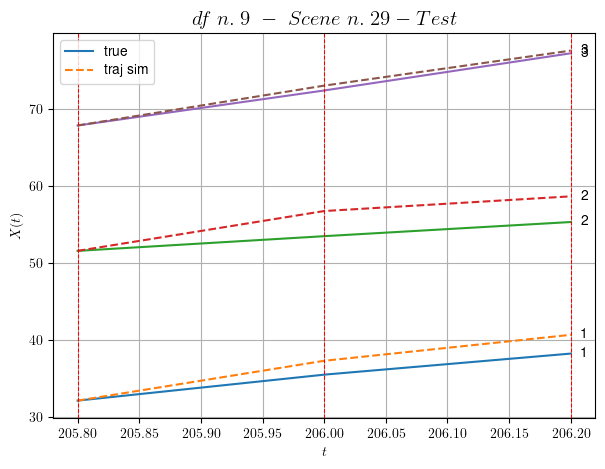

        For scene 29/30:
        * MSE = 3.480745762680929
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.30/30


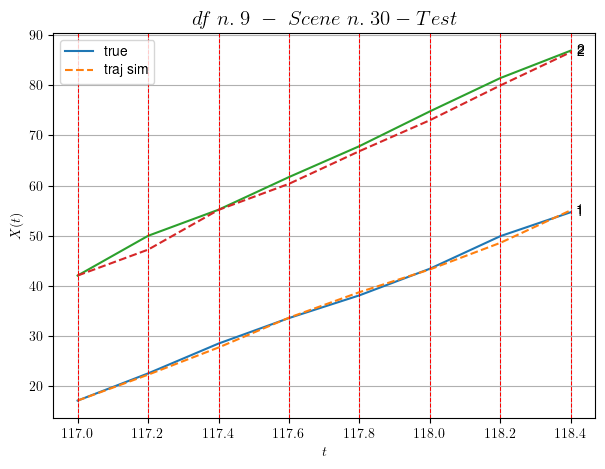

        For scene 30/30:
        * MSE = 1.17636576461966
----------------------------------------------------------------------------------------------------


MSE test: 2.494393097348108

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.3198740133223902
          * MSE test: 2.494393097348108
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 10/10 dfs.
In DataFrame n.10 we have 74 scenes.
    To train the model we use 7 scenes, the remaining 67 to test the model.

Training step. (7 scenes)
DataFrame n.10. Scene n.1/7
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [34.92,36.32]


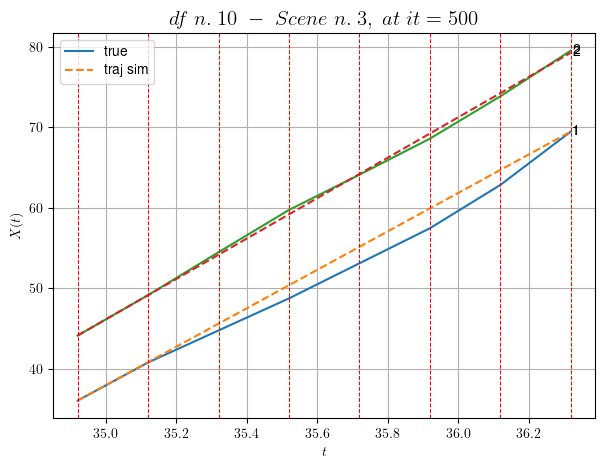

----------------------------------------------------------------------------------------------------
        For scene 1/7:
        * After LR finder: LR_NN=0.0001 with mse=9.357206025378803 at it=24
        * v0 = 25.102289962227598
        * MSE = 1.134933039107855
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [235.52,235.92]


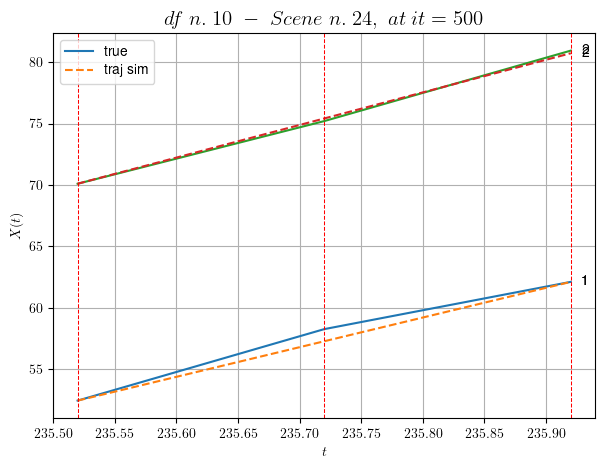

----------------------------------------------------------------------------------------------------
        For scene 2/7:
        * After LR finder: LR_NN=5e-05 with mse=0.5545491529052956 at it=24
        * v0 = 26.569531373914
        * MSE = 0.17781673742190351
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/7
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [209.32,210.52]


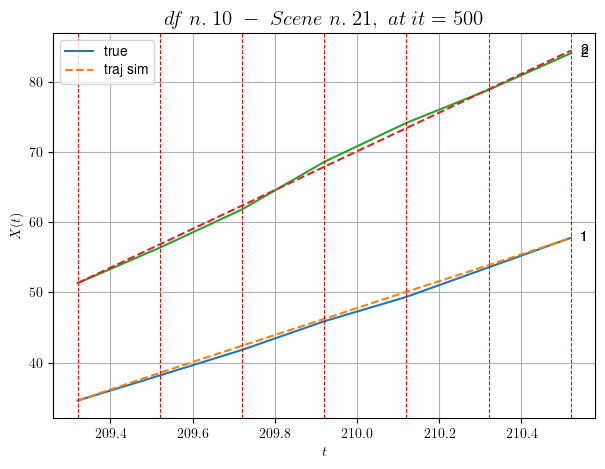

----------------------------------------------------------------------------------------------------
        For scene 3/7:
        * After LR finder: LR_NN=0.01 with mse=1.6532410703726539 at it=24
        * v0 = 27.594562747146146
        * MSE = 0.21242418831058263
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [237.72,238.12]


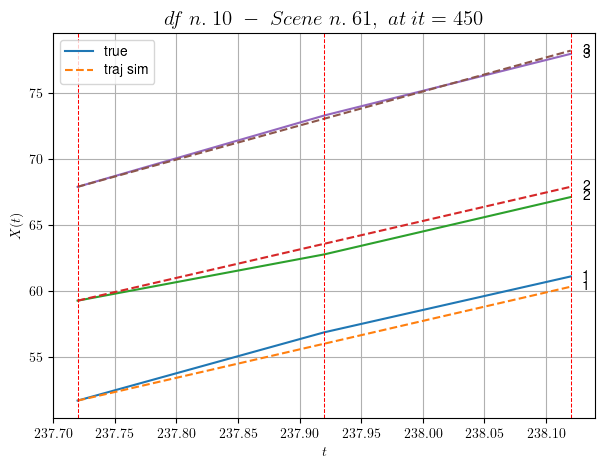

----------------------------------------------------------------------------------------------------
        For scene 4/7:
        * After LR finder: LR_NN=0.005 with mse=0.7334481496390156 at it=24
        * v0 = 25.832593273218322
        * MSE = 0.3032048568477639
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/7
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [202.52,203.12]


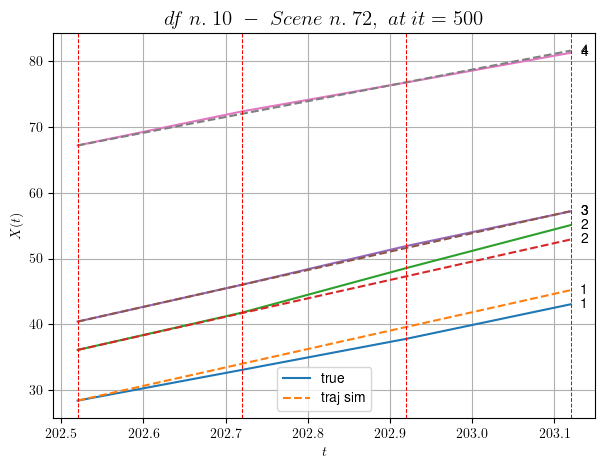

----------------------------------------------------------------------------------------------------
        For scene 5/7:
        * After LR finder: LR_NN=0.0005 with mse=2.354876997443942 at it=24
        * v0 = 24.014144704149288
        * MSE = 0.9628062880576278
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/7
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [118.92,119.32]


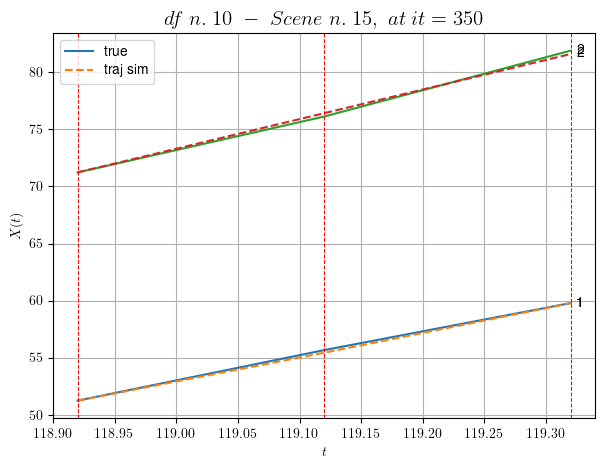

----------------------------------------------------------------------------------------------------
        For scene 6/7:
        * After LR finder: LR_NN=0.01 with mse=0.5031106554460706 at it=24
        * v0 = 25.969534482224752
        * MSE = 0.03702606470720854
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/7
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [578.92,580.52]


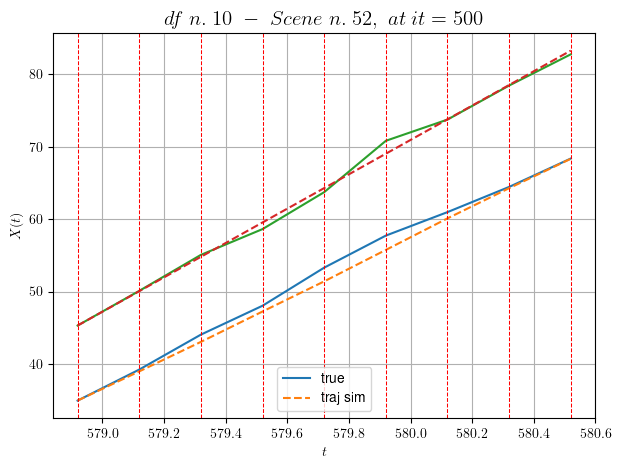

----------------------------------------------------------------------------------------------------
        For scene 7/7:
        * After LR finder: LR_NN=0.01 with mse=18.460476535992925 at it=24
        * v0 = 23.72801795429894
        * MSE = 0.6637576527205805
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.4988526895962174
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (67 scenes)
DataFrame n.10. Scene n.1/67


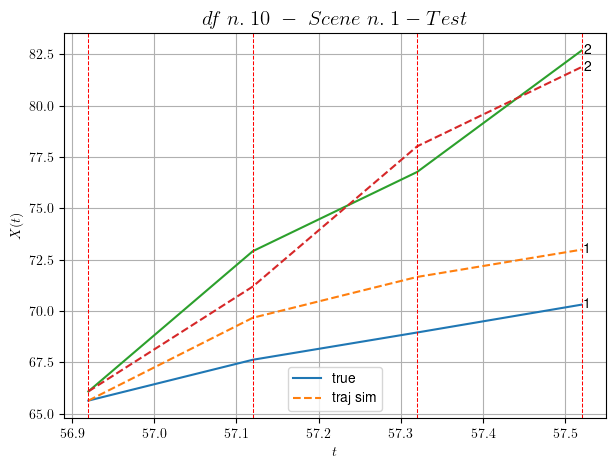

        For scene 1/67:
        * MSE = 2.981713812613438
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/67


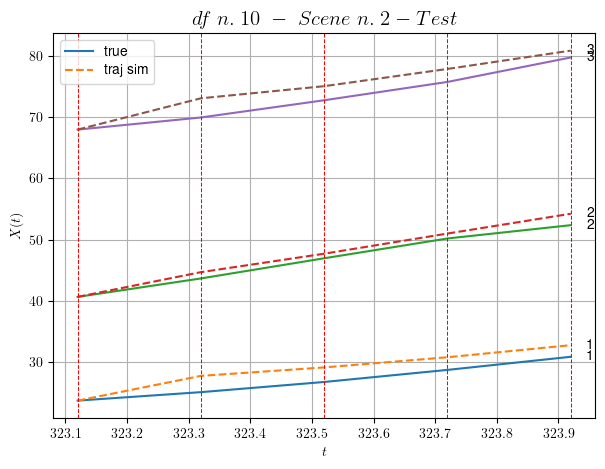

        For scene 2/67:
        * MSE = 3.1391041468937515
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/67


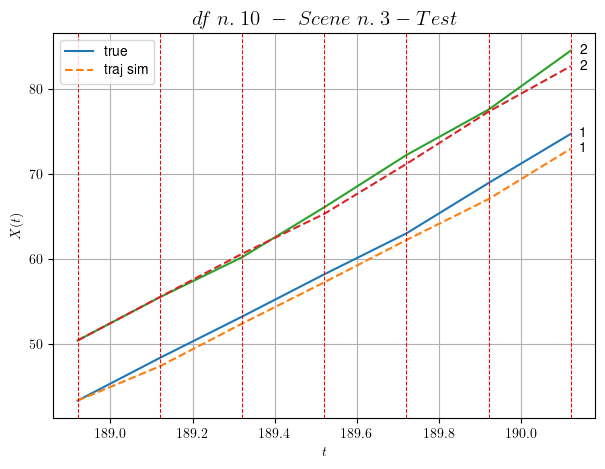

        For scene 3/67:
        * MSE = 1.0760703657725514
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/67


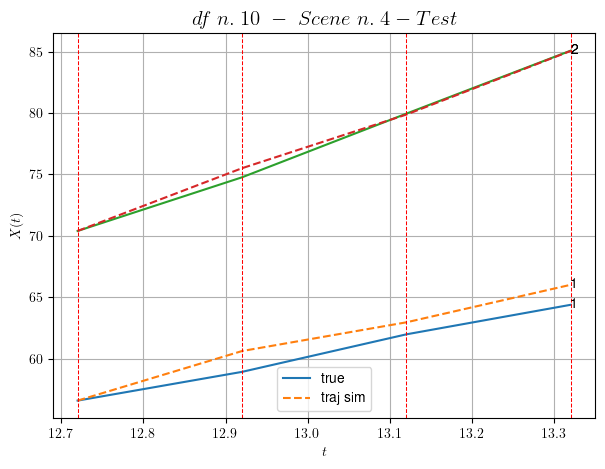

        For scene 4/67:
        * MSE = 0.8797437609230636
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/67


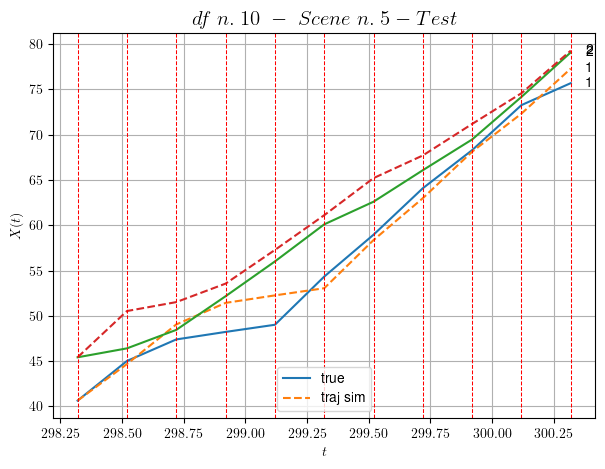

        For scene 5/67:
        * MSE = 3.3604556246070727
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/67


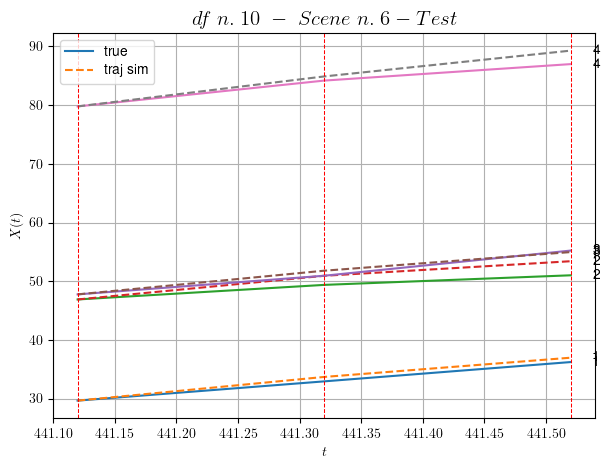

        For scene 6/67:
        * MSE = 1.3221584820940655
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/67


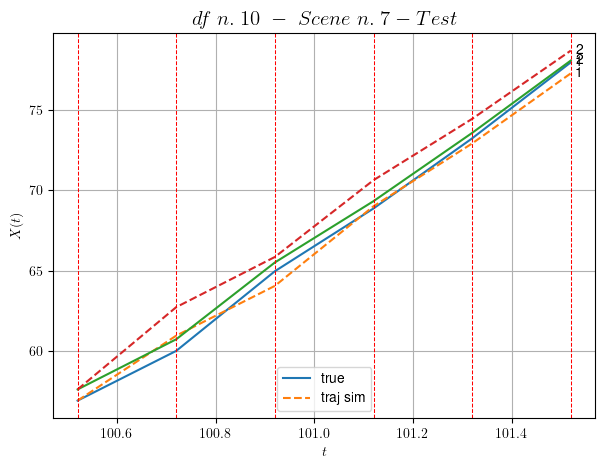

        For scene 7/67:
        * MSE = 0.7700721584623419
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/67


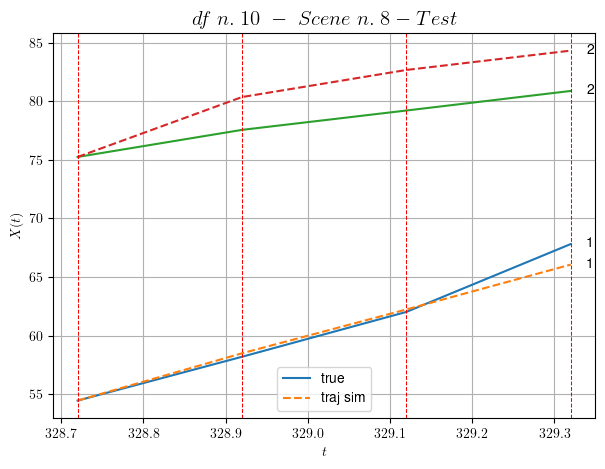

        For scene 8/67:
        * MSE = 4.353188482283938
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/67


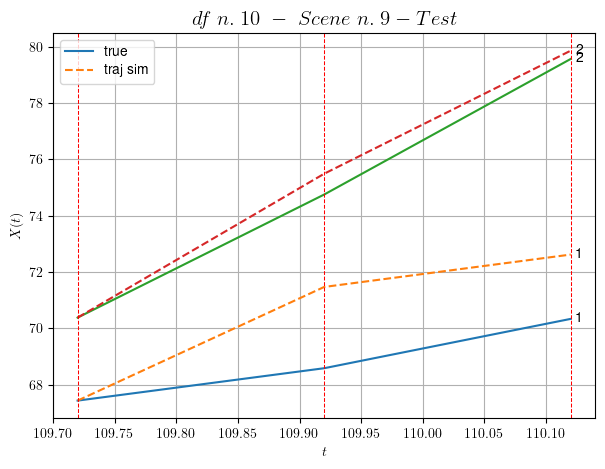

        For scene 9/67:
        * MSE = 2.360965651096153
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.10/67


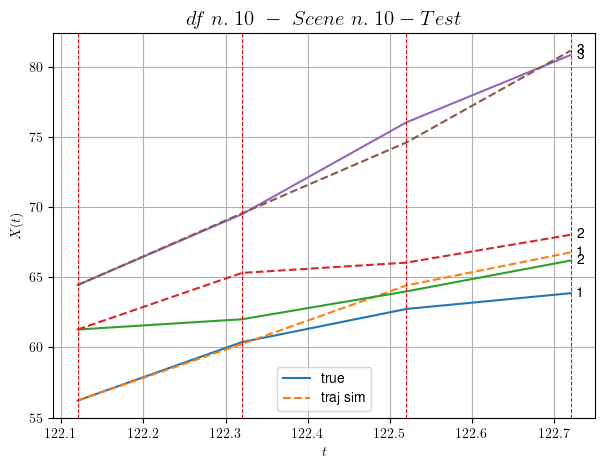

        For scene 10/67:
        * MSE = 2.6603685992321706
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.11/67


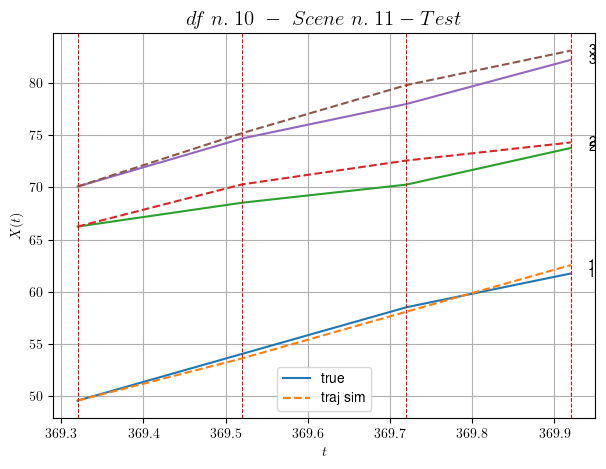

        For scene 11/67:
        * MSE = 1.1651848403384577
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.12/67


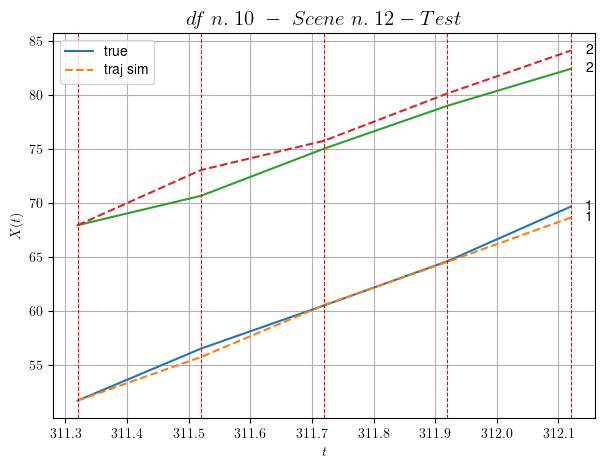

        For scene 12/67:
        * MSE = 1.2045308231753586
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.13/67


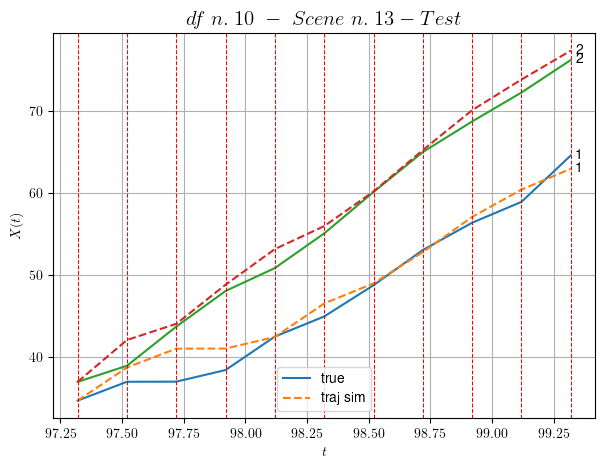

        For scene 13/67:
        * MSE = 2.569190911241898
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.14/67


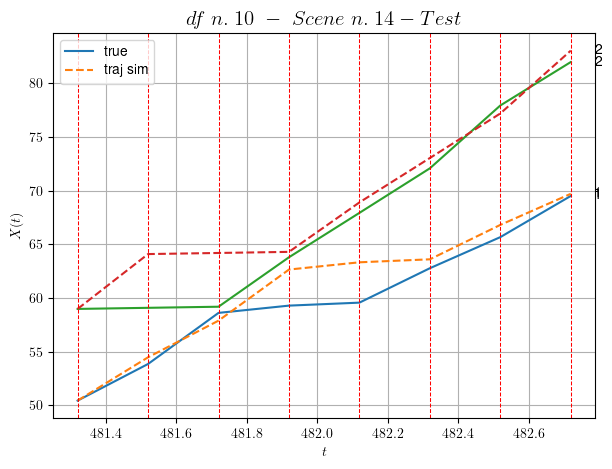

        For scene 14/67:
        * MSE = 5.141869490272551
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.15/67


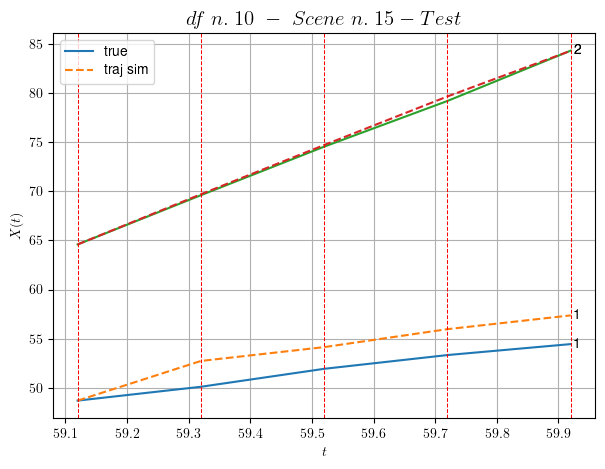

        For scene 15/67:
        * MSE = 2.748866101681906
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.16/67


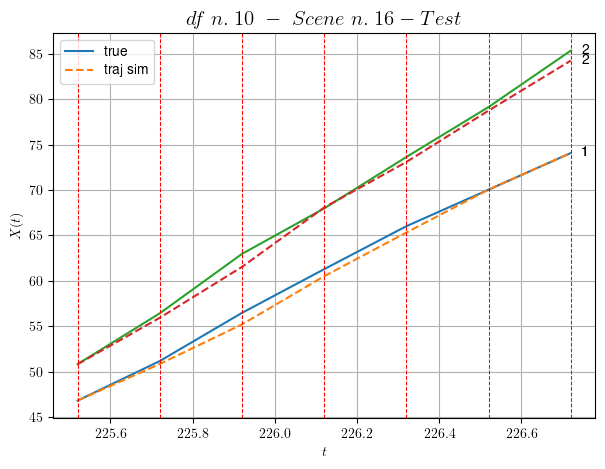

        For scene 16/67:
        * MSE = 0.48430369793968225
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.17/67


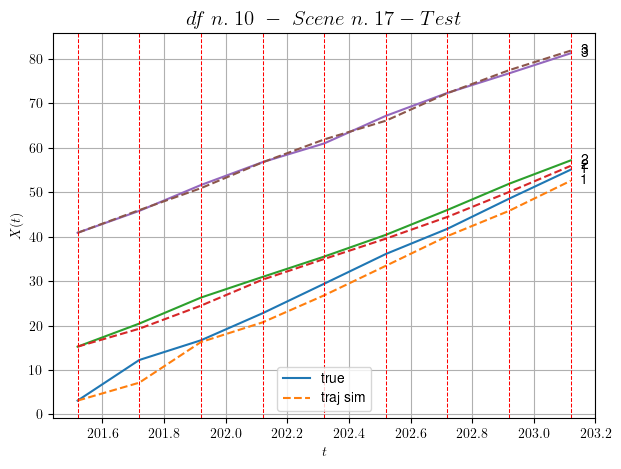

        For scene 17/67:
        * MSE = 2.86894116241916
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.18/67


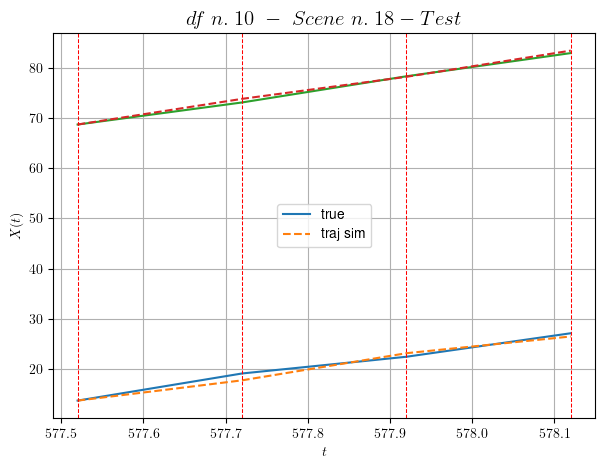

        For scene 18/67:
        * MSE = 0.44284937564622484
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.19/67


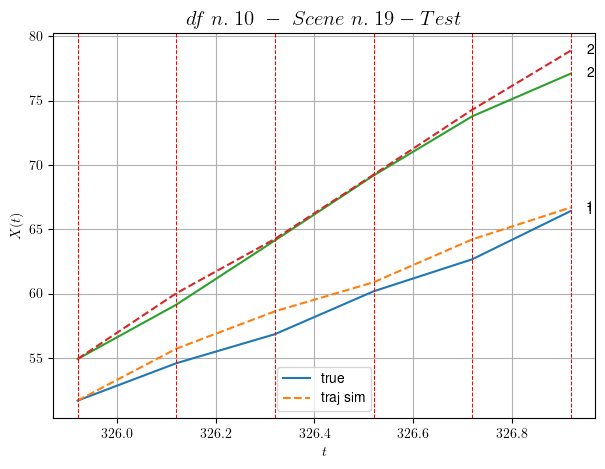

        For scene 19/67:
        * MSE = 0.9710379494319454
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.20/67


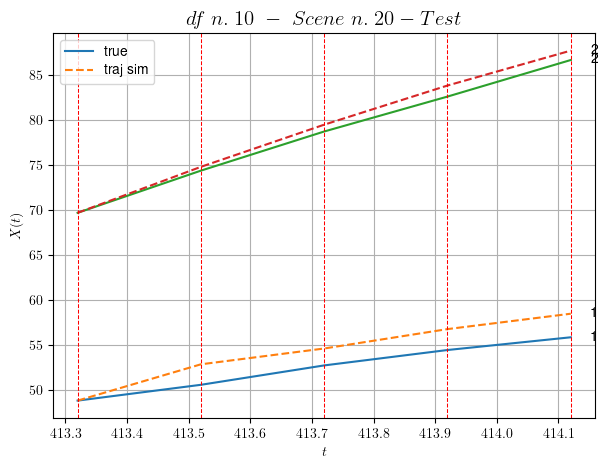

        For scene 20/67:
        * MSE = 2.434038194507935
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.21/67


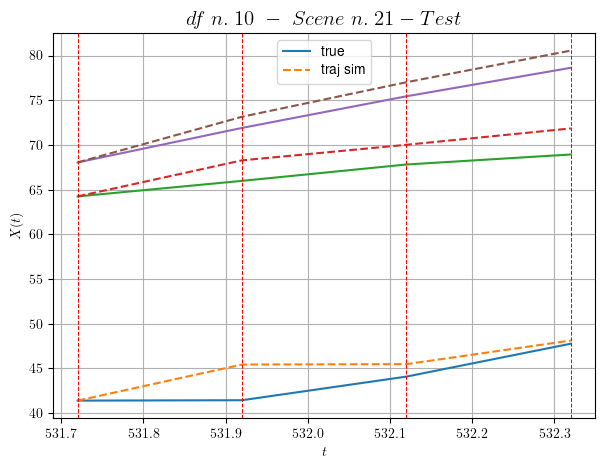

        For scene 21/67:
        * MSE = 3.6956231733039666
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.22/67


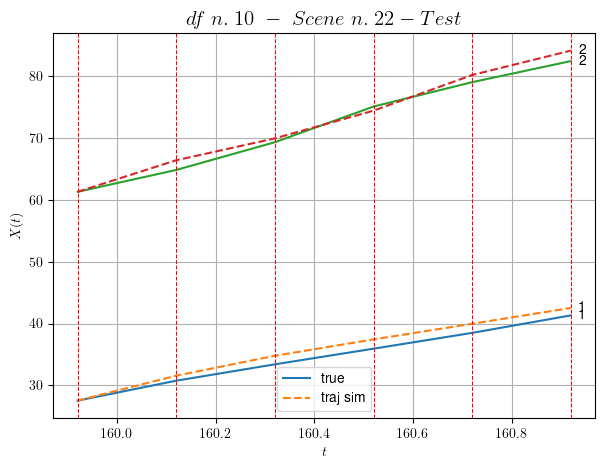

        For scene 22/67:
        * MSE = 1.3307711247154006
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.23/67


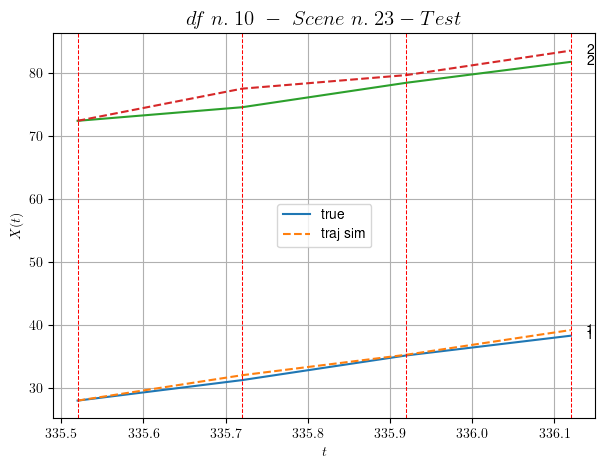

        For scene 23/67:
        * MSE = 1.8506147791298893
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.24/67


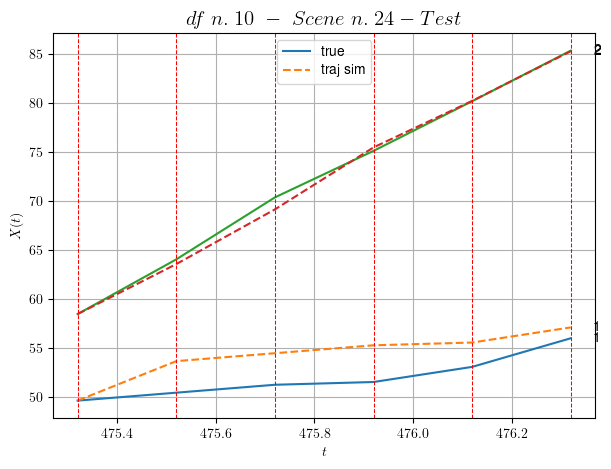

        For scene 24/67:
        * MSE = 3.6816058302449104
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.25/67


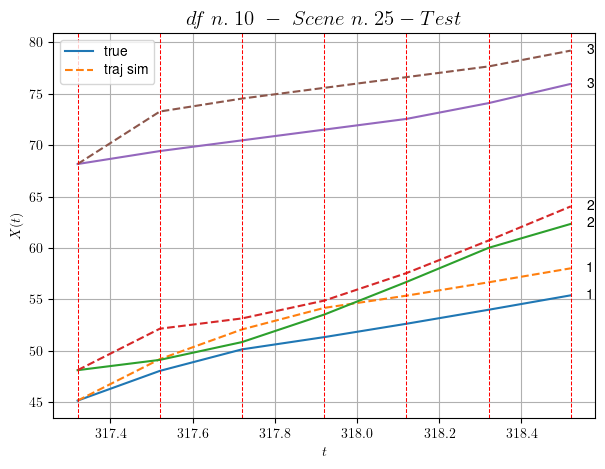

        For scene 25/67:
        * MSE = 6.801932014119148
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.26/67


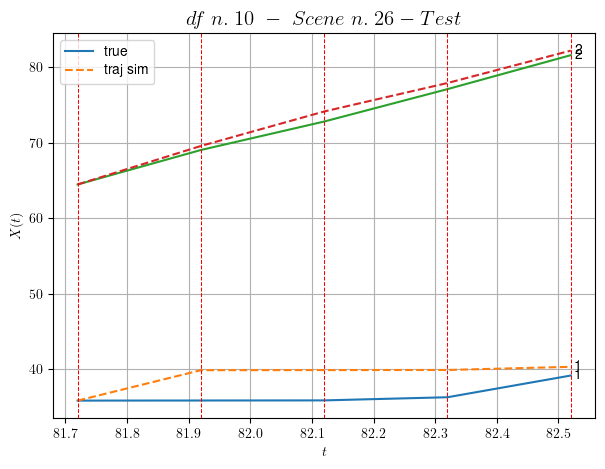

        For scene 26/67:
        * MSE = 4.982706687944419
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.27/67


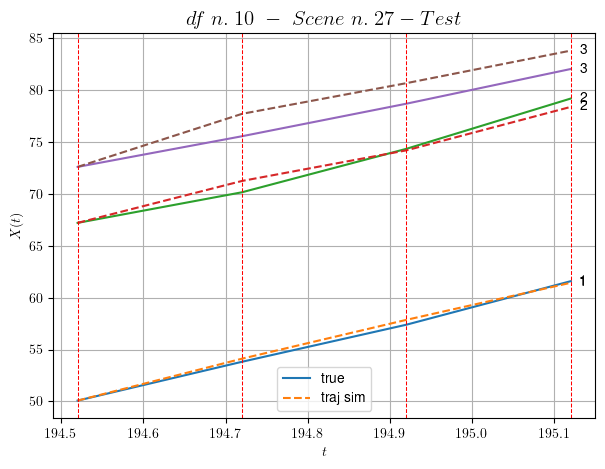

        For scene 27/67:
        * MSE = 1.1559109026917382
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.28/67


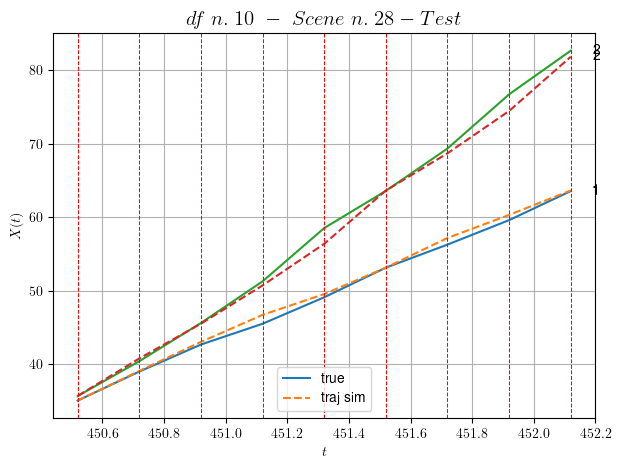

        For scene 28/67:
        * MSE = 0.798549162808571
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.29/67


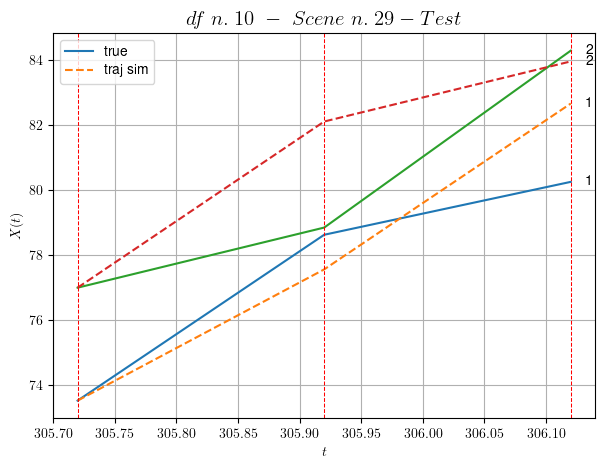

        For scene 29/67:
        * MSE = 2.9456036861112294
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.30/67


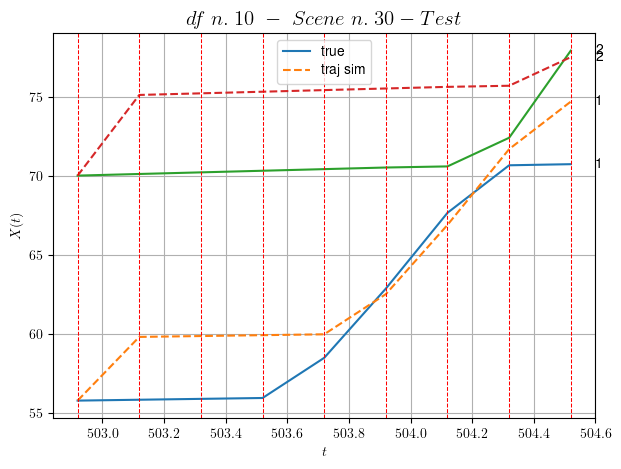

        For scene 30/67:
        * MSE = 12.719132969336432
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.31/67


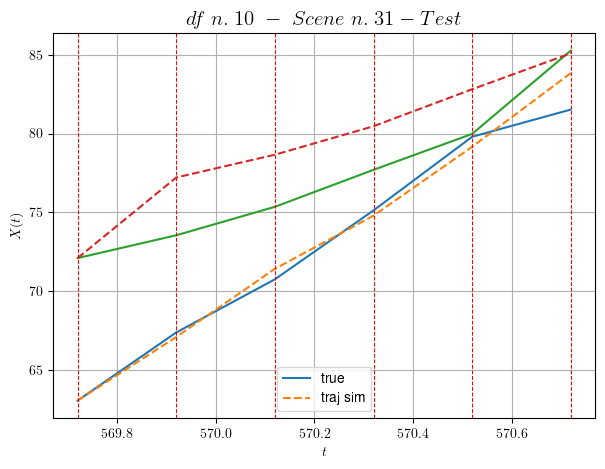

        For scene 31/67:
        * MSE = 3.8665126331613444
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.32/67


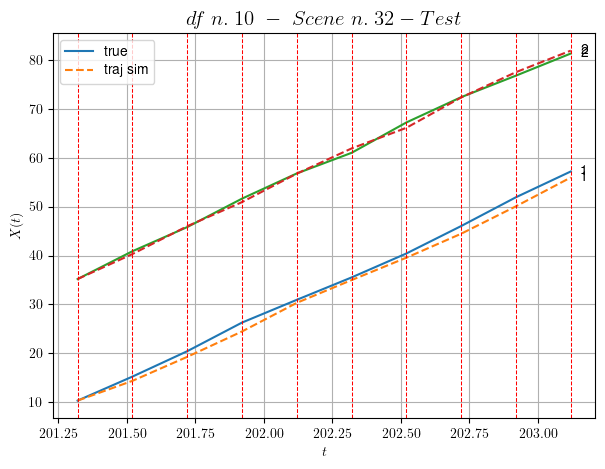

        For scene 32/67:
        * MSE = 0.895722910594448
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.33/67


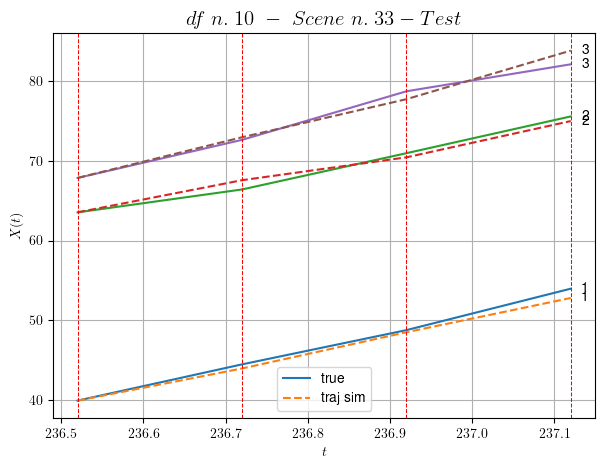

        For scene 33/67:
        * MSE = 0.6427655154886885
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.34/67


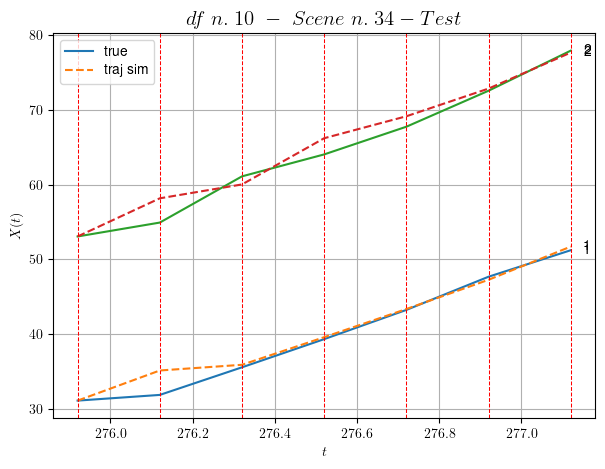

        For scene 34/67:
        * MSE = 2.131602268032622
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.35/67


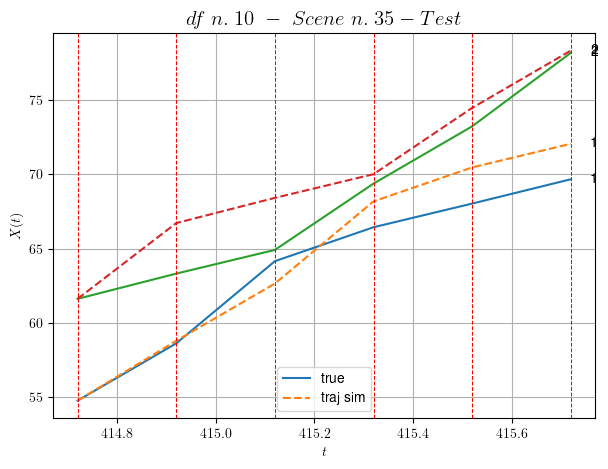

        For scene 35/67:
        * MSE = 3.5793837587898176
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.36/67


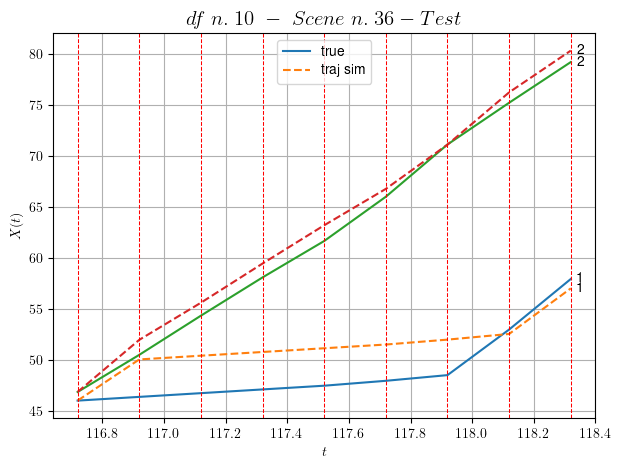

        For scene 36/67:
        * MSE = 5.028884178372788
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.37/67


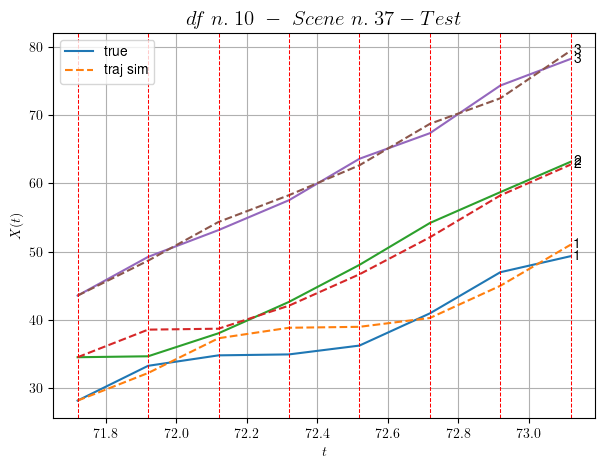

        For scene 37/67:
        * MSE = 2.913155238533909
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.38/67


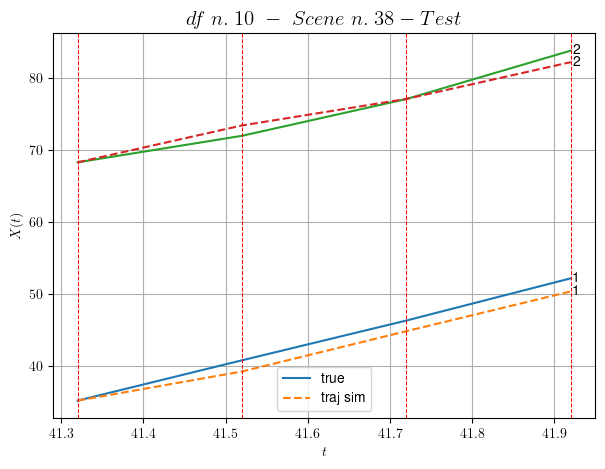

        For scene 38/67:
        * MSE = 1.5587464805460658
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.39/67


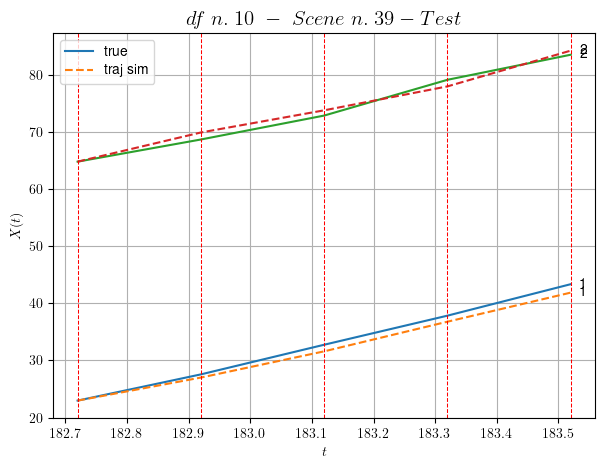

        For scene 39/67:
        * MSE = 0.9133848038921479
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.40/67


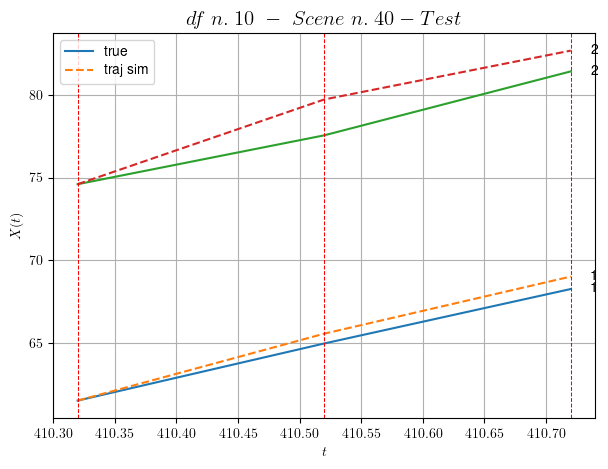

        For scene 40/67:
        * MSE = 1.1929497380388696
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.41/67


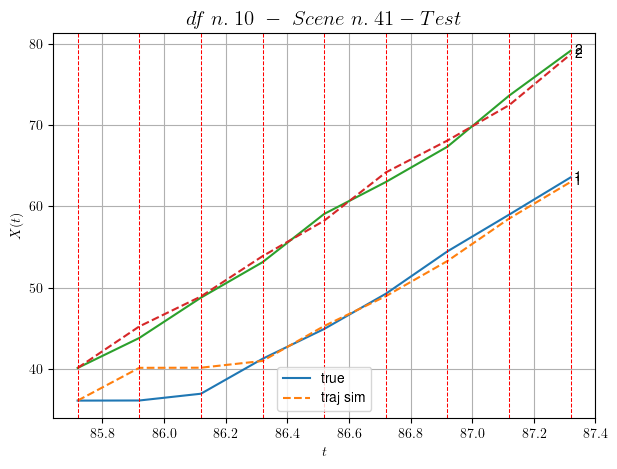

        For scene 41/67:
        * MSE = 1.9700718347757107
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.42/67


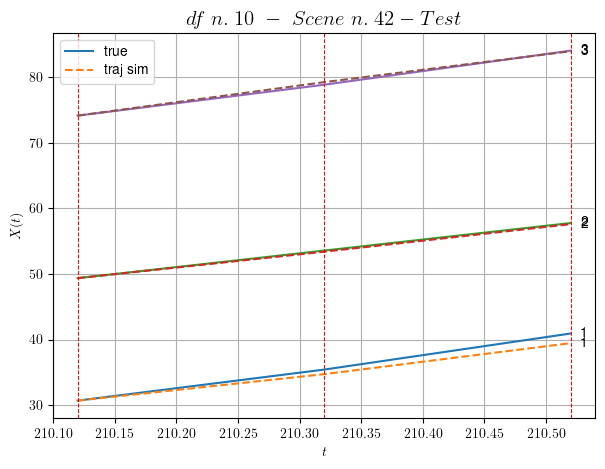

        For scene 42/67:
        * MSE = 0.31900656639035896
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.43/67


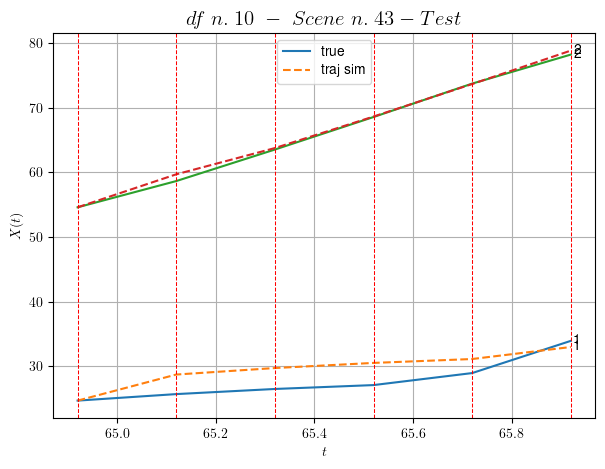

        For scene 43/67:
        * MSE = 3.2185067512958403
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.44/67


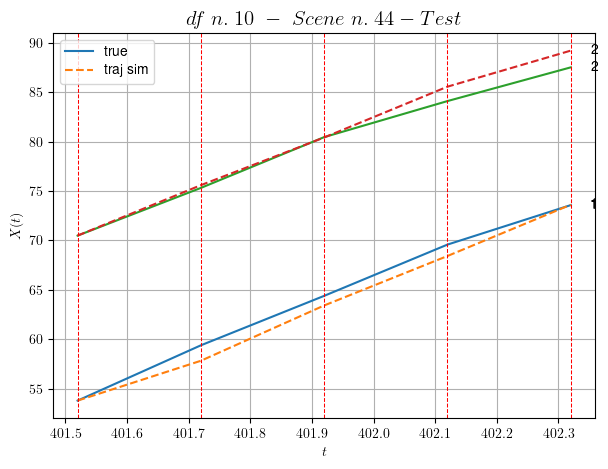

        For scene 44/67:
        * MSE = 0.9810772977263158
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.45/67


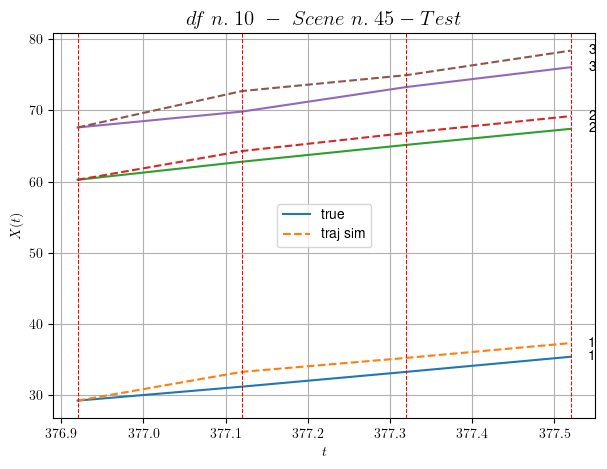

        For scene 45/67:
        * MSE = 3.0452497090428814
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.46/67


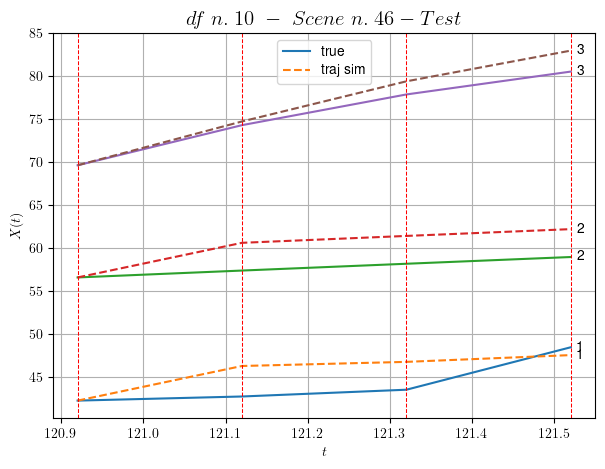

        For scene 46/67:
        * MSE = 5.33617632710482
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.47/67


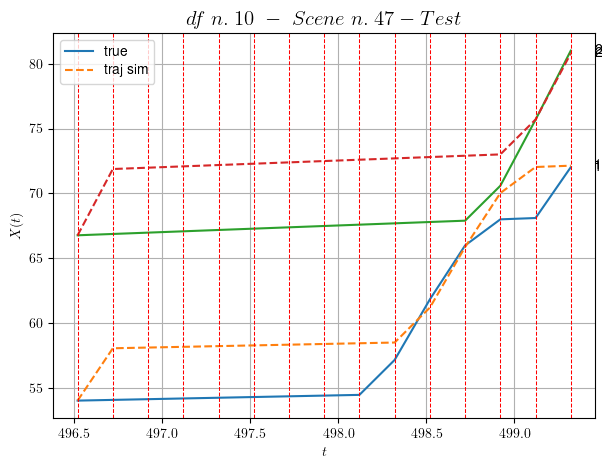

        For scene 47/67:
        * MSE = 14.336653167017495
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.48/67


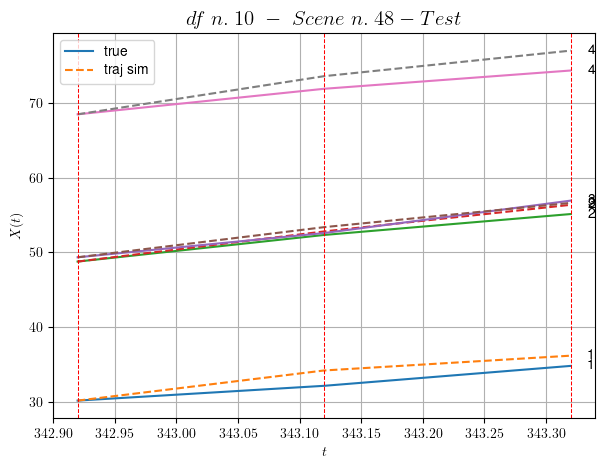

        For scene 48/67:
        * MSE = 1.5415871056569384
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.49/67


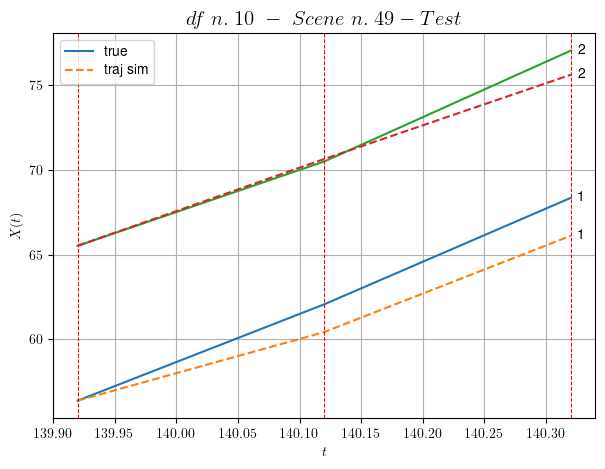

        For scene 49/67:
        * MSE = 1.6156492092695076
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.50/67


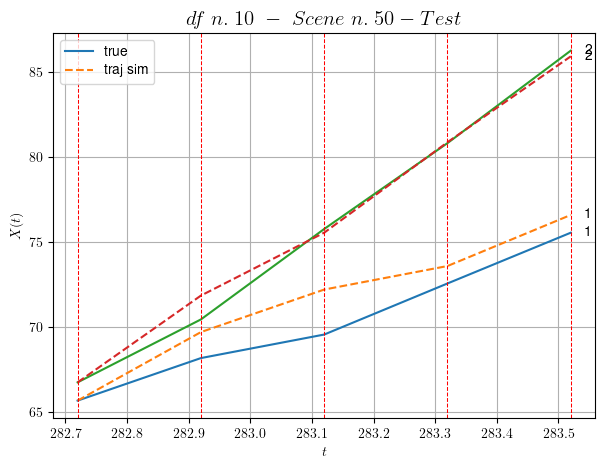

        For scene 50/67:
        * MSE = 1.364048484810919
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.51/67


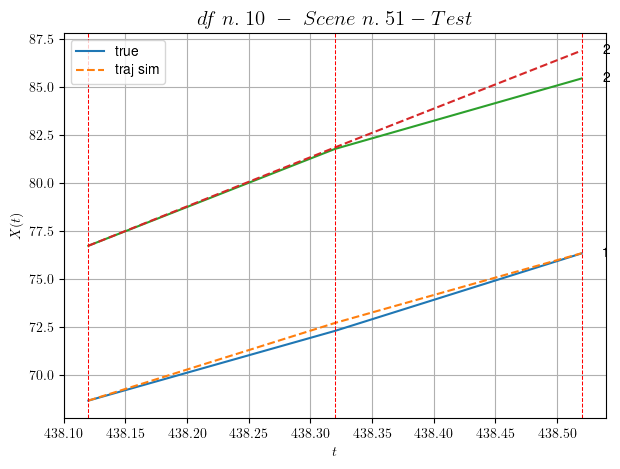

        For scene 51/67:
        * MSE = 0.37904717600978993
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.52/67


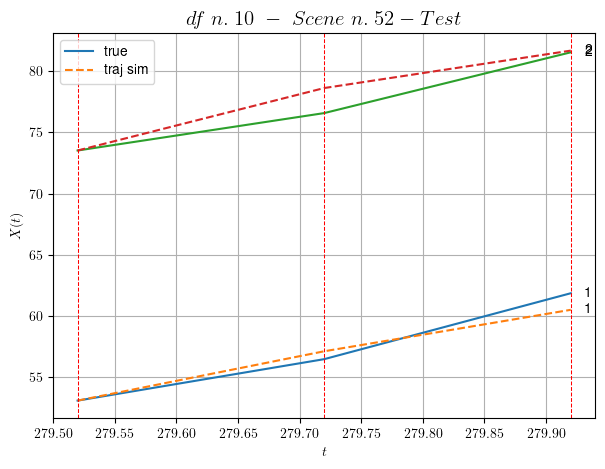

        For scene 52/67:
        * MSE = 1.0780745745368034
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.53/67


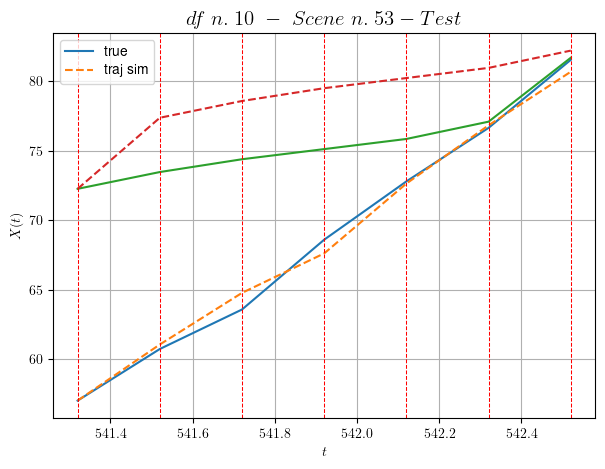

        For scene 53/67:
        * MSE = 6.402423318766568
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.54/67


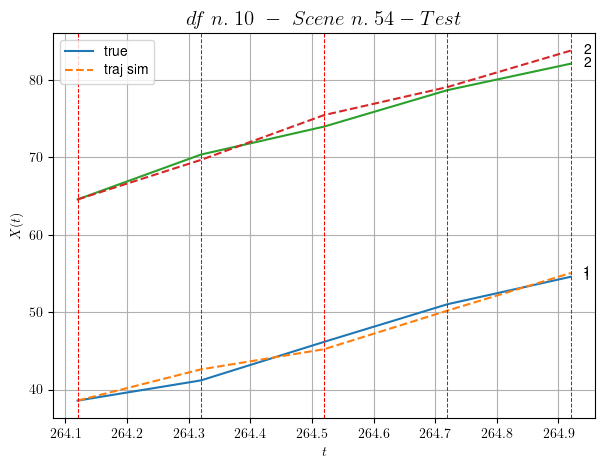

        For scene 54/67:
        * MSE = 0.9551862039373297
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.55/67


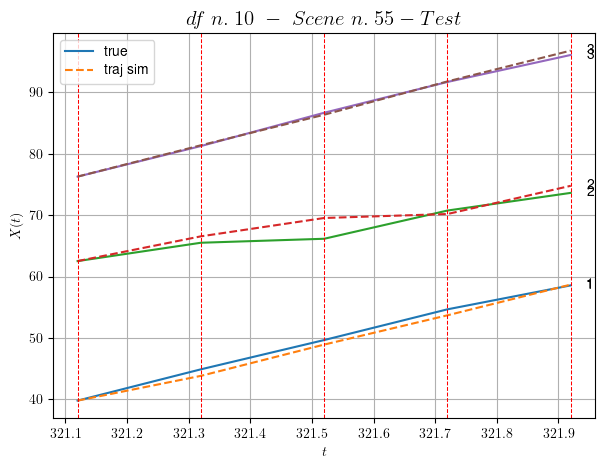

        For scene 55/67:
        * MSE = 1.1651350004314016
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.56/67


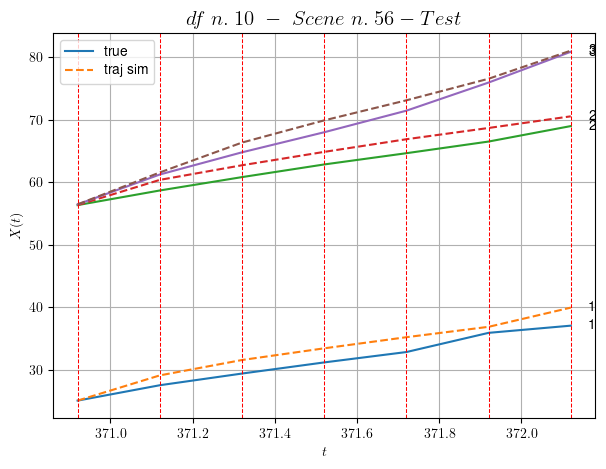

        For scene 56/67:
        * MSE = 2.814036378724549
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.57/67


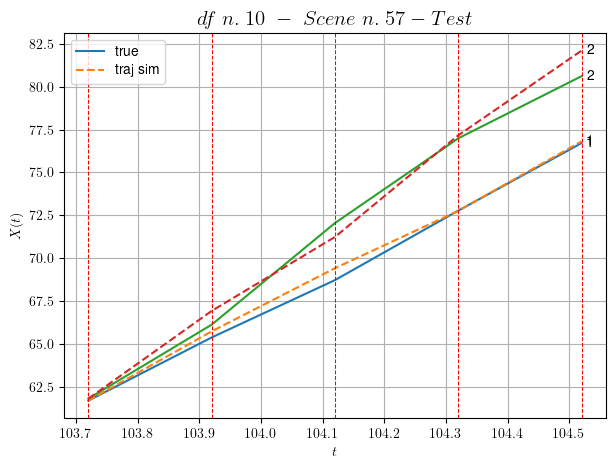

        For scene 57/67:
        * MSE = 0.41590596745012653
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.58/67


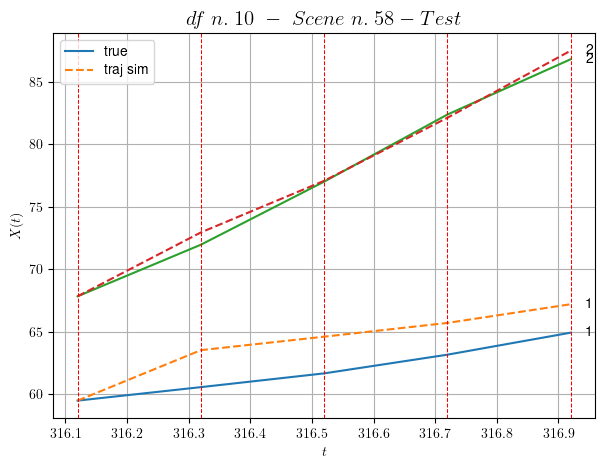

        For scene 58/67:
        * MSE = 3.0480833934936364
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.59/67


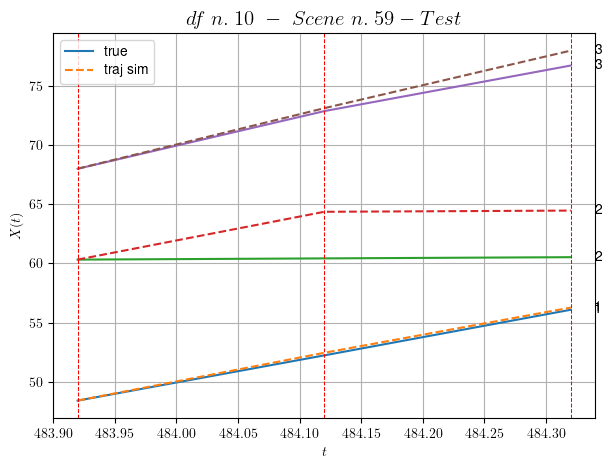

        For scene 59/67:
        * MSE = 3.6285257020476753
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.60/67


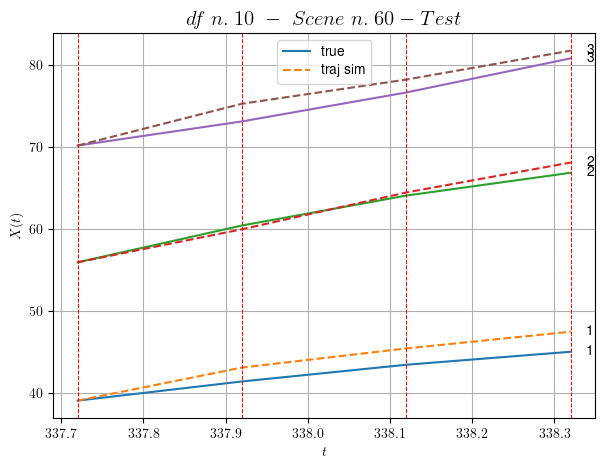

        For scene 60/67:
        * MSE = 1.8998896465470712
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.61/67


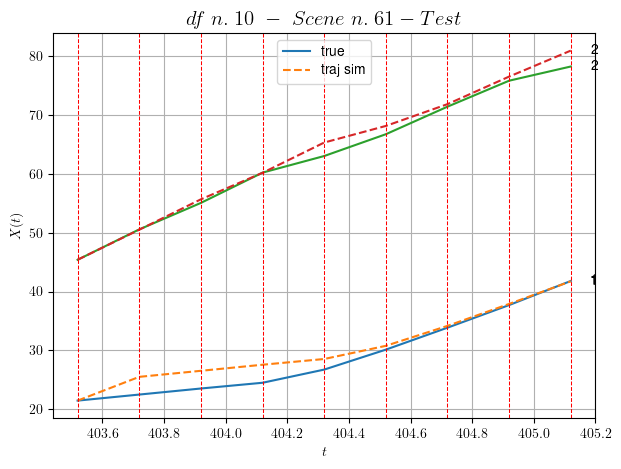

        For scene 61/67:
        * MSE = 2.5990828637987966
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.62/67


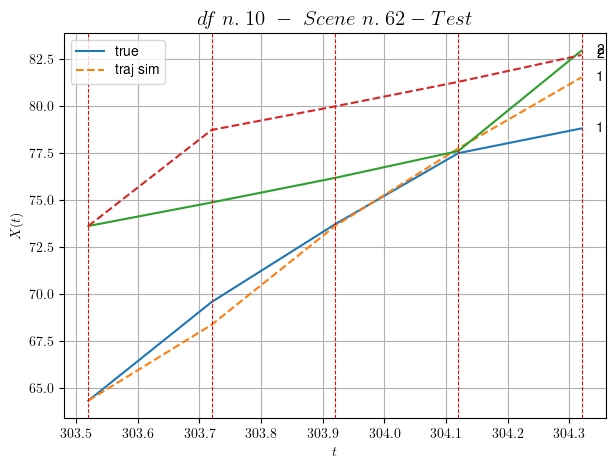

        For scene 62/67:
        * MSE = 5.1861849791893055
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.63/67


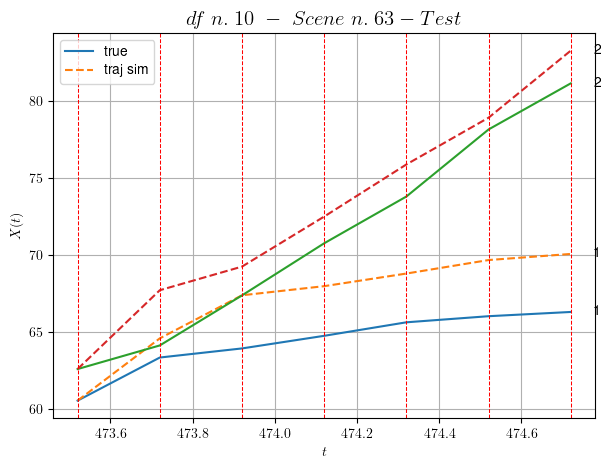

        For scene 63/67:
        * MSE = 6.415432585086176
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.64/67


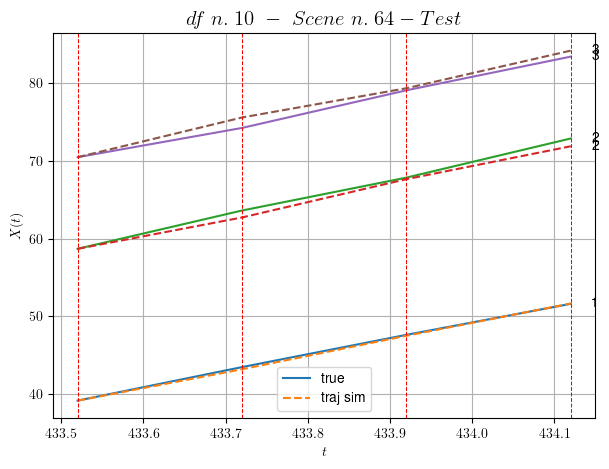

        For scene 64/67:
        * MSE = 0.3676377406140205
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.65/67


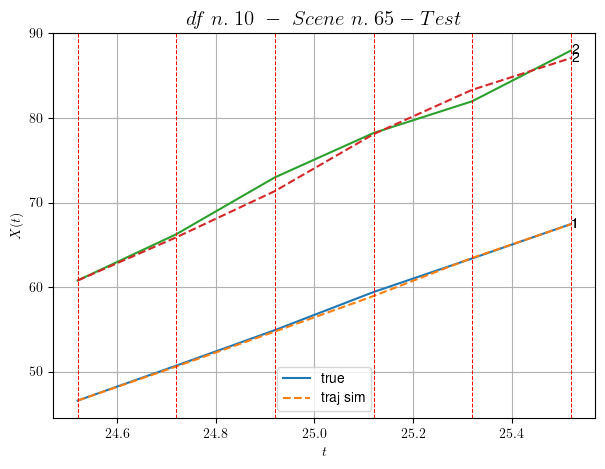

        For scene 65/67:
        * MSE = 0.47288941794374717
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.66/67


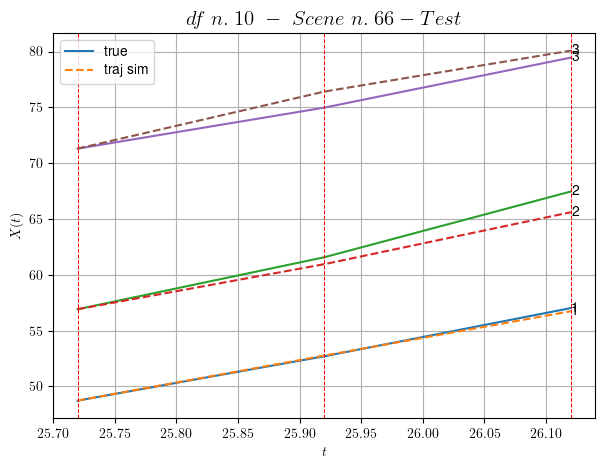

        For scene 66/67:
        * MSE = 0.7085145526464393
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.67/67


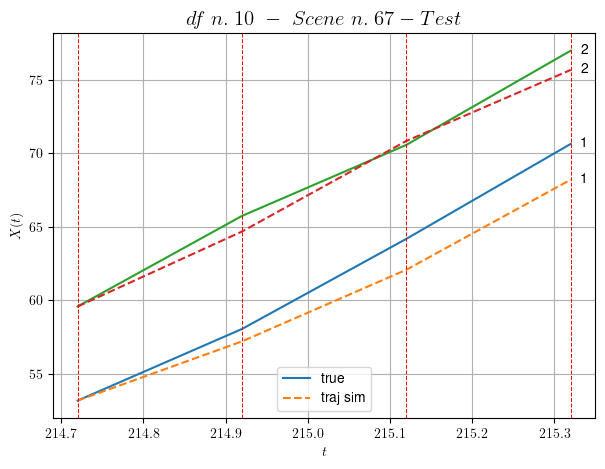

        For scene 67/67:
        * MSE = 1.749916899529521
----------------------------------------------------------------------------------------------------


MSE test: 2.6661821543333404

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.4988526895962174
          * MSE test: 2.6661821543333404
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -






In [6]:
info_nn, model_trained = solve_nn_dataset(dataset, DOE, v0, processed_flag, NUM_ITER, LEARNING_RATE_v0,
                                           test, plot_flag)

In [7]:
get_stats(model_trained)


-------------------- Model Summary --------------------
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Hidden-Layer-1 (Dense)      (None, 2)                 4         
                                                                 
 Hidden-Layer-2 (Dense)      (None, 2)                 6         
                                                                 
 Hidden-Layer-3 (Dense)      (None, 2)                 6         
                                                                 
 Output-Layer (Dense)        (None, 1)                 2         
                                                                 
Total params: 18 (72.00 Byte)
Trainable params: 18 (72.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________

-------------------- Weights and Biases --------------------
Layer:  Hidden-Layer-1
  --Kernels 

## Plot

### Leading velocity $v_{0}$

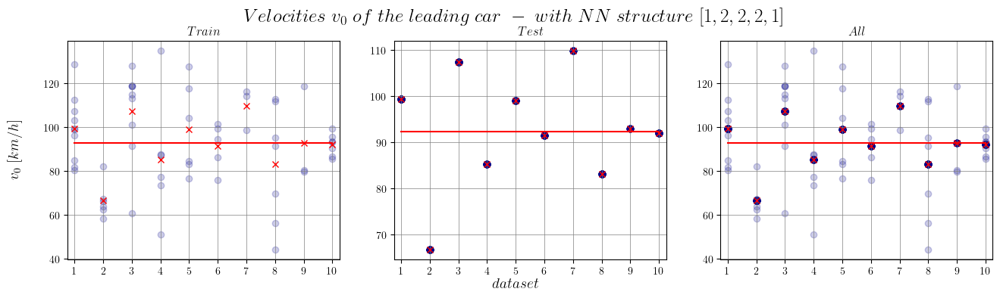

In [8]:
# Initialize the fig
nrow, ncol = 1, 3
width, height = 7, 5 # single subplot
fig, axes = plt.subplots(nrow,ncol,figsize=(width*ncol*.75,height*.75))

ms2kmh = 3.6

info_train = info_nn[info_nn["type"] == "train"]
info_test = info_nn[info_nn["type"] == "test"]
info_grouped = info_nn.groupby(['N. file', 'type']).mean(numeric_only=True)
info_grouped2 = info_nn.groupby(['N. file']).mean(numeric_only=True)
info_avg = info_nn.groupby(['type']).mean(numeric_only=True)

# For each scene, plot v0 mean
for _, scn in info_train.iterrows():
    axes[0].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');
    
for _, scn in info_test.iterrows():
    axes[1].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# Avg value
for (nf,typef), infof in info_grouped.iterrows():
    
    if typef == "train":
        axes[0].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")
        
    if typef == "test":
        axes[1].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")

# For each scene, plot v0 mean
for _, scn in info_nn.iterrows():
    axes[2].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
for nf, p in info_grouped2.iterrows():
    axes[2].plot(nf, p['v0']*ms2kmh, color = 'r', marker="x")

# Plot v0 mean over all dfs
alldfs = [a for a, _ in info_nn.groupby('N. file')]
v0_mean = np.mean([ infof['v0']*ms2kmh for _, infof in info_grouped.iterrows()])
axes[0].plot(alldfs, [info_avg['v0']['train']*ms2kmh]*len(alldfs), color = 'r')  
axes[1].plot(alldfs, [info_avg['v0']['test']*ms2kmh]*len(alldfs), color = 'r')  
axes[2].plot(alldfs, [v0_mean]*len(alldfs), color = 'r')  

# labeling     
axes[0].set_title(fr"$Train$",fontsize=12)
axes[1].set_title(fr"$Test$",fontsize=12)
axes[2].set_title(fr"$All$",fontsize=12)
fig.supxlabel(r"$data set$",fontsize=14, y=0.0005)
fig.supylabel(r"$v_{0}\ [km/h]$",fontsize=14, x = 0.075)
plt.suptitle(fr"$Velocities\ v_{0}\ of\ the\ leading\ car\ -\ with\ NN\ structure\ {str(DOE)}$",
             fontsize=18, y=1)

# Setting the values for all axes.
custom_xlim = (0.75,10.25)
custom_xticks = range(1,11)
plt.setp(axes, xlim=custom_xlim, xticks=custom_xticks)

axes[0].grid(color='grey', linestyle='-', linewidth=0.5);
axes[1].grid(color='grey', linestyle='-', linewidth=0.5);
axes[2].grid(color='grey', linestyle='-', linewidth=0.5);

plt.show()

### Test 1: `cons_dis` vs `velocities`

In [9]:
Nx = 10
Nt = 100
T = 0.5

In [10]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [11]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [12]:
y_pred

<tf.Tensor: shape=(9, 1), dtype=float32, numpy=
array([[20.174994],
       [20.174986],
       [20.174994],
       [20.174986],
       [20.174992],
       [20.174994],
       [20.17499 ],
       [20.174994],
       [20.17499 ]], dtype=float32)>

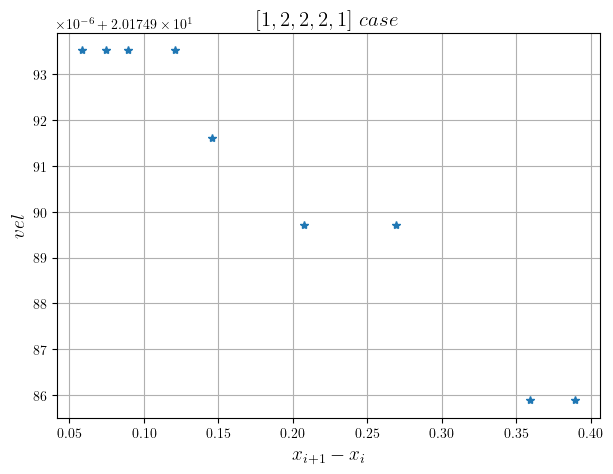

In [13]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

### Test 2: `cons_dis` vs `velocities`

In [14]:
Nx = 100
Nt = 100
T = 0.5

In [15]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [16]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

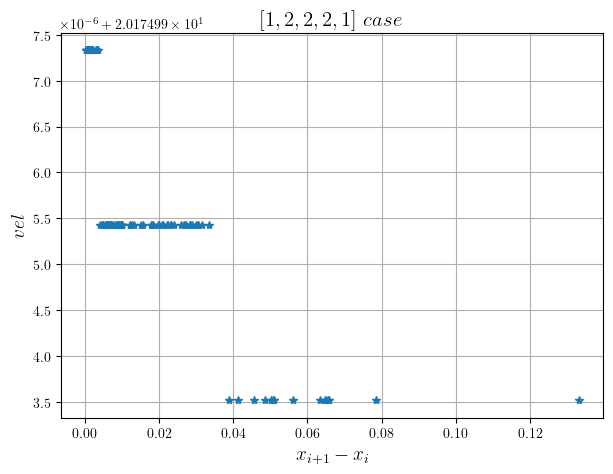

In [17]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

## Prepare the out dir

In [18]:
# Create the directory..
if flag_save:
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-PRE-nn{str(DOE)}")
    
    path = 'out/' + d
    os.mkdir(path)
    
    # Save the solution in a file
    namefile = '/info_nn.txt'

    with open(path + namefile, 'w') as output:
        info_nn.to_csv(path + namefile, sep=',', index=False)
        
    # Save model in a file
    namefile_model = '/model_nn.keras'
    model_trained.compile(optimizer='SGD', loss='MAE')
    model_trained.save(path + namefile_model)  # The file needs to end with the .keras extension